# Analysis for generated trees from 2wiki

In [1]:
import json
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from collections import Counter
import networkx as nx
from networkx.drawing.nx_agraph import graphviz_layout
from pylab import rcParams

In [2]:
trees = json.load(open("results/test.json"))

i = 0
# add same index to all nodes in the same tree, to relate them afterwards easily
for tree in trees:
    for node in tree:
        node['example_index'] = i
    i += 1
trees

[[{'idx': 0,
   'question_text': 'Who is Queen Hyojeong married to?',
   'sons': [],
   'qd_logprob': None,
   'fa': 2,
   'question': 'Who is Queen Hyojeong married to?',
   'cb_answer': ['King Cheoljong.',
    -0.053805460199916666,
    'Queen Hyojeong is married to King Cheoljong. So the answer is: King Cheoljong.'],
   'ob_answer': ['King Heonjong of Joseon.',
    -0.04996398290000933,
    'Queen Hyojeong is married to King Heonjong of Joseon. So the answer is: King Heonjong of Joseon.'],
   'answer': ['King Heonjong of Joseon.',
    -0.04996398290000933,
    'Queen Hyojeong is married to King Heonjong of Joseon. So the answer is: King Heonjong of Joseon.'],
   'example_index': 0},
  {'idx': 1,
   'question_text': 'Who is the father of <1>?',
   'sons': [],
   'qd_logprob': None,
   'fa': 2,
   'question': 'Who is the father of King Heonjong of Joseon.?',
   'cb_answer': ['King Taejong of Joseon.',
    -0.05121584034369556,
    "King Heonjong of Joseon's father is King Taejong of J

In [3]:
# Initialize metrics
leaf_cb_probs, leaf_ob_probs = [], []
parent_probs = {"cb": [], "ob": [], "child": [], "max": []}
answer_type_count = Counter()
children_count_vs_prob = []
example_level_probs_for_parents = [] 
child_question_lengths = []
parent_question_lengths = []
children_count = []


for tree in trees:
    example_probs = {"cb_parent_probs": -100, "ob_parent_probs": -100, "child_parent_probs": -100}
    for node in tree:
        # If leaf node
        if len(node["sons"]) == 0:
            cb_prob = node["cb_answer"][1]
            ob_prob = node["ob_answer"][1]
            leaf_cb_probs.append(cb_prob)
            leaf_ob_probs.append(ob_prob)

            child_question_lengths.append(len(node["question"]))

            # Skip invalid probabilities
            if cb_prob < -10:
                print("Got -100 in child's answer cb! Answer got was: \n", node["cb_answer"][0], "\n")
            if ob_prob < -10:
                print("Got -100 in child's answer ob! Answer got was: \n", node["ob_answer"][0], "\n")
            
            # Track which answer is better
            if ob_prob > cb_prob:
                answer_type_count['ob_child'] += 1
            else:
                answer_type_count['cb_child'] += 1
        
        else:  # Parent node
            cb_prob = node["cb_answer"][1]
            ob_prob = node["ob_answer"][1]
            child_prob = node["child_answer"][1]

            parent_question_lengths.append(len(node["question"]))

            # Store probabilities per example
            example_probs["cb_parent_probs"] = cb_prob
            example_probs["ob_parent_probs"] = ob_prob
            example_probs["child_parent_probs"] = child_prob

            # Skip invalid probabilities
            if cb_prob < -10:
                print(f"Got {cb_prob} in parent's cb answer ! Answer got was: \n", node["cb_answer"][0], "\n")
            if ob_prob < -10:
                print(f"Got {ob_prob} in parent's ob answer ! Answer got was: \n", node["ob_answer"][0], "\n")
            if child_prob < -10:
                print(f"Got {child_prob} in parent's child answer ! Answer got was: \n", node["child_answer"][0], "\n")
            
            parent_probs["cb"].append(cb_prob)
            parent_probs["ob"].append(ob_prob)
            parent_probs["child"].append(child_prob)
            # Choose max probability
            max_prob = max(cb_prob, ob_prob, child_prob)
            parent_probs["max"].append(max_prob)

            if max_prob == cb_prob:
                answer_type_count['cb_parent'] += 1
            elif max_prob == ob_prob:
                answer_type_count['ob_parent'] += 1
            else:
                answer_type_count['child_parent'] += 1
            
            # Store children count vs max probability
            children_count_vs_prob.append((len(node["sons"]), max_prob))
            # Append per-example probabilities
            example_level_probs_for_parents.append(example_probs)
            # children_count for parent
            children_count.append(len(node["sons"]))


Got -100 in child's answer ob! Answer got was: 
 Unknown. 

Got -100 in child's answer ob! Answer got was: 
 Unknown. 

Got -100 in child's answer ob! Answer got was: 
 Unknown. 

Got -100 in parent's ob answer ! Answer got was: 
 Lord Herbert Montagu Douglas Scott's father is William Henry Walter Montagu Douglas Scott, 6th Duke of Buccleuch & 8th Duke of Queensberry. William Henry Walter Montagu Douglas Scott's mother is Lady Louisa Jane Hamilton. So, Lord Herbert Montagu Douglas Scott's maternal grandfather is unknown. 

Got -100 in child's answer ob! Answer got was: 
 Unknown. 

Got -100 in child's answer ob! Answer got was: 
 Unknown. 

Got -100 in child's answer ob! Answer got was: 
 Unknown. 

Got -100 in child's answer ob! Answer got was: 
 Unknown. 

Got -100 in child's answer ob! Answer got was: 
 Unknown. 

Got -100 in parent's ob answer ! Answer got was: 
 Unknown. 

Got -100 in parent's ob answer ! Answer got was: 
 Unknown. 

Got -100 in child's answer ob! Answer got was: 

In [4]:
print("Open book leaf count with unknown answers: ", len([p for p in leaf_ob_probs if p < -10]))
print("Closed book leaf count with unknown answers: ", len([p for p in leaf_cb_probs if p < -10]))

Open book leaf count with unknown answers:  27
Closed book leaf count with unknown answers:  0


In [5]:
for key, probs in parent_probs.items():
    print(f"{key.upper()} has (unknown) # of times : {len([p for p in probs if p < -10])}")

# This shows we never got the max answer in the parent to 

CB has (unknown) # of times : 0
OB has (unknown) # of times : 5
CHILD has (unknown) # of times : 0
MAX has (unknown) # of times : 0


In [6]:
# Compute statistics
print("### Leaf Node Analysis ###")
print(f"Average CB Answer Log Probability: {np.mean(leaf_cb_probs):.4f}")
print(f"Average OB Answer Log Probability: {np.mean(leaf_ob_probs):.4f}")
print(f"OB Better Than CB: {answer_type_count['ob_child']} times")
print(f"CB Better Than OB: {answer_type_count['cb_child']} times")

print("\n### Parent Node Analysis ###")
for key, probs in parent_probs.items():
    print(f"{key.upper()}, Avg Log Prob: {np.mean(probs):.4f}")

print("\n### Answer Type Distribution ###")
for answer_type, count in answer_type_count.items():
    print(f"{answer_type}: {count} times")

print("\n### Children Count vs Probabilities ###")
children_counts, max_parent_probs = zip(*children_count_vs_prob) if children_count_vs_prob else ([], [])
if children_counts:
    correlation = np.corrcoef(children_counts, max_parent_probs)[0, 1]
    print(f"Correlation Between Children Count and Max Probability: {correlation:.4f}")
else:
    print("No parent nodes with children to analyze.")


### Leaf Node Analysis ###
Average CB Answer Log Probability: -0.0990
Average OB Answer Log Probability: -9.4169
OB Better Than CB: 199 times
CB Better Than OB: 89 times

### Parent Node Analysis ###
CB, Avg Log Prob: -0.0842
OB, Avg Log Prob: -3.1492
CHILD, Avg Log Prob: -0.0288
MAX, Avg Log Prob: -0.0274

### Answer Type Distribution ###
ob_child: 199 times
child_parent: 133 times
cb_child: 89 times
cb_parent: 15 times
ob_parent: 14 times

### Children Count vs Probabilities ###
Correlation Between Children Count and Max Probability: 0.0395


In [7]:
# Filter out invalid probabilities
valid_leaf_cb_probs = [p for p in leaf_cb_probs if p > -10]
valid_leaf_ob_probs = [p for p in leaf_ob_probs if p > -10]

valid_parent_cb_probs = [p for p in parent_probs["cb"] if p > -10]
valid_parent_ob_probs = [p for p in parent_probs["ob"] if p > -10]
valid_parent_child_probs = [p for p in parent_probs["child"] if p > -10]

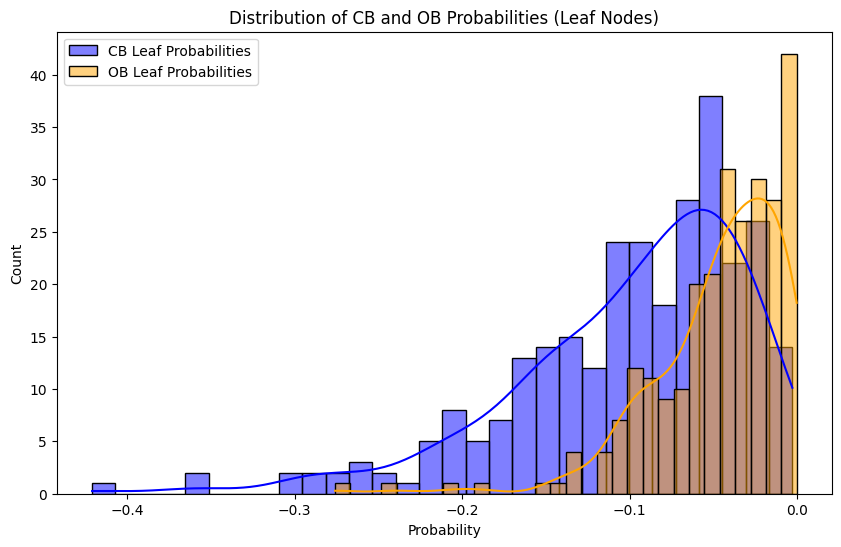

In [8]:
# 1. Distribution of Leaf Probabilities
plt.figure(figsize=(10, 6))
sns.histplot(valid_leaf_cb_probs, color="blue", label="CB Leaf Probabilities", kde=True, bins=30)
sns.histplot(valid_leaf_ob_probs, color="orange", label="OB Leaf Probabilities", kde=True, bins=30)
plt.title("Distribution of CB and OB Probabilities (Leaf Nodes)")
plt.xlabel("Probability")
plt.ylabel("Count")
plt.legend()
plt.show()

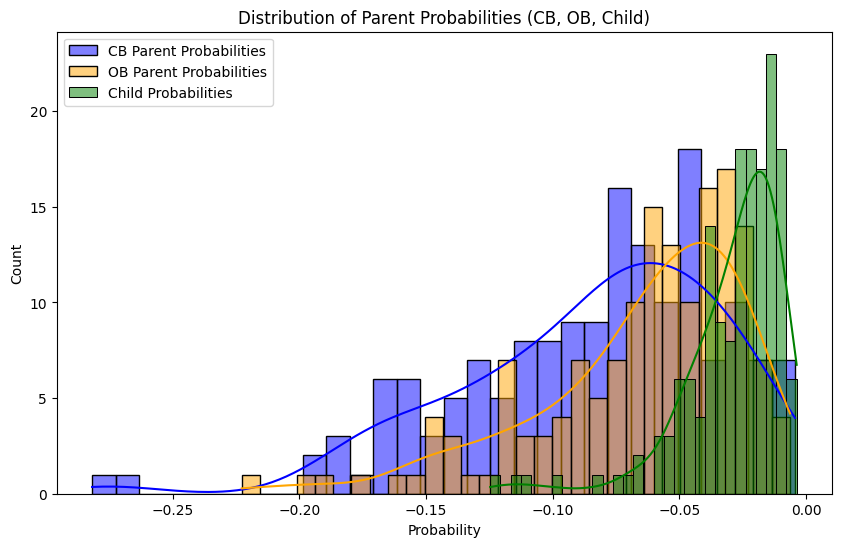

In [9]:
# 2. Parent Probabilities Visualization
plt.figure(figsize=(10, 6))
sns.histplot(valid_parent_cb_probs, color="blue", label="CB Parent Probabilities", kde=True, bins=30)
sns.histplot(valid_parent_ob_probs, color="orange", label="OB Parent Probabilities", kde=True, bins=30)
sns.histplot(valid_parent_child_probs, color="green", label="Child Probabilities", kde=True, bins=30)
plt.title("Distribution of Parent Probabilities (CB, OB, Child)")
plt.xlabel("Probability")
plt.ylabel("Count")
plt.legend()
plt.show()

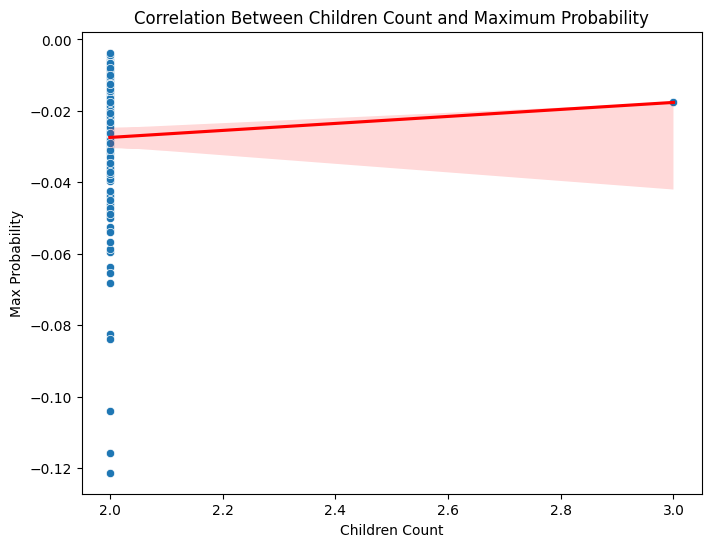

In [10]:
# 4. Correlation: Children Count vs Max Probability
valid_children_count_vs_prob = [
    (count, prob) for count, prob in children_count_vs_prob if prob > -10
]
if valid_children_count_vs_prob:
    children_counts, max_parent_probs = zip(*valid_children_count_vs_prob)
    children_counts = list(children_counts)
    max_parent_probs = list(max_parent_probs)

    plt.figure(figsize=(8, 6))
    sns.scatterplot(x=children_counts, y=max_parent_probs)
    sns.regplot(x=children_counts, y=max_parent_probs, scatter=False, color="red")
    plt.title("Correlation Between Children Count and Maximum Probability")
    plt.xlabel("Children Count")
    plt.ylabel("Max Probability")
    plt.show()

/var/folders/0p/97g04f6j0xbd6n9kfwf97fs00000gn/T/ipykernel_385/684805155.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=answer_types, y=counts, palette="viridis")


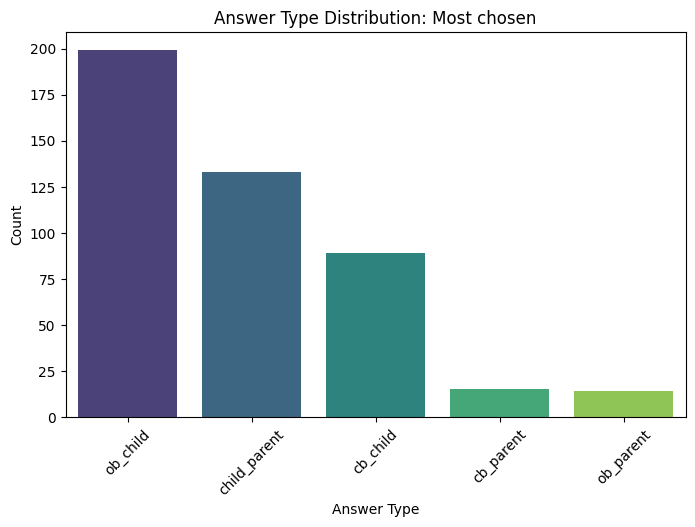

In [11]:
# 5. Bar Chart: Answer Type Distribution
plt.figure(figsize=(8, 5))
answer_types = list(answer_type_count.keys())
counts = list(answer_type_count.values())
sns.barplot(x=answer_types, y=counts, palette="viridis")
plt.title("Answer Type Distribution: Most chosen")
plt.xlabel("Answer Type")
plt.ylabel("Count")
plt.xticks(rotation=45)
plt.show()

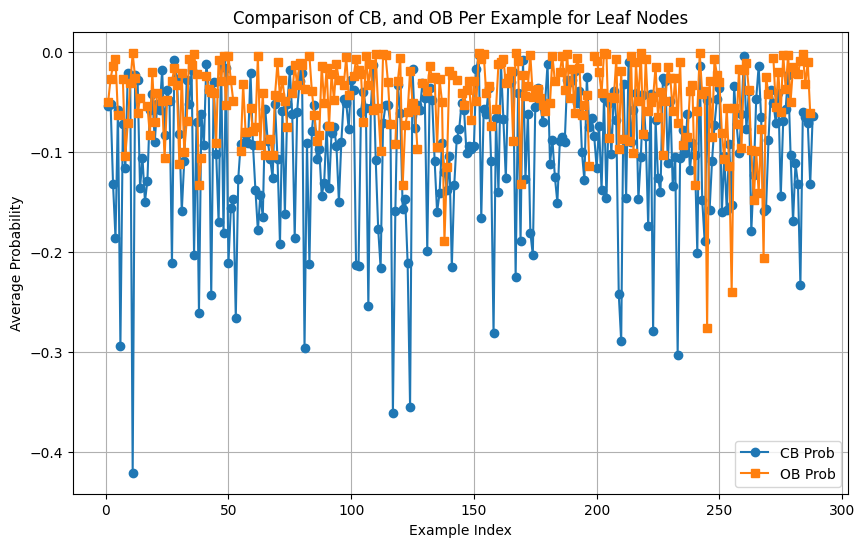

In [12]:
# Visualization of Probabilities Per Example for Leaf Nodes
example_indices = range(1, len(leaf_cb_probs) + 1)

# Replace -100 with NaN in ob_probs
leaf_ob_probs_without_unknown = [np.nan if prob < -10 else prob for prob in leaf_ob_probs]
leaf_cb_probs_without_unknown = [np.nan if prob < -10 else prob for prob in leaf_cb_probs]


# Now plot
plt.figure(figsize=(10, 6))
plt.plot(example_indices, leaf_cb_probs_without_unknown, label="CB Prob", marker="o")
plt.plot(example_indices, leaf_ob_probs_without_unknown, label="OB Prob", marker="s")

plt.xlabel("Example Index")
plt.ylabel("Average Probability")
plt.title("Comparison of CB, and OB Per Example for Leaf Nodes")
plt.legend()
plt.grid(True)
plt.show()

# Its obvious that the open-book probabilities are in general higher.
# One reason could be that leaf nodes are more specific and hence OB is more likely to have the answer.

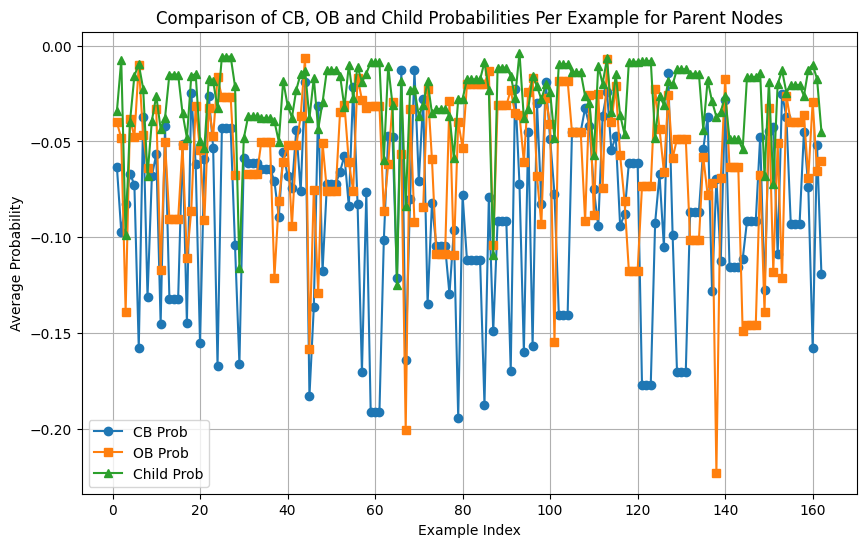

In [13]:
# Visualization of Probabilities Per Example for Parent Nodes
example_indices = range(1, len(example_level_probs_for_parents) + 1)
cb_probs = [e["cb_parent_probs"] for e in example_level_probs_for_parents]
ob_probs = [e["ob_parent_probs"] for e in example_level_probs_for_parents]
child_probs = [e["child_parent_probs"] for e in example_level_probs_for_parents]

# Replace -100 with NaN in ob_probs
ob_probs_without_unknown = [np.nan if prob < -10 else prob for prob in ob_probs]
cb_probs_without_unknown = [np.nan if prob < -10 else prob for prob in cb_probs]
child_probs_without_unknown = [np.nan if prob < -10 else prob for prob in child_probs]

# Now plot
plt.figure(figsize=(10, 6))
plt.plot(example_indices, cb_probs_without_unknown, label="CB Prob", marker="o")
plt.plot(example_indices, ob_probs_without_unknown, label="OB Prob", marker="s")
plt.plot(example_indices, child_probs_without_unknown, label="Child Prob", marker="^")

plt.xlabel("Example Index")
plt.ylabel("Average Probability")
plt.title("Comparison of CB, OB and Child Probabilities Per Example for Parent Nodes")
plt.legend()
plt.grid(True)
plt.show()

# Its obvious that the child probabilities are always the highest, which is not the case in the leaf nodes.
# In leaf nodes, the probabilities are more shifted into OB, One reason could be that leaf nodes are more specific and hence OB is more likely to have the answer.

child answer is max: 138/162
ob answer is max: 13/162
cb answer is max: 11/162


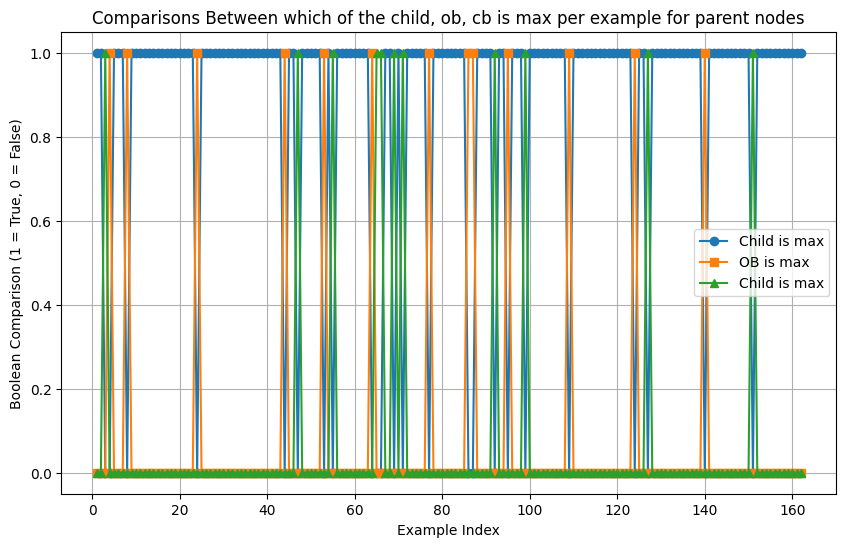

In [14]:
# Extract probabilities
example_indices = range(1, len(example_level_probs_for_parents) + 1)
max_probs = [max(e.values()) for e in example_level_probs_for_parents]

# Create pairwise comparisons
child_is_max = [child == max_ for child, max_ in zip(child_probs, max_probs)]
ob_is_max = [ob == max_ for ob, max_ in zip(ob_probs, max_probs)]
cb_is_max = [cb == max_ for cb, max_ in zip(cb_probs, max_probs)]

# Calculate percentages
child_is_max_count = sum(child_is_max)
ob_is_max_count = sum(ob_is_max)
cb_is_max_count = sum(cb_is_max)

# Print summary
print(f"child answer is max: {child_is_max_count}/{len(example_indices)}")
print(f"ob answer is max: {ob_is_max_count}/{len(example_indices)}")
print(f"cb answer is max: {cb_is_max_count}/{len(example_indices)}")

# Visualization
plt.figure(figsize=(10, 6))
plt.plot(example_indices, child_is_max, label="Child is max", marker="o")
plt.plot(example_indices, ob_is_max, label="OB is max", marker="s")
plt.plot(example_indices, cb_is_max, label="Child is max", marker="^")

plt.xlabel("Example Index")
plt.ylabel("Boolean Comparison (1 = True, 0 = False)")
plt.title("Comparisons Between which of the child, ob, cb is max per example for parent nodes")
plt.legend()
plt.grid(True)
plt.show()


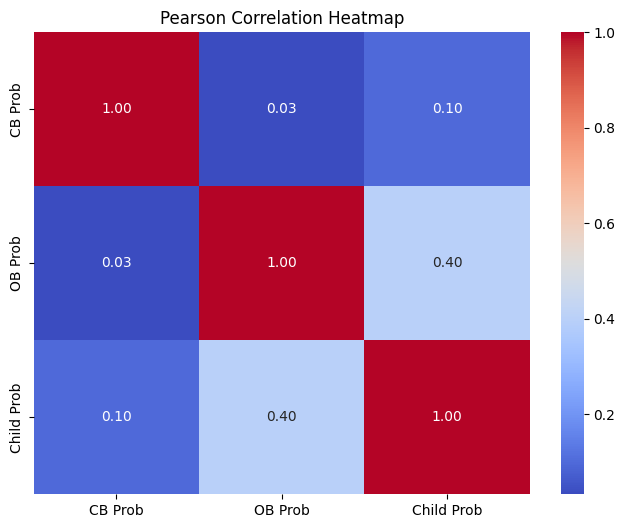

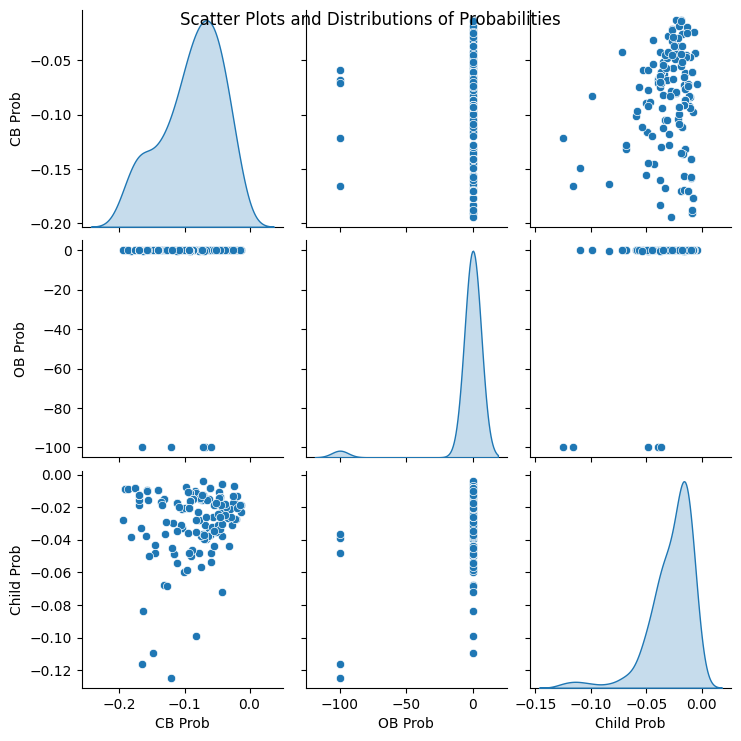

Pearson Correlation Matrix:
 [[1.         0.03211475 0.09772903]
 [0.03211475 1.         0.39848374]
 [0.09772903 0.39848374 1.        ]]
Spearman Correlation Matrix (approx):
 [[ 1.         -0.05973939  0.04263147]
 [-0.05973939  1.         -0.07555454]
 [ 0.04263147 -0.07555454  1.        ]]


In [15]:
# Extract probabilities
cb_probs = np.array(cb_probs)
ob_probs = np.array(ob_probs)
child_probs = np.array(child_probs)

# Combine probabilities into a matrix
data = np.vstack((cb_probs, ob_probs, child_probs)).T
labels = ["CB Prob", "OB Prob", "Child Prob"]

# Compute correlations
pearson_corr = np.corrcoef(data, rowvar=False)  # Pearson correlation
spearman_corr = np.corrcoef(np.argsort(data, axis=0), rowvar=False)  # Spearman approximation

# Display Pearson correlation as a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(pearson_corr, annot=True, xticklabels=labels, yticklabels=labels, cmap="coolwarm", fmt=".2f")
plt.title("Pearson Correlation Heatmap")
plt.show()

# Pairwise scatter plots
sns.pairplot(pd.DataFrame(data, columns=labels), kind="scatter", diag_kind="kde")
plt.suptitle("Scatter Plots and Distributions of Probabilities")
plt.show()

# Print correlation values
print("Pearson Correlation Matrix:\n", pearson_corr)
print("Spearman Correlation Matrix (approx):\n", spearman_corr)


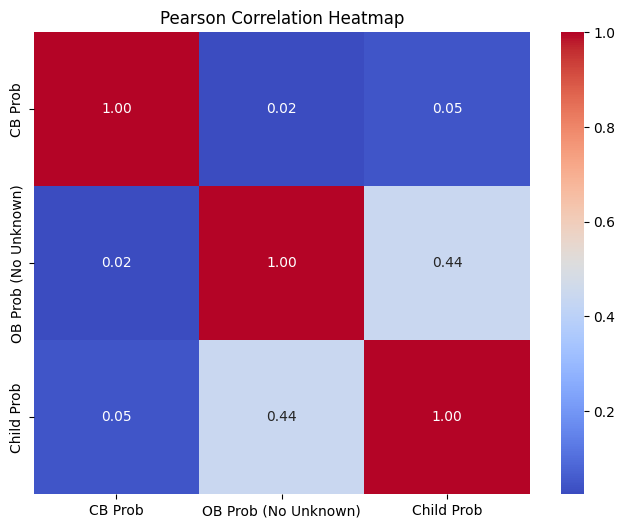

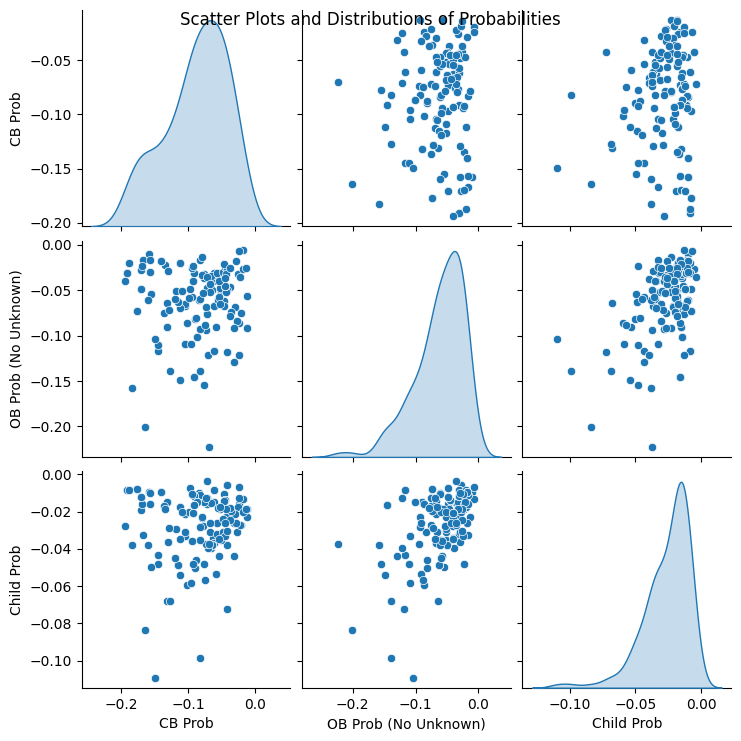

Pearson Correlation Matrix:
 [[1.         0.02427207 0.04523067]
 [0.02427207 1.         0.44029301]
 [0.04523067 0.44029301 1.        ]]
Spearman Correlation Matrix (approx):
 [[ 1.          0.0433611   0.08100398]
 [ 0.0433611   1.         -0.08490502]
 [ 0.08100398 -0.08490502  1.        ]]


In [16]:
# Doing the same but after removing the unknowns from ob_probs

# Extract probabilities
cb_probs = np.array(cb_probs)
ob_probs_without_unknown = np.array(ob_probs_without_unknown)
child_probs = np.array(child_probs)

# Combine probabilities into a matrix
data = np.vstack((cb_probs, ob_probs_without_unknown, child_probs)).T
labels = ["CB Prob", "OB Prob (No Unknown)", "Child Prob"]

# Remove rows where any value is NaN
valid_rows = ~np.isnan(data).any(axis=1)  # Identify rows with no NaN values
data_clean = data[valid_rows]

# Compute correlations
pearson_corr = np.corrcoef(data_clean, rowvar=False)  # Pearson correlation
spearman_corr = np.corrcoef(np.argsort(data_clean, axis=0), rowvar=False)  # Spearman approximation

# Display Pearson correlation as a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(pearson_corr, annot=True, xticklabels=labels, yticklabels=labels, cmap="coolwarm", fmt=".2f")
plt.title("Pearson Correlation Heatmap")
plt.show()

# Pairwise scatter plots
sns.pairplot(pd.DataFrame(data_clean, columns=labels), kind="scatter", diag_kind="kde")
plt.suptitle("Scatter Plots and Distributions of Probabilities")
plt.show()

# Print correlation values
print("Pearson Correlation Matrix:\n", pearson_corr)
print("Spearman Correlation Matrix (approx):\n", spearman_corr)


# Checking Question Lengths with the answers ?

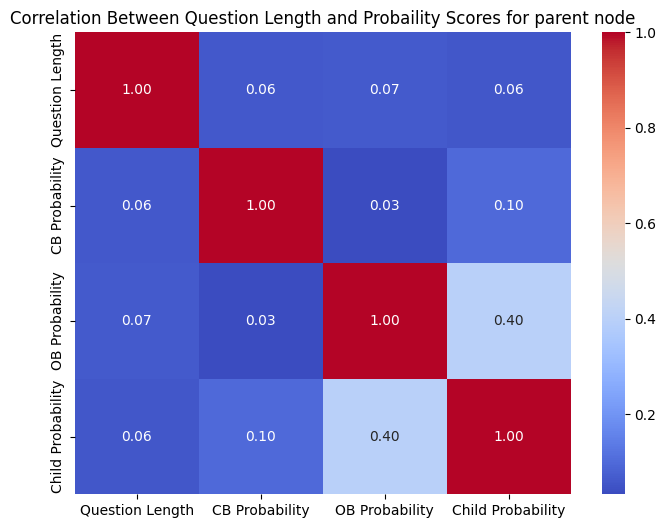

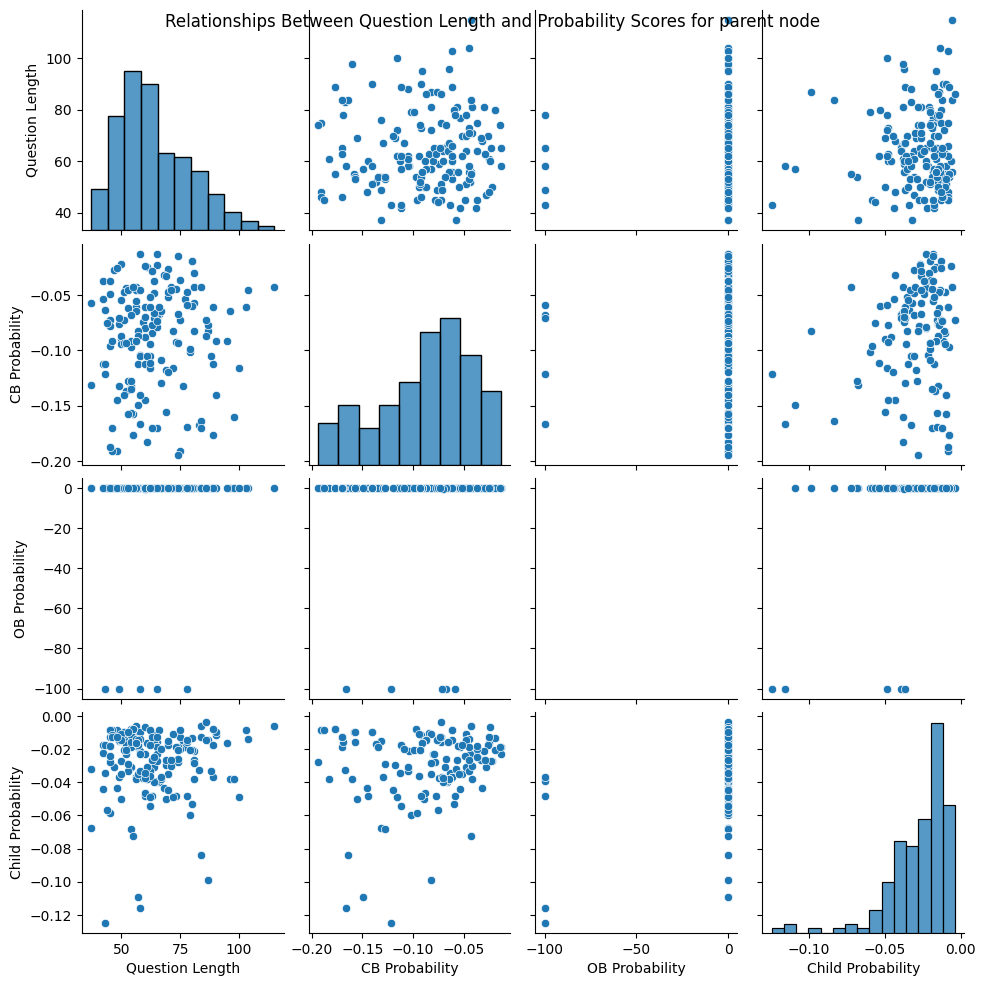

       Question Length  CB Probability  OB Probability  Child Probability
count       162.000000      162.000000      162.000000         162.000000
mean         64.080247       -0.088703       -3.146842          -0.027686
std          15.036592        0.046204       17.337825           0.020364
min          37.000000       -0.194006     -100.000000          -0.124694
25%          53.250000       -0.115513       -0.087766          -0.036865
50%          62.000000       -0.081031       -0.055369          -0.020862
75%          74.000000       -0.053333       -0.031703          -0.014433
max         115.000000       -0.012788       -0.006325          -0.003709


In [17]:
# Create a DataFrame
data = pd.DataFrame({
    "Question Length": parent_question_lengths,
    "CB Probability": cb_probs,
    "OB Probability": ob_probs,
    "Child Probability": child_probs
})

# Pairwise correlation matrix
correlation_matrix = data.corr()

# Correlation heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Correlation Between Question Length and Probaility Scores for parent node")
plt.show()

# Scatter plots
sns.pairplot(data)
plt.suptitle("Relationships Between Question Length and Probability Scores for parent node")
plt.show()

# Summary statistics
print(data.describe())

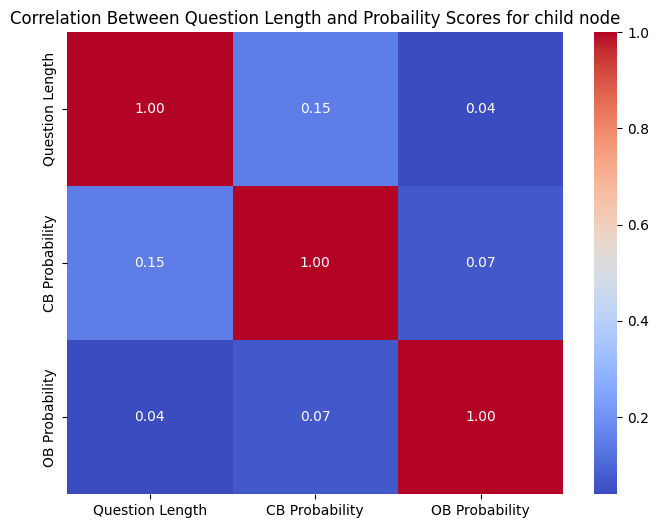

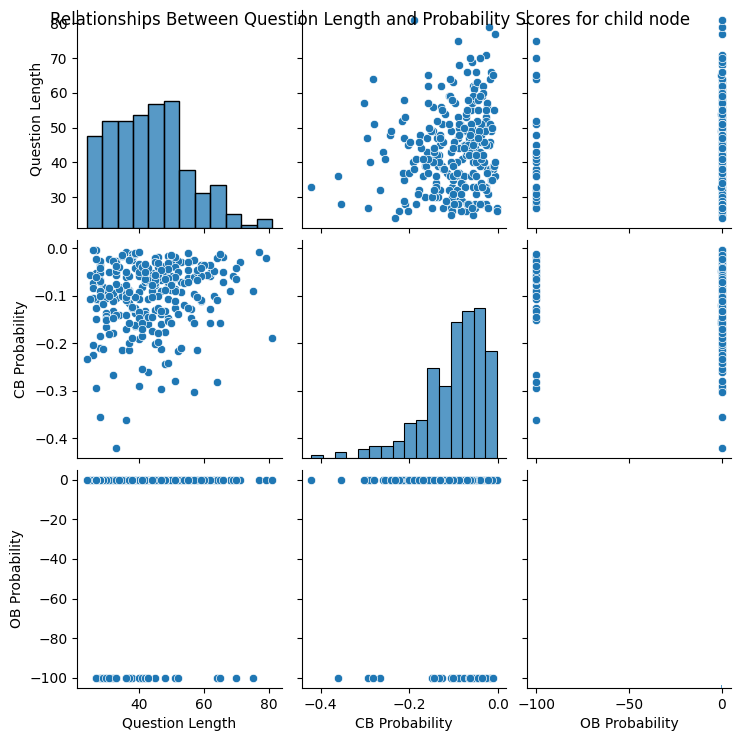

       Question Length  CB Probability  OB Probability
count       288.000000      288.000000      288.000000
mean         43.385417       -0.099014       -9.416858
std          11.579481        0.070229       29.185335
min          24.000000       -0.420886     -100.000000
25%          34.000000       -0.137705       -0.082342
50%          42.000000       -0.083685       -0.041993
75%          50.000000       -0.050333       -0.019458
max          81.000000       -0.002947       -0.000369


In [18]:
# Create a DataFrame
data = pd.DataFrame({
    "Question Length": child_question_lengths,
    "CB Probability": leaf_cb_probs,
    "OB Probability": leaf_ob_probs,
})

# Pairwise correlation matrix
correlation_matrix = data.corr()

# Correlation heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Correlation Between Question Length and Probaility Scores for child node")
plt.show()

# Scatter plots
sns.pairplot(data)
plt.suptitle("Relationships Between Question Length and Probability Scores for child node")
plt.show()

# Summary statistics
print(data.describe())

# Number of Children ? 

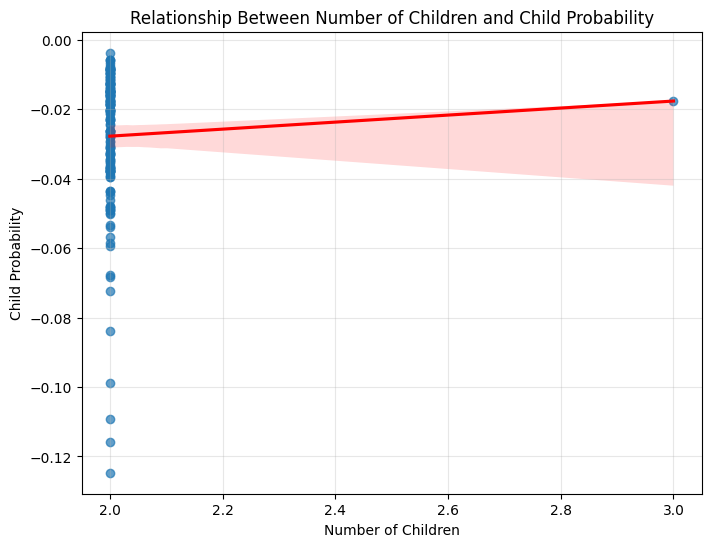

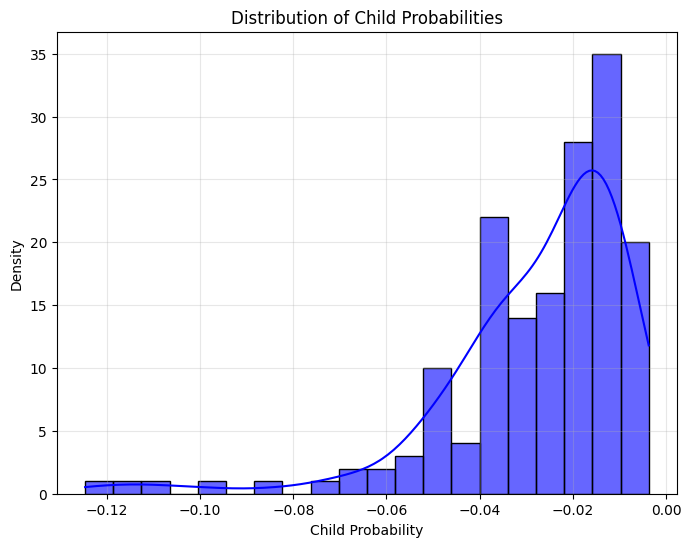

In [19]:
# Filter case in child_probs where probability is < -1, note children_count is corresponding to child_probs
child_probs_filtered = [p for p in child_probs if p > -10]
children_count_filtered = [c for c, p in zip(children_count, child_probs) if p > -10]

# Create a DataFrame
data = pd.DataFrame({
    "Number of children": children_count_filtered,
    "Child Probability": child_probs_filtered
})

plt.figure(figsize=(8, 6))
sns.regplot(
    x="Number of children", 
    y="Child Probability", 
    data=data, 
    scatter_kws={"alpha": 0.7}, 
    line_kws={"color": "red"}
)
plt.title("Relationship Between Number of Children and Child Probability")
plt.xlabel("Number of Children")
plt.ylabel("Child Probability")
plt.grid(alpha=0.3)
plt.show()

plt.figure(figsize=(8, 6))
sns.histplot(data["Child Probability"], kde=True, bins=20, color="blue", alpha=0.6)
plt.title("Distribution of Child Probabilities")
plt.xlabel("Child Probability")
plt.ylabel("Density")
plt.grid(alpha=0.3)
plt.show()


# Agreement/Disagreement Across Predictions (CB, OB, and Final Answers)

In [130]:
# DataFrame for easier manipulation
all_nodes_merged = np.concatenate(trees, axis=0 )
df = pd.DataFrame(all_nodes_merged)

# Extract the JSON data from the first column
df = pd.json_normalize(df.iloc[:, 0])
df

,idx,question_text,sons,qd_logprob,fa,question,cb_answer,ob_answer,answer,example_index,child_answer
0,0,Who is Queen Hyojeong married to?,[],NaN,2.0,Who is Queen Hyojeong married to?,"[King Cheoljong., -0.053805460199916666, Queen...","[King Heonjong of Joseon., -0.0499639829000093...","[King Heonjong of Joseon., -0.0499639829000093...",0,NaN
1,1,Who is the father of <1>?,[],NaN,2.0,Who is the father of King Heonjong of Joseon.?,"[King Taejong of Joseon., -0.05121584034369556...","[Crown Prince Hyomyeong., -0.02629438206243368...","[Crown Prince Hyomyeong., -0.02629438206243368...",0,NaN
2,2,Who is the father-in-law of Queen Hyojeong?,"[0, 1]",-0.029848,NaN,Who is the father-in-law of Queen Hyojeong?,"[King Yeongjo., -0.0630911321835115, Queen Hyo...","[Crown Prince Hyomyeong., -0.04009066118152483...","[Crown Prince Hyomyeong., -0.03432032035946477...",0,"[Crown Prince Hyomyeong., -0.03432032035946477..."
3,0,When was Grouplogic established?,[],NaN,2.0,When was Grouplogic established?,"[1992., -0.13188666797733334, Grouplogic was e...","[1988., -0.013281994173255558, GroupLogic was ...","[1988., -0.013281994173255558, GroupLogic was ...",1,NaN
4,1,When was Inbios established?,[],NaN,2.0,When was Inbios established?,"[1992., -0.18596439989711822, Inbios was estab...","[1996., -0.006155124742492142, InBios Internat...","[1996., -0.006155124742492142, InBios Internat...",1,NaN
...,...,...,...,...,...,...,...,...,...,...,...
445,1,Who is the father of <1>'s father?,[],NaN,2.0,"Who is the father of Albert VI, Prince of Anha...","[Fredericka of Anhalt-Zerbst.], -0.07101736673...","[Albert IV, Prince of Anhalt-Köthen., -0.00982...","[Albert IV, Prince of Anhalt-Köthen., -0.00982...",123,NaN
446,2,"Who is Philip, Prince Of Anhalt-Köthen's pater...","[0, 1]",-0.014822,NaN,"Who is Philip, Prince Of Anhalt-Köthen's pater...","[Emanuel Lebrecht, Prince of Anhalt-Köthen., -...","[Albert IV, Prince of Anhalt-Köthen., -0.06532...","[Albert IV, Prince of Anhalt-Köthen., -0.01739...",123,"[Albert IV, Prince of Anhalt-Köthen., -0.01739..."
447,0,Who is the composer of film Salome (1953 Film)?,[],NaN,2.0,Who is the composer of film Salome (1953 Film)?,"[Heinz Roemheld., -0.13185644121775367, The fi...","[George Duning and Daniele Amfitheatrof., -0.0...","[George Duning and Daniele Amfitheatrof., -0.0...",124,NaN
448,1,What is the place of birth of <1>?,[],NaN,2.0,What is the place of birth of George Duning an...,[they were born in different places (New York ...,"[Unknown., -100, Unknown.]",[they were born in different places (New York ...,124,NaN


In [21]:
import re
import string

def normalize_answer(s):

    def remove_articles(text):
        return re.sub(r'\b(a|an|the)\b', ' ', text)

    def white_space_fix(text):
        return ' '.join(text.split())

    def remove_punc(text):
        exclude = set(string.punctuation)
        return ''.join(ch for ch in text if ch not in exclude)

    def lower(text):
        return text.lower()

    return white_space_fix(remove_articles(remove_punc(lower(s))))

In [22]:
# Agreement count between the different answers for the same question
df['cb_ob_agreement'] = ((df['cb_answer'].apply(lambda x: normalize_answer(x[0])) == df['ob_answer'].apply(lambda x: normalize_answer(x[0])) )
                        & (df['cb_answer'].apply(lambda x: x[1]) > - 10) & (df['ob_answer'].apply(lambda x: x[1]) > - 10))     # Ensuring that we dont count unknown cases as agreement

df['cb_child_agreement'] = ((df['cb_answer'].apply(lambda x: normalize_answer(x[0])) == df['child_answer'].apply(lambda x: normalize_answer(x[0]) if isinstance(x, list) else None))
                            & (df['cb_answer'].apply(lambda x: x[1]) > - 10) & (df['child_answer'].apply(lambda x: x[1] if isinstance(x, list) else -1000) > - 10))  # Ensuring that we dont count unknown cases as agreement

df['ob_child_agreement'] = ((df['ob_answer'].apply(lambda x: normalize_answer(x[0])) == df['child_answer'].apply(lambda x: normalize_answer(x[0]) if isinstance(x, list) else None))
                            & (df['ob_answer'].apply(lambda x: x[1]) > - 10) & (df['child_answer'].apply(lambda x: x[1] if isinstance(x, list) else -1000) > - 10))  # Ensuring that we dont count unknown cases as agreement

agreement_freq_cb_ob = df['cb_ob_agreement'].mean()  # Calculate frequency of agreement
agreement_freq_cb_child = df['cb_child_agreement'].mean()  # Calculate frequency of agreement
agreement_freq_ob_child = df['ob_child_agreement'].mean()  # Calculate frequency of agreement

print(f"Agreement Frequency between cb and ob: {agreement_freq_cb_ob * 100:.2f}% , Total: {df['cb_ob_agreement'].sum()}")
print(f"Agreement Frequency between cb and child: {agreement_freq_cb_child * 100:.2f}%, Total: {df['cb_child_agreement'].sum()}")
print(f"Agreement Frequency between child and ob: {agreement_freq_ob_child * 100:.2f}%, Total: {df['ob_child_agreement'].sum()}")

Agreement Frequency between cb and ob: 23.33% , Total: 105
Agreement Frequency between cb and child: 11.56%, Total: 52
Agreement Frequency between child and ob: 20.89%, Total: 94


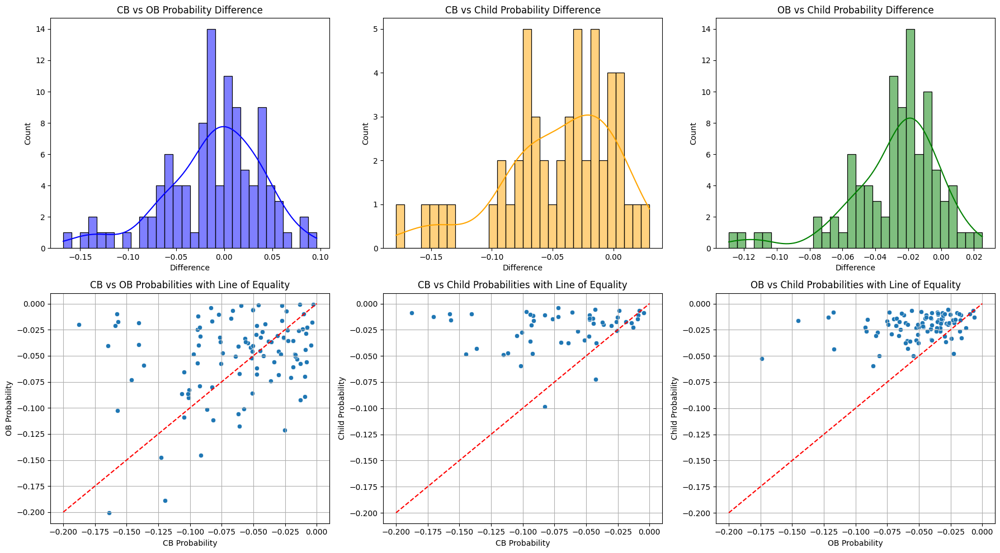

In [23]:
# 1. Create the DataFrame for each type of agreement comparison

# CB and OB probabilities
cb_ob_agreement_indices = df[df['cb_ob_agreement']].index
cb_probs_cb_ob_agreement = df.loc[cb_ob_agreement_indices, 'cb_answer'].apply(lambda x: x[1])
ob_probs_cb_ob_agreement = df.loc[cb_ob_agreement_indices, 'ob_answer'].apply(lambda x: x[1])

# CB and Child probabilities
cb_child_agreement_indices = df[df['cb_child_agreement']].index
cb_probs_cb_child_agreement = df.loc[cb_child_agreement_indices, 'cb_answer'].apply(lambda x: x[1])
child_probs_cb_child_agreement = df.loc[cb_child_agreement_indices, 'child_answer'].apply(lambda x: x[1] if isinstance(x, list) else None)

# OB and Child probabilities
ob_child_agreement_indices = df[df['ob_child_agreement']].index
ob_probs_ob_child_agreement = df.loc[ob_child_agreement_indices, 'ob_answer'].apply(lambda x: x[1])
child_probs_ob_child_agreement = df.loc[ob_child_agreement_indices, 'child_answer'].apply(lambda x: x[1] if isinstance(x, list) else None)

# Create DataFrame for each comparison
data_cb_ob = pd.DataFrame({
    "CB Probability": cb_probs_cb_ob_agreement,
    "OB Probability": ob_probs_cb_ob_agreement,
    "Difference": cb_probs_cb_ob_agreement - ob_probs_cb_ob_agreement
})

data_cb_child = pd.DataFrame({
    "CB Probability": cb_probs_cb_child_agreement,
    "Child Probability": child_probs_cb_child_agreement,
    "Difference": cb_probs_cb_child_agreement - child_probs_cb_child_agreement
})

data_ob_child = pd.DataFrame({
    "OB Probability": ob_probs_ob_child_agreement,
    "Child Probability": child_probs_ob_child_agreement,
    "Difference": ob_probs_ob_child_agreement - child_probs_ob_child_agreement
})

# 2. Create the subplots (2 rows, 3 columns)
fig, axes = plt.subplots(2, 3, figsize=(18, 10))

# First row: Distribution of Differences
# CB vs OB Probability Difference
sns.histplot(data_cb_ob["Difference"], kde=True, color="blue", bins=30, ax=axes[0, 0])
axes[0, 0].set_title("CB vs OB Probability Difference")
axes[0, 0].set_xlabel("Difference")
axes[0, 0].set_ylabel("Count")

# CB vs Child Probability Difference
sns.histplot(data_cb_child["Difference"], kde=True, color="orange", bins=30, ax=axes[0, 1])
axes[0, 1].set_title("CB vs Child Probability Difference")
axes[0, 1].set_xlabel("Difference")
axes[0, 1].set_ylabel("Count")

# OB vs Child Probability Difference
sns.histplot(data_ob_child["Difference"], kde=True, color="green", bins=30, ax=axes[0, 2])
axes[0, 2].set_title("OB vs Child Probability Difference")
axes[0, 2].set_xlabel("Difference")
axes[0, 2].set_ylabel("Count")

# Second row: Scatter Plots
# CB vs OB Scatter Plot
sns.scatterplot(x="CB Probability", y="OB Probability", data=data_cb_ob, ax=axes[1, 0])
axes[1, 0].plot([-0.2, 0], [-0.2, 0], color="red", linestyle="--")
axes[1, 0].set_title("CB vs OB Probabilities with Line of Equality")
axes[1, 0].set_xlabel("CB Probability")
axes[1, 0].set_ylabel("OB Probability")
axes[1, 0].grid(True)

# CB vs Child Scatter Plot
sns.scatterplot(x="CB Probability", y="Child Probability", data=data_cb_child, ax=axes[1, 1])
axes[1, 1].plot([-0.2, 0], [-0.2, 0], color="red", linestyle="--")
axes[1, 1].set_title("CB vs Child Probabilities with Line of Equality")
axes[1, 1].set_xlabel("CB Probability")
axes[1, 1].set_ylabel("Child Probability")
axes[1, 1].grid(True)

# OB vs Child Scatter Plot
sns.scatterplot(x="OB Probability", y="Child Probability", data=data_ob_child, ax=axes[1, 2])
axes[1, 2].plot([-0.2, 0], [-0.2, 0], color="red", linestyle="--")
axes[1, 2].set_title("OB vs Child Probabilities with Line of Equality")
axes[1, 2].set_xlabel("OB Probability")
axes[1, 2].set_ylabel("Child Probability")
axes[1, 2].grid(True)

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()

### Confidence measure is not reliable !!!!

It's weird that even if we got the same answers, the COT probability measured for different types differ 
The main reason is because we are using an llm which is conditioned on the input (prompt in our case) and prompts for different types differ.

CB-OB : When they agree on the same answer, sometimes cb > ob and sometimes viceversa
CB-CHILD: Child probability is at most of the times larger than the cb when they agree on the same answer
OB-CHILD: Child probability is at most of the times larger than the ob when they agree on the same answer

In [24]:
# I want to print them side by side to see if there is a pattern, why one cot is better than the other
# for i in range(10):
#     print("CB Answer: ", data.iloc[i]['CB COT Answer'])
#     print("OB Answer: ", data.iloc[i]['OB COT Answer'])
#     print("Difference: ", data.iloc[i]['difference'])
#     print("\n")

Disagreement Frequency between cb and ob: 69.56% , Total: 313
Disagreement Frequency between cb and child: 24.44%, Total: 110
Disagreement Frequency between child and ob: 14.00%, Total: 63


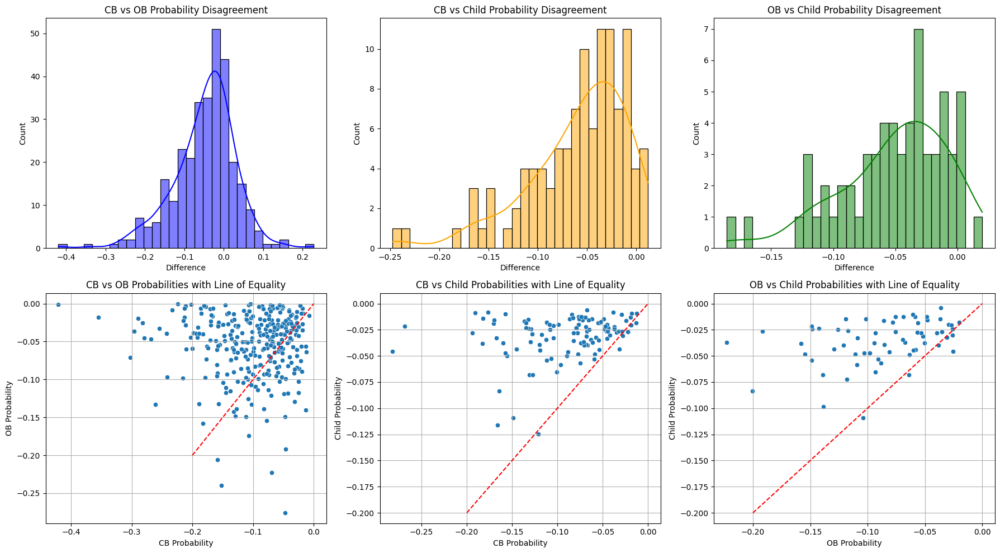

In [25]:
# Agreement count between the different answers for the same question
df['cb_ob_disagreement'] = ((df['cb_answer'].apply(lambda x: normalize_answer(x[0])) != df['ob_answer'].apply(lambda x: normalize_answer(x[0])) )
                            & (df['cb_answer'].apply(lambda x: x[1]) > - 10) & (df['ob_answer'].apply(lambda x: x[1]) > - 10))     # Ensuring that we dont count unknown cases as disagreement

df['cb_child_disagreement'] = ((df['cb_answer'].apply(lambda x: normalize_answer(x[0])) != df['child_answer'].apply(lambda x: normalize_answer(x[0]) if isinstance(x, list) else None))
                              & (df['cb_answer'].apply(lambda x: x[1]) > - 10) & (df['child_answer'].apply(lambda x: x[1] if isinstance(x, list) else -1000) > - 10))  # Ensuring that we dont count unknown cases as disagreement

df['ob_child_disagreement'] = ((df['ob_answer'].apply(lambda x: normalize_answer(x[0])) != df['child_answer'].apply(lambda x: normalize_answer(x[0]) if isinstance(x, list) else None))
                              & (df['ob_answer'].apply(lambda x: x[1]) > - 10) & (df['child_answer'].apply(lambda x: x[1] if isinstance(x, list) else -1000) > - 10))  # Ensuring that we dont count unknown cases as disagreement

disagreement_freq_cb_ob = df['cb_ob_disagreement'].mean()  # Calculate frequency of disagreement
disagreement_freq_cb_child = df['cb_child_disagreement'].mean()  # Calculate frequency of disagreement
disagreement_freq_ob_child = df['ob_child_disagreement'].mean()  # Calculate frequency of disagreement

print(f"Disagreement Frequency between cb and ob: {disagreement_freq_cb_ob * 100:.2f}% , Total: {df['cb_ob_disagreement'].sum()}")
print(f"Disagreement Frequency between cb and child: {disagreement_freq_cb_child * 100:.2f}%, Total: {df['cb_child_disagreement'].sum()}")
print(f"Disagreement Frequency between child and ob: {disagreement_freq_ob_child * 100:.2f}%, Total: {df['ob_child_disagreement'].sum()}")

# 1. Create the DataFrame for each type of disagreement comparison

# CB and OB probabilities
cb_ob_disagreement_indices = df[df['cb_ob_disagreement']].index
cb_probs_cb_ob_disagreement = df.loc[cb_ob_disagreement_indices, 'cb_answer'].apply(lambda x: x[1])
ob_probs_cb_ob_disagreement = df.loc[cb_ob_disagreement_indices, 'ob_answer'].apply(lambda x: x[1])

# CB and Child probabilities
cb_child_disagreement_indices = df[df['cb_child_disagreement']].index
cb_probs_cb_child_disagreement = df.loc[cb_child_disagreement_indices, 'cb_answer'].apply(lambda x: x[1])
child_probs_cb_child_disagreement = df.loc[cb_child_disagreement_indices, 'child_answer'].apply(lambda x: x[1] if isinstance(x, list) else None)

# OB and Child probabilities
ob_child_disagreement_indices = df[df['ob_child_disagreement']].index
ob_probs_ob_child_disagreement = df.loc[ob_child_disagreement_indices, 'ob_answer'].apply(lambda x: x[1])
child_probs_ob_child_disagreement = df.loc[ob_child_disagreement_indices, 'child_answer'].apply(lambda x: x[1] if isinstance(x, list) else None)

# Create DataFrame for each disagreement comparison
data_cb_ob_disagreement = pd.DataFrame({
    "CB Probability": cb_probs_cb_ob_disagreement,
    "OB Probability": ob_probs_cb_ob_disagreement,
    "Difference": cb_probs_cb_ob_disagreement - ob_probs_cb_ob_disagreement
})

data_cb_child_disagreement = pd.DataFrame({
    "CB Probability": cb_probs_cb_child_disagreement,
    "Child Probability": child_probs_cb_child_disagreement,
    "Difference": cb_probs_cb_child_disagreement - child_probs_cb_child_disagreement
})

data_ob_child_disagreement = pd.DataFrame({
    "OB Probability": ob_probs_ob_child_disagreement,
    "Child Probability": child_probs_ob_child_disagreement,
    "Difference": ob_probs_ob_child_disagreement - child_probs_ob_child_disagreement
})

# 2. Create the subplots (2 rows, 3 columns)
fig, axes = plt.subplots(2, 3, figsize=(18, 10))

# First row: Distribution of Differences
# CB vs OB Probability Difference
sns.histplot(data_cb_ob_disagreement["Difference"], kde=True, color="blue", bins=30, ax=axes[0, 0])
axes[0, 0].set_title("CB vs OB Probability Disagreement")
axes[0, 0].set_xlabel("Difference")
axes[0, 0].set_ylabel("Count")

# CB vs Child Probability Difference
sns.histplot(data_cb_child_disagreement["Difference"], kde=True, color="orange", bins=30, ax=axes[0, 1])
axes[0, 1].set_title("CB vs Child Probability Disagreement")
axes[0, 1].set_xlabel("Difference")
axes[0, 1].set_ylabel("Count")

# OB vs Child Probability Difference
sns.histplot(data_ob_child_disagreement["Difference"], kde=True, color="green", bins=30, ax=axes[0, 2])
axes[0, 2].set_title("OB vs Child Probability Disagreement")
axes[0, 2].set_xlabel("Difference")
axes[0, 2].set_ylabel("Count")

# Second row: Scatter Plots
# CB vs OB Scatter Plot
sns.scatterplot(x="CB Probability", y="OB Probability", data=data_cb_ob_disagreement, ax=axes[1, 0])
axes[1, 0].plot([-0.2, 0], [-0.2, 0], color="red", linestyle="--")
axes[1, 0].set_title("CB vs OB Probabilities with Line of Equality")
axes[1, 0].set_xlabel("CB Probability")
axes[1, 0].set_ylabel("OB Probability")
axes[1, 0].grid(True)

# CB vs Child Scatter Plot
sns.scatterplot(x="CB Probability", y="Child Probability", data=data_cb_child_disagreement, ax=axes[1, 1])
axes[1, 1].plot([-0.2, 0], [-0.2, 0], color="red", linestyle="--")
axes[1, 1].set_title("CB vs Child Probabilities with Line of Equality")
axes[1, 1].set_xlabel("CB Probability")
axes[1, 1].set_ylabel("Child Probability")
axes[1, 1].grid(True)

# OB vs Child Scatter Plot
sns.scatterplot(x="OB Probability", y="Child Probability", data=data_ob_child_disagreement, ax=axes[1, 2])
axes[1, 2].plot([-0.2, 0], [-0.2, 0], color="red", linestyle="--")
axes[1, 2].set_title("OB vs Child Probabilities with Line of Equality")
axes[1, 2].set_xlabel("OB Probability")
axes[1, 2].set_ylabel("Child Probability")
axes[1, 2].grid(True)

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()

# Unknown cases

In [26]:
unknown_cases_ob = df[df['ob_answer'].apply(lambda x: 'unknown' in (normalize_answer(x[0])) or (x[1] < -10))]
unknown_cases_cb = df[df['cb_answer'].apply(lambda x: 'unknown' in (normalize_answer(x[0])) or (x[1] < -10))]
unknown_cases_child = df[df['child_answer'].apply(lambda x: isinstance(x, list) and ('unknown' in normalize_answer(x[0]) or (x[1] < -10)))]

# Most of the unknowns are from ob !
print(unknown_cases_ob.shape[0], unknown_cases_cb.shape[0], unknown_cases_child.shape[0])
unknown_cases_all = pd.concat([unknown_cases_ob, unknown_cases_cb, unknown_cases_child])
unknown_cases_all

57 1 3


,idx,question_text,sons,qd_logprob,fa,question,cb_answer,ob_answer,answer,example_index,child_answer,cb_ob_agreement,cb_child_agreement,ob_child_agreement,cb_ob_disagreement,cb_child_disagreement,ob_child_disagreement
7,1,Where did <1> die?,[],NaN,2.0,Where did Peter Sasdy. die?,"[Los Angeles., -0.29426940642155, Peter Sasdy ...","[Unknown., -100, Unknown.]","[Los Angeles., -0.29426940642155, Peter Sasdy ...",2,NaN,False,False,False,False,False,False
8,2,Where was the place of death of the director o...,"[0, 1]",-0.005361,NaN,Where was the place of death of the director o...,"[Los Angeles., -0.08259560833883818, The film ...","[Unknown., -0.13869977365189937, The director ...","[Los Angeles., -0.08259560833883818, The film ...",2,"[Los Angeles., -0.09877940785222922, The direc...",False,True,False,True,False,True
21,0,Who is Edward Hoby's father?,[],NaN,2.0,Who is Edward Hoby's father?,"[John Hoby., -0.1059703945146, Edward Hoby's f...","[Unknown., -100, Unknown.]","[John Hoby., -0.1059703945146, Edward Hoby's f...",7,NaN,False,False,False,False,False,False
22,1,Where did <1> study?,[],NaN,2.0,Where did John Hoby. study?,"[Eton College., -0.14950476752555553, John Hob...","[Unknown., -100, Unknown.]","[Eton College., -0.14950476752555553, John Hob...",7,NaN,False,False,False,False,False,False
25,1,Who is the father of <1>?,[],NaN,2.0,Who is the father of Lady Louisa Jane Hamilton.?,"[James Hamilton, 6th Duke of Hamilton., -0.057...","[Unknown., -0.08275821016406874, The father of...","[James Hamilton, 6th Duke of Hamilton., -0.057...",8,NaN,False,False,False,True,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
448,1,What is the place of birth of <1>?,[],NaN,2.0,What is the place of birth of George Duning an...,[they were born in different places (New York ...,"[Unknown., -100, Unknown.]",[they were born in different places (New York ...,124,NaN,False,False,False,False,False,False
411,1,Where was <1> born?,[],NaN,2.0,Where was Pacorus II of Parthia. born?,"[unknown., -0.12291465519814107, Pacorus II of...","[Unknown., -0.1477944165965189, The text does ...","[unknown., -0.12291465519814107, Pacorus II of...",113,NaN,True,False,False,False,False,False
85,2,Where was the place of death of the director o...,"[0, 1]",-0.005583,NaN,Where was the place of death of the director o...,"[Munich., -0.0588474846326916, The film The Fi...","[Unknown., -100, Unknown.]","[Munich., -0.0588474846326916, The film The Fi...",25,"[Unknown., -0.04833102346397483, The film The ...",False,False,False,False,True,False
257,2,Which country the founder of Team Red Bull (Na...,"[0, 1]",-0.000549,NaN,Which country the founder of Team Red Bull (Na...,"[Austria., -0.02242854545127862, The founder o...","[Austria., -0.035382056265711996, The founder ...","[Austria., -0.02242854545127862, The founder o...",72,"[Unknown., -0.027139395538873644, The founders...",True,False,False,False,True,True


## Since ob has almost all of the unknown cases, We will focus on these cases only and see how cb and child act on such cases

In [27]:
# Investigate this more! maybe check correlation with this and unknown with respect to the probability ?

# Extract probabilities for 'unknown' cases
unknown_probs_ob = unknown_cases_all[['ob_answer']].apply(lambda x: x['ob_answer'][1], axis=1)
unknown_probs_cb = unknown_cases_all[['cb_answer']].apply(lambda x: x['cb_answer'][1], axis=1)
unknown_probs_child = unknown_cases_all[['child_answer']].apply(lambda x: x['child_answer'][1] if isinstance(x, list) else None, axis=1)

# Combine into a single DataFrame for analysis
unknown_case_probabilities = pd.DataFrame({
    'ob_probability': unknown_probs_ob,
    'cb_probability': unknown_probs_cb,
    'child_probability': unknown_probs_child
})

unknown_case_probabilities

# Note some of the ob_probability contains numbers not equal -100, this means they did some cot to the answer. (unknown)

,ob_probability,cb_probability,child_probability
7,-100.000000,-0.294269,None
8,-0.138700,-0.082596,None
21,-100.000000,-0.105970,None
22,-100.000000,-0.149505,None
25,-0.082758,-0.057449,None
...,...,...,...
448,-100.000000,-0.063902,None
411,-0.147794,-0.122915,None
85,-100.000000,-0.058847,None
257,-0.035382,-0.022429,None


In [28]:
# Found out child_probability is None in all of them, which means we got that in leaf nodes only and not in parent nodes
# That makes sense, since for parent node, we already some of the answers of children and use them in the parent ob.
# While for children, its more prune since it needs direct facts

unknown_probs_child.isna().sum()

61

## Checking how CB behaves when OB is known vs unknown

In [29]:
unknown_case_probabilities

,ob_probability,cb_probability,child_probability
7,-100.000000,-0.294269,None
8,-0.138700,-0.082596,None
21,-100.000000,-0.105970,None
22,-100.000000,-0.149505,None
25,-0.082758,-0.057449,None
...,...,...,...
448,-100.000000,-0.063902,None
411,-0.147794,-0.122915,None
85,-100.000000,-0.058847,None
257,-0.035382,-0.022429,None


In [30]:
# Filter for unknown ob_answer but known cb_answer
unknown_ob_known_cb_index = df[
    df['ob_answer'].apply(lambda x: 'unknown' in normalize_answer(x[0]) or x[1] < -10) & 
    ~df['cb_answer'].apply(lambda x: 'unknown' in normalize_answer(x[0]) or x[1] < -10)
].index

# Filter rows where cb is known and ob is unknown, to get meaningful numbers (dont damage the distribution)
unknown_ob_known_cb_probabilities = unknown_case_probabilities.loc[unknown_ob_known_cb_index]

# Display the filtered DataFrame
unknown_ob_known_cb_probabilities

,ob_probability,cb_probability,child_probability
7,-100.000000,-0.294269,None
8,-0.138700,-0.082596,None
21,-100.000000,-0.105970,None
22,-100.000000,-0.149505,None
25,-0.082758,-0.057449,None
26,-100.000000,-0.067822,None
31,-100.000000,-0.057724,None
37,-100.000000,-0.049102,None
38,-0.125795,-0.108297,None
47,-0.099768,-0.108732,None


In [31]:
# Drop rows from the DataFrame where both ob_answer and cb_answer are either 'unknown' or have -100 probability
combined_unknown_indices_from_cb_ob = unknown_cases_ob.index.union(unknown_cases_cb.index)

# Drop rows where either ob_answer or cb_answer is 'unknown' or has a probability of -100
df_ob_cb_known = df.drop(combined_unknown_indices_from_cb_ob)
df_ob_cb_known


,idx,question_text,sons,qd_logprob,fa,question,cb_answer,ob_answer,answer,example_index,child_answer,cb_ob_agreement,cb_child_agreement,ob_child_agreement,cb_ob_disagreement,cb_child_disagreement,ob_child_disagreement
0,0,Who is Queen Hyojeong married to?,[],NaN,2.0,Who is Queen Hyojeong married to?,"[King Cheoljong., -0.053805460199916666, Queen...","[King Heonjong of Joseon., -0.0499639829000093...","[King Heonjong of Joseon., -0.0499639829000093...",0,NaN,False,False,False,True,False,False
1,1,Who is the father of <1>?,[],NaN,2.0,Who is the father of King Heonjong of Joseon.?,"[King Taejong of Joseon., -0.05121584034369556...","[Crown Prince Hyomyeong., -0.02629438206243368...","[Crown Prince Hyomyeong., -0.02629438206243368...",0,NaN,False,False,False,True,False,False
2,2,Who is the father-in-law of Queen Hyojeong?,"[0, 1]",-0.029848,NaN,Who is the father-in-law of Queen Hyojeong?,"[King Yeongjo., -0.0630911321835115, Queen Hyo...","[Crown Prince Hyomyeong., -0.04009066118152483...","[Crown Prince Hyomyeong., -0.03432032035946477...",0,"[Crown Prince Hyomyeong., -0.03432032035946477...",False,False,True,True,True,False
3,0,When was Grouplogic established?,[],NaN,2.0,When was Grouplogic established?,"[1992., -0.13188666797733334, Grouplogic was e...","[1988., -0.013281994173255558, GroupLogic was ...","[1988., -0.013281994173255558, GroupLogic was ...",1,NaN,False,False,False,True,False,False
4,1,When was Inbios established?,[],NaN,2.0,When was Inbios established?,"[1992., -0.18596439989711822, Inbios was estab...","[1996., -0.006155124742492142, InBios Internat...","[1996., -0.006155124742492142, InBios Internat...",1,NaN,False,False,False,True,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
444,0,"Who is Philip, Prince Of Anhalt-Köthen's father?",[],NaN,2.0,"Who is Philip, Prince Of Anhalt-Köthen's father?","[Leopold, Prince of Anhalt-Köthen., -0.0644008...","[Albert VI, Prince of Anhalt-Köthen., -0.03153...","[Albert VI, Prince of Anhalt-Köthen., -0.03153...",123,NaN,False,False,False,True,False,False
445,1,Who is the father of <1>'s father?,[],NaN,2.0,"Who is the father of Albert VI, Prince of Anha...","[Fredericka of Anhalt-Zerbst.], -0.07101736673...","[Albert IV, Prince of Anhalt-Köthen., -0.00982...","[Albert IV, Prince of Anhalt-Köthen., -0.00982...",123,NaN,False,False,False,True,False,False
446,2,"Who is Philip, Prince Of Anhalt-Köthen's pater...","[0, 1]",-0.014822,NaN,"Who is Philip, Prince Of Anhalt-Köthen's pater...","[Emanuel Lebrecht, Prince of Anhalt-Köthen., -...","[Albert IV, Prince of Anhalt-Köthen., -0.06532...","[Albert IV, Prince of Anhalt-Köthen., -0.01739...",123,"[Albert IV, Prince of Anhalt-Köthen., -0.01739...",False,False,True,True,True,False
447,0,Who is the composer of film Salome (1953 Film)?,[],NaN,2.0,Who is the composer of film Salome (1953 Film)?,"[Heinz Roemheld., -0.13185644121775367, The fi...","[George Duning and Daniele Amfitheatrof., -0.0...","[George Duning and Daniele Amfitheatrof., -0.0...",124,NaN,False,False,False,True,False,False


/var/folders/0p/97g04f6j0xbd6n9kfwf97fs00000gn/T/ipykernel_385/601879343.py:10: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(cb_probs_ob_unknown, label="Unknown OB Cases", shade=True, color="red")
/var/folders/0p/97g04f6j0xbd6n9kfwf97fs00000gn/T/ipykernel_385/601879343.py:11: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(cb_probs_ob_cb_known, label="Known OB Cases", shade=True, color="blue")


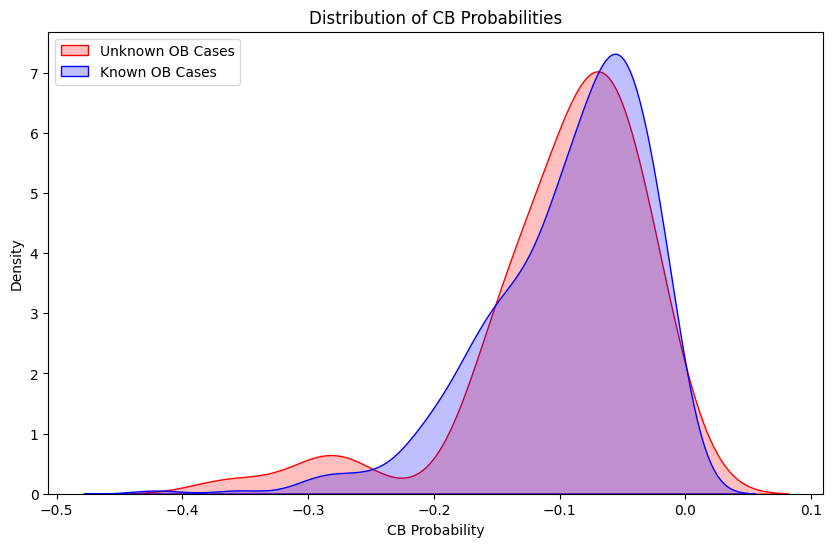

In [32]:
import matplotlib.pyplot as plt
import seaborn as sns

# Extract cb_probability for both groups
cb_probs_ob_unknown = unknown_ob_known_cb_probabilities['cb_probability']
cb_probs_ob_cb_known = df_ob_cb_known['cb_answer'].apply(lambda x: x[1])

# Plot the distributions
plt.figure(figsize=(10, 6))
sns.kdeplot(cb_probs_ob_unknown, label="Unknown OB Cases", shade=True, color="red")
sns.kdeplot(cb_probs_ob_cb_known, label="Known OB Cases", shade=True, color="blue")
plt.xlabel("CB Probability")
plt.ylabel("Density")
plt.title("Distribution of CB Probabilities")
plt.legend()
plt.show()

In [33]:
from scipy.stats import ks_2samp, mannwhitneyu

# Kolmogorov-Smirnov Test
ks_stat, ks_pval = ks_2samp(cb_probs_ob_unknown, cb_probs_ob_cb_known)
print(f"KS Test: Statistic = {ks_stat}, p-value = {ks_pval}")

# Mann-Whitney U Test
mw_stat, mw_pval = mannwhitneyu(cb_probs_ob_unknown, cb_probs_ob_cb_known, alternative='two-sided')
print(f"Mann-Whitney U Test: Statistic = {mw_stat}, p-value = {mw_pval}")


KS Test: Statistic = 0.10298647381813313, p-value = 0.6251934511992613
Mann-Whitney U Test: Statistic = 10902.0, p-value = 0.7453500365223603


1. Kolmogorov-Smirnov (KS) Test
Statistic: 0.0781
p-value: 0.7514

Interpretation:
The KS Test is used to compare the distributions of two samples. It measures the maximum difference between the empirical cumulative distribution functions (ECDF) of the two datasets. The null hypothesis for the KS test is that the two samples come from the same distribution.
In this case, the p-value is 0.7514, which is much higher than a typical significance threshold like 0.05. This means that there is no significant difference between the distributions of cb_probs_ob_unknown and cb_probs_ob_cb_known at the 5% significance level.
In simpler terms, the KS test suggests that the two samples (unknown cases and known cases) are likely drawn from the same distribution.


2. Mann-Whitney U Test
Statistic: 9090.0
p-value: 0.4616

Interpretation:
The Mann-Whitney U Test (also known as the Wilcoxon rank-sum test) is a non-parametric test used to compare whether two independent samples come from the same distribution. The null hypothesis is that the two samples have the same distribution, and the alternative is that they differ in some way (the direction is determined by the alternative argument).
The p-value is 0.4616, which again is much higher than 0.05. This suggests that there is no significant difference between the two samples, meaning the distributions of cb_probs_ob_unknown and cb_probs_ob_cb_known are statistically similar.
A higher Mann-Whitney U statistic (9090.0) further supports that the observed values do not significantly differ between the two groups.


Therefore, This means that either when ob is known or unknown --> This doesnt affect the cb answer we got from the llm. (I was hoping maybe there is some differences in confidence but no :)

## Checking Distribution of cb vs ob answers ?

/var/folders/0p/97g04f6j0xbd6n9kfwf97fs00000gn/T/ipykernel_385/71566090.py:5: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(ob_probs_ob_cb_known, label="OB", shade=True, color="red")
/var/folders/0p/97g04f6j0xbd6n9kfwf97fs00000gn/T/ipykernel_385/71566090.py:6: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(cb_probs_ob_cb_known, label="CB", shade=True, color="blue")


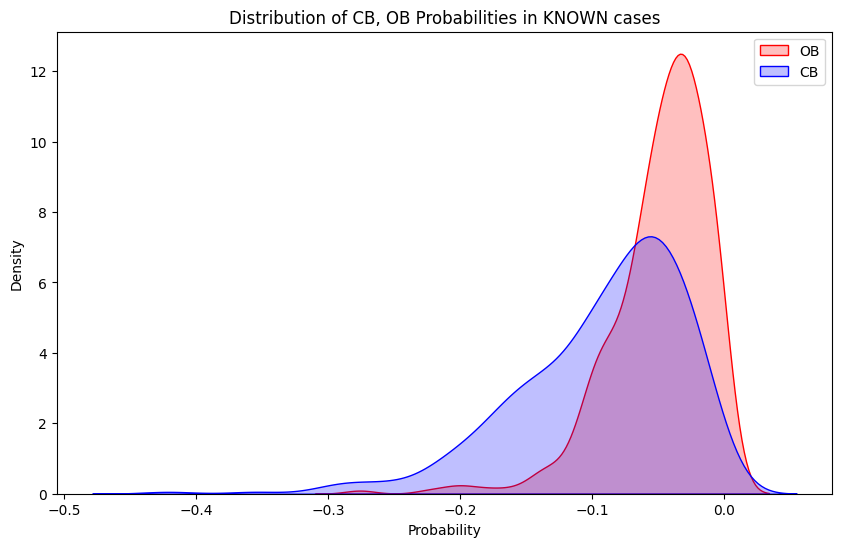

In [34]:
cb_probs_ob_cb_known = df_ob_cb_known['cb_answer'].apply(lambda x: x[1])
ob_probs_ob_cb_known = df_ob_cb_known['ob_answer'].apply(lambda x: x[1])

plt.figure(figsize=(10, 6))
sns.kdeplot(ob_probs_ob_cb_known, label="OB", shade=True, color="red")
sns.kdeplot(cb_probs_ob_cb_known, label="CB", shade=True, color="blue")
plt.xlabel("Probability")
plt.ylabel("Density")
plt.title("Distribution of CB, OB Probabilities in KNOWN cases")
plt.legend()
plt.show()


In [35]:
# Kolmogorov-Smirnov Test
ks_stat, ks_pval = ks_2samp(ob_probs_ob_cb_known, cb_probs_ob_cb_known)
print(f"KS Test: Statistic = {ks_stat}, p-value = {ks_pval}")

# Mann-Whitney U Test
mw_stat, mw_pval = mannwhitneyu(ob_probs_ob_cb_known, cb_probs_ob_cb_known, alternative='two-sided')
print(f"Mann-Whitney U Test: Statistic = {mw_stat}, p-value = {mw_pval}")


KS Test: Statistic = 0.35368956743002544, p-value = 3.234563859705822e-22
Mann-Whitney U Test: Statistic = 113000.0, p-value = 2.575603664148448e-29


1. Kolmogorov-Smirnov (KS) Test:
Statistic = 0.2517: The KS statistic measures the maximum difference between the cumulative distribution functions (CDF) of the two groups. A value closer to 0 indicates that the two distributions are more similar, while a value closer to 1 indicates they are more different. Here, 0.2517 suggests a moderate difference between the two distributions.
p-value = 0.000217: The p-value is very small, which suggests that the observed difference between the distributions is statistically significant. In other words, the probability distributions of the closed-book and open-book answers are likely different, and this difference is unlikely to be due to random chance.

2. Mann-Whitney U Test:
Statistic = 13101.0: The Mann-Whitney U test compares the ranks of the two distributions. A higher U statistic suggests that one group tends to have higher ranks (i.e., higher values) than the other. This statistic suggests a noticeable difference in the ranks between the two distributions.
p-value = 3.91e-05: The p-value is extremely small, indicating that the difference between the closed-book and open-book answer probabilities is statistically significant. This suggests that the two sets of probabilities come from different distributions, and it's highly unlikely that the difference is due to random chance.

## Investigating child result

### First investigating cb vs child

In [36]:
# get parent nodes where child is known
parent_nodes_child_known = df[df['child_answer'].apply(lambda x: isinstance(x, list) and not('unknown' in normalize_answer(x[0]) or (x[1] < -10)))]

# Drop rows from the DataFrame where both any answer from cb or child is either 'unknown' or have -100 probability
combined_unknown_indices_from_cb_child = unknown_cases_cb.index.union(unknown_cases_child.index)

valid_indices_to_drop = combined_unknown_indices_from_cb_child[combined_unknown_indices_from_cb_child.isin(parent_nodes_child_known.index)]

df_cb_child_known = parent_nodes_child_known.drop(valid_indices_to_drop)
df_cb_child_known

,idx,question_text,sons,qd_logprob,fa,question,cb_answer,ob_answer,answer,example_index,child_answer,cb_ob_agreement,cb_child_agreement,ob_child_agreement,cb_ob_disagreement,cb_child_disagreement,ob_child_disagreement
2,2,Who is the father-in-law of Queen Hyojeong?,"[0, 1]",-0.029848,NaN,Who is the father-in-law of Queen Hyojeong?,"[King Yeongjo., -0.0630911321835115, Queen Hyo...","[Crown Prince Hyomyeong., -0.04009066118152483...","[Crown Prince Hyomyeong., -0.03432032035946477...",0,"[Crown Prince Hyomyeong., -0.03432032035946477...",False,False,True,True,True,False
5,2,"Which one was established first, Grouplogic or...","[0, 1]",-0.004458,NaN,"Which one was established first, Grouplogic or...","[Grouplogic., -0.09714452133321846, Grouplogic...","[GroupLogic., -0.0482091428733015, GroupLogic ...","[Grouplogic., -0.007521251751184682, Grouplogi...",1,"[Grouplogic., -0.007521251751184682, Grouplogi...",True,True,True,False,False,False
8,2,Where was the place of death of the director o...,"[0, 1]",-0.005361,NaN,Where was the place of death of the director o...,"[Los Angeles., -0.08259560833883818, The film ...","[Unknown., -0.13869977365189937, The director ...","[Los Angeles., -0.08259560833883818, The film ...",2,"[Los Angeles., -0.09877940785222922, The direc...",False,True,False,True,False,True
11,2,Who is the child of the director of film Mukhy...,"[0, 1]",-0.002635,NaN,Who is the child of the director of film Mukhy...,"[Prakash Belawadi., -0.06681015820308657, The ...","[Sandip Choudhury., -0.03812676315545979, The ...","[Sandip Choudhury., -0.03812676315545979, The ...",3,"[Chumki Chowdhury, Rina Choudhury, and Sandip ...",False,False,False,True,True,True
14,2,"Which film was released earlier, The Devil'S M...","[0, 1]",-0.006484,NaN,"Which film was released earlier, The Devil'S M...","[both., -0.07261260871409658, The film The Dev...","[The Devil's Miner., -0.047643695676369516, Th...","[Don'T Tell., -0.015787623199486872, The film ...",4,"[Don'T Tell., -0.015787623199486872, The film ...",False,False,False,True,True,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
437,2,Are It’S A Matter Of Love and The Trusted Outl...,"[0, 1]",-0.017060,NaN,Are It’S A Matter Of Love and The Trusted Outl...,"[yes., -0.04487739709963255, It's a Matter of ...","[no., -0.03630452210799834, It's a Matter of L...","[No., -0.026271884989427827, It'S A Matter Of ...",120,"[No., -0.026271884989427827, It'S A Matter Of ...",False,False,True,True,True,False
440,2,Who is the paternal grandmother of Princess El...,"[0, 1]",-0.006577,NaN,Who is the paternal grandmother of Princess El...,"[Victoria, Princess Royal., -0.073758707895794...","[Landgravine Marie Anna of Hesse-Homburg., -0....","[Frederika Louisa of Hesse-Darmstadt., -0.0125...",121,"[Frederika Louisa of Hesse-Darmstadt., -0.0125...",False,False,False,True,True,True
443,2,Who was born first out of Li Yuyang and Adam R...,"[0, 1]",-0.005598,NaN,Who was born first out of Li Yuyang and Adam R...,"[Li Yuyang., -0.15751658615408481, Li Yuyang w...","[Adam Richman., -0.029480576425803214, Adam Ri...","[Adam Richman., -0.009883915488729998, Adam Ri...",122,"[Adam Richman., -0.009883915488729998, Adam Ri...",False,False,True,True,True,False
446,2,"Who is Philip, Prince Of Anhalt-Köthen's pater...","[0, 1]",-0.014822,NaN,"Who is Philip, Prince Of Anhalt-Köthen's pater...","[Emanuel Lebrecht, Prince of Anhalt-Köthen., -...","[Albert IV, Prince of Anhalt-Köthen., -0.06532...","[Albert IV, Prince of Anhalt-Köthen., -0.01739...",123,"[Albert IV, Prince of Anhalt-Köthen., -0.01739...",False,False,True,True,True,False


/var/folders/0p/97g04f6j0xbd6n9kfwf97fs00000gn/T/ipykernel_385/2013906384.py:5: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(cb_probs_child_cb_known, label="CB", shade=True, color="red")
/var/folders/0p/97g04f6j0xbd6n9kfwf97fs00000gn/T/ipykernel_385/2013906384.py:6: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(child_probs_child_cb_known, label="Child", shade=True, color="blue")


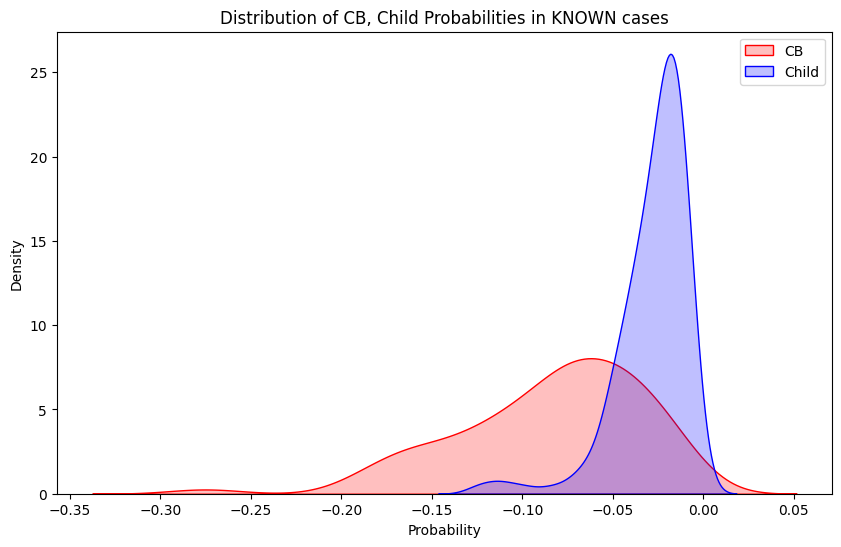

In [37]:
cb_probs_child_cb_known = df_cb_child_known['cb_answer'].apply(lambda x: x[1])
child_probs_child_cb_known = df_cb_child_known['child_answer'].apply(lambda x: x[1])

plt.figure(figsize=(10, 6))
sns.kdeplot(cb_probs_child_cb_known, label="CB", shade=True, color="red")
sns.kdeplot(child_probs_child_cb_known, label="Child", shade=True, color="blue")
plt.xlabel("Probability")
plt.ylabel("Density")
plt.title("Distribution of CB, Child Probabilities in KNOWN cases")
plt.legend()
plt.show()


# Checking the errors ?

In [38]:
q2a = {}
id2type = {}
for item in json.load(open("../../../data/2wiki/dev.json")):
    id2type[item["_id"]] = item["type"]
raw_data = [json.loads(line.strip()) for line in open('../../../released_data/2wikimultihopqa__v2_test_random_500.jsonl')]
q2gold = {}
for item in raw_data:
    try:
        question = item['question_text'].strip()
        # TODO:: should add it later but run prompts again 
        # question = re.sub(r'\s+', ' ', question)
        gold = item['answers_objects'][0]['spans'][0]
        q_type = id2type[item["question_id"]]
        q2gold[question] = (gold, q_type)
    except Exception as e:
        # If question not found in question_decompositions, this means something went wrong in the proccess maybe in json parsing in prev steps of tree generation
        print("ERROR CASE", e)

q2gold

{'Who is the father-in-law of Queen Hyojeong?': ('Crown Prince Hyomyeong',
  'inference'),
 'Which one was established first, Grouplogic or Inbios?': ('Grouplogic',
  'comparison'),
 'Where was the place of death of the director of film The Decision Of Christopher Blake?': ('Hollywood',
  'compositional'),
 'Who is the child of the director of film Mukhyamantri (1996 Film)?': ('Chumki Chowdhury',
  'compositional'),
 "Which film was released earlier, The Devil'S Miner or Don'T Tell?": ("The Devil'S Miner",
  'comparison'),
 'Who is younger, Halcón Suriano Jr. or Pierre De Geyter?': ('Halcón Suriano Jr.',
  'comparison'),
 "Where did Abe Laboriel Jr.'s father study?": ('Berklee College of Music',
  'compositional'),
 "Where did Edward Hoby's father study?": ("St. John's College, Cambridge",
  'compositional'),
 "Who is Lord Herbert Montagu Douglas Scott's maternal grandfather?": ('James Hamilton',
  'inference'),
 "Which film came out first, Poznań '56 or The Last Day Of School Before C

In [39]:
parent_nodes = df[df['sons'].apply(lambda x: len(x) != 0)]
child_nodes = df[~df['sons'].apply(lambda x: len(x) != 0)]

parent_nodes

,idx,question_text,sons,qd_logprob,fa,question,cb_answer,ob_answer,answer,example_index,child_answer,cb_ob_agreement,cb_child_agreement,ob_child_agreement,cb_ob_disagreement,cb_child_disagreement,ob_child_disagreement
2,2,Who is the father-in-law of Queen Hyojeong?,"[0, 1]",-0.029848,NaN,Who is the father-in-law of Queen Hyojeong?,"[King Yeongjo., -0.0630911321835115, Queen Hyo...","[Crown Prince Hyomyeong., -0.04009066118152483...","[Crown Prince Hyomyeong., -0.03432032035946477...",0,"[Crown Prince Hyomyeong., -0.03432032035946477...",False,False,True,True,True,False
5,2,"Which one was established first, Grouplogic or...","[0, 1]",-0.004458,NaN,"Which one was established first, Grouplogic or...","[Grouplogic., -0.09714452133321846, Grouplogic...","[GroupLogic., -0.0482091428733015, GroupLogic ...","[Grouplogic., -0.007521251751184682, Grouplogi...",1,"[Grouplogic., -0.007521251751184682, Grouplogi...",True,True,True,False,False,False
8,2,Where was the place of death of the director o...,"[0, 1]",-0.005361,NaN,Where was the place of death of the director o...,"[Los Angeles., -0.08259560833883818, The film ...","[Unknown., -0.13869977365189937, The director ...","[Los Angeles., -0.08259560833883818, The film ...",2,"[Los Angeles., -0.09877940785222922, The direc...",False,True,False,True,False,True
11,2,Who is the child of the director of film Mukhy...,"[0, 1]",-0.002635,NaN,Who is the child of the director of film Mukhy...,"[Prakash Belawadi., -0.06681015820308657, The ...","[Sandip Choudhury., -0.03812676315545979, The ...","[Sandip Choudhury., -0.03812676315545979, The ...",3,"[Chumki Chowdhury, Rina Choudhury, and Sandip ...",False,False,False,True,True,True
14,2,"Which film was released earlier, The Devil'S M...","[0, 1]",-0.006484,NaN,"Which film was released earlier, The Devil'S M...","[both., -0.07261260871409658, The film The Dev...","[The Devil's Miner., -0.047643695676369516, Th...","[Don'T Tell., -0.015787623199486872, The film ...",4,"[Don'T Tell., -0.015787623199486872, The film ...",False,False,False,True,True,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
437,2,Are It’S A Matter Of Love and The Trusted Outl...,"[0, 1]",-0.017060,NaN,Are It’S A Matter Of Love and The Trusted Outl...,"[yes., -0.04487739709963255, It's a Matter of ...","[no., -0.03630452210799834, It's a Matter of L...","[No., -0.026271884989427827, It'S A Matter Of ...",120,"[No., -0.026271884989427827, It'S A Matter Of ...",False,False,True,True,True,False
440,2,Who is the paternal grandmother of Princess El...,"[0, 1]",-0.006577,NaN,Who is the paternal grandmother of Princess El...,"[Victoria, Princess Royal., -0.073758707895794...","[Landgravine Marie Anna of Hesse-Homburg., -0....","[Frederika Louisa of Hesse-Darmstadt., -0.0125...",121,"[Frederika Louisa of Hesse-Darmstadt., -0.0125...",False,False,False,True,True,True
443,2,Who was born first out of Li Yuyang and Adam R...,"[0, 1]",-0.005598,NaN,Who was born first out of Li Yuyang and Adam R...,"[Li Yuyang., -0.15751658615408481, Li Yuyang w...","[Adam Richman., -0.029480576425803214, Adam Ri...","[Adam Richman., -0.009883915488729998, Adam Ri...",122,"[Adam Richman., -0.009883915488729998, Adam Ri...",False,False,True,True,True,False
446,2,"Who is Philip, Prince Of Anhalt-Köthen's pater...","[0, 1]",-0.014822,NaN,"Who is Philip, Prince Of Anhalt-Köthen's pater...","[Emanuel Lebrecht, Prince of Anhalt-Köthen., -...","[Albert IV, Prince of Anhalt-Köthen., -0.06532...","[Albert IV, Prince of Anhalt-Köthen., -0.01739...",123,"[Albert IV, Prince of Anhalt-Köthen., -0.01739...",False,False,True,True,True,False


In [40]:
parent_nodes['gold'] = parent_nodes['question_text'].apply(lambda question: q2gold[question][0] if question in q2gold else 'NOT FOUND!!')
parent_nodes['question_type'] = parent_nodes['question_text'].apply(lambda question: q2gold[question][1] if question in q2gold else 'NOT FOUND!!')
parent_nodes['prediction'] = parent_nodes['answer'].apply(lambda x: x[0])
parent_nodes

/var/folders/0p/97g04f6j0xbd6n9kfwf97fs00000gn/T/ipykernel_385/2953401523.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  parent_nodes['gold'] = parent_nodes['question_text'].apply(lambda question: q2gold[question][0] if question in q2gold else 'NOT FOUND!!')
/var/folders/0p/97g04f6j0xbd6n9kfwf97fs00000gn/T/ipykernel_385/2953401523.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  parent_nodes['question_type'] = parent_nodes['question_text'].apply(lambda question: q2gold[question][1] if question in q2

,idx,question_text,sons,qd_logprob,fa,question,cb_answer,ob_answer,answer,example_index,child_answer,cb_ob_agreement,cb_child_agreement,ob_child_agreement,cb_ob_disagreement,cb_child_disagreement,ob_child_disagreement,gold,question_type,prediction
2,2,Who is the father-in-law of Queen Hyojeong?,"[0, 1]",-0.029848,NaN,Who is the father-in-law of Queen Hyojeong?,"[King Yeongjo., -0.0630911321835115, Queen Hyo...","[Crown Prince Hyomyeong., -0.04009066118152483...","[Crown Prince Hyomyeong., -0.03432032035946477...",0,"[Crown Prince Hyomyeong., -0.03432032035946477...",False,False,True,True,True,False,Crown Prince Hyomyeong,inference,Crown Prince Hyomyeong.
5,2,"Which one was established first, Grouplogic or...","[0, 1]",-0.004458,NaN,"Which one was established first, Grouplogic or...","[Grouplogic., -0.09714452133321846, Grouplogic...","[GroupLogic., -0.0482091428733015, GroupLogic ...","[Grouplogic., -0.007521251751184682, Grouplogi...",1,"[Grouplogic., -0.007521251751184682, Grouplogi...",True,True,True,False,False,False,Grouplogic,comparison,Grouplogic.
8,2,Where was the place of death of the director o...,"[0, 1]",-0.005361,NaN,Where was the place of death of the director o...,"[Los Angeles., -0.08259560833883818, The film ...","[Unknown., -0.13869977365189937, The director ...","[Los Angeles., -0.08259560833883818, The film ...",2,"[Los Angeles., -0.09877940785222922, The direc...",False,True,False,True,False,True,Hollywood,compositional,Los Angeles.
11,2,Who is the child of the director of film Mukhy...,"[0, 1]",-0.002635,NaN,Who is the child of the director of film Mukhy...,"[Prakash Belawadi., -0.06681015820308657, The ...","[Sandip Choudhury., -0.03812676315545979, The ...","[Sandip Choudhury., -0.03812676315545979, The ...",3,"[Chumki Chowdhury, Rina Choudhury, and Sandip ...",False,False,False,True,True,True,Chumki Chowdhury,compositional,Sandip Choudhury.
14,2,"Which film was released earlier, The Devil'S M...","[0, 1]",-0.006484,NaN,"Which film was released earlier, The Devil'S M...","[both., -0.07261260871409658, The film The Dev...","[The Devil's Miner., -0.047643695676369516, Th...","[Don'T Tell., -0.015787623199486872, The film ...",4,"[Don'T Tell., -0.015787623199486872, The film ...",False,False,False,True,True,True,The Devil'S Miner,comparison,Don'T Tell.
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
437,2,Are It’S A Matter Of Love and The Trusted Outl...,"[0, 1]",-0.017060,NaN,Are It’S A Matter Of Love and The Trusted Outl...,"[yes., -0.04487739709963255, It's a Matter of ...","[no., -0.03630452210799834, It's a Matter of L...","[No., -0.026271884989427827, It'S A Matter Of ...",120,"[No., -0.026271884989427827, It'S A Matter Of ...",False,False,True,True,True,False,no,comparison,No.
440,2,Who is the paternal grandmother of Princess El...,"[0, 1]",-0.006577,NaN,Who is the paternal grandmother of Princess El...,"[Victoria, Princess Royal., -0.073758707895794...","[Landgravine Marie Anna of Hesse-Homburg., -0....","[Frederika Louisa of Hesse-Darmstadt., -0.0125...",121,"[Frederika Louisa of Hesse-Darmstadt., -0.0125...",False,False,False,True,True,True,Frederika Louisa of Hesse-Darmstadt,inference,Frederika Louisa of Hesse-Darmstadt.
443,2,Who was born first out of Li Yuyang and Adam R...,"[0, 1]",-0.005598,NaN,Who was born first out of Li Yuyang and Adam R...,"[Li Yuyang., -0.15751658615408481, Li Yuyang w...","[Adam Richman., -0.029480576425803214, Adam Ri...","[Adam Richman., -0.009883915488729998, Adam Ri...",122,"[Adam Richman., -0.009883915488729998, Adam Ri...",False,False,True,True,True,False,Adam Richman,comparison,Adam Richman.
446,2,"Who is Philip, Prince Of Anhalt-Köthen's pater...","[0, 1]",-0.014822,NaN,"Who is Philip, Prince Of Anhalt-Köthen's pater...","[Emanuel Lebrecht, Prince of Anhalt-Köthen., -...","[Albert IV, Prince of Anhalt-Köthen., -0.06532...","[Albert IV, Prince of Anhalt-Köthen., -0.01739...",123,"[Albert IV, Prince of Anhalt-Köthen., -0.01739.

In [41]:
# Since here we have parent nodes to be original questions and also subquestions can be parent nodes (multi-hop)
# we already set gold to be NOT FOUND!! for subquestions, so we can filter them out
root_parent_nodes = parent_nodes[parent_nodes['gold'] != 'NOT FOUND!!']
non_root_parent_nodes = parent_nodes[parent_nodes['gold'] == 'NOT FOUND!!']

root_parent_nodes

,idx,question_text,sons,qd_logprob,fa,question,cb_answer,ob_answer,answer,example_index,child_answer,cb_ob_agreement,cb_child_agreement,ob_child_agreement,cb_ob_disagreement,cb_child_disagreement,ob_child_disagreement,gold,question_type,prediction
2,2,Who is the father-in-law of Queen Hyojeong?,"[0, 1]",-0.029848,NaN,Who is the father-in-law of Queen Hyojeong?,"[King Yeongjo., -0.0630911321835115, Queen Hyo...","[Crown Prince Hyomyeong., -0.04009066118152483...","[Crown Prince Hyomyeong., -0.03432032035946477...",0,"[Crown Prince Hyomyeong., -0.03432032035946477...",False,False,True,True,True,False,Crown Prince Hyomyeong,inference,Crown Prince Hyomyeong.
5,2,"Which one was established first, Grouplogic or...","[0, 1]",-0.004458,NaN,"Which one was established first, Grouplogic or...","[Grouplogic., -0.09714452133321846, Grouplogic...","[GroupLogic., -0.0482091428733015, GroupLogic ...","[Grouplogic., -0.007521251751184682, Grouplogi...",1,"[Grouplogic., -0.007521251751184682, Grouplogi...",True,True,True,False,False,False,Grouplogic,comparison,Grouplogic.
8,2,Where was the place of death of the director o...,"[0, 1]",-0.005361,NaN,Where was the place of death of the director o...,"[Los Angeles., -0.08259560833883818, The film ...","[Unknown., -0.13869977365189937, The director ...","[Los Angeles., -0.08259560833883818, The film ...",2,"[Los Angeles., -0.09877940785222922, The direc...",False,True,False,True,False,True,Hollywood,compositional,Los Angeles.
11,2,Who is the child of the director of film Mukhy...,"[0, 1]",-0.002635,NaN,Who is the child of the director of film Mukhy...,"[Prakash Belawadi., -0.06681015820308657, The ...","[Sandip Choudhury., -0.03812676315545979, The ...","[Sandip Choudhury., -0.03812676315545979, The ...",3,"[Chumki Chowdhury, Rina Choudhury, and Sandip ...",False,False,False,True,True,True,Chumki Chowdhury,compositional,Sandip Choudhury.
14,2,"Which film was released earlier, The Devil'S M...","[0, 1]",-0.006484,NaN,"Which film was released earlier, The Devil'S M...","[both., -0.07261260871409658, The film The Dev...","[The Devil's Miner., -0.047643695676369516, Th...","[Don'T Tell., -0.015787623199486872, The film ...",4,"[Don'T Tell., -0.015787623199486872, The film ...",False,False,False,True,True,True,The Devil'S Miner,comparison,Don'T Tell.
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
437,2,Are It’S A Matter Of Love and The Trusted Outl...,"[0, 1]",-0.017060,NaN,Are It’S A Matter Of Love and The Trusted Outl...,"[yes., -0.04487739709963255, It's a Matter of ...","[no., -0.03630452210799834, It's a Matter of L...","[No., -0.026271884989427827, It'S A Matter Of ...",120,"[No., -0.026271884989427827, It'S A Matter Of ...",False,False,True,True,True,False,no,comparison,No.
440,2,Who is the paternal grandmother of Princess El...,"[0, 1]",-0.006577,NaN,Who is the paternal grandmother of Princess El...,"[Victoria, Princess Royal., -0.073758707895794...","[Landgravine Marie Anna of Hesse-Homburg., -0....","[Frederika Louisa of Hesse-Darmstadt., -0.0125...",121,"[Frederika Louisa of Hesse-Darmstadt., -0.0125...",False,False,False,True,True,True,Frederika Louisa of Hesse-Darmstadt,inference,Frederika Louisa of Hesse-Darmstadt.
443,2,Who was born first out of Li Yuyang and Adam R...,"[0, 1]",-0.005598,NaN,Who was born first out of Li Yuyang and Adam R...,"[Li Yuyang., -0.15751658615408481, Li Yuyang w...","[Adam Richman., -0.029480576425803214, Adam Ri...","[Adam Richman., -0.009883915488729998, Adam Ri...",122,"[Adam Richman., -0.009883915488729998, Adam Ri...",False,False,True,True,True,False,Adam Richman,comparison,Adam Richman.
446,2,"Who is Philip, Prince Of Anhalt-Köthen's pater...","[0, 1]",-0.014822,NaN,"Who is Philip, Prince Of Anhalt-Köthen's pater...","[Emanuel Lebrecht, Prince of Anhalt-Köthen., -...","[Albert IV, Prince of Anhalt-Köthen., -0.06532...","[Albert IV, Prince of Anhalt-Köthen., -0.01739...",123,"[Albert IV, Prince of Anhalt-Köthen., -0.01739.

In [42]:
def normalize_answer(s):

    def remove_articles(text):
        return re.sub(r'\b(a|an|the)\b', ' ', text)

    def white_space_fix(text):
        return ' '.join(text.split())

    def remove_punc(text):
        exclude = set(string.punctuation)
        return ''.join(ch for ch in text if ch not in exclude)

    def lower(text):
        return text.lower()

    return white_space_fix(remove_articles(remove_punc(lower(s))))


def f1_score(prediction, ground_truth):
    normalized_prediction = normalize_answer(prediction)
    normalized_ground_truth = normalize_answer(ground_truth)

    ZERO_METRIC = (0, 0, 0)

    if normalized_prediction in ['yes', 'no', 'noanswer'] and normalized_prediction != normalized_ground_truth:
        return ZERO_METRIC
    if normalized_ground_truth in ['yes', 'no', 'noanswer'] and normalized_prediction != normalized_ground_truth:
        return ZERO_METRIC

    prediction_tokens = normalized_prediction.split()
    ground_truth_tokens = normalized_ground_truth.split()
    common = Counter(prediction_tokens) & Counter(ground_truth_tokens)
    num_same = sum(common.values())
    if num_same == 0:
        return ZERO_METRIC
    precision = 1.0 * num_same / len(prediction_tokens)
    recall = 1.0 * num_same / len(ground_truth_tokens)
    f1 = (2 * precision * recall) / (precision + recall)
    return f1, precision, recall


def exact_match_score(prediction, ground_truth):
    return (normalize_answer(prediction) == normalize_answer(ground_truth))

In [43]:
# Check if the predicted 'answer' matches the 'gold' answer
root_parent_nodes['exact_match'] = root_parent_nodes.apply(lambda x: exact_match_score(x['prediction'], x['gold']), axis=1)

# Calculate the accuracy of predictions
accuracy = root_parent_nodes['exact_match'].mean()
print(f"Overall accuracy of all parent nodes answer: {accuracy * 100:.2f}%")

Overall accuracy of all parent nodes answer: 55.20%


/var/folders/0p/97g04f6j0xbd6n9kfwf97fs00000gn/T/ipykernel_385/3946414045.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  root_parent_nodes['exact_match'] = root_parent_nodes.apply(lambda x: exact_match_score(x['prediction'], x['gold']), axis=1)


In [44]:
non_root_parent_nodes

,idx,question_text,sons,qd_logprob,fa,question,cb_answer,ob_answer,answer,example_index,child_answer,cb_ob_agreement,cb_child_agreement,ob_child_agreement,cb_ob_disagreement,cb_child_disagreement,ob_child_disagreement,gold,question_type,prediction
38,2,When was the director of film Gopalapuranam born?,"[0, 1]",-0.000006,6.0,When was the director of film Gopalapuranam born?,"[24 August 1934., -0.1082970140363617, The fil...","[Unknown., -0.1257953799210171, The director o...","[24 September 1938., -0.024625861932024592, Th...",12,"[24 September 1938., -0.024625861932024592, Th...",False,False,False,True,True,True,NOT FOUND!!,NOT FOUND!!,24 September 1938.
41,5,When was the director of film Here Is The Beau...,"[3, 4]",-0.000782,6.0,When was the director of film Here Is The Beau...,"[December 16, 1938., -0.07694293834629962, Her...","[25 October 1909., -0.05859714237138256, The d...","[October 25, 1909., -0.01232357813621513, The ...",12,"[October 25, 1909., -0.01232357813621513, The ...",False,False,False,True,True,True,NOT FOUND!!,NOT FOUND!!,"October 25, 1909."
72,2,When was the director of film The Adventures O...,"[0, 1]",-0.000008,6.0,When was the director of film The Adventures O...,"[August 2, 1965., -0.06770434606111969, The fi...","[27 August 1964., -0.02683735629858062, The di...","[27 August 1964., -0.005891687575741881, The f...",22,"[27 August 1964., -0.005891687575741881, The f...",False,False,True,True,True,False,NOT FOUND!!,NOT FOUND!!,27 August 1964.
75,5,"When was the director of film Harvest: 3,000 Y...","[3, 4]",-0.000868,6.0,"When was the director of film Harvest: 3,000 Y...","[March 4, 1946., -0.009152960095620936, The fi...","[March 4, 1946., -0.04428925633711635, The dir...","[March 4, 1946., -0.009152960095620936, The fi...",22,"[March 4, 1946., -0.011143179039258775, The fi...",True,True,True,False,False,False,NOT FOUND!!,NOT FOUND!!,"March 4, 1946."
88,2,Which country is the director of film Apache W...,"[0, 1]",-0.000007,6.0,Which country is the director of film Apache W...,"[United States., -0.11198718224107, The film A...","[Italy., -0.09787034470171081, The director of...","[United States., -0.04722428757572999, The dir...",26,"[United States., -0.04722428757572999, The dir...",False,True,False,True,False,True,NOT FOUND!!,NOT FOUND!!,United States.
91,5,Which country is the director of film Dime Wit...,"[3, 4]",-0.000904,6.0,Which country is the director of film Dime Wit...,"[United States., -0.04611026329949594, The fil...","[Unknown., -0.19182534489742278, The director ...","[America., -0.02619017189434493, The director ...",26,"[America., -0.02619017189434493, The director ...",False,False,False,True,True,True,NOT FOUND!!,NOT FOUND!!,America.
95,2,Which country is the director of film My Frien...,"[0, 1]",-0.000010,6.0,Which country is the director of film My Frien...,"[Argentina., -0.10054516355683767, The film My...","[Argentina., -0.08285682040874925, The directo...","[Argentina., -0.027631944873173907, The direct...",27,"[Argentina., -0.027631944873173907, The direct...",True,True,True,False,False,False,NOT FOUND!!,NOT FOUND!!,Argentina.
98,5,Which country is the director of film Punks (F...,"[3, 4]",-0.001321,6.0,Which country is the director of film Punks (F...,"[United States., -0.13669956257443586, The fil...","[United States., -0.05899674654793259, The dir...","[United States., -0.04280801939788921, The dir...",27,"[United States., -0.04280801939788921, The dir...",True,True,True,False,False,False,NOT FOUND!!,NOT FOUND!!,United States.
138,2,When did the director of film The Monkey Talks...,"[0, 1]",-0.000006,6.0,When did the director of film The Monkey Talks...,"[November 12, 1970., -0.11168452986665285, The...","[December 31, 1980., -0.06039413578758731, The...","[December 31, 1980., -0.01851495581736755, The...",40,"[December 31, 1980., -0.01851495581736755, The...",False,False,True,True,True,False,NOT FOUND!!,NOT FOUND!!,"December 31, 1980."
141,5,When did the director of film Vara

In [45]:
def get_max_ans(x):
    if x['cb_answer'][1] > x['ob_answer'][1] and x['cb_answer'][1] > x['child_answer'][1]: return "cb"
    if x['ob_answer'][1] > x['cb_answer'][1] and x['ob_answer'][1] > x['child_answer'][1]: return "ob"
    if x['child_answer'][1] > x['ob_answer'][1] and x['child_answer'][1] > x['cb_answer'][1]: return "child"

root_parent_nodes['chosen_answer'] = root_parent_nodes.apply(lambda x: get_max_ans(x), axis=1)
# non_root_parent_nodes['chosen_answer'] = non_root_parent_nodes.apply(lambda x: get_max_ans(x), axis=1)

root_parent_nodes

/var/folders/0p/97g04f6j0xbd6n9kfwf97fs00000gn/T/ipykernel_385/200890791.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  root_parent_nodes['chosen_answer'] = root_parent_nodes.apply(lambda x: get_max_ans(x), axis=1)


,idx,question_text,sons,qd_logprob,fa,question,cb_answer,ob_answer,answer,example_index,...,cb_child_agreement,ob_child_agreement,cb_ob_disagreement,cb_child_disagreement,ob_child_disagreement,gold,question_type,prediction,exact_match,chosen_answer
2,2,Who is the father-in-law of Queen Hyojeong?,"[0, 1]",-0.029848,NaN,Who is the father-in-law of Queen Hyojeong?,"[King Yeongjo., -0.0630911321835115, Queen Hyo...","[Crown Prince Hyomyeong., -0.04009066118152483...","[Crown Prince Hyomyeong., -0.03432032035946477...",0,...,False,True,True,True,False,Crown Prince Hyomyeong,inference,Crown Prince Hyomyeong.,True,child
5,2,"Which one was established first, Grouplogic or...","[0, 1]",-0.004458,NaN,"Which one was established first, Grouplogic or...","[Grouplogic., -0.09714452133321846, Grouplogic...","[GroupLogic., -0.0482091428733015, GroupLogic ...","[Grouplogic., -0.007521251751184682, Grouplogi...",1,...,True,True,False,False,False,Grouplogic,comparison,Grouplogic.,True,child
8,2,Where was the place of death of the director o...,"[0, 1]",-0.005361,NaN,Where was the place of death of the director o...,"[Los Angeles., -0.08259560833883818, The film ...","[Unknown., -0.13869977365189937, The director ...","[Los Angeles., -0.08259560833883818, The film ...",2,...,True,False,True,False,True,Hollywood,compositional,Los Angeles.,False,cb
11,2,Who is the child of the director of film Mukhy...,"[0, 1]",-0.002635,NaN,Who is the child of the director of film Mukhy...,"[Prakash Belawadi., -0.06681015820308657, The ...","[Sandip Choudhury., -0.03812676315545979, The ...","[Sandip Choudhury., -0.03812676315545979, The ...",3,...,False,False,True,True,True,Chumki Chowdhury,compositional,Sandip Choudhury.,False,ob
14,2,"Which film was released earlier, The Devil'S M...","[0, 1]",-0.006484,NaN,"Which film was released earlier, The Devil'S M...","[both., -0.07261260871409658, The film The Dev...","[The Devil's Miner., -0.047643695676369516, Th...","[Don'T Tell., -0.015787623199486872, The film ...",4,...,False,False,True,True,True,The Devil'S Miner,comparison,Don'T Tell.,False,child
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
437,2,Are It’S A Matter Of Love and The Trusted Outl...,"[0, 1]",-0.017060,NaN,Are It’S A Matter Of Love and The Trusted Outl...,"[yes., -0.04487739709963255, It's a Matter of ...","[no., -0.03630452210799834, It's a Matter of L...","[No., -0.026271884989427827, It'S A Matter Of ...",120,...,False,True,True,True,False,no,comparison,No.,True,child
440,2,Who is the paternal grandmother of Princess El...,"[0, 1]",-0.006577,NaN,Who is the paternal grandmother of Princess El...,"[Victoria, Princess Royal., -0.073758707895794...","[Landgravine Marie Anna of Hesse-Homburg., -0....","[Frederika Louisa of Hesse-Darmstadt., -0.0125...",121,...,False,False,True,True,True,Frederika Louisa of Hesse-Darmstadt,inference,Frederika Louisa of Hesse-Darmstadt.,True,child
443,2,Who was born first out of Li Yuyang and Adam R...,"[0, 1]",-0.005598,NaN,Who was born first out of Li Yuyang and Adam R...,"[Li Yuyang., -0.15751658615408481, Li Yuyang w...","[Adam Richman., -0.029480576425803214, Adam Ri...","[Adam Richman., -0.009883915488729998, Adam Ri...",122,...,False,True,True,True,False,Adam Richman,comparison,Adam Richman.,True,child
446,2,"Who is Philip, Prince Of Anhalt-Köthen's pater...","[0, 1]",-0.014822,NaN,"Who is Philip, Prince Of Anhalt-Köthen's pater...","[Emanuel Lebrecht, Prince of Anhalt-Köthen., -...","[Albert IV, Prince of Anhalt-Köthen., -0.06532...","[Albert IV, Prince of Anhalt-Köthen., -0.01739...",123,...,False,True,True,True,False,"Albert IV, Prince of Anhalt-Köthen",inference,"Albert IV, Prince of Anhalt-Köthen.",True,child


In [46]:
# Check the distribution of the 'chosen_answer' (i.e., which source is most frequently the chosen one)
answer_source_distribution = root_parent_nodes['chosen_answer'].value_counts(normalize=True)
print("Distribution of answer sources (cb, ob, child):")
print(answer_source_distribution)

Distribution of answer sources (cb, ob, child):
child    0.808
ob       0.104
cb       0.088
Name: chosen_answer, dtype: float64


In [47]:
# Filter out rows where the answer is incorrect
incorrect_answers = root_parent_nodes[root_parent_nodes['exact_match'] == False]

# Check how often each source is involved in incorrect answers
incorrect_answer_sources = incorrect_answers['chosen_answer'].value_counts()
print("Distribution of incorrect answer sources:")
print(incorrect_answer_sources)

Distribution of incorrect answer sources:
child    40
cb        9
ob        7
Name: chosen_answer, dtype: int64


In [48]:
# Calculate accuracy per question type
accuracy_by_type = root_parent_nodes.groupby('question_type')['exact_match'].mean()
print("Accuracy by question type:")
print(accuracy_by_type)

Accuracy by question type:
question_type
bridge_comparison    0.882353
comparison           0.896552
compositional        0.298246
inference            0.500000
Name: exact_match, dtype: float64


/var/folders/0p/97g04f6j0xbd6n9kfwf97fs00000gn/T/ipykernel_385/1729913509.py:5: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(cb_probs, label="CB Answer", shade=True, color="red")
/var/folders/0p/97g04f6j0xbd6n9kfwf97fs00000gn/T/ipykernel_385/1729913509.py:6: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(ob_probs, label="OB Answer", shade=True, color="blue")


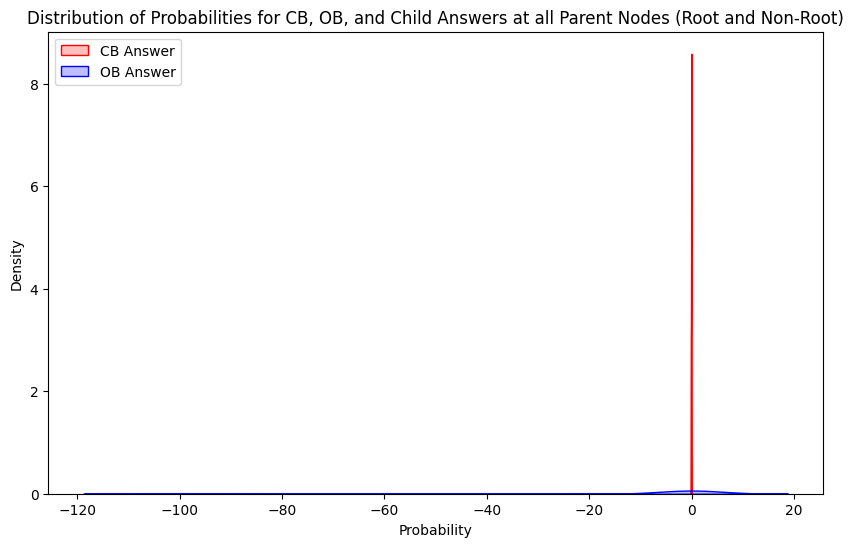

/var/folders/0p/97g04f6j0xbd6n9kfwf97fs00000gn/T/ipykernel_385/1729913509.py:19: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(child_probs, label="Child Answer", shade=True, color="green")


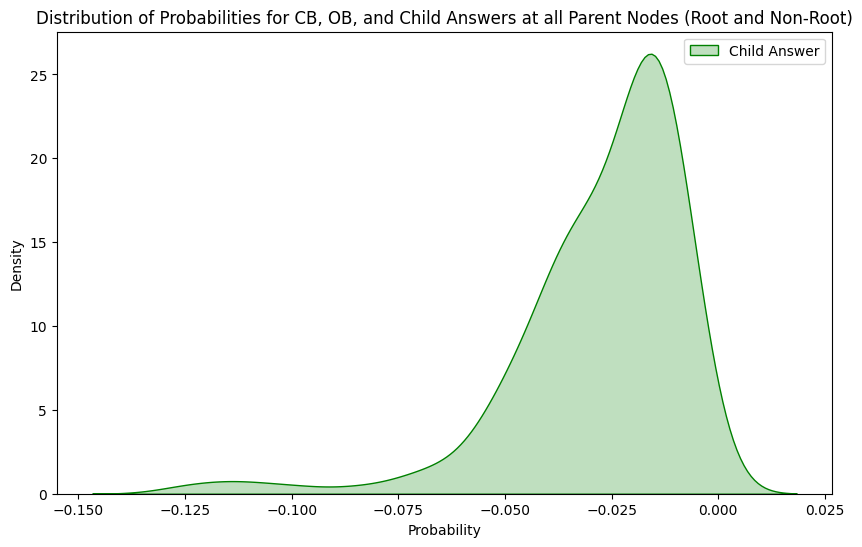

In [49]:
# Visualize the distribution of the probabilities for cb_answer, ob_answer, and child_answer to compare how confident the model is when it makes predictions.

# Assuming cb_answer, ob_answer, and child_answer have probability values
plt.figure(figsize=(10, 6))
sns.kdeplot(cb_probs, label="CB Answer", shade=True, color="red")
sns.kdeplot(ob_probs, label="OB Answer", shade=True, color="blue")
# sns.kdeplot(child_probs, label="Child Answer", shade=True, color="green")
plt.xlabel("Probability")
plt.ylabel("Density")
plt.title("Distribution of Probabilities for CB, OB, and Child Answers at all Parent Nodes (Root and Non-Root)")
plt.legend()
plt.show()


# Assuming cb_answer, ob_answer, and child_answer have probability values
plt.figure(figsize=(10, 6))
# sns.kdeplot(cb_probs, label="CB Answer", shade=True, color="red")
# sns.kdeplot(ob_probs, label="OB Answer", shade=True, color="blue")
sns.kdeplot(child_probs, label="Child Answer", shade=True, color="green")
plt.xlabel("Probability")
plt.ylabel("Density")
plt.title("Distribution of Probabilities for CB, OB, and Child Answers at all Parent Nodes (Root and Non-Root)")
plt.legend()
plt.show()



/var/folders/0p/97g04f6j0xbd6n9kfwf97fs00000gn/T/ipykernel_385/3691559536.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  root_parent_nodes['max_prob'] = root_parent_nodes['answer'].apply(lambda x: x[1])


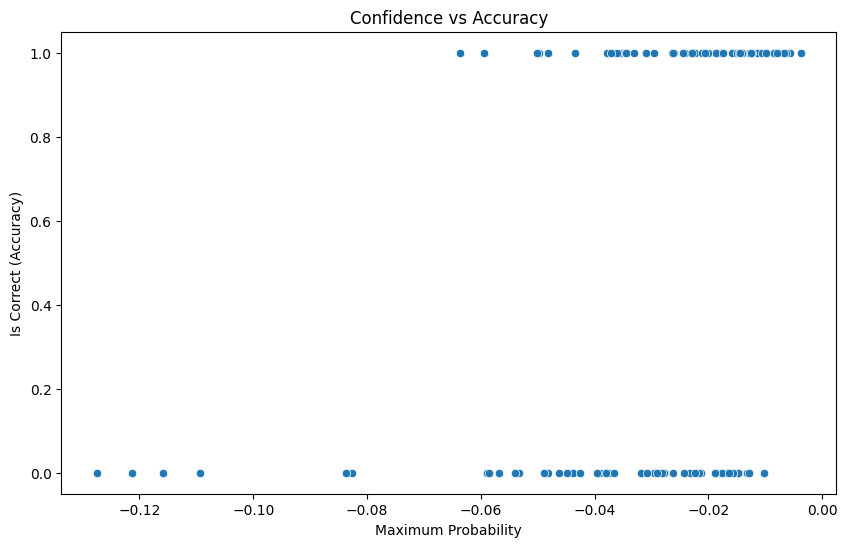

In [50]:
# Add a column for the maximum probability
root_parent_nodes['max_prob'] = root_parent_nodes['answer'].apply(lambda x: x[1])

# Plot confidence vs. accuracy
plt.figure(figsize=(10, 6))
sns.scatterplot(x=root_parent_nodes['max_prob'], y=root_parent_nodes['exact_match'])
plt.xlabel("Maximum Probability")
plt.ylabel("Is Correct (Accuracy)")
plt.title("Confidence vs Accuracy")
plt.show()


### Some analysis based on question type :)

/var/folders/0p/97g04f6j0xbd6n9kfwf97fs00000gn/T/ipykernel_385/63081664.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  root_parent_nodes[f'{answer_type}_exact_match'] = root_parent_nodes.apply(
/var/folders/0p/97g04f6j0xbd6n9kfwf97fs00000gn/T/ipykernel_385/63081664.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  root_parent_nodes[f'{answer_type}_exact_match'] = root_parent_nodes.apply(
/var/folders/0p/97g04f6j0xbd6n9kfwf97fs00000gn/T/ipykernel_385/63081664.py:2: SettingWithCopyWarning: 
A value is 

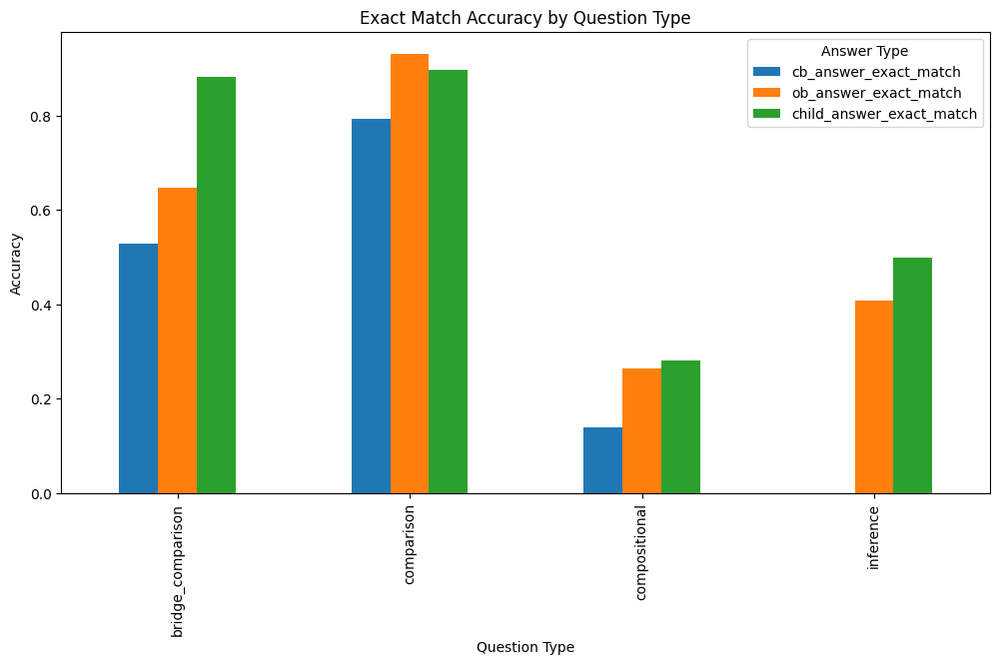

In [51]:
for answer_type in ['cb_answer', 'ob_answer', 'child_answer']:
    root_parent_nodes[f'{answer_type}_exact_match'] = root_parent_nodes.apply(
        lambda x: exact_match_score(x[answer_type][0], x['gold']), axis=1
    )

grouped = root_parent_nodes.groupby('question_type').agg({
    'cb_answer_exact_match': 'mean',
    'ob_answer_exact_match': 'mean',
    'child_answer_exact_match': 'mean',
    'question_text': 'count'  # Count of questions per type
}).rename(columns={'question_text': 'count'})


# Plot exact match accuracy for each answer type by question type
grouped[['cb_answer_exact_match', 'ob_answer_exact_match', 'child_answer_exact_match']].plot(
    kind='bar', figsize=(12, 6), title='Exact Match Accuracy by Question Type'
)
plt.ylabel('Accuracy')
plt.xlabel('Question Type')
plt.legend(title='Answer Type')
plt.show()


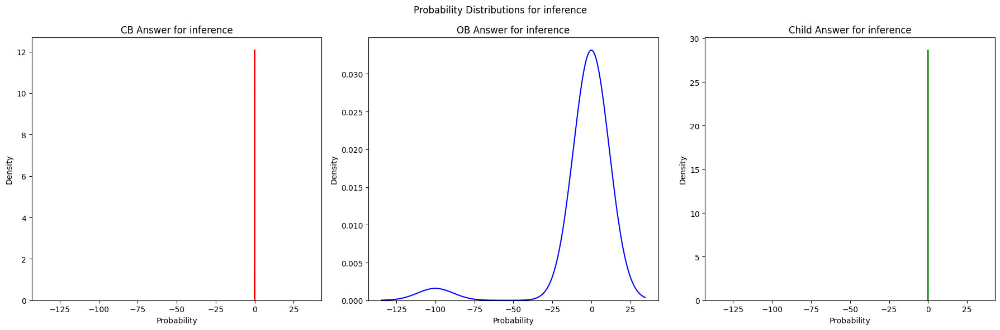

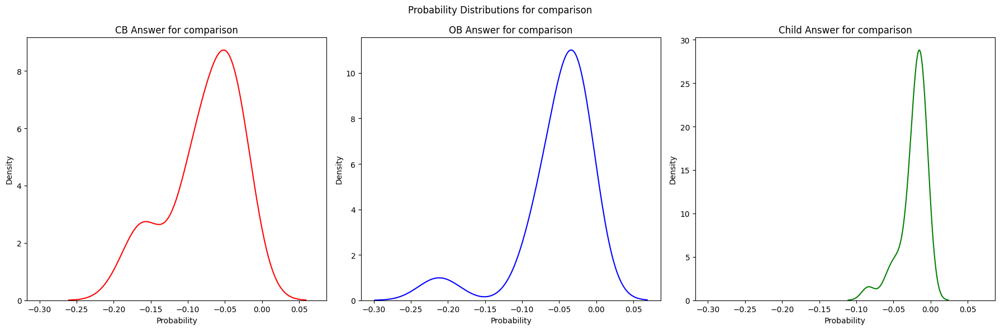

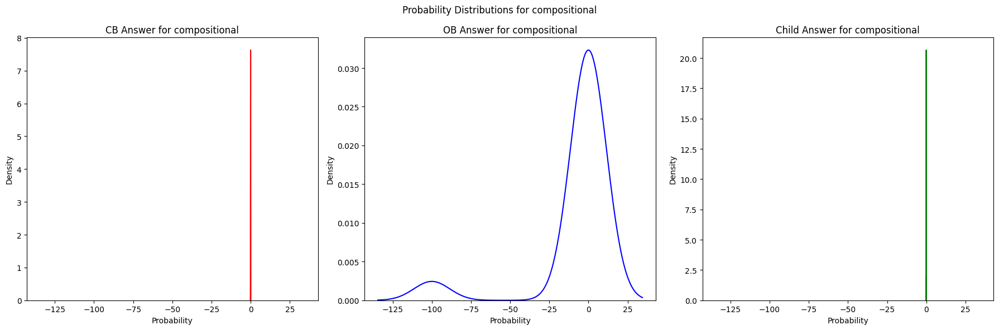

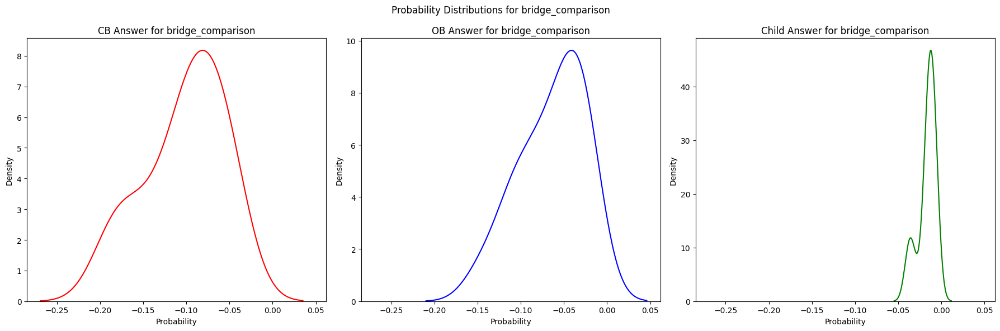

In [52]:
for question_type in root_parent_nodes['question_type'].unique():
    subset = root_parent_nodes[root_parent_nodes['question_type'] == question_type]
    fig, axes = plt.subplots(1, 3, figsize=(18, 6), sharex=True)
    
    sns.kdeplot(subset['cb_answer'].apply(lambda x: x[1]), ax=axes[0], color='red')
    axes[0].set_title(f'CB Answer for {question_type}')
    axes[0].set_xlabel('Probability')
    axes[0].set_ylabel('Density')
    
    sns.kdeplot(subset['ob_answer'].apply(lambda x: x[1]), ax=axes[1], color='blue')
    axes[1].set_title(f'OB Answer for {question_type}')
    axes[1].set_xlabel('Probability')
    
    sns.kdeplot(subset['child_answer'].apply(lambda x: x[1]), ax=axes[2], color='green')
    axes[2].set_title(f'Child Answer for {question_type}')
    axes[2].set_xlabel('Probability')
    
    plt.suptitle(f'Probability Distributions for {question_type}')
    plt.tight_layout()
    plt.show()


In [53]:
# Identify Question Types with High Discrepancies

grouped['max_gap'] = grouped[['cb_answer_exact_match', 'ob_answer_exact_match', 'child_answer_exact_match']].max(axis=1) - \
                     grouped[['cb_answer_exact_match', 'ob_answer_exact_match', 'child_answer_exact_match']].min(axis=1)

discrepancy_analysis = grouped[grouped['max_gap'] > 0.2].sort_values('max_gap', ascending=False)
discrepancy_analysis


,cb_answer_exact_match,ob_answer_exact_match,child_answer_exact_match,count,max_gap
question_type,,,,,
inference,0.000000,0.409091,0.500000,22,0.500000
bridge_comparison,0.529412,0.647059,0.882353,17,0.352941


### Do some error Analysis 

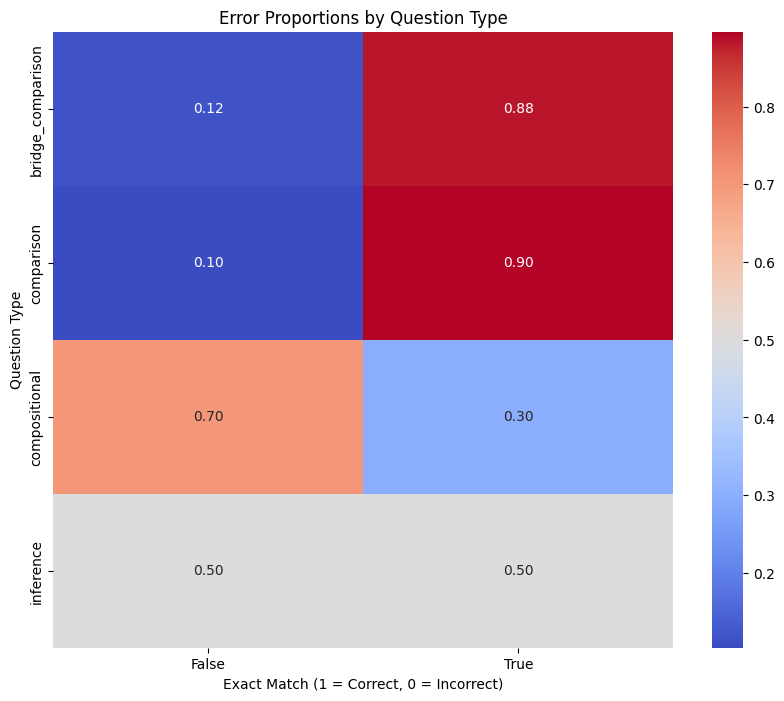

In [54]:
# Create a pivot table for heatmap
heatmap_data = root_parent_nodes.pivot_table(index='question_type', columns='exact_match', aggfunc='size', fill_value=0)

# Normalize to get proportions
heatmap_data = heatmap_data.div(heatmap_data.sum(axis=1), axis=0)

# Plot the heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(heatmap_data, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Error Proportions by Question Type')
plt.xlabel('Exact Match (1 = Correct, 0 = Incorrect)')
plt.ylabel('Question Type')
plt.show()


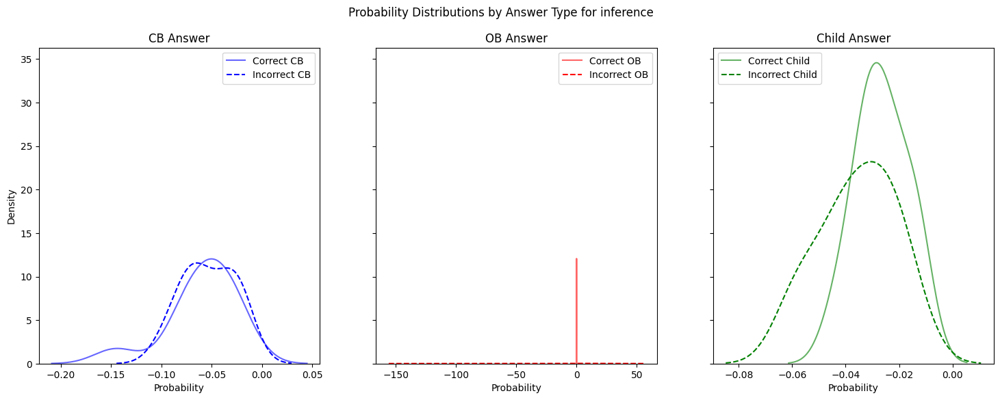

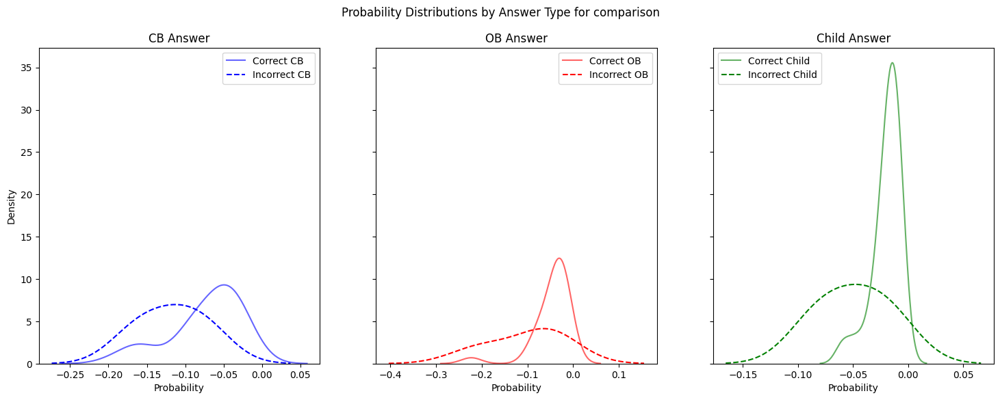

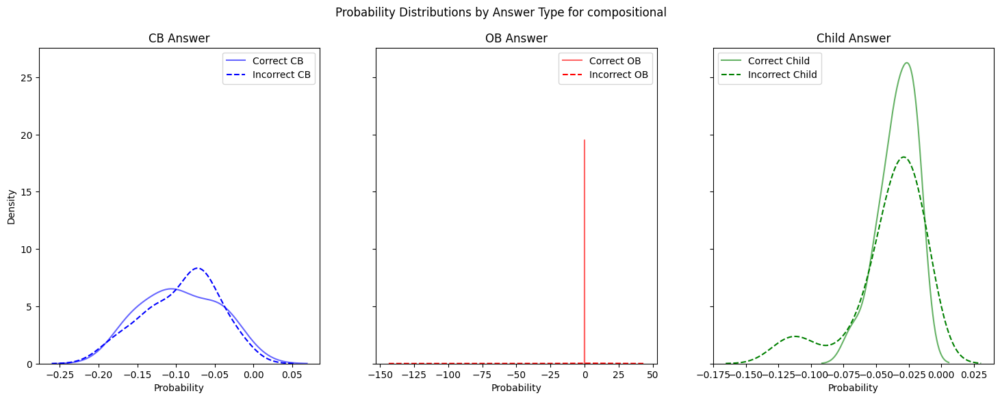

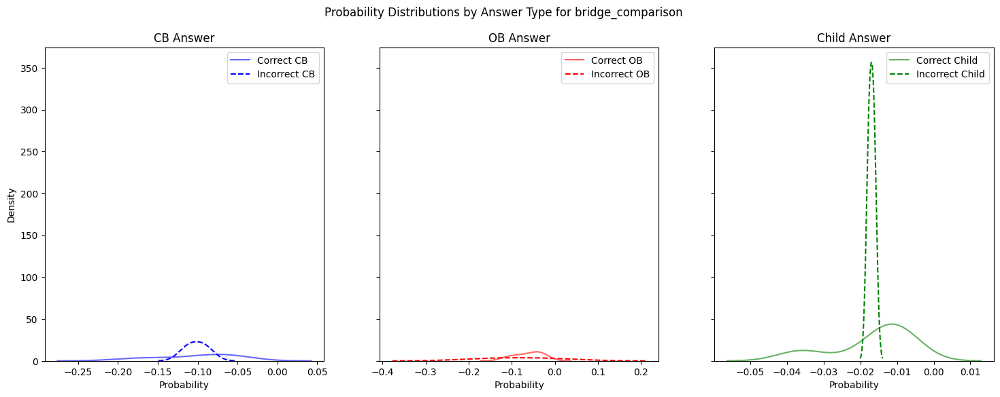

In [55]:
for question_type in root_parent_nodes['question_type'].unique():
    subset = root_parent_nodes[root_parent_nodes['question_type'] == question_type]
    correct = subset[subset['exact_match'] == 1]
    incorrect = subset[subset['exact_match'] == 0]
    
    fig, axes = plt.subplots(1, 3, figsize=(18, 6), sharey=True)
    sns.kdeplot(correct['cb_answer'].apply(lambda x: x[1]), label='Correct CB', ax=axes[0], color='blue', alpha=0.6)
    sns.kdeplot(incorrect['cb_answer'].apply(lambda x: x[1]), label='Incorrect CB', ax=axes[0], color='blue', linestyle='--')
    axes[0].set_title('CB Answer')
    
    sns.kdeplot(correct['ob_answer'].apply(lambda x: x[1]), label='Correct OB', ax=axes[1], color='red', alpha=0.6)
    sns.kdeplot(incorrect['ob_answer'].apply(lambda x: x[1]), label='Incorrect OB', ax=axes[1], color='red', linestyle='--')
    axes[1].set_title('OB Answer')
    
    sns.kdeplot(correct['child_answer'].apply(lambda x: x[1]), label='Correct Child', ax=axes[2], color='green', alpha=0.6)
    sns.kdeplot(incorrect['child_answer'].apply(lambda x: x[1]), label='Incorrect Child', ax=axes[2], color='green', linestyle='--')
    axes[2].set_title('Child Answer')
    
    for ax in axes:
        ax.set_xlabel('Probability')
        ax.set_ylabel('Density')
        ax.legend()
    
    fig.suptitle(f'Probability Distributions by Answer Type for {question_type}')
    plt.show()


In [56]:
# Filter rows where the answer is incorrect
incorrect_rows = root_parent_nodes[root_parent_nodes['exact_match'] == False]
correct_rows = root_parent_nodes[root_parent_nodes['exact_match'] == True]

print("# of incorrect answers based on exact match: ", incorrect_rows.shape[0], "out of", root_parent_nodes.shape[0])
print("# of correct answers based on exact match: ", correct_rows.shape[0], "out of", root_parent_nodes.shape[0])

# Look at the top 10 most common incorrect answers (both predicted and gold)
incorrect_rows.head(10)

# of incorrect answers based on exact match:  56 out of 125
# of correct answers based on exact match:  69 out of 125


,idx,question_text,sons,qd_logprob,fa,question,cb_answer,ob_answer,answer,example_index,...,ob_child_disagreement,gold,question_type,prediction,exact_match,chosen_answer,max_prob,cb_answer_exact_match,ob_answer_exact_match,child_answer_exact_match
8,2,Where was the place of death of the director o...,"[0, 1]",-0.005361,NaN,Where was the place of death of the director o...,"[Los Angeles., -0.08259560833883818, The film ...","[Unknown., -0.13869977365189937, The director ...","[Los Angeles., -0.08259560833883818, The film ...",2,...,True,Hollywood,compositional,Los Angeles.,False,cb,-0.082596,False,False,False
11,2,Who is the child of the director of film Mukhy...,"[0, 1]",-0.002635,NaN,Who is the child of the director of film Mukhy...,"[Prakash Belawadi., -0.06681015820308657, The ...","[Sandip Choudhury., -0.03812676315545979, The ...","[Sandip Choudhury., -0.03812676315545979, The ...",3,...,True,Chumki Chowdhury,compositional,Sandip Choudhury.,False,ob,-0.038127,False,False,False
14,2,"Which film was released earlier, The Devil'S M...","[0, 1]",-0.006484,NaN,"Which film was released earlier, The Devil'S M...","[both., -0.07261260871409658, The film The Dev...","[The Devil's Miner., -0.047643695676369516, Th...","[Don'T Tell., -0.015787623199486872, The film ...",4,...,True,The Devil'S Miner,comparison,Don'T Tell.,False,child,-0.015788,False,True,False
26,2,Who is Lord Herbert Montagu Douglas Scott's ma...,"[0, 1]",-0.037223,NaN,Who is Lord Herbert Montagu Douglas Scott's ma...,"[Alexander Oxenbridge., -0.0678222933235314, L...",[Lord Herbert Montagu Douglas Scott's father i...,"[James Hamilton, 6th Duke of Hamilton., -0.039...",8,...,False,James Hamilton,inference,"James Hamilton, 6th Duke of Hamilton.",False,child,-0.039073,False,False,False
35,2,Which country the director of film Snow Flower...,"[0, 1]",-0.000436,NaN,Which country the director of film Snow Flower...,"[China., -0.04215542614389, The film Snow Flow...","[Hong Kong., -0.05028329784848332, The directo...","[China., -0.0377175818108064, The director of ...",11,...,True,American,compositional,China.,False,child,-0.037718,False,False,False
51,2,Where was the director of film Eisenstein In G...,"[0, 1]",-0.001271,NaN,Where was the director of film Eisenstein In G...,"[Mexico City., -0.024513101653155598, The film...","[Unknown., -0.08603726610700632, The director ...","[Mexico City, Mexico., -0.016022120971062342, ...",15,...,True,"Newport, Wales",compositional,"Mexico City, Mexico.",False,child,-0.016022,False,False,False
54,2,"Where did George Tryon, 1St Baron Tryon's fath...","[0, 1]",-0.028416,NaN,"Where did George Tryon, 1St Baron Tryon's fath...","[Bulwick., -0.0617052700348532, George Tryon, ...","[off Tripoli, Lebanon., -0.031465780834652596,...","[off Tripoli, Lebanon., -0.01463488860522525, ...",16,...,False,Tripoli,compositional,"off Tripoli, Lebanon.",False,child,-0.014635,False,False,False
60,2,Where was the place of death of the director o...,"[0, 1]",-0.011318,NaN,Where was the place of death of the director o...,"[London., -0.05937087973156769, The film Happy...","[Unknown., -0.09085570806634334, The director ...","[Rio de Janeiro., -0.053287725538465, The dire...",18,...,True,Los Angeles,compositional,Rio de Janeiro.,False,child,-0.053288,False,False,False
69,2,What is the award that the performer of song I...,"[0, 1]",-0.011197,NaN,What is the award that the performer of song I...,"[Tony Award., -0.16710154762398, The song In M...","[Tony Award and Grammy Award., -0.016556132078...","[Tony Award and Grammy Award., -0.016556132078...",21,...,False,Tony Award for Best Actress in a Musical,compositional,Tony Award and Grammy Award.,False,ob,-0.016556,False,False,False
79,2,Where did the director of film Man Detained gr...,"[0, 1]",-0.001691,NaN,Where did the director of film Man Detained gr...,"[École des Beaux-Arts., -0.10410986592970223, ...","[Churcher's College in Hampshire., -0.06755584...","[Churcher's College in Hampshire., -0.02131124...",23

### I want to check cases where one of the answers were correct but not chosen as the final answer

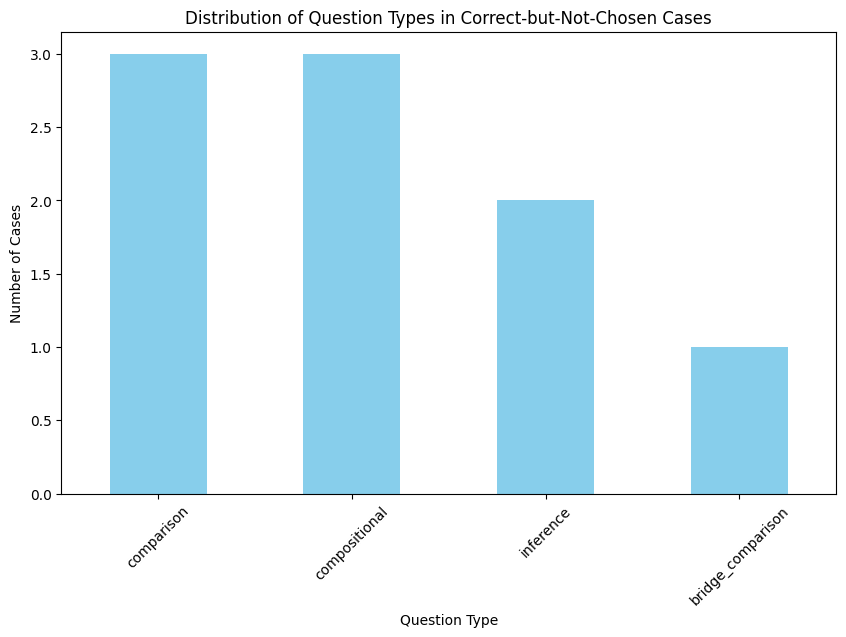

In [57]:
# I want to check cases where one of my answers were correct but not chosen as the final answer
correct_but_not_chosen = root_parent_nodes[((root_parent_nodes['cb_answer_exact_match'] == True) | (root_parent_nodes['ob_answer_exact_match'] == True) | (root_parent_nodes['child_answer_exact_match'] == True)) & (root_parent_nodes['exact_match'] == False)]

# Distribution of question types in correct_but_not_chosen cases
question_type_distribution = correct_but_not_chosen['question_type'].value_counts()

# Plot the distribution
plt.figure(figsize=(10, 6))
question_type_distribution.plot(kind='bar', color='skyblue')
plt.title("Distribution of Question Types in Correct-but-Not-Chosen Cases")
plt.xlabel("Question Type")
plt.ylabel("Number of Cases")
plt.xticks(rotation=45)
plt.show()


In [58]:
correct_but_not_chosen['answer_should_have_been'] = root_parent_nodes.apply(lambda x: 'cb' if x['cb_answer_exact_match'] == True else ('ob' if x['ob_answer_exact_match'] == True else 'child'), axis=1)
correct_but_not_chosen['chosen_answer'] = root_parent_nodes['chosen_answer']

correct_but_not_chosen['answer_should_have_been_prob'] = correct_but_not_chosen.apply(lambda x: x[x['answer_should_have_been'] + '_answer'][1], axis=1)
correct_but_not_chosen['cb_prob'] = correct_but_not_chosen['cb_answer'].apply(lambda x: x[1])
correct_but_not_chosen['ob_prob'] = correct_but_not_chosen['ob_answer'].apply(lambda x: x[1])
correct_but_not_chosen['child_prob'] = correct_but_not_chosen['child_answer'].apply(lambda x: x[1])

correct_but_not_chosen[['answer_should_have_been_prob', 'cb_prob', 'ob_prob', 'child_prob', 'answer_should_have_been', 'chosen_answer']]

/var/folders/0p/97g04f6j0xbd6n9kfwf97fs00000gn/T/ipykernel_385/3613317725.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  correct_but_not_chosen['answer_should_have_been'] = root_parent_nodes.apply(lambda x: 'cb' if x['cb_answer_exact_match'] == True else ('ob' if x['ob_answer_exact_match'] == True else 'child'), axis=1)
/var/folders/0p/97g04f6j0xbd6n9kfwf97fs00000gn/T/ipykernel_385/3613317725.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  correct_but_not_chosen['chosen_answer'] = root_parent_nodes

,answer_should_have_been_prob,cb_prob,ob_prob,child_prob,answer_should_have_been,chosen_answer
14,-0.047644,-0.072613,-0.047644,-0.015788,ob,child
108,-0.055349,-0.055349,-0.060446,-0.018319,cb,child
185,-0.056354,-0.012848,-0.056354,-0.018564,ob,cb
188,-0.163959,-0.163959,-0.200619,-0.083780,cb,child
216,-0.129600,-0.129600,-0.028906,-0.036546,cb,ob
219,-0.109245,-0.096378,-0.109245,-0.058581,ob,child
235,-0.019936,-0.111761,-0.019936,-0.017627,ob,child
278,-0.020283,-0.018891,-0.027133,-0.020283,child,cb
396,-0.063260,-0.115513,-0.063260,-0.048889,ob,child


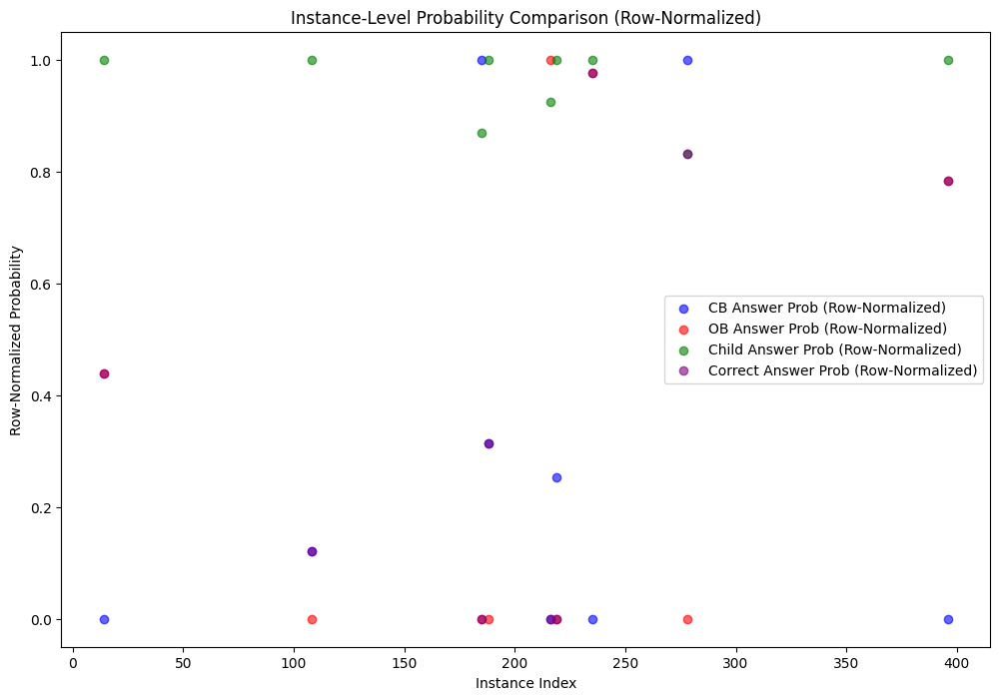

Correct answers when they are the lowest ! 
3 out of 9


In [59]:
# Normalize probabilities to [0, 1] across all instances
prob_cols = ['cb_prob', 'ob_prob', 'child_prob', 'answer_should_have_been_prob']
# Function to normalize a row to [0, 1]
def normalize_row(row):
    return (row - row.min()) / (row.max() - row.min())

# Apply normalization row-wise
normalized_probs_rowwise = correct_but_not_chosen[prob_cols].apply(normalize_row, axis=1)

# Scatter plot of row-wise normalized probabilities
plt.figure(figsize=(12, 8))
plt.scatter(correct_but_not_chosen.index, normalized_probs_rowwise['cb_prob'], label='CB Answer Prob (Row-Normalized)', color='blue', alpha=0.6)
plt.scatter(correct_but_not_chosen.index, normalized_probs_rowwise['ob_prob'], label='OB Answer Prob (Row-Normalized)', color='red', alpha=0.6)
plt.scatter(correct_but_not_chosen.index, normalized_probs_rowwise['child_prob'], label='Child Answer Prob (Row-Normalized)', color='green', alpha=0.6)
plt.scatter(correct_but_not_chosen.index, normalized_probs_rowwise['answer_should_have_been_prob'], label='Correct Answer Prob (Row-Normalized)', color='purple', alpha=0.6)
plt.title("Instance-Level Probability Comparison (Row-Normalized)")
plt.xlabel("Instance Index")
plt.ylabel("Row-Normalized Probability")
plt.legend()
plt.show()

# Correct answers are not always the ones having the highest probability, (even worse most of the times here they are the lowest) !
print("Correct answers when they are the lowest ! ")
print(sum(normalized_probs_rowwise['answer_should_have_been_prob'] == normalized_probs_rowwise.min(axis=1)), "out of", normalized_probs_rowwise.shape[0])

### Different Depths Checking ? 

In [60]:
root_parent_nodes.shape, non_root_parent_nodes.shape

((125, 26), (37, 20))

In [61]:
df

,idx,question_text,sons,qd_logprob,fa,question,cb_answer,ob_answer,answer,example_index,child_answer,cb_ob_agreement,cb_child_agreement,ob_child_agreement,cb_ob_disagreement,cb_child_disagreement,ob_child_disagreement
0,0,Who is Queen Hyojeong married to?,[],NaN,2.0,Who is Queen Hyojeong married to?,"[King Cheoljong., -0.053805460199916666, Queen...","[King Heonjong of Joseon., -0.0499639829000093...","[King Heonjong of Joseon., -0.0499639829000093...",0,NaN,False,False,False,True,False,False
1,1,Who is the father of <1>?,[],NaN,2.0,Who is the father of King Heonjong of Joseon.?,"[King Taejong of Joseon., -0.05121584034369556...","[Crown Prince Hyomyeong., -0.02629438206243368...","[Crown Prince Hyomyeong., -0.02629438206243368...",0,NaN,False,False,False,True,False,False
2,2,Who is the father-in-law of Queen Hyojeong?,"[0, 1]",-0.029848,NaN,Who is the father-in-law of Queen Hyojeong?,"[King Yeongjo., -0.0630911321835115, Queen Hyo...","[Crown Prince Hyomyeong., -0.04009066118152483...","[Crown Prince Hyomyeong., -0.03432032035946477...",0,"[Crown Prince Hyomyeong., -0.03432032035946477...",False,False,True,True,True,False
3,0,When was Grouplogic established?,[],NaN,2.0,When was Grouplogic established?,"[1992., -0.13188666797733334, Grouplogic was e...","[1988., -0.013281994173255558, GroupLogic was ...","[1988., -0.013281994173255558, GroupLogic was ...",1,NaN,False,False,False,True,False,False
4,1,When was Inbios established?,[],NaN,2.0,When was Inbios established?,"[1992., -0.18596439989711822, Inbios was estab...","[1996., -0.006155124742492142, InBios Internat...","[1996., -0.006155124742492142, InBios Internat...",1,NaN,False,False,False,True,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
445,1,Who is the father of <1>'s father?,[],NaN,2.0,"Who is the father of Albert VI, Prince of Anha...","[Fredericka of Anhalt-Zerbst.], -0.07101736673...","[Albert IV, Prince of Anhalt-Köthen., -0.00982...","[Albert IV, Prince of Anhalt-Köthen., -0.00982...",123,NaN,False,False,False,True,False,False
446,2,"Who is Philip, Prince Of Anhalt-Köthen's pater...","[0, 1]",-0.014822,NaN,"Who is Philip, Prince Of Anhalt-Köthen's pater...","[Emanuel Lebrecht, Prince of Anhalt-Köthen., -...","[Albert IV, Prince of Anhalt-Köthen., -0.06532...","[Albert IV, Prince of Anhalt-Köthen., -0.01739...",123,"[Albert IV, Prince of Anhalt-Köthen., -0.01739...",False,False,True,True,True,False
447,0,Who is the composer of film Salome (1953 Film)?,[],NaN,2.0,Who is the composer of film Salome (1953 Film)?,"[Heinz Roemheld., -0.13185644121775367, The fi...","[George Duning and Daniele Amfitheatrof., -0.0...","[George Duning and Daniele Amfitheatrof., -0.0...",124,NaN,False,False,False,True,False,False
448,1,What is the place of birth of <1>?,[],NaN,2.0,What is the place of birth of George Duning an...,[they were born in different places (New York ...,"[Unknown., -100, Unknown.]",[they were born in different places (New York ...,124,NaN,False,False,False,False,False,False


In [62]:
import math
# Initialize the parent-to-children dictionary and child-to-parent dictionary
parent_to_children_mapping = {}
child_to_parent_mapping = {}

# Group by `example_index` to process each tree separately
for example_index, group in df.groupby("example_index"):
    inner_index_to_original_index = {}
    
    # First we need to save the inner index to original index mapping df.index of the row
    for index, row in group.iterrows():
        # I want to save original index used by dataframe not index
        inner_index_to_original_index[row["idx"]] = row.name
    
    print(inner_index_to_original_index)

    for index, row in group.iterrows():
        
        # root node is fa is set to nan (float) in the df, so we can use it to find root nodes
        if math.isnan(row["fa"]):
            # This is a root node
            parent_to_children_mapping[inner_index_to_original_index[row["idx"]]] = [inner_index_to_original_index[son] for son in row["sons"]]
            continue
        elif len(row["sons"]) != 0:
            # This is a parent node but non-root
            parent_to_children_mapping[inner_index_to_original_index[row["idx"]]] = [inner_index_to_original_index[son] for son in row["sons"]]
            child_to_parent_mapping[inner_index_to_original_index[row["idx"]]] = inner_index_to_original_index[int(row['fa'])]
        else:
            # This is a child node
            child_to_parent_mapping[inner_index_to_original_index[row["idx"]]] = inner_index_to_original_index[int(row['fa'])]


{0: 0, 1: 1, 2: 2}
{0: 3, 1: 4, 2: 5}
{0: 6, 1: 7, 2: 8}
{0: 9, 1: 10, 2: 11}
{0: 12, 1: 13, 2: 14}
{0: 15, 1: 16, 2: 17}
{0: 18, 1: 19, 2: 20}
{0: 21, 1: 22, 2: 23}
{0: 24, 1: 25, 2: 26}
{0: 27, 1: 28, 2: 29}
{0: 30, 1: 31, 2: 32}
{0: 33, 1: 34, 2: 35}
{0: 36, 1: 37, 2: 38, 3: 39, 4: 40, 5: 41, 6: 42}
{0: 43, 1: 44, 2: 45}
{0: 46, 1: 47, 2: 48}
{0: 49, 1: 50, 2: 51}
{0: 52, 1: 53, 2: 54}
{0: 55, 1: 56, 2: 57}
{0: 58, 1: 59, 2: 60}
{0: 61, 1: 62, 2: 63}
{0: 64, 1: 65, 2: 66}
{0: 67, 1: 68, 2: 69}
{0: 70, 1: 71, 2: 72, 3: 73, 4: 74, 5: 75, 6: 76}
{0: 77, 1: 78, 2: 79}
{0: 80, 1: 81, 2: 82}
{0: 83, 1: 84, 2: 85}
{0: 86, 1: 87, 2: 88, 3: 89, 4: 90, 5: 91, 6: 92}
{0: 93, 1: 94, 2: 95, 3: 96, 4: 97, 5: 98, 6: 99}
{0: 100, 1: 101, 2: 102}
{0: 103, 1: 104, 2: 105}
{0: 106, 1: 107, 2: 108}
{0: 109, 1: 110, 2: 111}
{0: 112, 1: 113, 2: 114}
{0: 115, 1: 116, 2: 117}
{0: 118, 1: 119, 2: 120}
{0: 121, 1: 122, 2: 123}
{0: 124, 1: 125, 2: 126}
{0: 127, 1: 128, 2: 129}
{0: 130, 1: 131, 2: 132}
{0: 133

In [63]:
# Since we set question_type for non_root nodes with NOT FOUND!! we will set them now same as their parent nodes to do better analysis
# use child to parent mapping to get the parent question type
non_root_parent_nodes['question_type'] = non_root_parent_nodes.index.map(lambda x: root_parent_nodes.loc[child_to_parent_mapping[x]]['question_type'])
non_root_parent_nodes

/var/folders/0p/97g04f6j0xbd6n9kfwf97fs00000gn/T/ipykernel_385/540885283.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  non_root_parent_nodes['question_type'] = non_root_parent_nodes.index.map(lambda x: root_parent_nodes.loc[child_to_parent_mapping[x]]['question_type'])


,idx,question_text,sons,qd_logprob,fa,question,cb_answer,ob_answer,answer,example_index,child_answer,cb_ob_agreement,cb_child_agreement,ob_child_agreement,cb_ob_disagreement,cb_child_disagreement,ob_child_disagreement,gold,question_type,prediction
38,2,When was the director of film Gopalapuranam born?,"[0, 1]",-0.000006,6.0,When was the director of film Gopalapuranam born?,"[24 August 1934., -0.1082970140363617, The fil...","[Unknown., -0.1257953799210171, The director o...","[24 September 1938., -0.024625861932024592, Th...",12,"[24 September 1938., -0.024625861932024592, Th...",False,False,False,True,True,True,NOT FOUND!!,bridge_comparison,24 September 1938.
41,5,When was the director of film Here Is The Beau...,"[3, 4]",-0.000782,6.0,When was the director of film Here Is The Beau...,"[December 16, 1938., -0.07694293834629962, Her...","[25 October 1909., -0.05859714237138256, The d...","[October 25, 1909., -0.01232357813621513, The ...",12,"[October 25, 1909., -0.01232357813621513, The ...",False,False,False,True,True,True,NOT FOUND!!,bridge_comparison,"October 25, 1909."
72,2,When was the director of film The Adventures O...,"[0, 1]",-0.000008,6.0,When was the director of film The Adventures O...,"[August 2, 1965., -0.06770434606111969, The fi...","[27 August 1964., -0.02683735629858062, The di...","[27 August 1964., -0.005891687575741881, The f...",22,"[27 August 1964., -0.005891687575741881, The f...",False,False,True,True,True,False,NOT FOUND!!,bridge_comparison,27 August 1964.
75,5,"When was the director of film Harvest: 3,000 Y...","[3, 4]",-0.000868,6.0,"When was the director of film Harvest: 3,000 Y...","[March 4, 1946., -0.009152960095620936, The fi...","[March 4, 1946., -0.04428925633711635, The dir...","[March 4, 1946., -0.009152960095620936, The fi...",22,"[March 4, 1946., -0.011143179039258775, The fi...",True,True,True,False,False,False,NOT FOUND!!,bridge_comparison,"March 4, 1946."
88,2,Which country is the director of film Apache W...,"[0, 1]",-0.000007,6.0,Which country is the director of film Apache W...,"[United States., -0.11198718224107, The film A...","[Italy., -0.09787034470171081, The director of...","[United States., -0.04722428757572999, The dir...",26,"[United States., -0.04722428757572999, The dir...",False,True,False,True,False,True,NOT FOUND!!,bridge_comparison,United States.
91,5,Which country is the director of film Dime Wit...,"[3, 4]",-0.000904,6.0,Which country is the director of film Dime Wit...,"[United States., -0.04611026329949594, The fil...","[Unknown., -0.19182534489742278, The director ...","[America., -0.02619017189434493, The director ...",26,"[America., -0.02619017189434493, The director ...",False,False,False,True,True,True,NOT FOUND!!,bridge_comparison,America.
95,2,Which country is the director of film My Frien...,"[0, 1]",-0.000010,6.0,Which country is the director of film My Frien...,"[Argentina., -0.10054516355683767, The film My...","[Argentina., -0.08285682040874925, The directo...","[Argentina., -0.027631944873173907, The direct...",27,"[Argentina., -0.027631944873173907, The direct...",True,True,True,False,False,False,NOT FOUND!!,bridge_comparison,Argentina.
98,5,Which country is the director of film Punks (F...,"[3, 4]",-0.001321,6.0,Which country is the director of film Punks (F...,"[United States., -0.13669956257443586, The fil...","[United States., -0.05899674654793259, The dir...","[United States., -0.04280801939788921, The dir...",27,"[United States., -0.04280801939788921, The dir...",True,True,True,False,False,False,NOT FOUND!!,bridge_comparison,United States.
138,2,When did the director of film The Monkey Talks...,"[0, 1]",-0.000006,6.0,When did the director of film The Monkey Talks...,"[November 12, 1970., -0.11168452986665285, The...","[December 31, 1980., -0.06039413578758731, The...","[December 31, 1980., -0.01851495581736755, The...",40,"[December 31, 1980., -0.01851495581736755, The...",False,False,True,True,True,False,NOT FOUND!!,bridge_comparison,"Decemb

/var/folders/0p/97g04f6j0xbd6n9kfwf97fs00000gn/T/ipykernel_385/4029574624.py:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


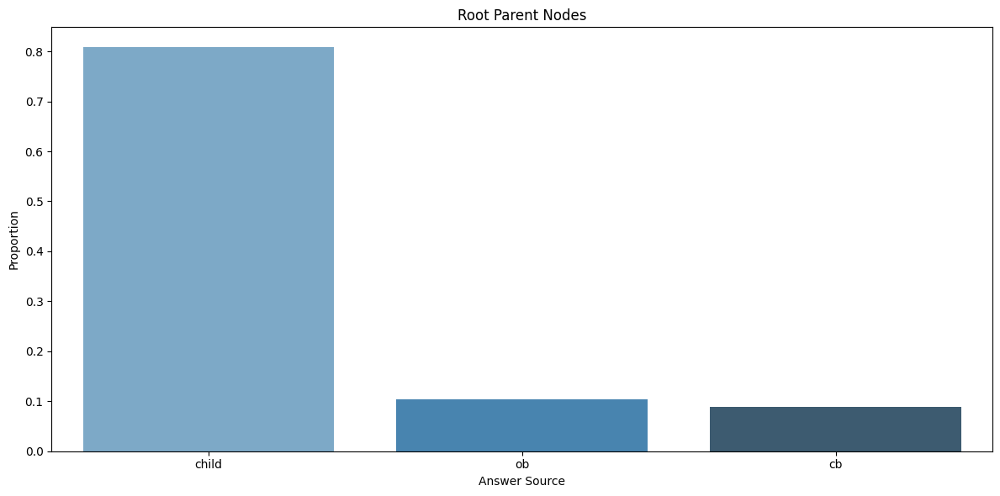

In [64]:
# Distribution for root parent nodes
root_answer_source_distribution = root_parent_nodes['chosen_answer'].value_counts(normalize=True)

# Distribution for non-root parent nodes
# non_root_answer_source_distribution = non_root_parent_nodes['chosen_answer'].value_counts(normalize=True)

# Create subplots
fig, axes = plt.subplots(1, 1, figsize=(12, 6), sharey=True)
# fig, axes = plt.subplots(1, 2, figsize=(12, 6), sharey=True)

# Plot for root parent nodes
sns.barplot(
    x=root_answer_source_distribution.index,
    y=root_answer_source_distribution.values,
    ax=axes,
    palette="Blues_d"
)
axes.set_title("Root Parent Nodes")
axes.set_xlabel("Answer Source")
axes.set_ylabel("Proportion")

# Plot for non-root parent nodes
# sns.barplot(
#     x=non_root_answer_source_distribution.index,
#     y=non_root_answer_source_distribution.values,
#     ax=axes[1],
#     palette="Greens_d"
# )
# axes[1].set_title("Non-Root Parent Nodes")
# axes[1].set_xlabel("Answer Source")

# Adjust layout
plt.tight_layout()
plt.show()


/var/folders/0p/97g04f6j0xbd6n9kfwf97fs00000gn/T/ipykernel_385/2344725834.py:5: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(root_parent_nodes['cb_answer'].apply(lambda x: x[1]), label="CB Answer", ax=axes[0], shade=True, color="red")
/var/folders/0p/97g04f6j0xbd6n9kfwf97fs00000gn/T/ipykernel_385/2344725834.py:9: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(root_parent_nodes['ob_answer'].apply(lambda x: x[1]), label="CB Answer", ax=axes[1], shade=True, color="red")
/var/folders/0p/97g04f6j0xbd6n9kfwf97fs00000gn/T/ipykernel_385/2344725834.py:13: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(root_parent_nodes['child_answ

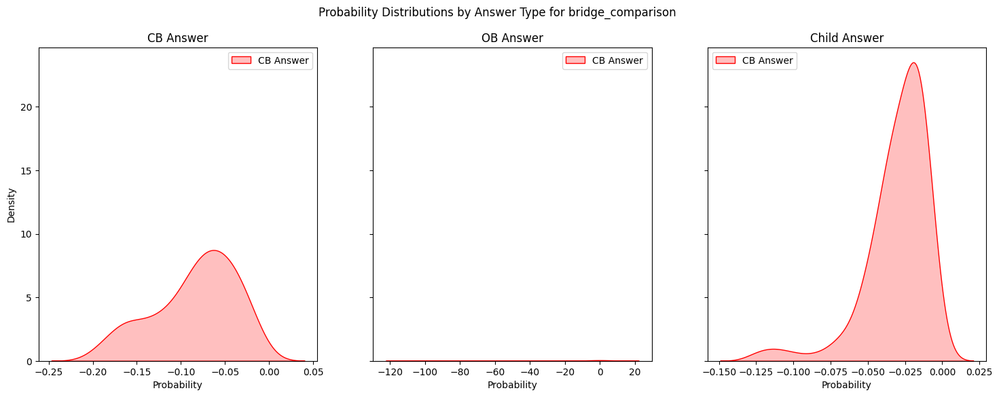

In [65]:
# Visualize the distribution of the probabilities for cb_answer, ob_answer, and child_answer to compare how confident the model is when it makes predictions.
# On all types of questions

fig, axes = plt.subplots(1, 3, figsize=(18, 6), sharey=True)
sns.kdeplot(root_parent_nodes['cb_answer'].apply(lambda x: x[1]), label="CB Answer", ax=axes[0], shade=True, color="red")
# sns.kdeplot(non_root_parent_nodes['cb_answer'].apply(lambda x: x[1]), label="CB Answer", ax=axes[0], shade=True, color="blue")
axes[0].set_title('CB Answer')

sns.kdeplot(root_parent_nodes['ob_answer'].apply(lambda x: x[1]), label="CB Answer", ax=axes[1], shade=True, color="red")
# sns.kdeplot(non_root_parent_nodes['ob_answer'].apply(lambda x: x[1]), label="CB Answer", ax=axes[1], shade=True, color="blue")
axes[1].set_title('OB Answer')

sns.kdeplot(root_parent_nodes['child_answer'].apply(lambda x: x[1]), label="CB Answer", ax=axes[2], shade=True, color="red")
# sns.kdeplot(non_root_parent_nodes['child_answer'].apply(lambda x: x[1]), label="CB Answer", ax=axes[2], shade=True, color="blue")
axes[2].set_title('Child Answer')

for ax in axes:
    ax.set_xlabel('Probability')
    ax.set_ylabel('Density')
    ax.legend()

fig.suptitle(f'Probability Distributions by Answer Type for {question_type}')
plt.show()

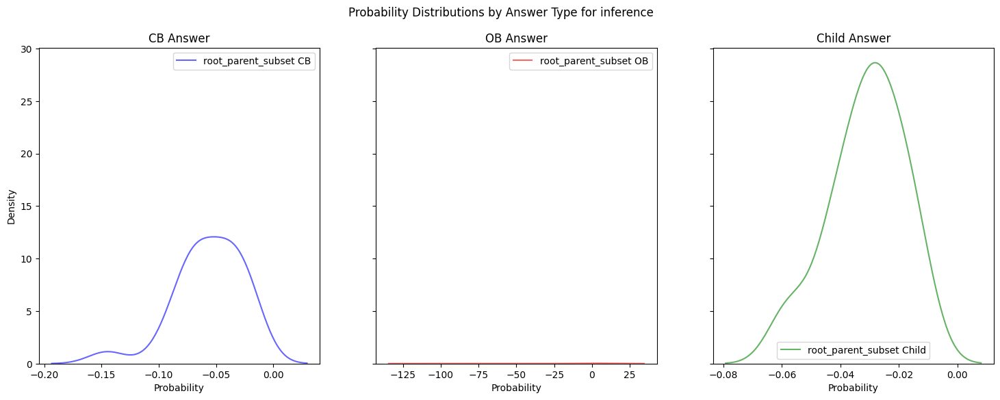

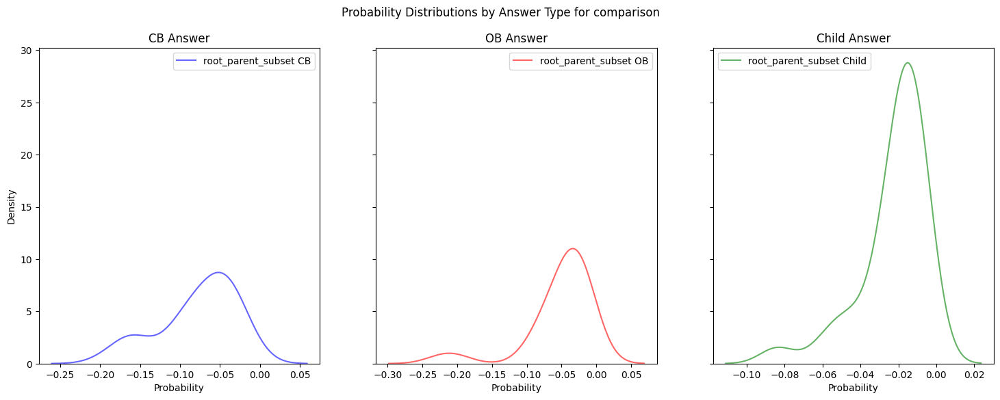

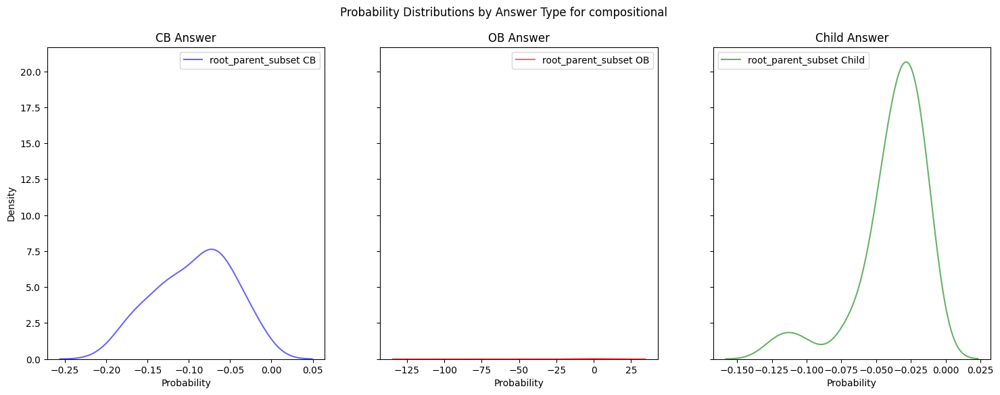

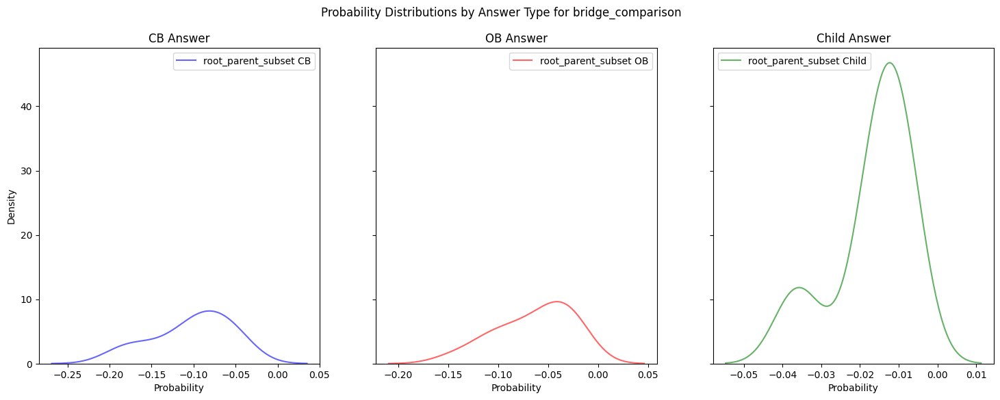

In [66]:
# Visualize the distribution of the probabilities for cb_answer, ob_answer, and child_answer to compare how confident the model is when it makes predictions.
# Grouped by question type

for question_type in root_parent_nodes['question_type'].unique():
    root_parent_subset = root_parent_nodes[root_parent_nodes['question_type'] == question_type]
    # non_root_parent_subset = non_root_parent_nodes[non_root_parent_nodes['question_type'] == question_type]
    # if (non_root_parent_subset.shape[0] == 0):
        # print(f"No non-root parent nodes found for question type: {question_type}")
        # continue
    
    fig, axes = plt.subplots(1, 3, figsize=(18, 6), sharey=True)
    sns.kdeplot(root_parent_subset['cb_answer'].apply(lambda x: x[1]), label='root_parent_subset CB', ax=axes[0], color='blue', alpha=0.6)
    # sns.kdeplot(non_root_parent_subset['cb_answer'].apply(lambda x: x[1]), label='non_root_parent_subset CB', ax=axes[0], color='blue', linestyle='--')
    axes[0].set_title('CB Answer')
    
    sns.kdeplot(root_parent_subset['ob_answer'].apply(lambda x: x[1]), label='root_parent_subset OB', ax=axes[1], color='red', alpha=0.6)
    # sns.kdeplot(non_root_parent_subset['ob_answer'].apply(lambda x: x[1]), label='non_root_parent_subset OB', ax=axes[1], color='red', linestyle='--')
    axes[1].set_title('OB Answer')
    
    sns.kdeplot(root_parent_subset['child_answer'].apply(lambda x: x[1]), label='root_parent_subset Child', ax=axes[2], color='green', alpha=0.6)
    # sns.kdeplot(non_root_parent_subset['child_answer'].apply(lambda x: x[1]), label='non_root_parent_subset Child', ax=axes[2], color='green', linestyle='--')
    axes[2].set_title('Child Answer')
    
    for ax in axes:
        ax.set_xlabel('Probability')
        ax.set_ylabel('Density')
        ax.legend()
    
    fig.suptitle(f'Probability Distributions by Answer Type for {question_type}')
    plt.show()


# Investigating errors Semantically ?!

In [67]:
# I want now to add all the path to form the tree structure
# Paths are in the form of : [['parent', 'child1'], ['parent', 'child2'], ['child1', 'subchild1'], ['child1', 'subchild2'], ['child2', 'subchild3'], ['child2', 'subchild4']]


def construct_tree_edges(parent, paths):
    if parent not in parent_to_children_mapping:
        return
    for child in parent_to_children_mapping[parent]:
        paths.append([parent, child])
        construct_tree_edges(child, paths)

# Get the text of the paths
def nodes_to_data(paths):
    paths_text =[]
    for path in paths:
        path_text = []
        for node in path:
            text = df.loc[node, 'question_text'] + f"\nOB: {df.loc[node, 'ob_answer'][0], df.loc[node, 'ob_answer'][1]},\nCB: {df.loc[node, 'cb_answer'][0], df.loc[node, 'cb_answer'][1]}"
            if isinstance(df.loc[node, 'child_answer'], list):
                text += f",\nChild: {df.loc[node, 'child_answer'][0], df.loc[node, 'child_answer'][1]}"
            
            text += f",\nAnswer: {df.loc[node, 'answer'][0], df.loc[node, 'answer'][1]}"

            # check if this node is in root_parent_nodes
            if node in root_parent_nodes.index:
                text += f"\nGold: {root_parent_nodes.loc[node, 'gold']}"
            path_text.append(text)
        paths_text.append(path_text)
    return paths_text

def get_tree_from_parent(parent):
    paths = []
    construct_tree_edges(parent, paths)
    return nodes_to_data(paths)

def create_graph_to_problem(parent_index):
    paths = get_tree_from_parent(parent_index)
    print(paths)
    G = nx.DiGraph()
    for path in paths:
        nx.add_path(G, path)

    rcParams['figure.figsize'] = 20, 10
    pos=graphviz_layout(G, prog='dot')
    nx.draw(G, pos=pos,
            font_size=9,
            font_color='black',
            node_color='lightblue',
            node_shape='s',
            node_size=15000,
            with_labels=True, 
            arrows=True)
    plt.show()


In [68]:
wrong_answers_indices = root_parent_nodes[root_parent_nodes['exact_match'] == False].index
correct_answers_indices = root_parent_nodes[root_parent_nodes['exact_match'] == True].index
wrong_answers_indices.size, correct_answers_indices.size

(56, 69)

### Analyzing Wrongly answered examples

[["Where was the place of death of the director of film The Decision Of Christopher Blake?\nOB: ('Unknown.', -0.13869977365189937),\nCB: ('Los Angeles.', -0.08259560833883818),\nChild: ('Los Angeles.', -0.09877940785222922),\nAnswer: ('Los Angeles.', -0.08259560833883818)\nGold: Hollywood", "Who is the director of film The Decision Of Christopher Blake?\nOB: ('Peter Godfrey.', -0.06317600639917126),\nCB: ('Peter Sasdy.', -0.057936966506231424),\nAnswer: ('Peter Sasdy.', -0.057936966506231424)"], ["Where was the place of death of the director of film The Decision Of Christopher Blake?\nOB: ('Unknown.', -0.13869977365189937),\nCB: ('Los Angeles.', -0.08259560833883818),\nChild: ('Los Angeles.', -0.09877940785222922),\nAnswer: ('Los Angeles.', -0.08259560833883818)\nGold: Hollywood", "Where did <1> die?\nOB: ('Unknown.', -100),\nCB: ('Los Angeles.', -0.29426940642155),\nAnswer: ('Los Angeles.', -0.29426940642155)"]]


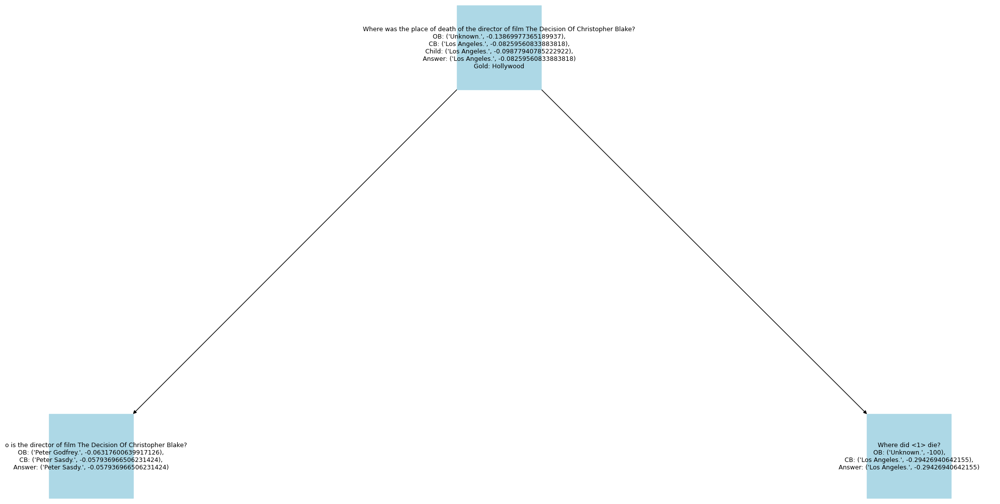

[["Who is the child of the director of film Mukhyamantri (1996 Film)?\nOB: ('Sandip Choudhury.', -0.03812676315545979),\nCB: ('Prakash Belawadi.', -0.06681015820308657),\nChild: ('Chumki Chowdhury, Rina Choudhury, and Sandip Choudhury.', -0.039642747727591805),\nAnswer: ('Sandip Choudhury.', -0.03812676315545979)\nGold: Chumki Chowdhury", "Who is the director of film Mukhyamantri (1996 Film)?\nOB: ('Anjan Choudhury.', -0.02710642695240937),\nCB: ('T. S. Nagabharana.', -0.07188979925143608),\nAnswer: ('Anjan Choudhury.', -0.02710642695240937)"], ["Who is the child of the director of film Mukhyamantri (1996 Film)?\nOB: ('Sandip Choudhury.', -0.03812676315545979),\nCB: ('Prakash Belawadi.', -0.06681015820308657),\nChild: ('Chumki Chowdhury, Rina Choudhury, and Sandip Choudhury.', -0.039642747727591805),\nAnswer: ('Sandip Choudhury.', -0.03812676315545979)\nGold: Chumki Chowdhury", "Who is the child of <1>?\nOB: ('Chumki Chowdhury, Rina Choudhury, and Sandip Choudhury.', -0.104065366520036

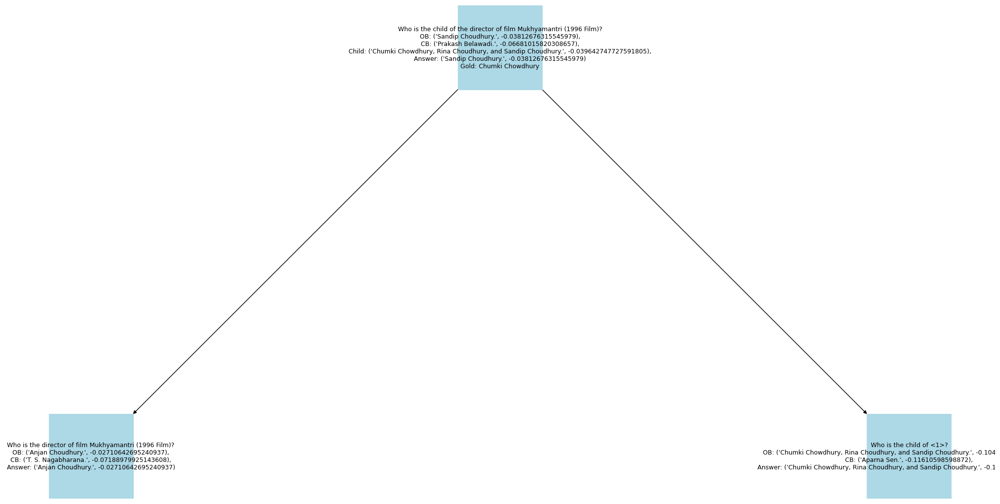

[['Which film was released earlier, The Devil\'S Miner or Don\'T Tell?\nOB: ("The Devil\'s Miner.", -0.047643695676369516),\nCB: (\'both.\', -0.07261260871409658),\nChild: ("Don\'T Tell.", -0.015787623199486872),\nAnswer: ("Don\'T Tell.", -0.015787623199486872)\nGold: The Devil\'S Miner', "When was the film The Devil'S Miner released?\nOB: ('2005.', -0.07085375563262078),\nCB: ('2005.', -0.02049389707479733),\nAnswer: ('2005.', -0.02049389707479733)"], ['Which film was released earlier, The Devil\'S Miner or Don\'T Tell?\nOB: ("The Devil\'s Miner.", -0.047643695676369516),\nCB: (\'both.\', -0.07261260871409658),\nChild: ("Don\'T Tell.", -0.015787623199486872),\nAnswer: ("Don\'T Tell.", -0.015787623199486872)\nGold: The Devil\'S Miner', "When was the film Don'T Tell released?\nOB: ('2017.', -0.03073734051018083),\nCB: ('2002.', -0.025149949943384996),\nAnswer: ('2002.', -0.025149949943384996)"]]


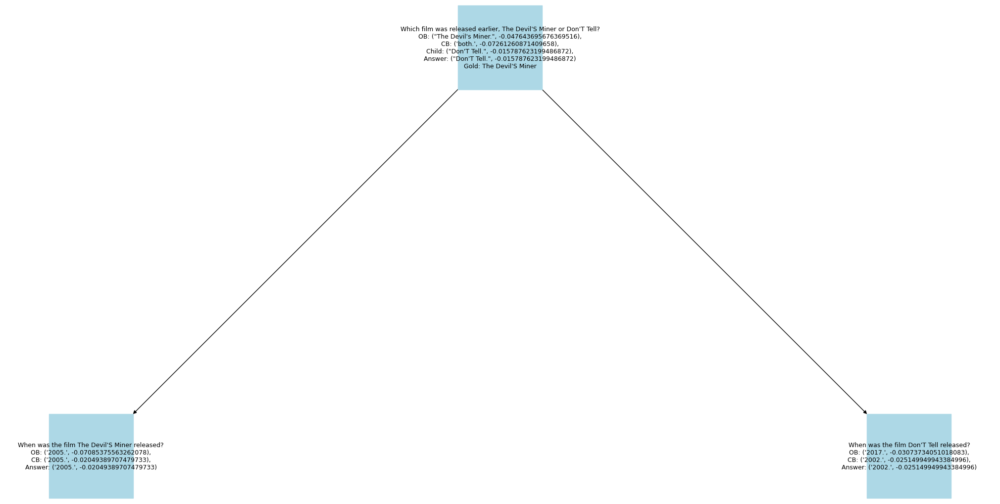

[['Who is Lord Herbert Montagu Douglas Scott\'s maternal grandfather?\nOB: ("Lord Herbert Montagu Douglas Scott\'s father is William Henry Walter Montagu Douglas Scott, 6th Duke of Buccleuch & 8th Duke of Queensberry. William Henry Walter Montagu Douglas Scott\'s mother is Lady Louisa Jane Hamilton. So, Lord Herbert Montagu Douglas Scott\'s maternal grandfather is unknown.", -100),\nCB: (\'Alexander Oxenbridge.\', -0.0678222933235314),\nChild: (\'James Hamilton, 6th Duke of Hamilton.\', -0.03907277976704411),\nAnswer: (\'James Hamilton, 6th Duke of Hamilton.\', -0.03907277976704411)\nGold: James Hamilton', "Who is the mother of Lord Herbert Montagu Douglas Scott?\nOB: ('Lady Louisa Jane Hamilton.', -0.0532723591397),\nCB: ('Louisa Jane Hamilton.', -0.12845144273370798),\nAnswer: ('Lady Louisa Jane Hamilton.', -0.0532723591397)"], ['Who is Lord Herbert Montagu Douglas Scott\'s maternal grandfather?\nOB: ("Lord Herbert Montagu Douglas Scott\'s father is William Henry Walter Montagu Dougl

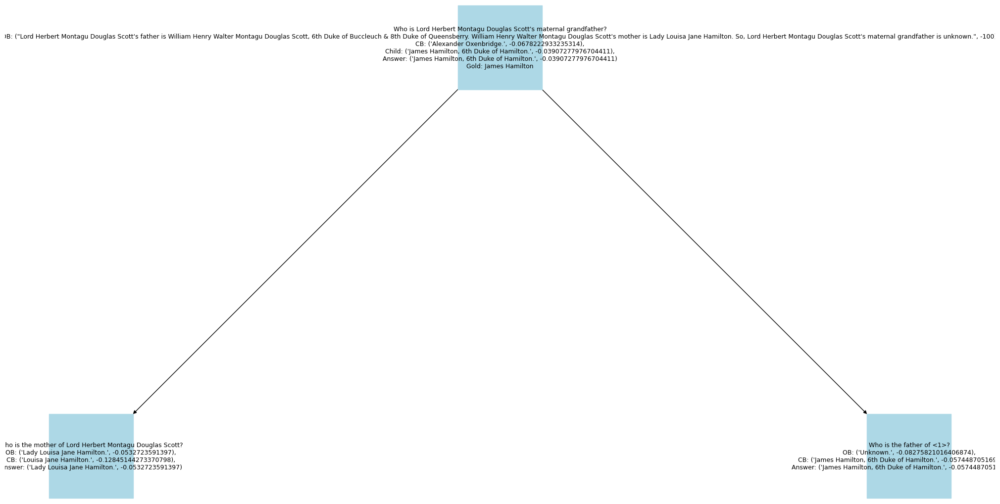

[["Which country the director of film Snow Flower And The Secret Fan (Film) is from?\nOB: ('Hong Kong.', -0.05028329784848332),\nCB: ('China.', -0.04215542614389),\nChild: ('China.', -0.0377175818108064),\nAnswer: ('China.', -0.0377175818108064)\nGold: American", "Who is the director of film Snow Flower And The Secret Fan (Film)?\nOB: ('Wayne Wang.', -0.04854031932534785),\nCB: ('Wayne Wang.', -0.017322335636792856),\nAnswer: ('Wayne Wang.', -0.017322335636792856)"], ["Which country the director of film Snow Flower And The Secret Fan (Film) is from?\nOB: ('Hong Kong.', -0.05028329784848332),\nCB: ('China.', -0.04215542614389),\nChild: ('China.', -0.0377175818108064),\nAnswer: ('China.', -0.0377175818108064)\nGold: American", "Which country is <1> from?\nOB: ('Hong Kong.', -0.10566437306425),\nCB: ('China.', -0.08323109145531588),\nAnswer: ('China.', -0.08323109145531588)"]]


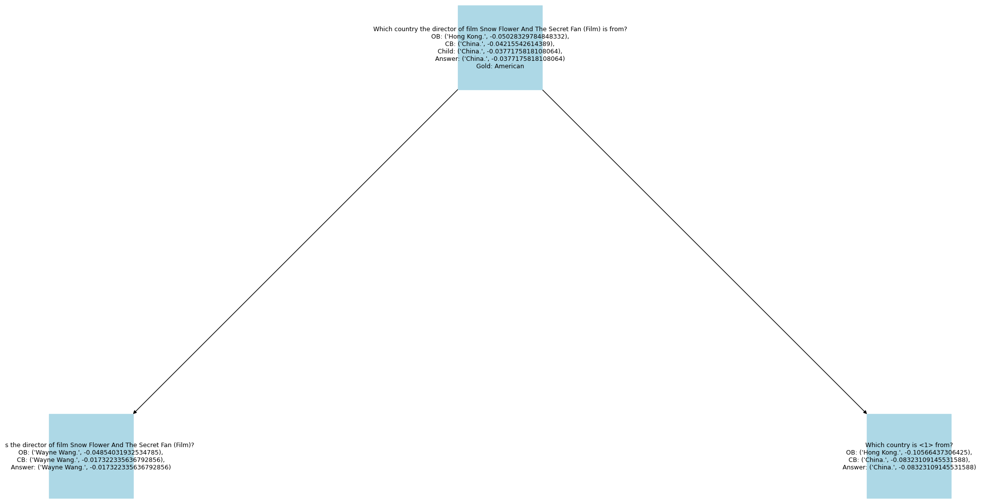

[["Where was the director of film Eisenstein In Guanajuato born?\nOB: ('Unknown.', -0.08603726610700632),\nCB: ('Mexico City.', -0.024513101653155598),\nChild: ('Mexico City, Mexico.', -0.016022120971062342),\nAnswer: ('Mexico City, Mexico.', -0.016022120971062342)\nGold: Newport, Wales", "Who is the director of film Eisenstein In Guanajuato?\nOB: ('Peter Greenaway.', -0.0686536955333625),\nCB: ('Paul Leduc.', -0.027908951495286872),\nAnswer: ('Paul Leduc.', -0.027908951495286872)"], ["Where was the director of film Eisenstein In Guanajuato born?\nOB: ('Unknown.', -0.08603726610700632),\nCB: ('Mexico City.', -0.024513101653155598),\nChild: ('Mexico City, Mexico.', -0.016022120971062342),\nAnswer: ('Mexico City, Mexico.', -0.016022120971062342)\nGold: Newport, Wales", "Where was <1> born?\nOB: ('Mexico City, Mexico.', -0.006314332062277272),\nCB: ('Mexico.', -0.052050634612374996),\nAnswer: ('Mexico City, Mexico.', -0.006314332062277272)"]]


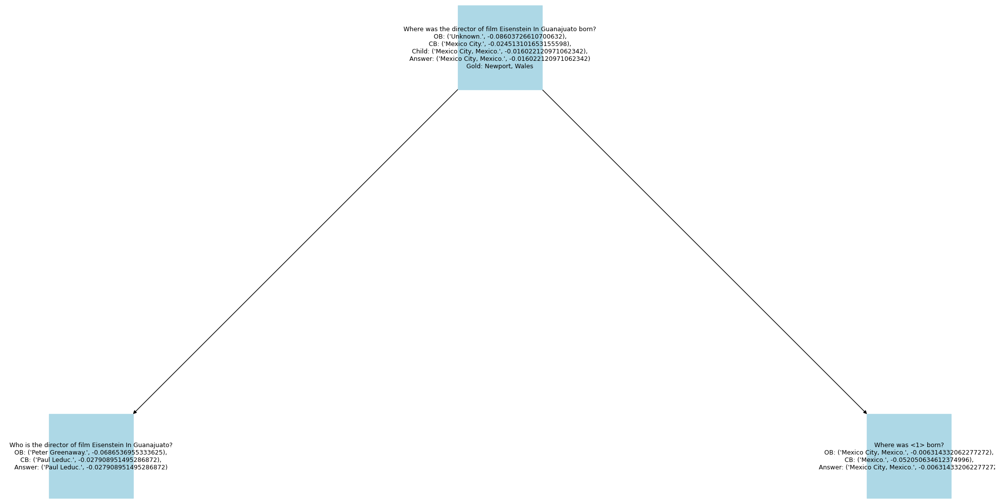

[["Where did George Tryon, 1St Baron Tryon's father die?\nOB: ('off Tripoli, Lebanon.', -0.031465780834652596),\nCB: ('Bulwick.', -0.0617052700348532),\nChild: ('off Tripoli, Lebanon.', -0.01463488860522525),\nAnswer: ('off Tripoli, Lebanon.', -0.01463488860522525)\nGold: Tripoli", "Who is George Tryon, 1St Baron Tryon's father?\nOB: ('Vice-Admiral Sir George Tryon.', -0.012491713612319563),\nCB: ('Thomas Tryon.', -0.017799875462362353),\nAnswer: ('Vice-Admiral Sir George Tryon.', -0.012491713612319563)"], ["Where did George Tryon, 1St Baron Tryon's father die?\nOB: ('off Tripoli, Lebanon.', -0.031465780834652596),\nCB: ('Bulwick.', -0.0617052700348532),\nChild: ('off Tripoli, Lebanon.', -0.01463488860522525),\nAnswer: ('off Tripoli, Lebanon.', -0.01463488860522525)\nGold: Tripoli", "Where did <1> die?\nOB: ('off Tripoli, Lebanon.', -0.0012503498082305558),\nCB: ('off the coast of Tripoli, Lebanon.', -0.20240039281364777),\nAnswer: ('off Tripoli, Lebanon.', -0.0012503498082305558)"]]


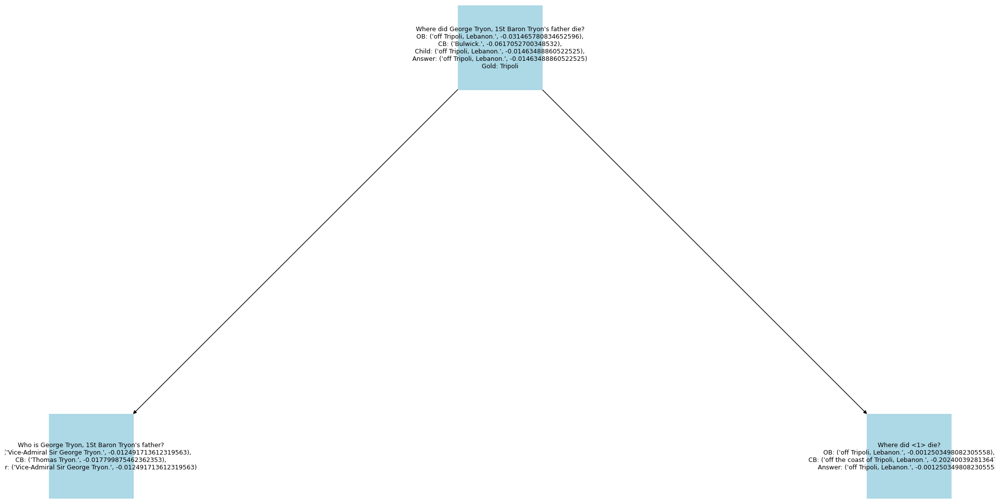

[["Where was the place of death of the director of film Happy Go Lucky (1936 Film)?\nOB: ('Unknown.', -0.09085570806634334),\nCB: ('London.', -0.05937087973156769),\nChild: ('Rio de Janeiro.', -0.053287725538465),\nAnswer: ('Rio de Janeiro.', -0.053287725538465)\nGold: Los Angeles", "Who is the director of film Happy Go Lucky (1936 Film)?\nOB: ('Aubrey Scotto.', -0.10563968935094),\nCB: ('Aubrey Scotto.', -0.061881925864421095),\nAnswer: ('Aubrey Scotto.', -0.061881925864421095)"], ["Where was the place of death of the director of film Happy Go Lucky (1936 Film)?\nOB: ('Unknown.', -0.09085570806634334),\nCB: ('London.', -0.05937087973156769),\nChild: ('Rio de Janeiro.', -0.053287725538465),\nAnswer: ('Rio de Janeiro.', -0.053287725538465)\nGold: Los Angeles", "Where did <1> die?\nOB: ('Unknown.', -100),\nCB: ('Rio de Janeiro.', -0.0926052661289618),\nAnswer: ('Rio de Janeiro.', -0.0926052661289618)"]]


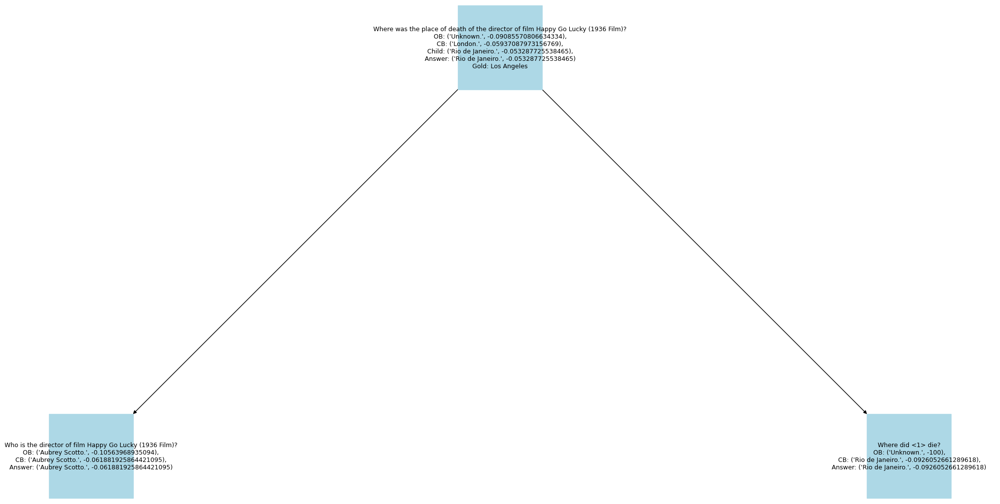

[["What is the award that the performer of song In My Mind (Heather Headley Song) got?\nOB: ('Tony Award and Grammy Award.', -0.01655613207893),\nCB: ('Tony Award.', -0.16710154762398),\nChild: ('Tony Award and Grammy Award.', -0.03267393082003742),\nAnswer: ('Tony Award and Grammy Award.', -0.01655613207893)\nGold: Tony Award for Best Actress in a Musical", "Who is the performer of song In My Mind (Heather Headley Song)?\nOB: ('Heather Headley.', -0.09044447994551427),\nCB: ('Heather Headley.', -0.10130908093452413),\nAnswer: ('Heather Headley.', -0.09044447994551427)"], ["What is the award that the performer of song In My Mind (Heather Headley Song) got?\nOB: ('Tony Award and Grammy Award.', -0.01655613207893),\nCB: ('Tony Award.', -0.16710154762398),\nChild: ('Tony Award and Grammy Award.', -0.03267393082003742),\nAnswer: ('Tony Award and Grammy Award.', -0.01655613207893)\nGold: Tony Award for Best Actress in a Musical", "What award did <1> get?\nOB: ('Tony Award and Grammy Award.'

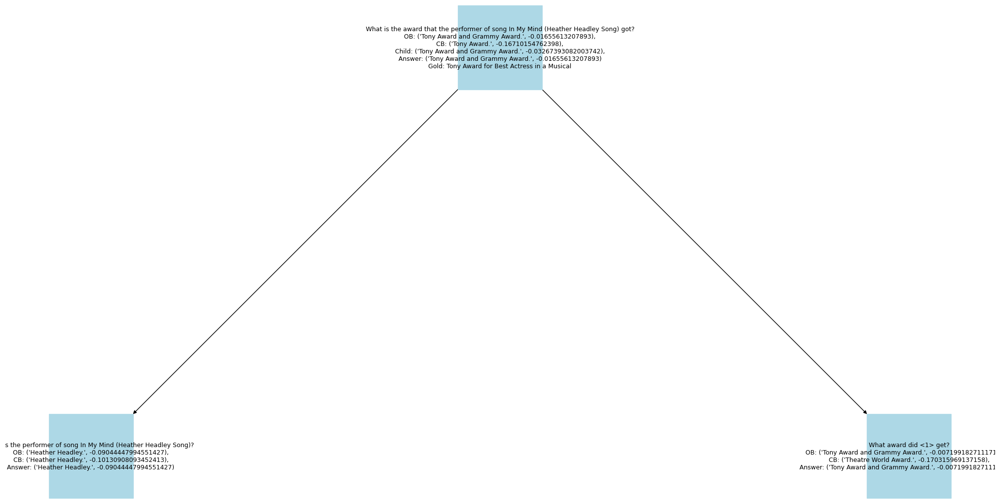

[['Where did the director of film Man Detained graduate from?\nOB: ("Churcher\'s College in Hampshire.", -0.06755584735848216),\nCB: (\'École des Beaux-Arts.\', -0.10410986592970223),\nChild: ("Churcher\'s College in Hampshire.", -0.021311248168096833),\nAnswer: ("Churcher\'s College in Hampshire.", -0.021311248168096833)\nGold: Churcher\'s College', "Who is the director of film Man Detained?\nOB: ('Robert Tronson.', -0.02808818509836307),\nCB: ('Henri Verneuil.', -0.15573010095310463),\nAnswer: ('Robert Tronson.', -0.02808818509836307)"], ['Where did the director of film Man Detained graduate from?\nOB: ("Churcher\'s College in Hampshire.", -0.06755584735848216),\nCB: (\'École des Beaux-Arts.\', -0.10410986592970223),\nChild: ("Churcher\'s College in Hampshire.", -0.021311248168096833),\nAnswer: ("Churcher\'s College in Hampshire.", -0.021311248168096833)\nGold: Churcher\'s College', 'Where did <1> graduate from?\nOB: ("Churcher\'s College in Hampshire.", -0.04915309786229357),\nCB: (

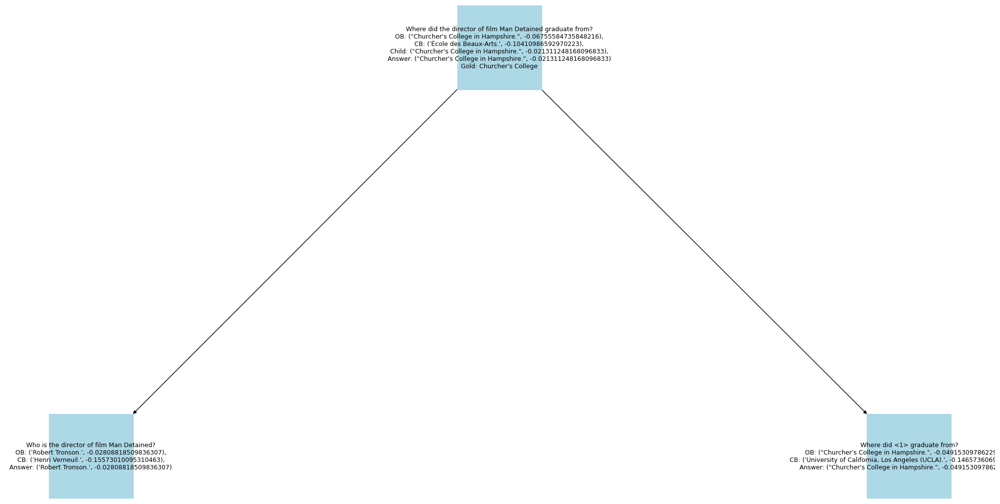

[["Where was the place of burial of Auguste Tessier's father?\nOB: ('Unknown.', -100),\nCB: ('Sainte-Geneviève-des-Bois.', -0.166010366717531),\nChild: ('Montmartre Cemetery.', -0.11590130543855114),\nAnswer: ('Montmartre Cemetery.', -0.11590130543855114)\nGold: Cimetière Notre-Dame-de-Belmont", "Who is Auguste Tessier's father?\nOB: ('Unknown.', -100),\nCB: ('François Tessier.', -0.2664279824663636),\nAnswer: ('François Tessier.', -0.2664279824663636)"], ["Where was the place of burial of Auguste Tessier's father?\nOB: ('Unknown.', -100),\nCB: ('Sainte-Geneviève-des-Bois.', -0.166010366717531),\nChild: ('Montmartre Cemetery.', -0.11590130543855114),\nAnswer: ('Montmartre Cemetery.', -0.11590130543855114)\nGold: Cimetière Notre-Dame-de-Belmont", "Where was the place of burial of <1>?\nOB: ('Unknown.', -100),\nCB: ('Montmartre Cemetery.', -0.12669793776833335),\nAnswer: ('Montmartre Cemetery.', -0.12669793776833335)"]]


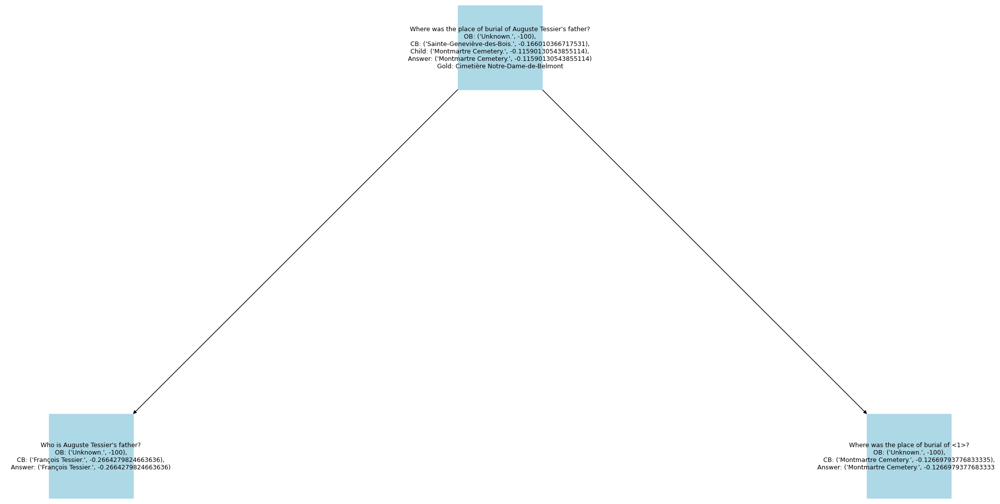

[["Where was the place of death of the director of film The First Day Of Freedom?\nOB: ('Unknown.', -100),\nCB: ('Munich.', -0.0588474846326916),\nChild: ('Unknown.', -0.04833102346397483),\nAnswer: ('Munich.', -0.0588474846326916)\nGold: Florida", "Who is the director of film The First Day Of Freedom?\nOB: ('Aleksander Ford.', -0.09893817560629356),\nCB: ('Wolfgang Liebeneiner.', -0.09136771414646562),\nAnswer: ('Wolfgang Liebeneiner.', -0.09136771414646562)"], ["Where was the place of death of the director of film The First Day Of Freedom?\nOB: ('Unknown.', -100),\nCB: ('Munich.', -0.0588474846326916),\nChild: ('Unknown.', -0.04833102346397483),\nAnswer: ('Munich.', -0.0588474846326916)\nGold: Florida", "Where did <1> die?\nOB: ('1987.', -0.031752288031005625),\nCB: ('Munich.', -0.09109186563195362),\nAnswer: ('1987.', -0.031752288031005625)"]]


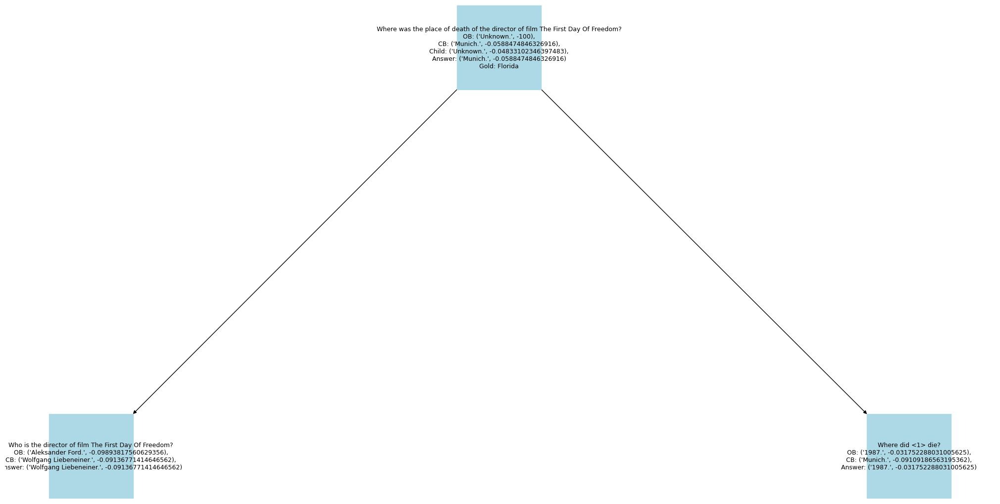

[["What is the place of birth of the performer of song Svennebanan?\nOB: ('Unknown.', -0.12095445815009165),\nCB: ('Gothenburg.', -0.07074986152682888),\nChild: ('Tehran.', -0.03951591799133244),\nAnswer: ('Tehran.', -0.03951591799133244)\nGold: Västerås", "Who is the performer of song Svennebanan?\nOB: ('Promoe.', -0.10274772062102354),\nCB: ('Laleh.', -0.05668971314500428),\nAnswer: ('Laleh.', -0.05668971314500428)"], ["What is the place of birth of the performer of song Svennebanan?\nOB: ('Unknown.', -0.12095445815009165),\nCB: ('Gothenburg.', -0.07074986152682888),\nChild: ('Tehran.', -0.03951591799133244),\nAnswer: ('Tehran.', -0.03951591799133244)\nGold: Västerås", "What is the place of birth of <1>?\nOB: ('Unknown.', -100),\nCB: ('Tehran.', -0.08838090237685),\nAnswer: ('Tehran.', -0.08838090237685)"]]


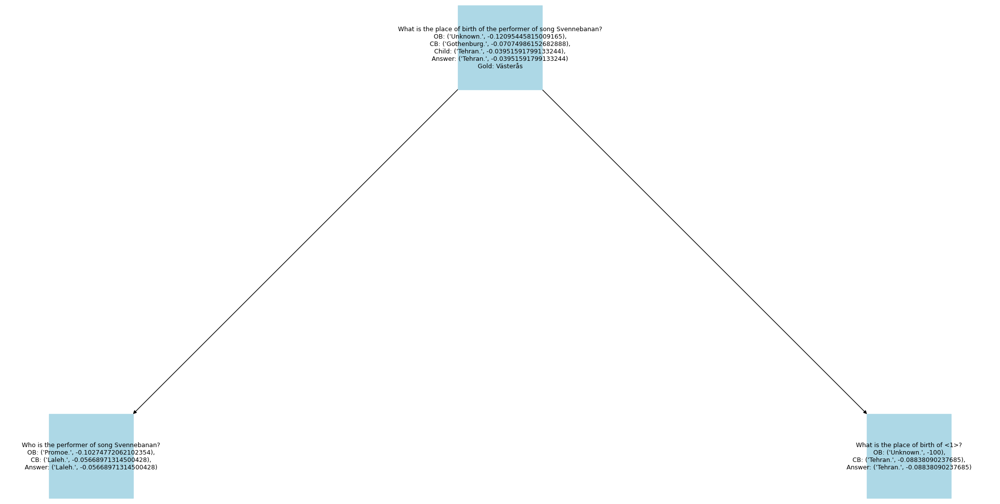

[["What nationality is the director of film Guns Of Diablo?\nOB: ('Ukrainian-American.', -0.06044593790318159),\nCB: ('American.', -0.055348664527903504),\nChild: ('Ukrainian-American.', -0.018318895802770324),\nAnswer: ('Ukrainian-American.', -0.018318895802770324)\nGold: American", "Who is the director of film Guns Of Diablo?\nOB: ('Boris Sagal.', -0.042289257469816675),\nCB: ('Boris Sagal.', -0.05212762973398916),\nAnswer: ('Boris Sagal.', -0.042289257469816675)"], ["What nationality is the director of film Guns Of Diablo?\nOB: ('Ukrainian-American.', -0.06044593790318159),\nCB: ('American.', -0.055348664527903504),\nChild: ('Ukrainian-American.', -0.018318895802770324),\nAnswer: ('Ukrainian-American.', -0.018318895802770324)\nGold: American", "What is the nationality of <1>?\nOB: ('Ukrainian-American.', -0.009572285645192309),\nCB: ('American.', -0.1070574737064553),\nAnswer: ('Ukrainian-American.', -0.009572285645192309)"]]


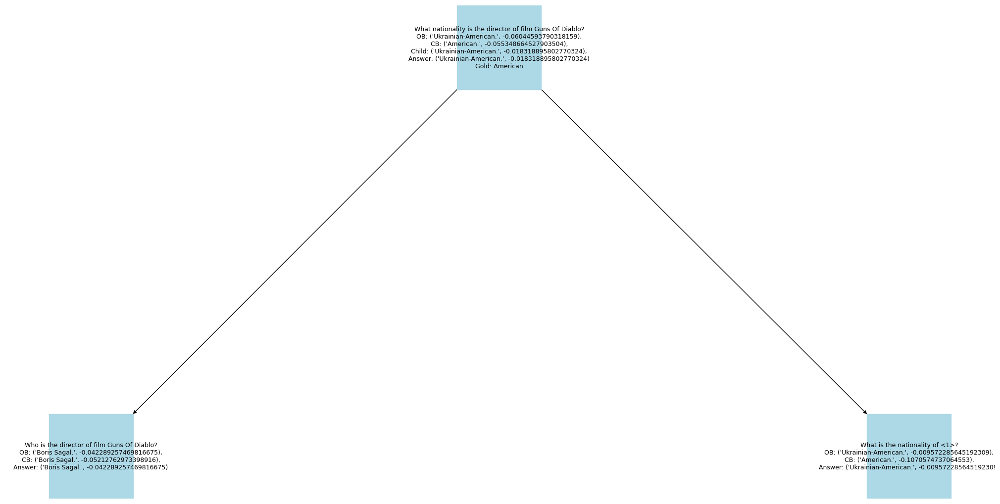

[["Where was the place of death of Anna Of Pomerania's father?\nOB: ('Stettin (now Szczecin).', -0.09424546900989707),\nCB: ('Lębork.', -0.07422107842216),\nChild: ('Szczecin.', -0.0375404624585111),\nAnswer: ('Szczecin.', -0.0375404624585111)\nGold: Stettin", "Who is the father of Anna Of Pomerania?\nOB: ('Bogislaw XIII, Duke of Pomerania.', -0.048708581003827606),\nCB: ('Warcisław X.', -0.16192746132066),\nAnswer: ('Bogislaw XIII, Duke of Pomerania.', -0.048708581003827606)"], ["Where was the place of death of Anna Of Pomerania's father?\nOB: ('Stettin (now Szczecin).', -0.09424546900989707),\nCB: ('Lębork.', -0.07422107842216),\nChild: ('Szczecin.', -0.0375404624585111),\nAnswer: ('Szczecin.', -0.0375404624585111)\nGold: Stettin", "Where did <1> die?\nOB: ('Stettin.', -0.07459073780944153),\nCB: ('Szczecin.', -0.05145463848968842),\nAnswer: ('Szczecin.', -0.05145463848968842)"]]


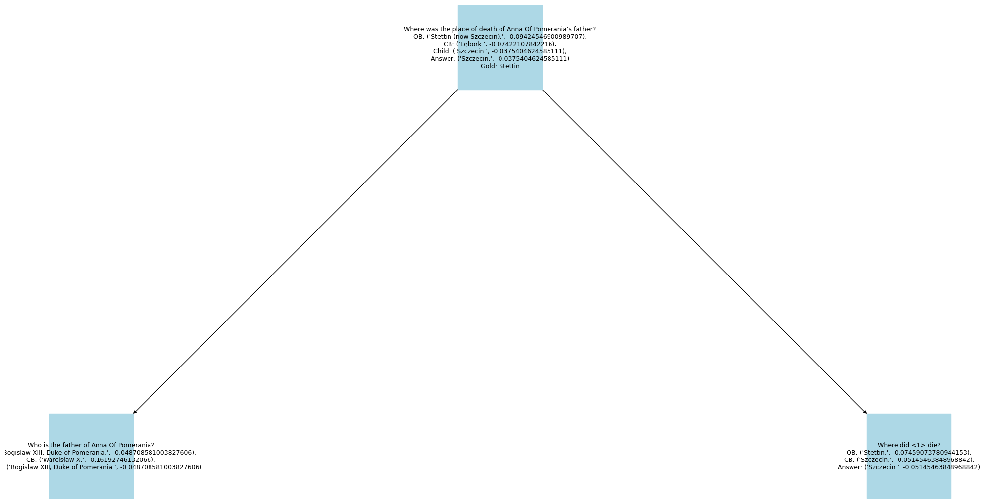

[["Where was the founder of Douro Wine Company born?\nOB: ('Portugal.', -0.03680374333780711),\nCB: ('Portugal.', -0.07607449684221362),\nChild: ('13 May 1699.', -0.014708454605963626),\nAnswer: ('13 May 1699.', -0.014708454605963626)\nGold: Lisbon", "Who is the founder of Douro Wine Company?\nOB: ('Sebastião José de Carvalho e Melo, Marquis of Pombal.', -0.012936886251547335),\nCB: ('Fernando Van Zeller.', -0.18578939196898384),\nAnswer: ('Sebastião José de Carvalho e Melo, Marquis of Pombal.', -0.012936886251547335)"], ["Where was the founder of Douro Wine Company born?\nOB: ('Portugal.', -0.03680374333780711),\nCB: ('Portugal.', -0.07607449684221362),\nChild: ('13 May 1699.', -0.014708454605963626),\nAnswer: ('13 May 1699.', -0.014708454605963626)\nGold: Lisbon", "Where was <1> born?\nOB: ('13 May 1699.', -0.03219693891730687),\nCB: ('Salvador, Bahia, Brazil.', -0.05927943762455448),\nAnswer: ('13 May 1699.', -0.03219693891730687)"]]


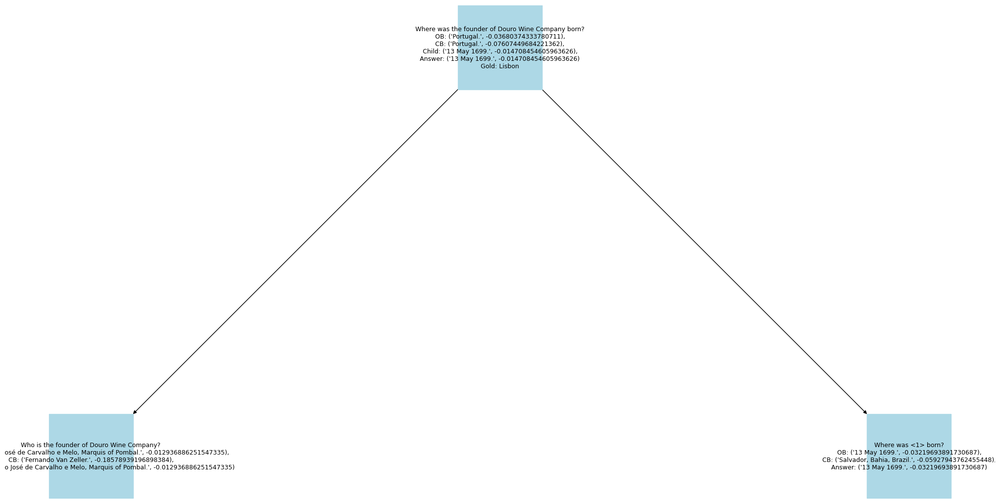

[["Who is the spouse of the performer of song Les Rois Du Monde?\nOB: ('Joy Esther and Emily Surde.', -0.15803705847798602),\nCB: ('Corinne Hermès.', -0.1829934338275363),\nChild: ('Marie Leszczyńska.', -0.037994294152290664),\nAnswer: ('Marie Leszczyńska.', -0.037994294152290664)\nGold: Joy Esther", 'Who is the performer of song Les Rois Du Monde?\nOB: ("Philippe d\'Avilla, Damien Sargue, and Grégori Baquet.", -0.03647082655303732),\nCB: (\'Philippe Chatel.\', -0.2960733971949939),\nAnswer: ("Philippe d\'Avilla, Damien Sargue, and Grégori Baquet.", -0.03647082655303732)'], ["Who is the spouse of the performer of song Les Rois Du Monde?\nOB: ('Joy Esther and Emily Surde.', -0.15803705847798602),\nCB: ('Corinne Hermès.', -0.1829934338275363),\nChild: ('Marie Leszczyńska.', -0.037994294152290664),\nAnswer: ('Marie Leszczyńska.', -0.037994294152290664)\nGold: Joy Esther", "Who is the spouse of <1>?\nOB: ('Unknown.', -100),\nCB: ('Marie Leszczyńska.', -0.09095913345759742),\nAnswer: ('Mari

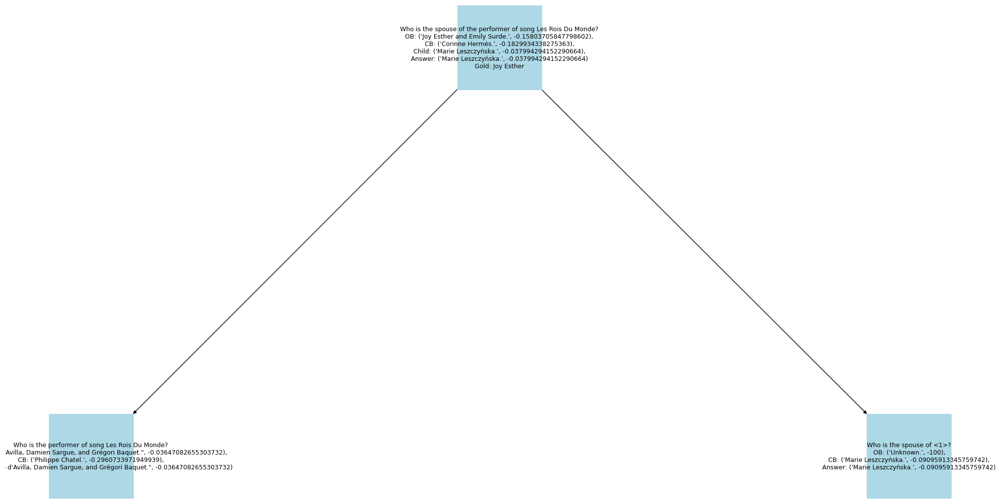

[["What is the place of birth of S. G. Kittappa's wife?\nOB: ('Erode district, Tamil Nadu.', -0.0750520226343391),\nCB: ('Tirupati.', -0.13641065049007078),\nChild: ('Erode district, Tamil Nadu.', -0.016822422883799537),\nAnswer: ('Erode district, Tamil Nadu.', -0.016822422883799537)\nGold: Kodumudi", "Who is S. G. Kittappa's wife?\nOB: ('K. B. Sundarambal.', -0.003624810899987058),\nCB: ('K. R. Saroja.', -0.21146113669900943),\nAnswer: ('K. B. Sundarambal.', -0.003624810899987058)"], ["What is the place of birth of S. G. Kittappa's wife?\nOB: ('Erode district, Tamil Nadu.', -0.0750520226343391),\nCB: ('Tirupati.', -0.13641065049007078),\nChild: ('Erode district, Tamil Nadu.', -0.016822422883799537),\nAnswer: ('Erode district, Tamil Nadu.', -0.016822422883799537)\nGold: Kodumudi", "What is the place of birth of <1>?\nOB: ('Erode district, Tamil Nadu.', -0.03911103863496499),\nCB: ('Andhra Pradesh.', -0.078695152462835),\nAnswer: ('Erode district, Tamil Nadu.', -0.03911103863496499)"]]


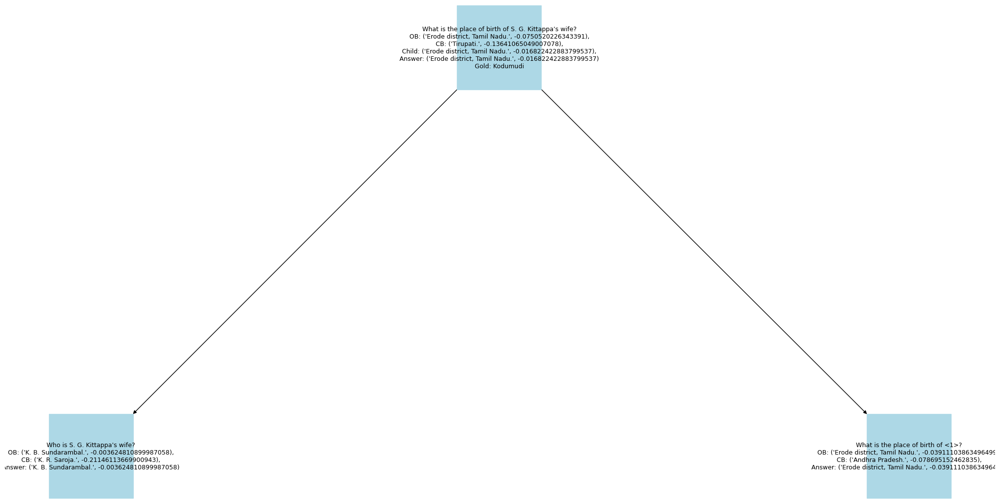

[["Who is the mother-in-law of Blanche Of Navarre, Duchess Of Brittany?\nOB: ('Unknown.', -0.12921497437930685),\nCB: ('Margaret of Brittany.', -0.031757676996563705),\nChild: ('Beatrice of England.', -0.04359672068714497),\nAnswer: ('Margaret of Brittany.', -0.031757676996563705)\nGold: Alix", "Who is the husband of Blanche Of Navarre, Duchess Of Brittany?\nOB: ('John I, Duke of Brittany.', -0.062591219212371),\nCB: ('John III, Duke of Brittany.', -0.05267793539205151),\nAnswer: ('John III, Duke of Brittany.', -0.05267793539205151)"], ["Who is the mother-in-law of Blanche Of Navarre, Duchess Of Brittany?\nOB: ('Unknown.', -0.12921497437930685),\nCB: ('Margaret of Brittany.', -0.031757676996563705),\nChild: ('Beatrice of England.', -0.04359672068714497),\nAnswer: ('Margaret of Brittany.', -0.031757676996563705)\nGold: Alix", "Who is the mother of <1>?\nOB: ('Beatrice of England.', -0.08911539938008654),\nCB: ('Margaret of Brittany.', -0.10678786810626928),\nAnswer: ('Beatrice of Englan

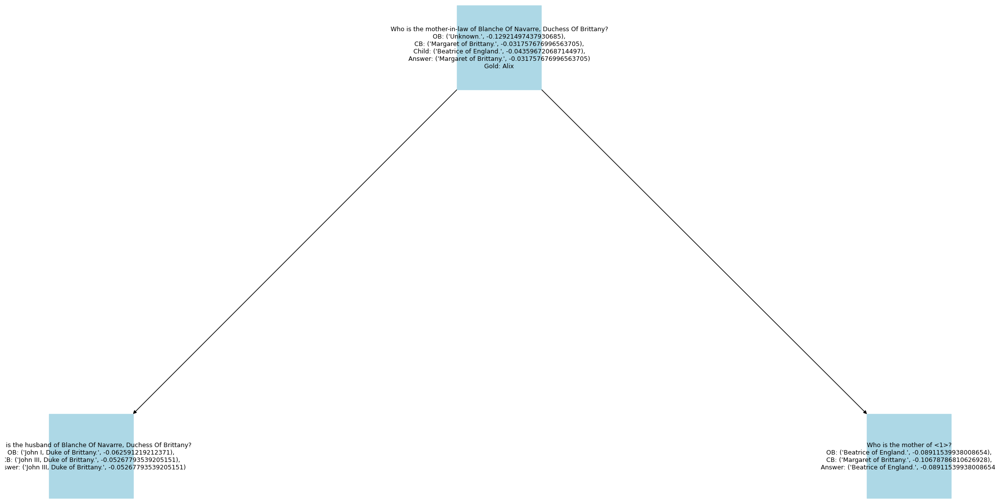

[["Where was the performer of song Believe It (Meek Mill Song) detained?\nOB: ('State Correctional Institution – Chester in Chester, Pennsylvania.', -0.050731513370956646),\nCB: ('Pennsylvania.', -0.11760692194548261),\nChild: ('State Correctional Institution – Chester in Chester, Pennsylvania.', -0.029567834940237736),\nAnswer: ('State Correctional Institution – Chester in Chester, Pennsylvania.', -0.029567834940237736)\nGold: State Correctional Institution – Chester", "Who is the performer of song Believe It (Meek Mill Song)?\nOB: ('Meek Mill.', -0.08317659266553667),\nCB: ('Meek Mill and Justin Bieber.', -0.09661901029297),\nAnswer: ('Meek Mill.', -0.08317659266553667)"], ["Where was the performer of song Believe It (Meek Mill Song) detained?\nOB: ('State Correctional Institution – Chester in Chester, Pennsylvania.', -0.050731513370956646),\nCB: ('Pennsylvania.', -0.11760692194548261),\nChild: ('State Correctional Institution – Chester in Chester, Pennsylvania.', -0.0295678349402377

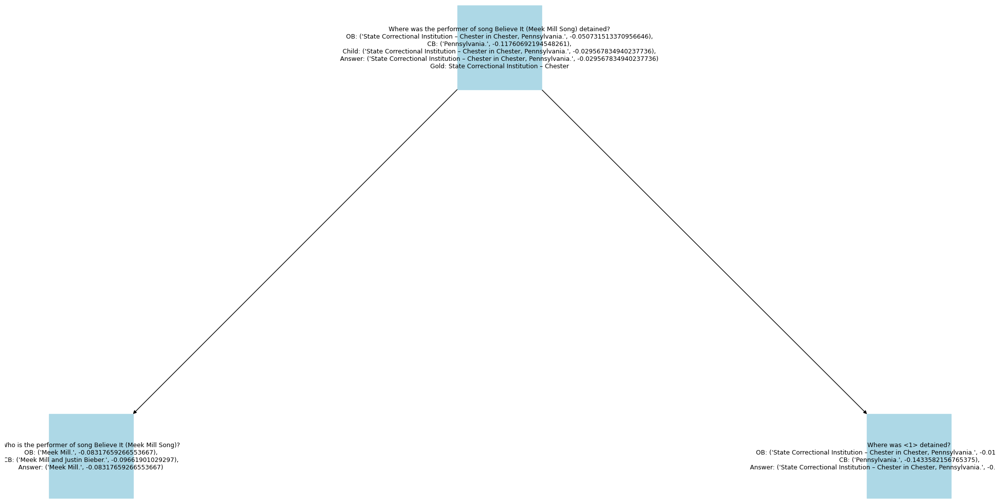

[["Who is the maternal grandfather of Philip Of Ibelin (1180–1227)?\nOB: ('Alexios I Komnenos.', -0.03471721465656421),\nCB: ('Barisano of Ibelin.', -0.0656903918071664),\nChild: ('Alexios I Komnenos.', -0.015643182627066765),\nAnswer: ('Alexios I Komnenos.', -0.015643182627066765)\nGold: John Doukas Komnenos", "Who is the mother of Philip Of Ibelin (1180–1227)?\nOB: ('Maria Komnene.', -0.047254228731084785),\nCB: ('Maria Komnene.', -0.07442259762926713),\nAnswer: ('Maria Komnene.', -0.047254228731084785)"], ["Who is the maternal grandfather of Philip Of Ibelin (1180–1227)?\nOB: ('Alexios I Komnenos.', -0.03471721465656421),\nCB: ('Barisano of Ibelin.', -0.0656903918071664),\nChild: ('Alexios I Komnenos.', -0.015643182627066765),\nAnswer: ('Alexios I Komnenos.', -0.015643182627066765)\nGold: John Doukas Komnenos", "Who is the father of <1>?\nOB: ('Alexios I Komnenos.', -0.012156160673916),\nCB: ('Alexios I Komnenos.', -0.09366839725640003),\nAnswer: ('Alexios I Komnenos.', -0.012156160

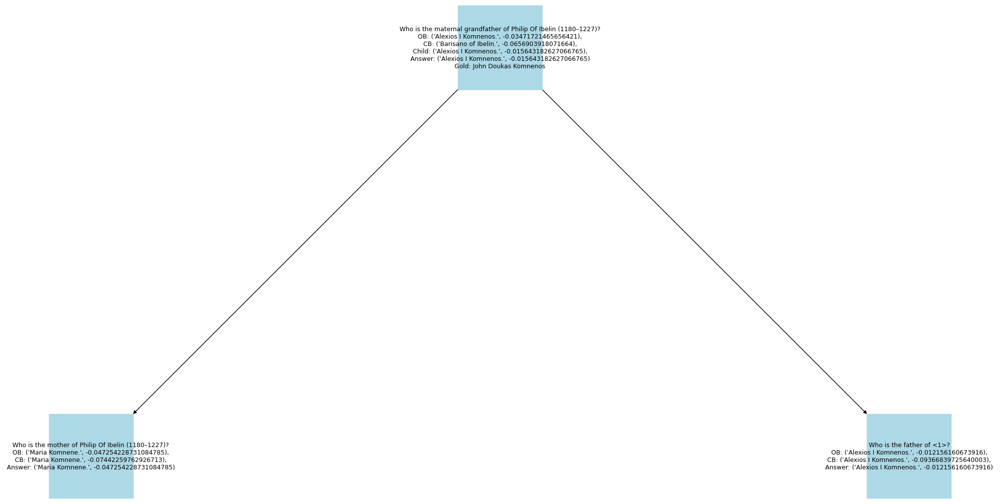

[["Where did Thep Kasattri's father die?\nOB: ('1569.', -0.03076759280463034),\nCB: ('Phitsanulok.', -0.057389119329969554),\nChild: ('Ayudhya.', -0.03221835353906222),\nAnswer: ('1569.', -0.03076759280463034)\nGold: Ayutthaya", "Who is Thep Kasattri's father?\nOB: ('King Maha Chakkraphat.', -0.02754421577157313),\nCB: ('Chatrichalerm Yukol.', -0.14962743925806665),\nAnswer: ('King Maha Chakkraphat.', -0.02754421577157313)"], ["Where did Thep Kasattri's father die?\nOB: ('1569.', -0.03076759280463034),\nCB: ('Phitsanulok.', -0.057389119329969554),\nChild: ('Ayudhya.', -0.03221835353906222),\nAnswer: ('1569.', -0.03076759280463034)\nGold: Ayutthaya", "Where did <1> die?\nOB: ('Unknown.', -100),\nCB: ('Ayudhya.', -0.08960082008594616),\nAnswer: ('Ayudhya.', -0.08960082008594616)"]]


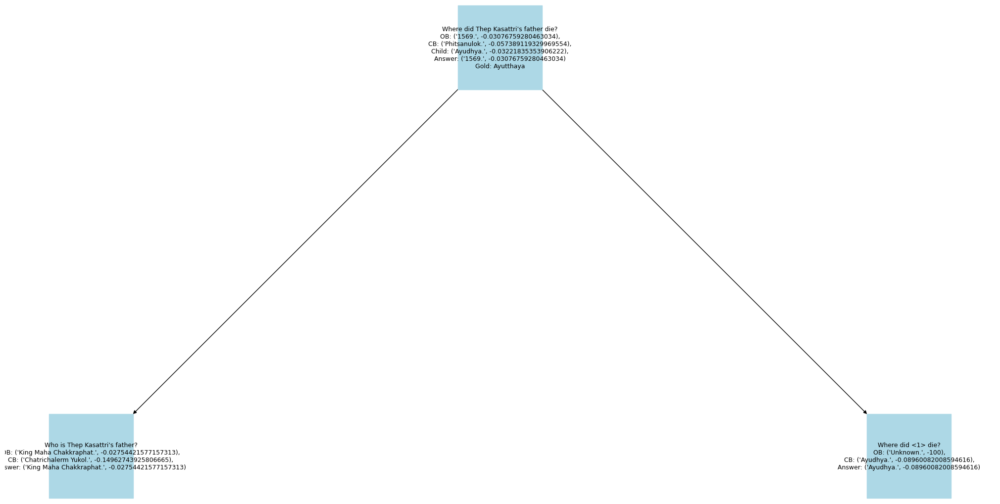

[["Where was the father of Frederick, Prince Of Hohenzollern born?\nOB: ('Unknown.', -0.06076396618194418),\nCB: ('Schloss Sigmaringen.', -0.08376665616397666),\nChild: ('Schloss Benrath, near Düsseldorf.', -0.010272194419936863),\nAnswer: ('Schloss Benrath, near Düsseldorf.', -0.010272194419936863)\nGold: Benrath", "Who is the father of Frederick, Prince Of Hohenzollern?\nOB: ('William, Prince of Hohenzollern.', -0.03237508689695651),\nCB: ('Ferdinand, Prince of Hohenzollern.', -0.046625290996176676),\nAnswer: ('William, Prince of Hohenzollern.', -0.03237508689695651)"], ["Where was the father of Frederick, Prince Of Hohenzollern born?\nOB: ('Unknown.', -0.06076396618194418),\nCB: ('Schloss Sigmaringen.', -0.08376665616397666),\nChild: ('Schloss Benrath, near Düsseldorf.', -0.010272194419936863),\nAnswer: ('Schloss Benrath, near Düsseldorf.', -0.010272194419936863)\nGold: Benrath", "Where was <1> born?\nOB: ('Schloss Benrath, near Düsseldorf.', -0.0042806755522640915),\nCB: ('Hechinge

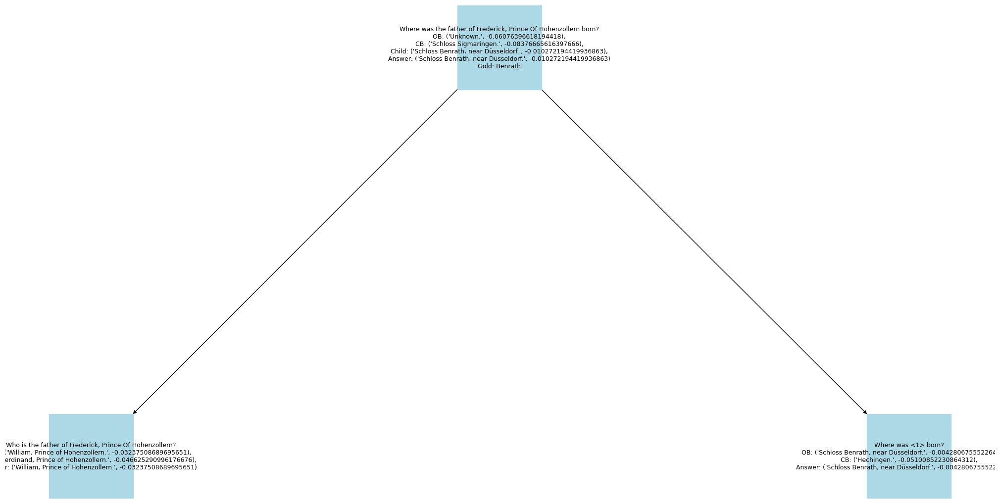

[["Who is Titus Junius Brutus's paternal grandfather?\nOB: ('Unknown.', -0.07566717274553873),\nCB: ('Lucius Junius Brutus.', -0.021565656941025878),\nChild: ('Lucius Junius Brutus the Elder.', -0.02706801916685448),\nAnswer: ('Lucius Junius Brutus.', -0.021565656941025878)\nGold: Marcus Junius", "Who is Titus Junius Brutus's father?\nOB: ('Lucius Junius Brutus.', -0.0427894519110547),\nCB: ('Decimus Junius Brutus.', -0.07664540931831587),\nAnswer: ('Lucius Junius Brutus.', -0.0427894519110547)"], ["Who is Titus Junius Brutus's paternal grandfather?\nOB: ('Unknown.', -0.07566717274553873),\nCB: ('Lucius Junius Brutus.', -0.021565656941025878),\nChild: ('Lucius Junius Brutus the Elder.', -0.02706801916685448),\nAnswer: ('Lucius Junius Brutus.', -0.021565656941025878)\nGold: Marcus Junius", "Who is the father of <1>'s father?\nOB: ('Unknown.', -100),\nCB: ('Lucius Junius Brutus the Elder.', -0.02727749094674714),\nAnswer: ('Lucius Junius Brutus the Elder.', -0.02727749094674714)"]]


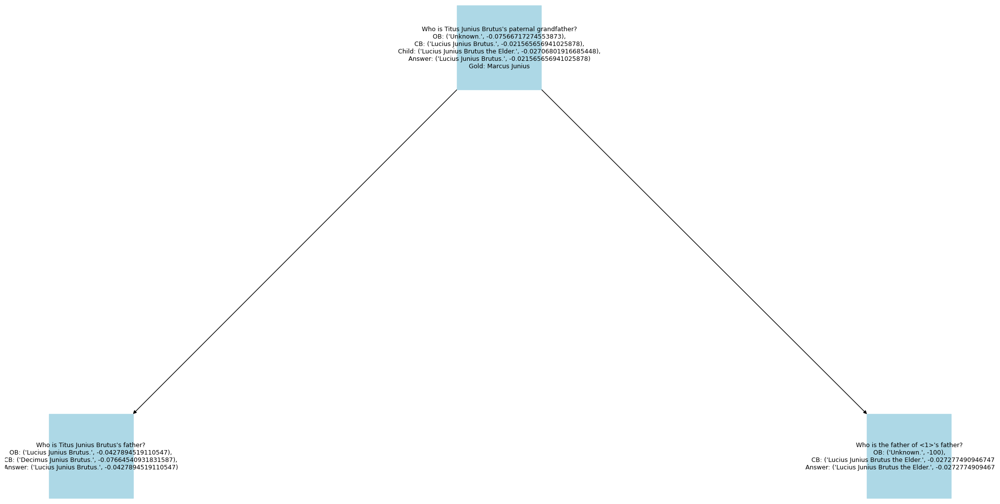

[["Where did William Henry Gregory's wife die?\nOB: ('Unknown.', -100),\nCB: ('London.', -0.12134308703952942),\nChild: ('31 March 1817.', -0.12469403291777056),\nAnswer: ('London.', -0.12134308703952942)\nGold: Coole Park", "Who is William Henry Gregory's wife?\nOB: ('Unknown.', -100),\nCB: ('Lady Frances Berkeley.', -0.36139681287549996),\nAnswer: ('Lady Frances Berkeley.', -0.36139681287549996)"], ["Where did William Henry Gregory's wife die?\nOB: ('Unknown.', -100),\nCB: ('London.', -0.12134308703952942),\nChild: ('31 March 1817.', -0.12469403291777056),\nAnswer: ('London.', -0.12134308703952942)\nGold: Coole Park", "Where did <1> die?\nOB: ('31 March 1817.', -0.09137241082981418),\nCB: ('London.', -0.1585301152282857),\nAnswer: ('31 March 1817.', -0.09137241082981418)"]]


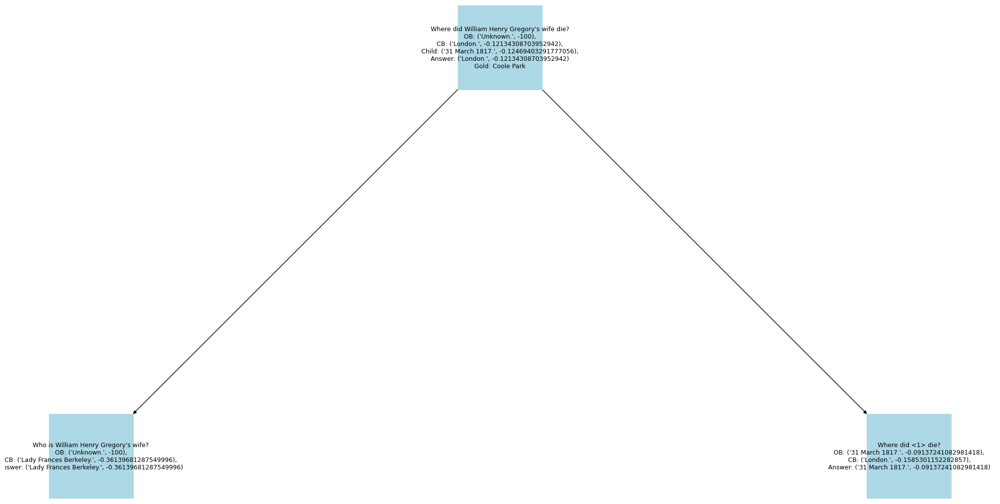

[["Where was the place of death of the director of film Touki Bouki?\nOB: ('Paris.', -0.056353923187248814),\nCB: ('Kathmandu.', -0.012848032320585),\nChild: ('Paris hospital.', -0.01856425551060068),\nAnswer: ('Kathmandu.', -0.012848032320585)\nGold: Paris", "Who is the director of film Touki Bouki?\nOB: ('Djibril Diop Mambéty.', -0.028751486479745784),\nCB: ('Khyentse Norbu.', -0.03269686547166124),\nAnswer: ('Djibril Diop Mambéty.', -0.028751486479745784)"], ["Where was the place of death of the director of film Touki Bouki?\nOB: ('Paris.', -0.056353923187248814),\nCB: ('Kathmandu.', -0.012848032320585),\nChild: ('Paris hospital.', -0.01856425551060068),\nAnswer: ('Kathmandu.', -0.012848032320585)\nGold: Paris", "Where did <1> die?\nOB: ('Paris hospital.', -0.0055754706259756245),\nCB: ('Paris.', -0.06051048650781281),\nAnswer: ('Paris hospital.', -0.0055754706259756245)"]]


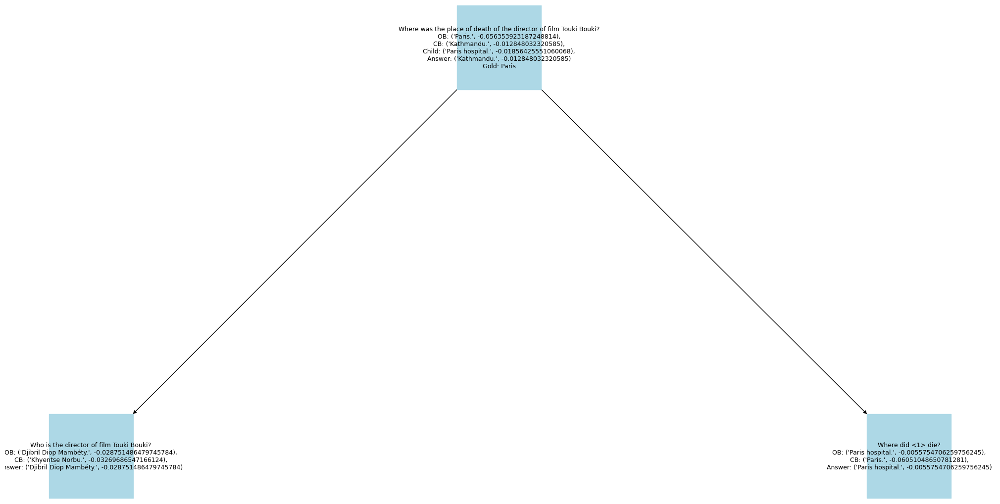

[["Did the movies The Hideout (Film) and Trieste Mia!, originate from the same country?\nOB: ('yes.', -0.20061864525034756),\nCB: ('yes.', -0.1639590263293395),\nChild: ('No.', -0.08378015465451794),\nAnswer: ('No.', -0.08378015465451794)\nGold: yes", "Which country did the movie The Hideout (Film) originate from?\nOB: ('Italy and the United States.', -0.13249475241669462),\nCB: ('France.', -0.15733261391308295),\nAnswer: ('Italy and the United States.', -0.13249475241669462)"], ["Did the movies The Hideout (Film) and Trieste Mia!, originate from the same country?\nOB: ('yes.', -0.20061864525034756),\nCB: ('yes.', -0.1639590263293395),\nChild: ('No.', -0.08378015465451794),\nAnswer: ('No.', -0.08378015465451794)\nGold: yes", "Which country did the movie Trieste Mia! originate from?\nOB: ('Italy.', -0.07322898539449833),\nCB: ('Italy.', -0.14637342173174595),\nAnswer: ('Italy.', -0.07322898539449833)"]]


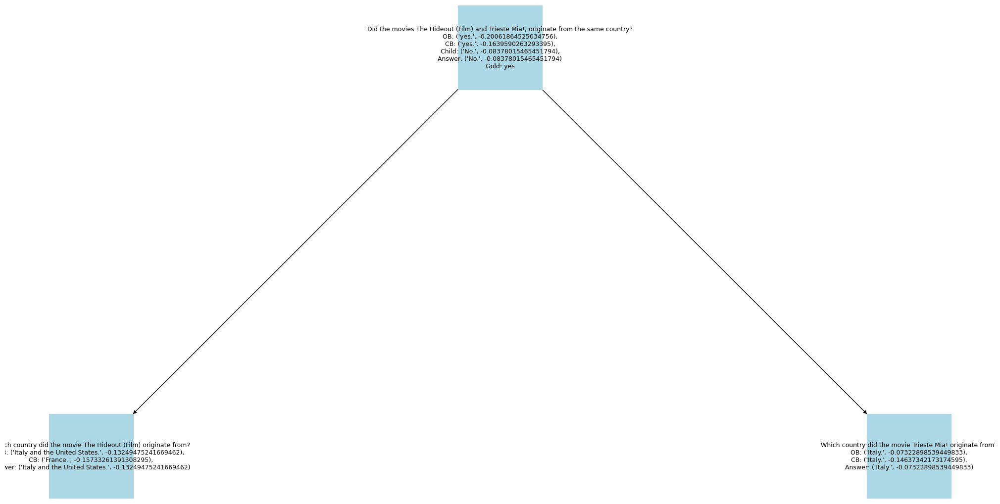

[["Where did the director of film The Great Circus Mystery die?\nOB: ('Los Angeles County, California.', -0.03325601455871167),\nCB: ('Rome.', -0.07984089424472644),\nChild: ('Los Angeles County, California.', -0.023187972950524098),\nAnswer: ('Los Angeles County, California.', -0.023187972950524098)\nGold: Los Angeles County", "Who is the director of film The Great Circus Mystery?\nOB: ('Jay Marchant.', -0.06006345357440153),\nCB: ('Vasil Zhelyaskov.', -0.2106610536478488),\nAnswer: ('Jay Marchant.', -0.06006345357440153)"], ["Where did the director of film The Great Circus Mystery die?\nOB: ('Los Angeles County, California.', -0.03325601455871167),\nCB: ('Rome.', -0.07984089424472644),\nChild: ('Los Angeles County, California.', -0.023187972950524098),\nAnswer: ('Los Angeles County, California.', -0.023187972950524098)\nGold: Los Angeles County", "Where did <1> die?\nOB: ('Los Angeles County, California.', -0.018294800866045454),\nCB: ('United Kingdom.', -0.35518197074626406),\nAnswe

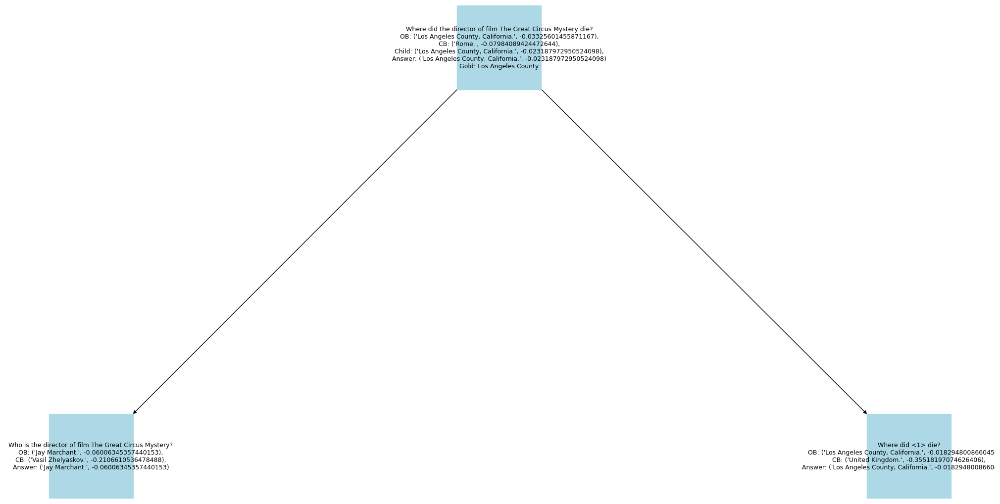

[["Which award the director of film Ang Padrino won?\nOB: ('Unknown.', -100),\nCB: ('FAMAS Award for Best Director.', -0.07086913392555559),\nChild: ('National Artist of the Philippines for Film.', -0.03660899595790171),\nAnswer: ('National Artist of the Philippines for Film.', -0.03660899595790171)\nGold: National Artist of the Philippines", "Who is the director of film Ang Padrino?\nOB: ('Fernando Poe Jr..', -0.09683533813099307),\nCB: ('Marilou Diaz-Abaya.', -0.052881205673176473),\nAnswer: ('Marilou Diaz-Abaya.', -0.052881205673176473)"], ["Which award the director of film Ang Padrino won?\nOB: ('Unknown.', -100),\nCB: ('FAMAS Award for Best Director.', -0.07086913392555559),\nChild: ('National Artist of the Philippines for Film.', -0.03660899595790171),\nAnswer: ('National Artist of the Philippines for Film.', -0.03660899595790171)\nGold: National Artist of the Philippines", "Which award did <1> win?\nOB: ('Unknown.', -100),\nCB: ('National Artist of the Philippines for Film.', -0

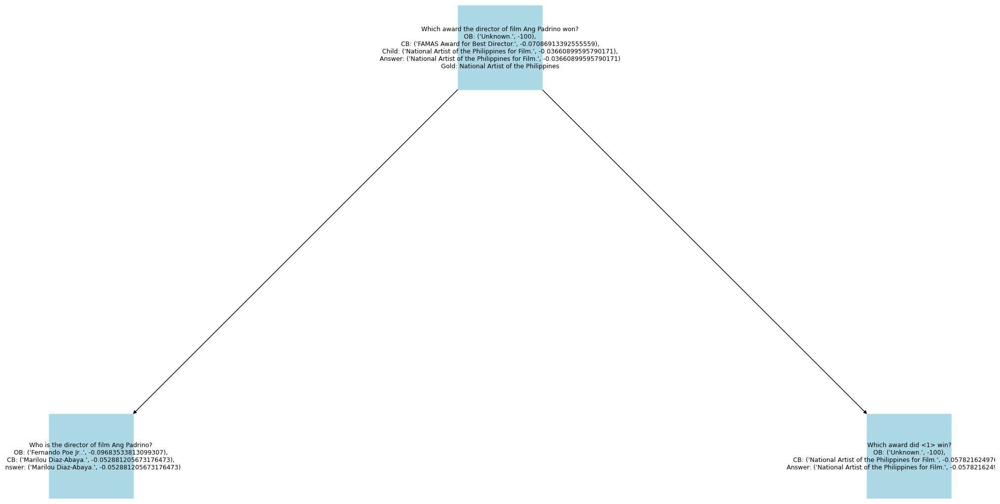

[["Who is Pepin Of Herstal's paternal grandfather?\nOB: ('Arnulf of Metz.', -0.08403831380795125),\nCB: ('Saint Arnulf of Metz.', -0.02767621685366409),\nChild: ('Arnulf of Metz.', -0.030761729377251794),\nAnswer: ('Saint Arnulf of Metz.', -0.02767621685366409)\nGold: Arnulf", "Who is Pepin Of Herstal's father?\nOB: ('Ansegisel.', -0.030931069362546155),\nCB: ('Ansegisel.', -0.031103913011044614),\nAnswer: ('Ansegisel.', -0.030931069362546155)"], ["Who is Pepin Of Herstal's paternal grandfather?\nOB: ('Arnulf of Metz.', -0.08403831380795125),\nCB: ('Saint Arnulf of Metz.', -0.02767621685366409),\nChild: ('Arnulf of Metz.', -0.030761729377251794),\nAnswer: ('Saint Arnulf of Metz.', -0.02767621685366409)\nGold: Arnulf", "Who is the father of <1>'s father?\nOB: ('Unknown.', -100),\nCB: ('Arnulf of Metz.', -0.045511057539587084),\nAnswer: ('Arnulf of Metz.', -0.045511057539587084)"]]


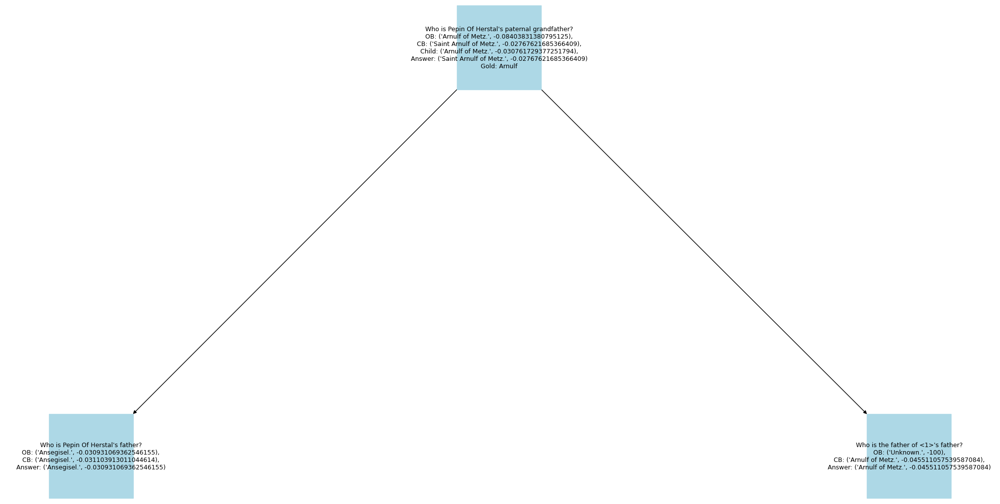

[["Where was the father of Benedikte Shetelig Kruse born?\nOB: ('London, England.', -0.022387499877736146),\nCB: ('Norway.', -0.1348927419412146),\nChild: ('London, England.', -0.018630925336130543),\nAnswer: ('London, England.', -0.018630925336130543)\nGold: London", "Who is the father of Benedikte Shetelig Kruse?\nOB: ('Bjørn Kruse.', -0.03876464902643277),\nCB: ('Henrich Kruse.', -0.1985092232328588),\nAnswer: ('Bjørn Kruse.', -0.03876464902643277)"], ["Where was the father of Benedikte Shetelig Kruse born?\nOB: ('London, England.', -0.022387499877736146),\nCB: ('Norway.', -0.1348927419412146),\nChild: ('London, England.', -0.018630925336130543),\nAnswer: ('London, England.', -0.018630925336130543)\nGold: London", "Where was <1> born?\nOB: ('London, England.', -0.01403714078221357),\nCB: ('Norway.', -0.03583187364561455),\nAnswer: ('London, England.', -0.01403714078221357)"]]


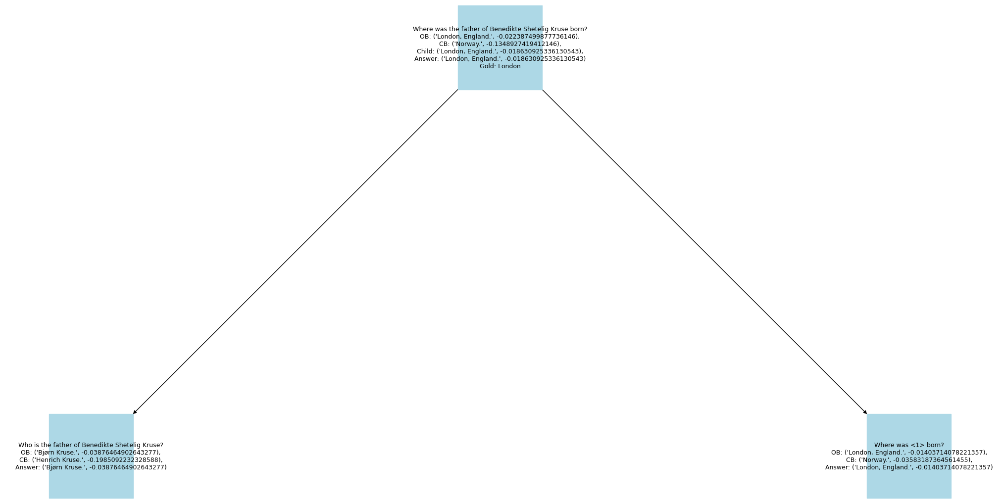

[["What is the award that the composer of film C.I.D. (1956 Film) got?\nOB: ('1958 Filmfare Award for Best Music Director.', -0.028905657970633842),\nCB: ('Filmfare Award.', -0.12960027883596248),\nChild: ('1958 Filmfare Award for Best Music Director.', -0.036545828774599054),\nAnswer: ('1958 Filmfare Award for Best Music Director.', -0.028905657970633842)\nGold: Filmfare Award", "Who is the composer of film C.I.D. (1956 Film)?\nOB: ('O. P. Nayyar.', -0.11521053879077363),\nCB: ('Salil Chowdhury.', -0.13785556394263382),\nAnswer: ('O. P. Nayyar.', -0.11521053879077363)"], ["What is the award that the composer of film C.I.D. (1956 Film) got?\nOB: ('1958 Filmfare Award for Best Music Director.', -0.028905657970633842),\nCB: ('Filmfare Award.', -0.12960027883596248),\nChild: ('1958 Filmfare Award for Best Music Director.', -0.036545828774599054),\nAnswer: ('1958 Filmfare Award for Best Music Director.', -0.028905657970633842)\nGold: Filmfare Award", "What award did <1> get?\nOB: ('1958 Fi

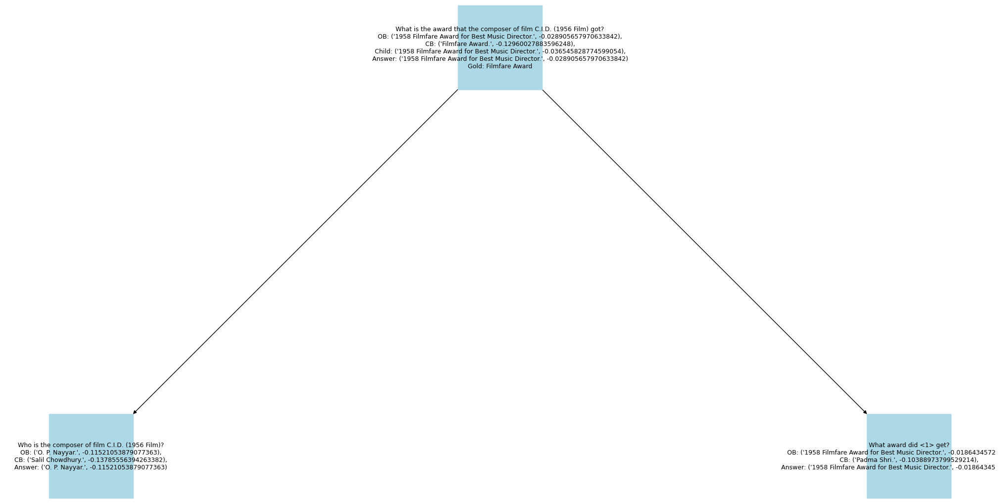

[["Who is James Franklin Perry's sibling-in-law?\nOB: ('Stephen F. Austin.', -0.10924530360472612),\nCB: ('Archie Mayo.', -0.096378485186449),\nChild: ('Matthew Perry.', -0.058581231637849084),\nAnswer: ('Matthew Perry.', -0.058581231637849084)\nGold: Stephen F. Austin", "Who is James Franklin Perry's spouse?\nOB: ('Emily Austin Perry.', -0.022792112562963995),\nCB: ('Virginia Foster Peary.', -0.21525885933945454),\nAnswer: ('Emily Austin Perry.', -0.022792112562963995)"], ["Who is James Franklin Perry's sibling-in-law?\nOB: ('Stephen F. Austin.', -0.10924530360472612),\nCB: ('Archie Mayo.', -0.096378485186449),\nChild: ('Matthew Perry.', -0.058581231637849084),\nAnswer: ('Matthew Perry.', -0.058581231637849084)\nGold: Stephen F. Austin", "Who is the sibling of <1>?\nOB: ('Unknown.', -100),\nCB: ('Matthew Perry.', -0.1328079763210925),\nAnswer: ('Matthew Perry.', -0.1328079763210925)"]]


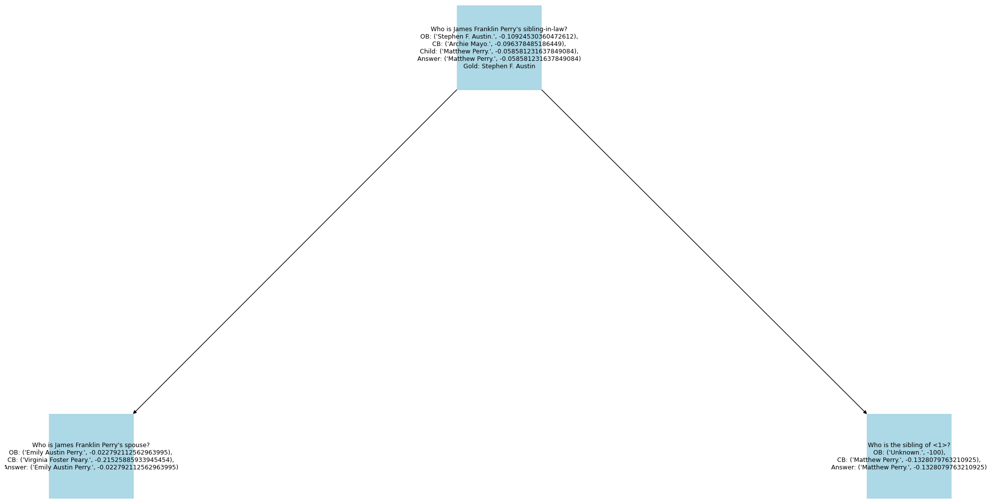

[["What is the place of birth of the composer of film Raagam Thaanam Pallavi?\nOB: ('Kerala, India.', -0.03970703079562179),\nCB: ('Panipat.', -0.1940056224620296),\nChild: ('Thrissur.', -0.027874947034521532),\nAnswer: ('Thrissur.', -0.027874947034521532)\nGold: Kerala", "Who is the composer of film Raagam Thaanam Pallavi?\nOB: ('M. K. Arjunan.', -0.027472348737184283),\nCB: ('Ilaiyaraaja.', -0.08673446430952053),\nAnswer: ('M. K. Arjunan.', -0.027472348737184283)"], ["What is the place of birth of the composer of film Raagam Thaanam Pallavi?\nOB: ('Kerala, India.', -0.03970703079562179),\nCB: ('Panipat.', -0.1940056224620296),\nChild: ('Thrissur.', -0.027874947034521532),\nAnswer: ('Thrissur.', -0.027874947034521532)\nGold: Kerala", "What is the place of birth of <1>?\nOB: ('Unknown.', -100),\nCB: ('Thrissur.', -0.07705732750619214),\nAnswer: ('Thrissur.', -0.07705732750619214)"]]


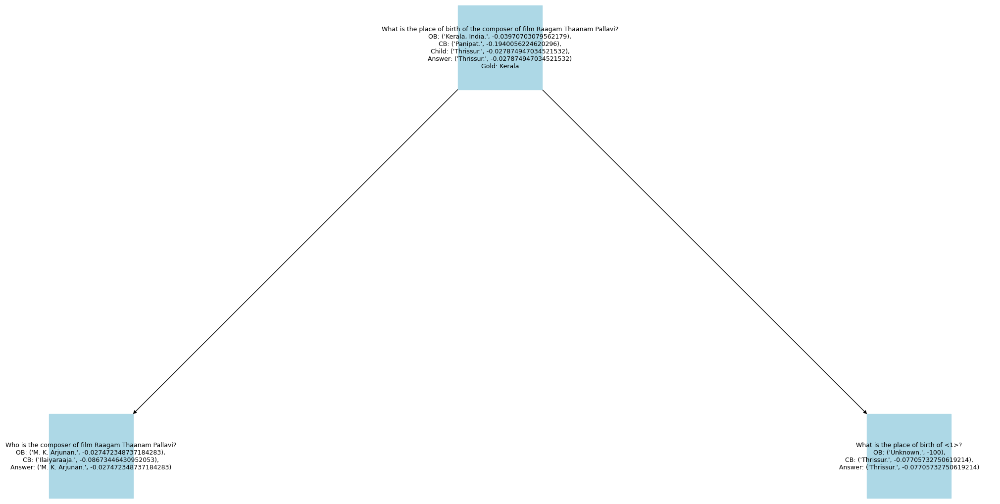

[["Why did Elizabeth Bacon Custer's husband die?\nOB: ('in the Battle of the Little Bighorn.', -0.053357305242563866),\nCB: ('battle wound.', -0.07810954647638454),\nChild: ('at the Battle of the Little Bighorn.', -0.02781034744695808),\nAnswer: ('at the Battle of the Little Bighorn.', -0.02781034744695808)\nGold: Battle of the Little Bighorn", "Who is Elizabeth Bacon Custer's husband?\nOB: ('George Armstrong Custer.', -0.040333678145802944),\nCB: ('George Armstrong Custer.', -0.05034884809781667),\nAnswer: ('George Armstrong Custer.', -0.040333678145802944)"], ["Why did Elizabeth Bacon Custer's husband die?\nOB: ('in the Battle of the Little Bighorn.', -0.053357305242563866),\nCB: ('battle wound.', -0.07810954647638454),\nChild: ('at the Battle of the Little Bighorn.', -0.02781034744695808),\nAnswer: ('at the Battle of the Little Bighorn.', -0.02781034744695808)\nGold: Battle of the Little Bighorn", "Why did <1> die?\nOB: ('At the Battle of the Little Bighorn.', -0.052800231196191164)

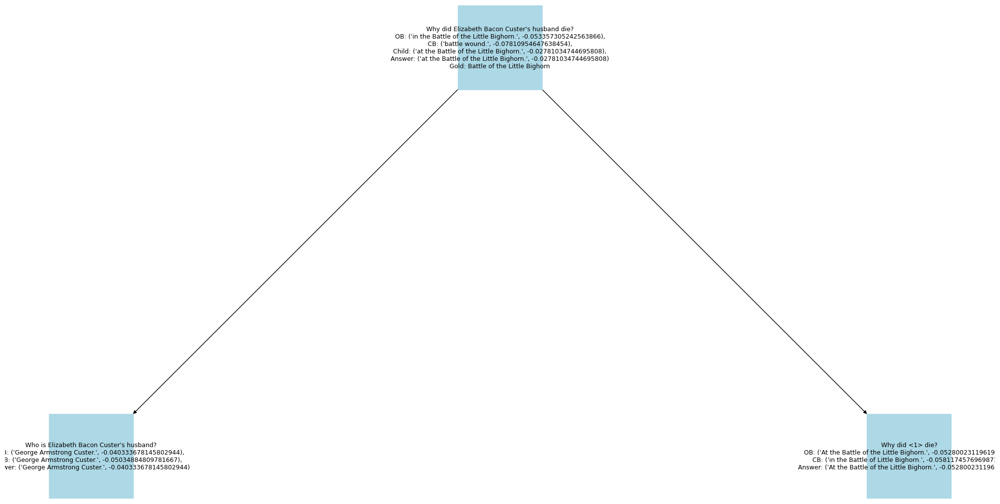

[["Which film has the director who was born first, Perdón, Viejita or Smokey And The Bandit?\nOB: ('Perdón, viejita.', -0.019935911342835094),\nCB: ('Smokey And The Bandit.', -0.11176099171206),\nChild: ('Perdón and Viejita.', -0.017626657244392996),\nAnswer: ('Perdón and Viejita.', -0.017626657244392996)\nGold: Perdón, Viejita", "When was the director of film Perdón born?\nOB: ('August 28, 1889.', -0.029257539032354587),\nCB: ('December 8, 1984.', -0.076502402540585),\nChild: ('28 August 1889.', -0.01981726180291883),\nAnswer: ('28 August 1889.', -0.01981726180291883)"], ["When was the director of film Perdón born?\nOB: ('August 28, 1889.', -0.029257539032354587),\nCB: ('December 8, 1984.', -0.076502402540585),\nChild: ('28 August 1889.', -0.01981726180291883),\nAnswer: ('28 August 1889.', -0.01981726180291883)", "Who is the director of film Perdón?\nOB: ('José A. Ferreyra.', -0.03750760355804211),\nCB: ('Hernán Guerschuny.', -0.1012283784315125),\nAnswer: ('José A. Ferreyra.', -0.037

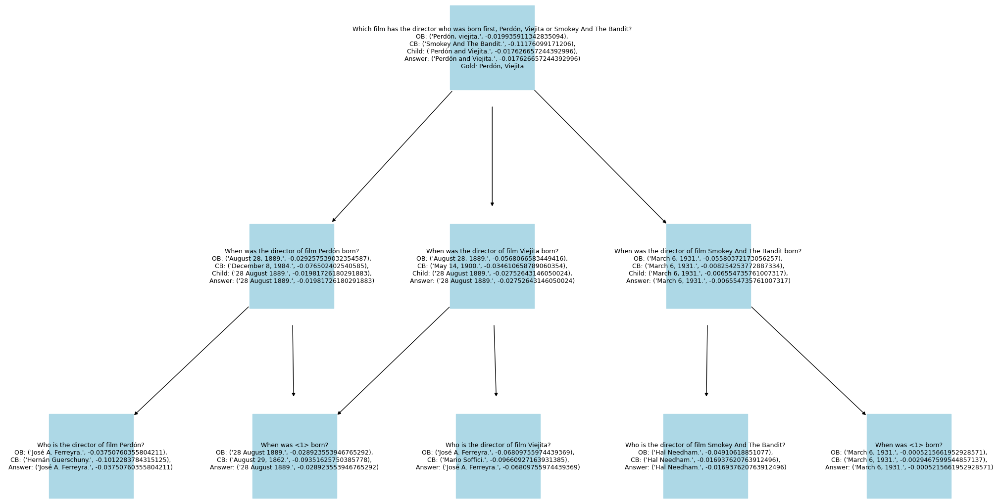

[["Who is the paternal grandfather of Euphemia Ii, Countess Of Ross?\nOB: ('Walter Leslie, Lord of Ross.', -0.013127479795561278),\nCB: ('Andrew Moray of Petty.', -0.07884270607084587),\nChild: ('Walter Leslie, Lord of Ross.', -0.02314332087185692),\nAnswer: ('Walter Leslie, Lord of Ross.', -0.013127479795561278)\nGold: Walter Leslie", "Who is the father of Euphemia Ii, Countess Of Ross?\nOB: ('Alexander Leslie, Earl of Ross.', -0.04096391646219381),\nCB: ('Hugh de Ross.', -0.06186308534052588),\nAnswer: ('Alexander Leslie, Earl of Ross.', -0.04096391646219381)"], ["Who is the paternal grandfather of Euphemia Ii, Countess Of Ross?\nOB: ('Walter Leslie, Lord of Ross.', -0.013127479795561278),\nCB: ('Andrew Moray of Petty.', -0.07884270607084587),\nChild: ('Walter Leslie, Lord of Ross.', -0.02314332087185692),\nAnswer: ('Walter Leslie, Lord of Ross.', -0.013127479795561278)\nGold: Walter Leslie", "Who is the father of <1>'s father?\nOB: ('Walter Leslie, Lord of Ross.', -0.033870100975304

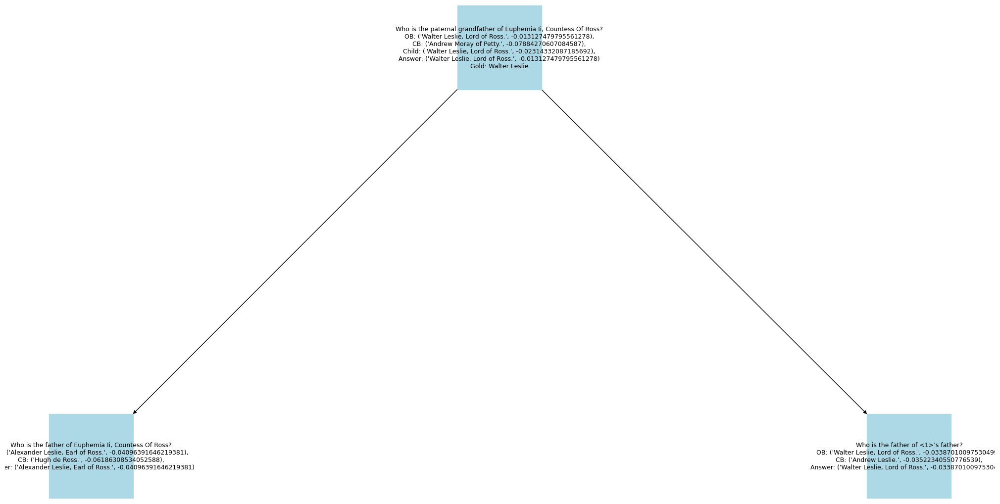

[["Where was the place of burial of Henry Of Blois's father?\nOB: ('Unknown.', -0.10391706878502001),\nCB: ('Blois.', -0.14909387389668194),\nChild: ('Abbey of Saint-Martin.', -0.10931793416954821),\nAnswer: ('Abbey of Saint-Martin.', -0.10931793416954821)\nGold: Ramla", "Who is the father of Henry Of Blois?\nOB: ('Stephen Henry, Count of Blois.', -0.07337856628477972),\nCB: ('Stephen II, Count of Blois.', -0.10903058055925267),\nAnswer: ('Stephen Henry, Count of Blois.', -0.07337856628477972)"], ["Where was the place of burial of Henry Of Blois's father?\nOB: ('Unknown.', -0.10391706878502001),\nCB: ('Blois.', -0.14909387389668194),\nChild: ('Abbey of Saint-Martin.', -0.10931793416954821),\nAnswer: ('Abbey of Saint-Martin.', -0.10931793416954821)\nGold: Ramla", "Where was the place of burial of <1>?\nOB: ('Unknown.', -100),\nCB: ('Abbey of Saint-Martin.', -0.28141810496474834),\nAnswer: ('Abbey of Saint-Martin.', -0.28141810496474834)"]]


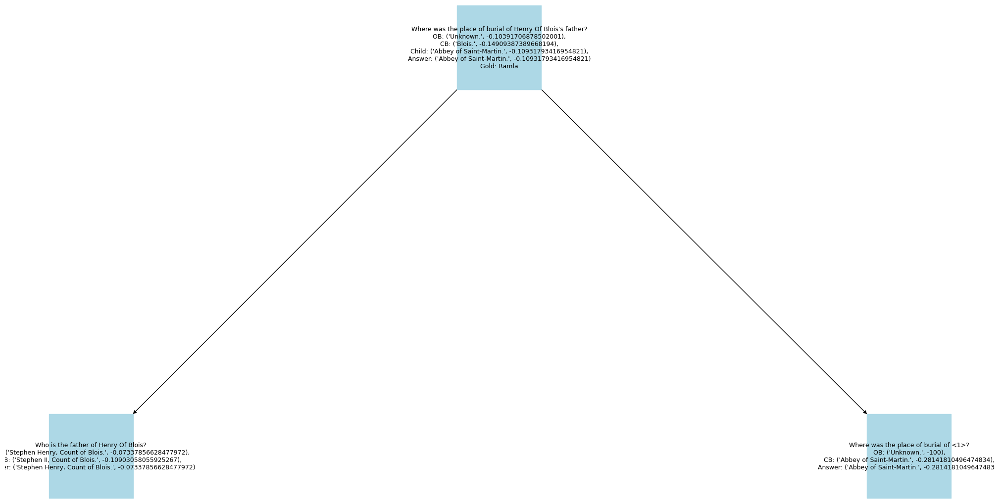

[["What is the place of birth of the director of film Love Between The Raindrops?\nOB: ('Vyškov, Czechoslovakia.', -0.023171116907403887),\nCB: ('Mumbai.', -0.16952597607594086),\nChild: ('Vyškov, Czechoslovakia.', -0.01567074277398609),\nAnswer: ('Vyškov, Czechoslovakia.', -0.01567074277398609)\nGold: Vyškov", "Who is the director of film Love Between The Raindrops?\nOB: ('Karel Kachyňa.', -0.030779025272809995),\nCB: ('FrantiÅ¡ek VlÃ¡Ä\\x8dil.', -0.12604577428108182),\nAnswer: ('Karel Kachyňa.', -0.030779025272809995)"], ["What is the place of birth of the director of film Love Between The Raindrops?\nOB: ('Vyškov, Czechoslovakia.', -0.023171116907403887),\nCB: ('Mumbai.', -0.16952597607594086),\nChild: ('Vyškov, Czechoslovakia.', -0.01567074277398609),\nAnswer: ('Vyškov, Czechoslovakia.', -0.01567074277398609)\nGold: Vyškov", "What is the place of birth of <1>?\nOB: ('Vyškov, Czechoslovakia.', -0.02537063521958368),\nCB: ('Prague.', -0.02790139128447167),\nAnswer: ('Vyškov, Czechosl

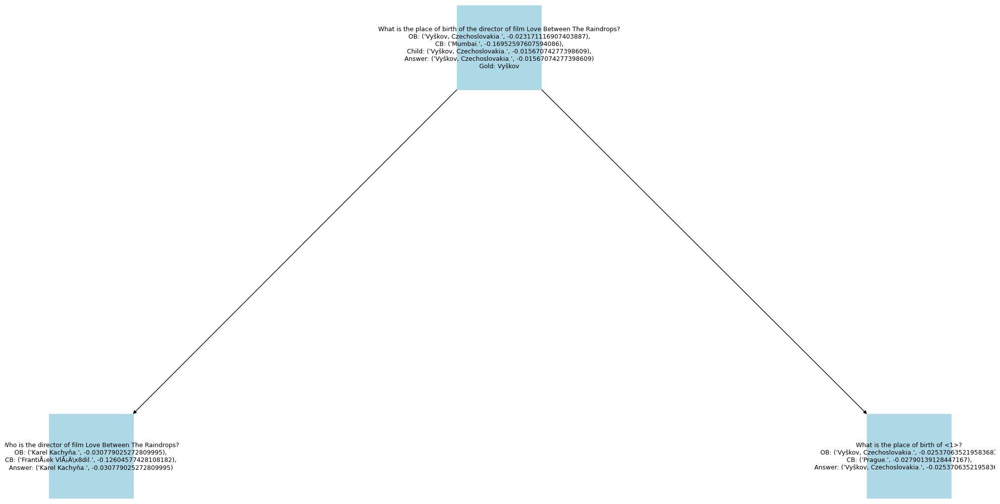

[["Which country the founder of Team Red Bull (Nascar Team) is from?\nOB: ('Austria.', -0.035382056265711996),\nCB: ('Austria.', -0.02242854545127862),\nChild: ('Unknown.', -0.027139395538873644),\nAnswer: ('Austria.', -0.02242854545127862)\nGold: Austrian", "Who is the founder of Team Red Bull (Nascar Team)?\nOB: ('Dietrich Mateschitz and Chaleo Yoovidhya.', -0.019084084744534283),\nCB: ('Dietrich Mateschitz.', -0.030057129125235258),\nAnswer: ('Dietrich Mateschitz and Chaleo Yoovidhya.', -0.019084084744534283)"], ["Which country the founder of Team Red Bull (Nascar Team) is from?\nOB: ('Austria.', -0.035382056265711996),\nCB: ('Austria.', -0.02242854545127862),\nChild: ('Unknown.', -0.027139395538873644),\nAnswer: ('Austria.', -0.02242854545127862)\nGold: Austrian", "Which country is <1> from?\nOB: ('Austria.', -0.08923274871808363),\nCB: ('no country (they are from different countries).', -0.019665568004286774),\nAnswer: ('no country (they are from different countries).', -0.0196655

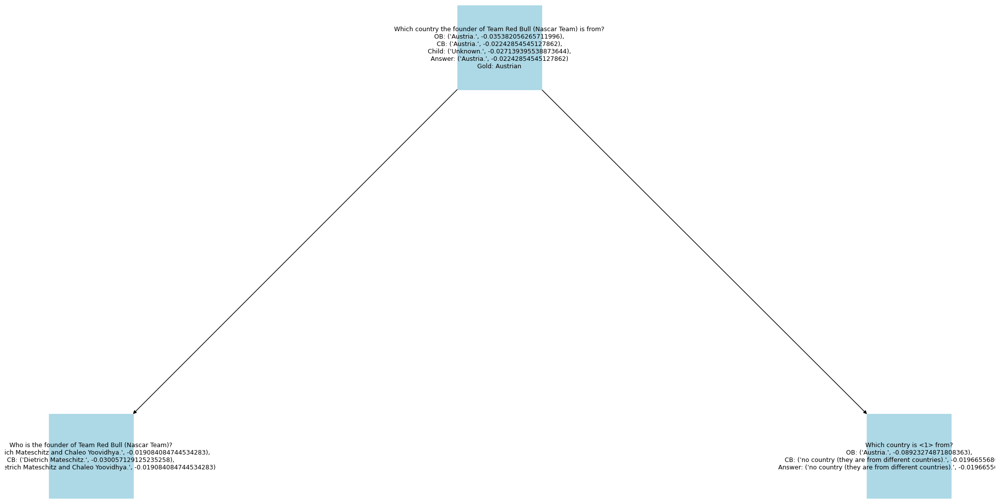

[["Who is the paternal grandfather of Bruno Ii Von Berg?\nOB: ('Adolf II of Berg-Hövel.', -0.02435547725856693),\nCB: ('Adolf von Babenberg.', -0.0450682670167825),\nChild: ('Adolf II of Berg-Hövel.', -0.03314579105929123),\nAnswer: ('Adolf II of Berg-Hövel.', -0.02435547725856693)\nGold: Adolf II of Berg", "Who is the father of Bruno Ii Von Berg?\nOB: ('Count Adolf III of Berg.', -0.043822637858867995),\nCB: ('Ezelin II von Berg.', -0.12659890616005),\nAnswer: ('Count Adolf III of Berg.', -0.043822637858867995)"], ["Who is the paternal grandfather of Bruno Ii Von Berg?\nOB: ('Adolf II of Berg-Hövel.', -0.02435547725856693),\nCB: ('Adolf von Babenberg.', -0.0450682670167825),\nChild: ('Adolf II of Berg-Hövel.', -0.03314579105929123),\nAnswer: ('Adolf II of Berg-Hövel.', -0.02435547725856693)\nGold: Adolf II of Berg", "Who is the father of <1>?\nOB: ('Adolf II of Berg-Hövel.', -0.03326791502729429),\nCB: ('Adolf II of Berg.', -0.0614048424471),\nAnswer: ('Adolf II of Berg-Hövel.', -0.03

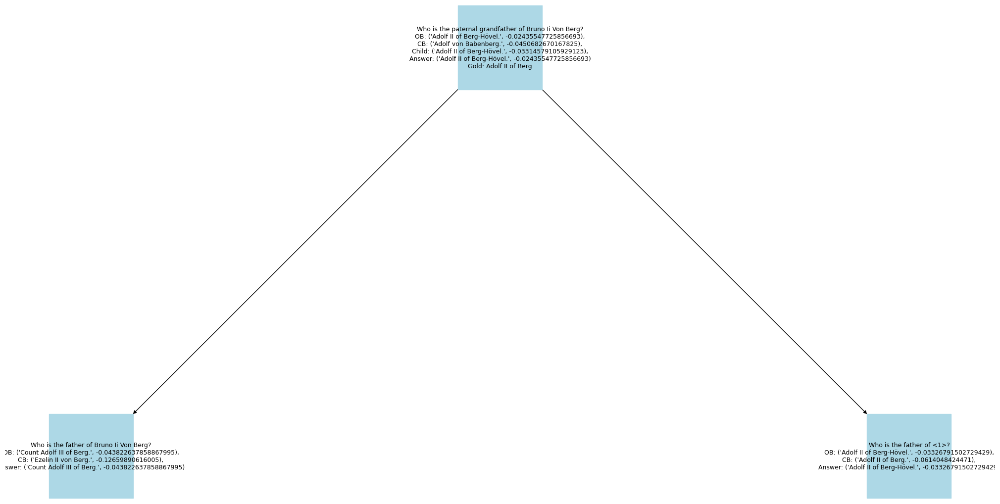

[["What is the place of birth of the performer of song Afterglow (Tina Turner Song)?\nOB: ('United States.', -0.09326325147026274),\nCB: ('Nutbush, Tennessee.', -0.08245882623724682),\nChild: ('Nutbush, Tennessee, United States.', -0.02806839062072896),\nAnswer: ('Nutbush, Tennessee, United States.', -0.02806839062072896)\nGold: Nutbush", "Who is the performer of song Afterglow (Tina Turner Song)?\nOB: ('Tina Turner.', -0.04581280300633428),\nCB: ('Tina Turner.', -0.05070771919790909),\nAnswer: ('Tina Turner.', -0.04581280300633428)"], ["What is the place of birth of the performer of song Afterglow (Tina Turner Song)?\nOB: ('United States.', -0.09326325147026274),\nCB: ('Nutbush, Tennessee.', -0.08245882623724682),\nChild: ('Nutbush, Tennessee, United States.', -0.02806839062072896),\nAnswer: ('Nutbush, Tennessee, United States.', -0.02806839062072896)\nGold: Nutbush", "What is the place of birth of <1>?\nOB: ('Nutbush, Tennessee, United States.', -0.052493487941059416),\nCB: ('Nutbush

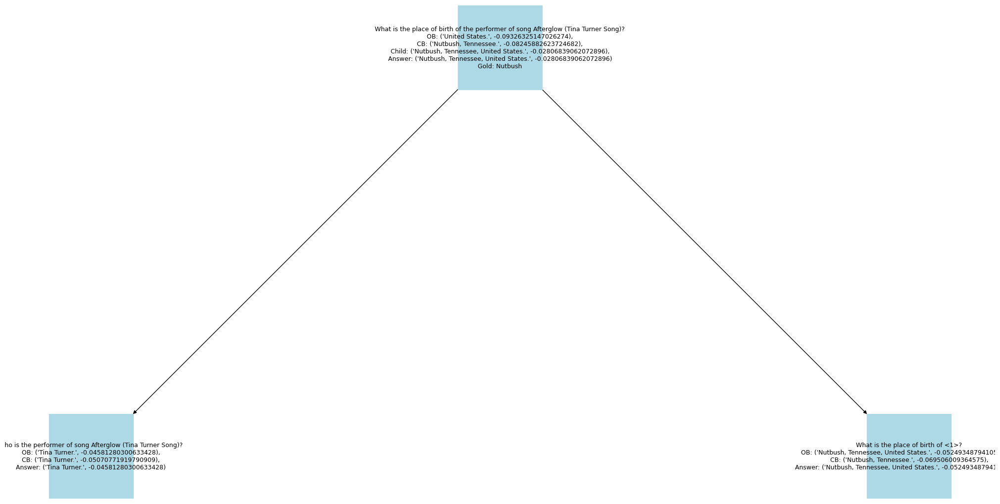

[["Who is the paternal grandfather of Duchess Elisabeth Alexandrine Of Württemberg?\nOB: ('Leopold Frederick, Duke of Württemberg-Montbéliard.', -0.02713266283273363),\nCB: ('Duke Frederick II Eugene of Württemberg.', -0.018891282005801195),\nChild: ('Frederick II Eugene, Duke of Württemberg.', -0.02028279151246109),\nAnswer: ('Duke Frederick II Eugene of Württemberg.', -0.018891282005801195)\nGold: Frederick II Eugene, Duke of Württemberg", "Who is the father of Duchess Elisabeth Alexandrine Of Württemberg?\nOB: ('Duke Louis of Württemberg.', -0.059180300734018074),\nCB: ('Frederick II, Duke of Württemberg.', -0.050753204728890375),\nAnswer: ('Frederick II, Duke of Württemberg.', -0.050753204728890375)"], ["Who is the paternal grandfather of Duchess Elisabeth Alexandrine Of Württemberg?\nOB: ('Leopold Frederick, Duke of Württemberg-Montbéliard.', -0.02713266283273363),\nCB: ('Duke Frederick II Eugene of Württemberg.', -0.018891282005801195),\nChild: ('Frederick II Eugene, Duke of Würt

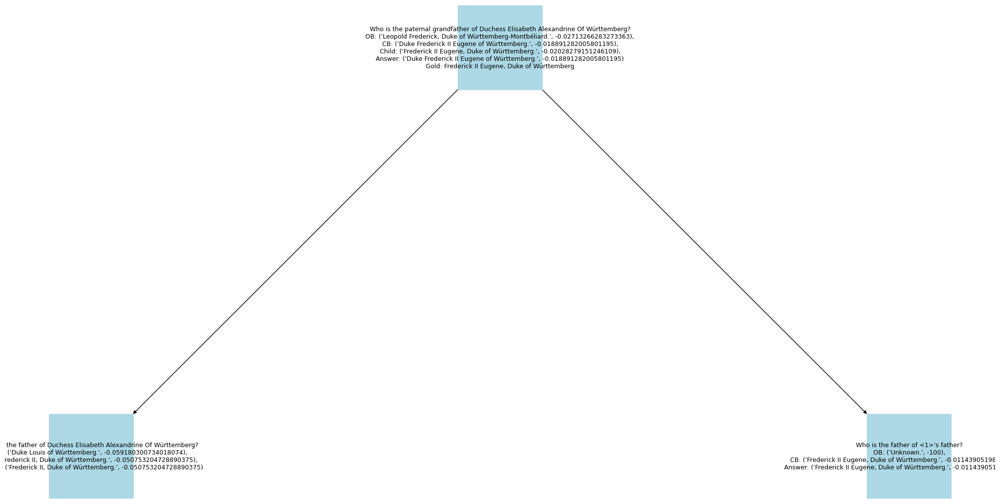

[["Where was the place of death of the performer of song Solhverv?\nOB: ('Unknown.', -0.1545273800979155),\nCB: ('Berlin.', -0.0772552565940853),\nChild: ('Norway.', -0.04825999697750604),\nAnswer: ('Norway.', -0.04825999697750604)\nGold: Sweden", "Who is the performer of song Solhverv?\nOB: ('Anita Thallaug.', -0.029093384262357504),\nCB: ('Hilmar Örn Hilmarsson.', -0.1251321193811647),\nAnswer: ('Anita Thallaug.', -0.029093384262357504)"], ["Where was the place of death of the performer of song Solhverv?\nOB: ('Unknown.', -0.1545273800979155),\nCB: ('Berlin.', -0.0772552565940853),\nChild: ('Norway.', -0.04825999697750604),\nAnswer: ('Norway.', -0.04825999697750604)\nGold: Sweden", "Where did <1> die?\nOB: ('Unknown.', -100),\nCB: ('Norway.', -0.15040437491574113),\nAnswer: ('Norway.', -0.15040437491574113)"]]


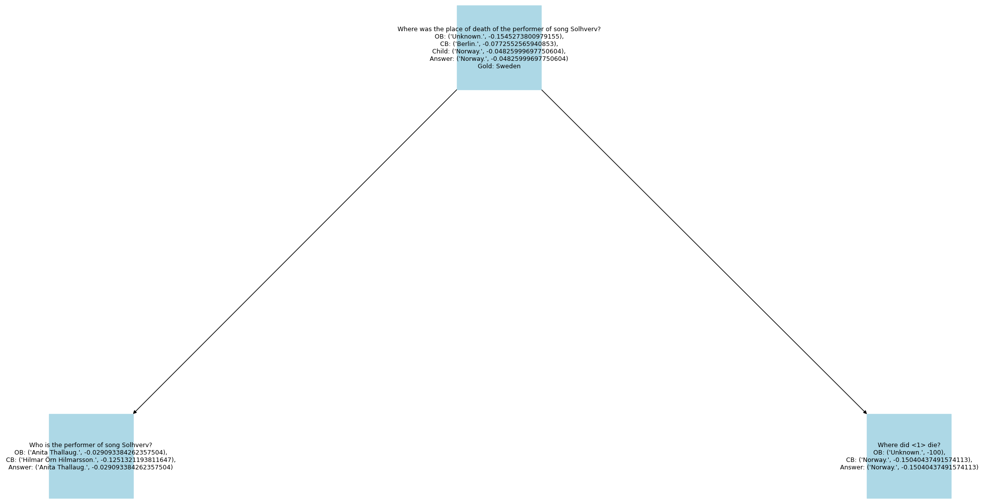

[["Who is the sibling-in-law of Giuditta Grisi?\nOB: ('Giulia Grisi.', -0.08823499827525501),\nCB: ('Umberto Costantini.', -0.07503154750300045),\nChild: ('Paolo Blasetti.', -0.05679941568270841),\nAnswer: ('Paolo Blasetti.', -0.05679941568270841)\nGold: Giovanni Matteo Mario", "Who is Giuditta Grisi married to?\nOB: ('Unknown.', -0.11354576207117353),\nCB: ('Alessandro Blasetti.', -0.07518449782087787),\nAnswer: ('Alessandro Blasetti.', -0.07518449782087787)"], ["Who is the sibling-in-law of Giuditta Grisi?\nOB: ('Giulia Grisi.', -0.08823499827525501),\nCB: ('Umberto Costantini.', -0.07503154750300045),\nChild: ('Paolo Blasetti.', -0.05679941568270841),\nAnswer: ('Paolo Blasetti.', -0.05679941568270841)\nGold: Giovanni Matteo Mario", "Who is the sibling of <1>?\nOB: ('Unknown.', -100),\nCB: ('Paolo Blasetti.', -0.06596473303006427),\nAnswer: ('Paolo Blasetti.', -0.06596473303006427)"]]


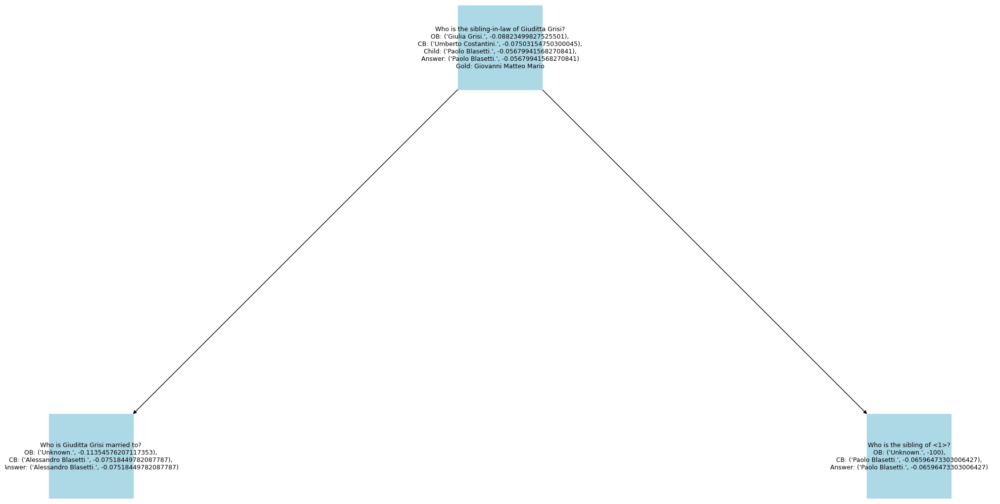

[["Who is the father of the director of film Manasuku Nachindi?\nOB: ('Unknown.', -0.0809654592582786),\nCB: ('A. K. Naidu.', -0.08808111494357189),\nChild: ('A. K. N. Reddy.', -0.04621370998146593),\nAnswer: ('A. K. N. Reddy.', -0.04621370998146593)\nGold: Krishna", "Who is the director of film Manasuku Nachindi?\nOB: ('Manjula Ghattamaneni.', -0.0865444143387861),\nCB: ('A. Kodandarami Reddy.', -0.032067461958547365),\nAnswer: ('A. Kodandarami Reddy.', -0.032067461958547365)"], ["Who is the father of the director of film Manasuku Nachindi?\nOB: ('Unknown.', -0.0809654592582786),\nCB: ('A. K. Naidu.', -0.08808111494357189),\nChild: ('A. K. N. Reddy.', -0.04621370998146593),\nAnswer: ('A. K. N. Reddy.', -0.04621370998146593)\nGold: Krishna", "Who is the father of <1>?\nOB: ('Unknown.', -100),\nCB: ('A. K. N. Reddy.', -0.14545317885992),\nAnswer: ('A. K. N. Reddy.', -0.14545317885992)"]]


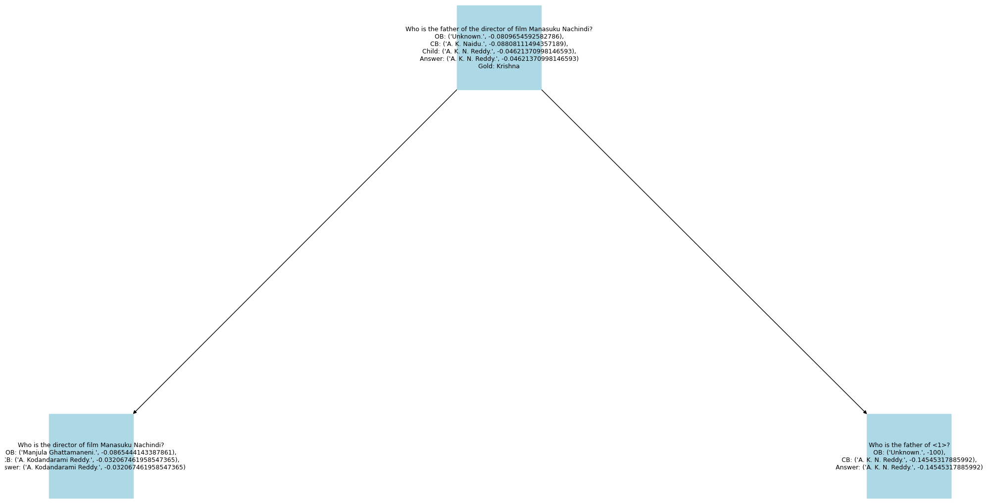

[["What is the place of birth of María De Los Remedios De Escalada's husband?\nOB: ('Yapeyú, Corrientes, Argentina.', -0.043264374716361666),\nCB: ('Valladolid.', -0.06722045433719191),\nChild: ('Yapeyú, Corrientes, Argentina.', -0.026176503455081553),\nAnswer: ('Yapeyú, Corrientes, Argentina.', -0.026176503455081553)\nGold: Yapeyú", "Who is María De Los Remedios De Escalada's husband?\nOB: ('General José de San Martín.', -0.045110195903136995),\nCB: ('José María Pando.', -0.27905538348181275),\nAnswer: ('General José de San Martín.', -0.045110195903136995)"], ["What is the place of birth of María De Los Remedios De Escalada's husband?\nOB: ('Yapeyú, Corrientes, Argentina.', -0.043264374716361666),\nCB: ('Valladolid.', -0.06722045433719191),\nChild: ('Yapeyú, Corrientes, Argentina.', -0.026176503455081553),\nAnswer: ('Yapeyú, Corrientes, Argentina.', -0.026176503455081553)\nGold: Yapeyú", "What is the place of birth of <1>?\nOB: ('Yapeyú, Corrientes, Argentina.', -0.014277925839562305)

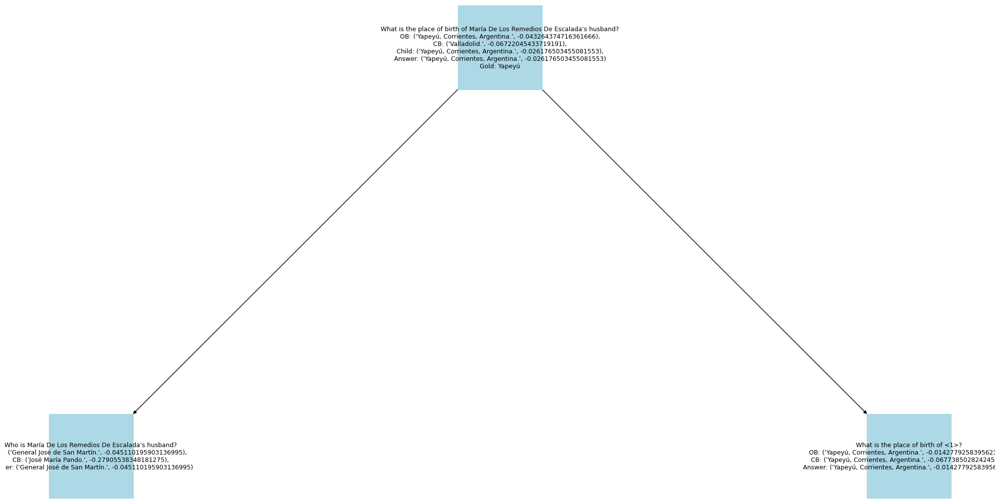

[["Who is Kaev Hua Ii's paternal grandfather?\nOB: ('Satha I.', -0.058026652849355556),\nCB: ('Norodom.', -0.05388792631943799),\nChild: ('Surajbhan Singh.', -0.0437748570784334),\nAnswer: ('Surajbhan Singh.', -0.0437748570784334)\nGold: Outey", "Who is Kaev Hua Ii's father?\nOB: ('Satha I.', -0.03292005245186334),\nCB: ('Suryavarman I.', -0.09089362505093333),\nAnswer: ('Satha I.', -0.03292005245186334)"], ["Who is Kaev Hua Ii's paternal grandfather?\nOB: ('Satha I.', -0.058026652849355556),\nCB: ('Norodom.', -0.05388792631943799),\nChild: ('Surajbhan Singh.', -0.0437748570784334),\nAnswer: ('Surajbhan Singh.', -0.0437748570784334)\nGold: Outey", "Who is the father of <1>'s father?\nOB: ('Barom Reachea I.', -0.13300883735170357),\nCB: ('Surajbhan Singh.', -0.10276326546299777),\nAnswer: ('Surajbhan Singh.', -0.10276326546299777)"]]


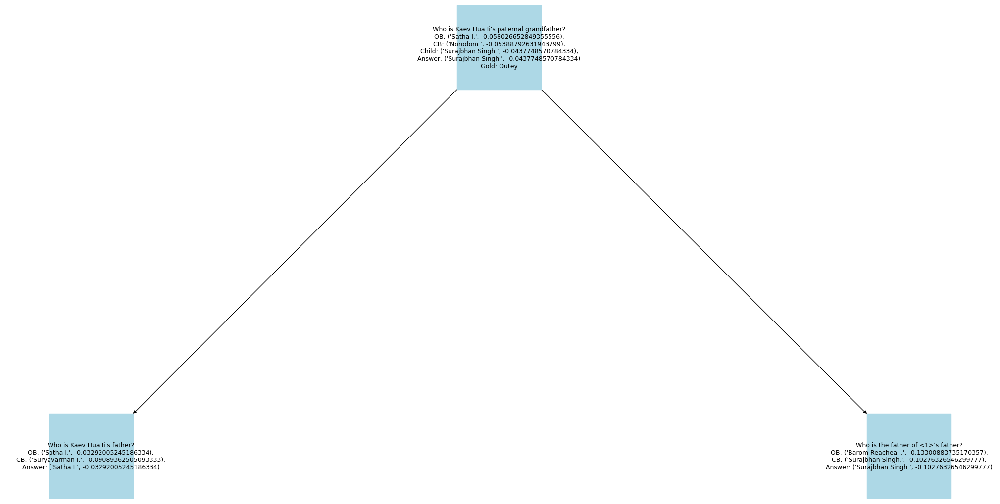

[["What nationality is the director of film Little Papa?\nOB: ('German-American.', -0.07156634302994501),\nCB: ('Japanese.', -0.12791316609686706),\nChild: ('German-American.', -0.0290518707457674),\nAnswer: ('German-American.', -0.0290518707457674)\nGold: American", "Who is the director of film Little Papa?\nOB: ('Gus Meins.', -0.04219211175896726),\nCB: ('Oleg Stepchenko.', -0.14745489447489077),\nAnswer: ('Gus Meins.', -0.04219211175896726)"], ["What nationality is the director of film Little Papa?\nOB: ('German-American.', -0.07156634302994501),\nCB: ('Japanese.', -0.12791316609686706),\nChild: ('German-American.', -0.0290518707457674),\nAnswer: ('German-American.', -0.0290518707457674)\nGold: American", "What is the nationality of <1>?\nOB: ('German-American.', -0.03907135354427273),\nCB: ('South African.', -0.18935512900266502),\nAnswer: ('German-American.', -0.03907135354427273)"]]


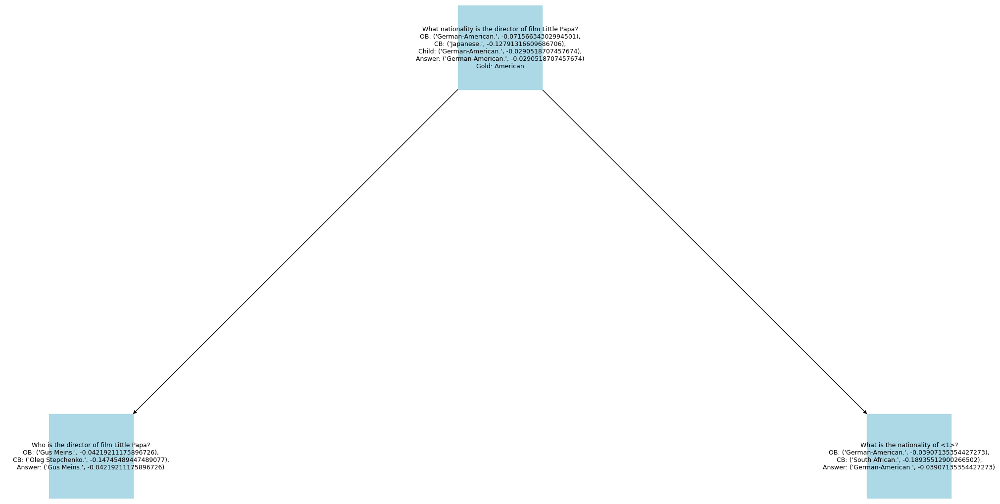

[["Did the movies The Shadow Of Evil and The Lone Wolf Takes A Chance, originate from the same country?\nOB: ('no.', -0.06325951175781531),\nCB: ('yes.', -0.11551343991363898),\nChild: ('Yes.', -0.0488888615261551),\nAnswer: ('Yes.', -0.0488888615261551)\nGold: no", "Which country did the movie The Shadow Of Evil originate from?\nOB: ('France and Italy.', -0.09319037821101832),\nCB: ('Italy.', -0.1009634089855087),\nChild: ('United States.', -0.06527878088566716),\nAnswer: ('United States.', -0.06527878088566716)"], ["Which country did the movie The Shadow Of Evil originate from?\nOB: ('France and Italy.', -0.09319037821101832),\nCB: ('Italy.', -0.1009634089855087),\nChild: ('United States.', -0.06527878088566716),\nAnswer: ('United States.', -0.06527878088566716)", "Who is the director of film The Shadow Of Evil?\nOB: ('George A. Cooper and James Reardon.', -0.08031023167557651),\nCB: ('Giorgio Ferroni.', -0.15963374809553335),\nAnswer: ('George A. Cooper and James Reardon.', -0.08031

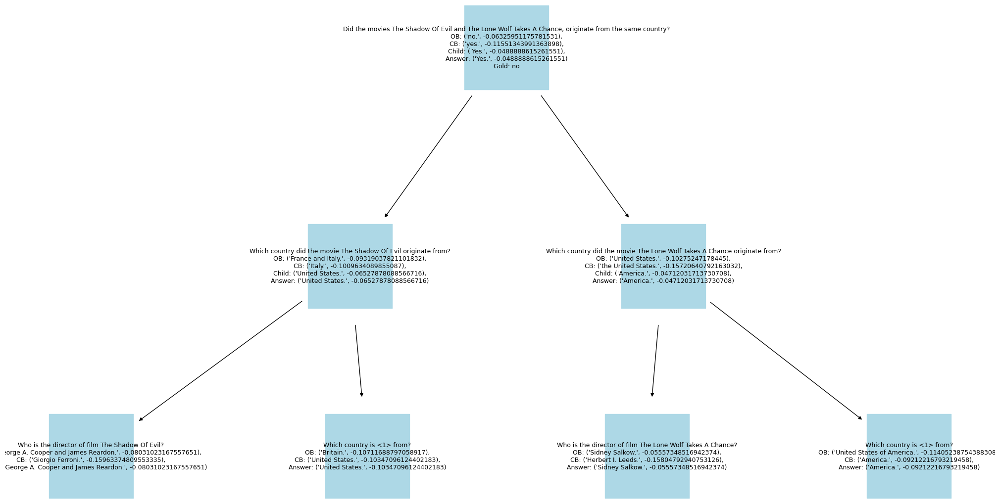

[["When is the composer of film Hi-De-Ho (1947 Film) 's birthday?\nOB: ('Unknown.', -0.14901935386237805),\nCB: ('January 26, 1910.', -0.11153609694142842),\nChild: ('January 26, 1913.', -0.05404099731249002),\nAnswer: ('January 26, 1913.', -0.05404099731249002)\nGold: December 25, 1907", "Who is the composer of film Hi-De-Ho (1947 Film)?\nOB: ('Unknown.', -0.23951461399178262),\nCB: ('Jimmy Van Heusen.', -0.15258842244385226),\nAnswer: ('Jimmy Van Heusen.', -0.15258842244385226)"], ["When is the composer of film Hi-De-Ho (1947 Film) 's birthday?\nOB: ('Unknown.', -0.14901935386237805),\nCB: ('January 26, 1910.', -0.11153609694142842),\nChild: ('January 26, 1913.', -0.05404099731249002),\nAnswer: ('January 26, 1913.', -0.05404099731249002)\nGold: December 25, 1907", "When is the birthday of <1>?\nOB: ('January 26, 1913.', -0.05597539230458313),\nCB: ('January 26, 1913.', -0.03375110045903062),\nAnswer: ('January 26, 1913.', -0.03375110045903062)"]]


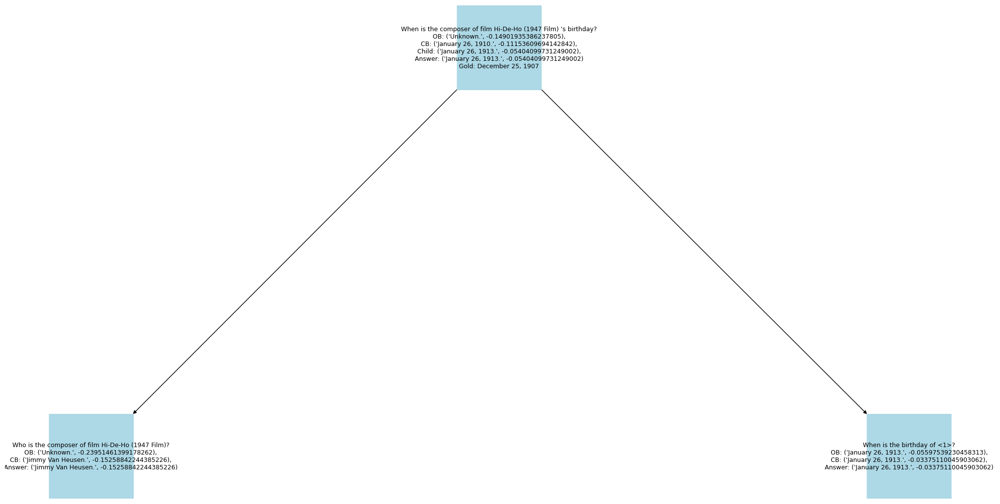

[["Which film has the director who was born earlier, A Romance Of The Air or How Moscha Came Back?\nOB: ('A Romance of the Air.', -0.1454892309902243),\nCB: ('A Romance of the Air.', -0.0913969471103971),\nChild: ('A Romance Of The Air.', -0.01631984054422749),\nAnswer: ('A Romance Of The Air.', -0.01631984054422749)\nGold: How Moscha Came Back", "When was the director of film A Romance Of The Air born?\nOB: ('16 March 1890.', -0.0646656093000237),\nCB: ('7 February 1889.', -0.06475311718765828),\nChild: ('16 March 1890.', -0.024717316275506194),\nAnswer: ('16 March 1890.', -0.024717316275506194)"], ["When was the director of film A Romance Of The Air born?\nOB: ('16 March 1890.', -0.0646656093000237),\nCB: ('7 February 1889.', -0.06475311718765828),\nChild: ('16 March 1890.', -0.024717316275506194),\nAnswer: ('16 March 1890.', -0.024717316275506194)", "Who is the director of film A Romance Of The Air?\nOB: ('Harry Revier.', -0.0714076329880207),\nCB: ('Edward Sedgwick.', -0.0715860282

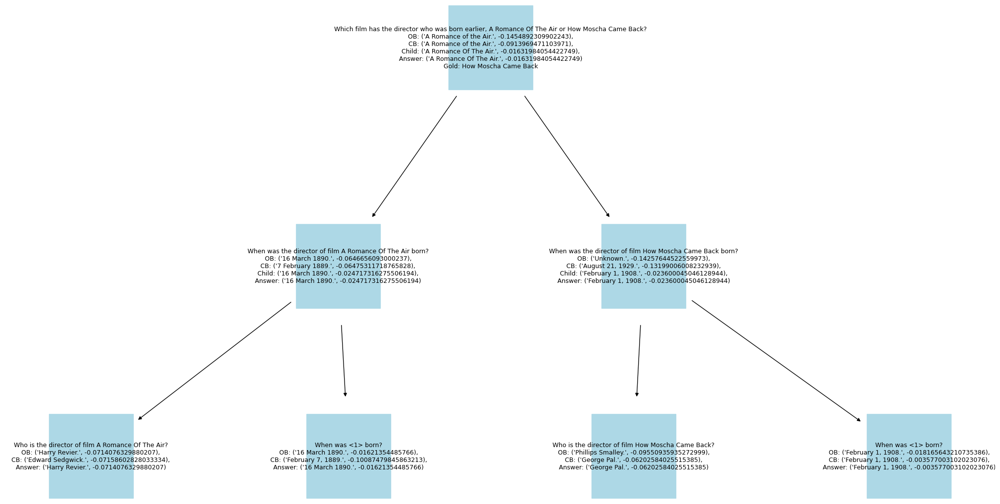

[["Where was the father of Parthamasiris Of Armenia born?\nOB: ('Parthia.', -0.13915134129774107),\nCB: ('Iran.', -0.12754649637513799),\nChild: ('Unknown.', -0.06823997440884784),\nAnswer: ('Iran.', -0.12754649637513799)\nGold: Parthian Empire", "Who is the father of Parthamasiris Of Armenia?\nOB: ('Pacorus II of Parthia.', -0.0973150243806041),\nCB: ('Gotarzes II of Armenia.]', -0.1791427062040606),\nAnswer: ('Pacorus II of Parthia.', -0.0973150243806041)"], ["Where was the father of Parthamasiris Of Armenia born?\nOB: ('Parthia.', -0.13915134129774107),\nCB: ('Iran.', -0.12754649637513799),\nChild: ('Unknown.', -0.06823997440884784),\nAnswer: ('Iran.', -0.12754649637513799)\nGold: Parthian Empire", "Where was <1> born?\nOB: ('Unknown.', -0.1477944165965189),\nCB: ('unknown.', -0.12291465519814107),\nAnswer: ('unknown.', -0.12291465519814107)"]]


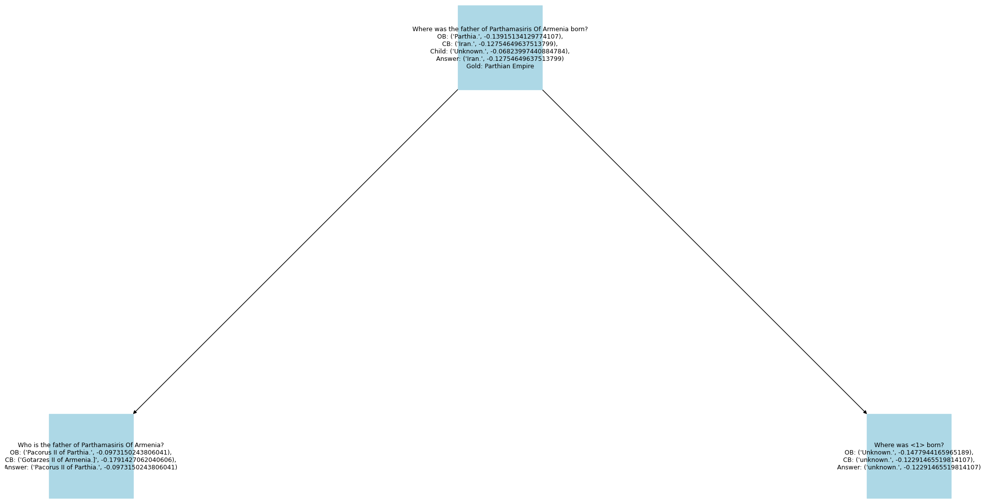

[["What nationality is Reginald Ii, Count Of Bar's father?\nOB: ('Unknown.', -0.11784509951541143),\nCB: ('French.', -0.04250083208547605),\nChild: ('French.', -0.07228433051591415),\nAnswer: ('French.', -0.04250083208547605)\nGold: France", "Who is Reginald Ii, Count Of Bar's father?\nOB: ('Reginald I.', -0.07722978012634199),\nCB: ('Frederick II, Duke of Upper Lorraine.', -0.06492442494433501),\nAnswer: ('Frederick II, Duke of Upper Lorraine.', -0.06492442494433501)"], ["What nationality is Reginald Ii, Count Of Bar's father?\nOB: ('Unknown.', -0.11784509951541143),\nCB: ('French.', -0.04250083208547605),\nChild: ('French.', -0.07228433051591415),\nAnswer: ('French.', -0.04250083208547605)\nGold: France", "What is the nationality of <1>?\nOB: ('French or Lorraine.', -0.2055499049836927),\nCB: ('French.', -0.1585319945241126),\nAnswer: ('French.', -0.1585319945241126)"]]


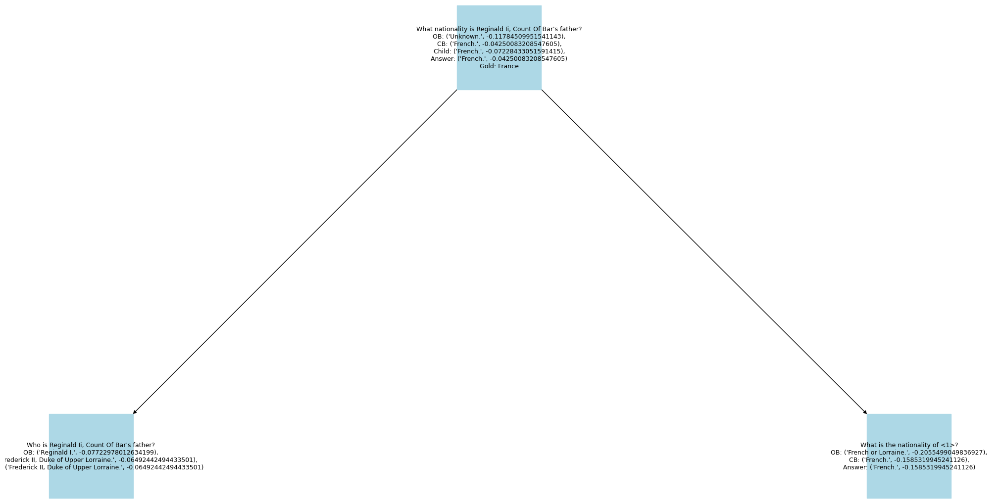

[["Which country Natalie Portman's husband is from?\nOB: ('France.', -0.12142770375871502),\nCB: ('France.', -0.025136163620605764),\nChild: ('France.', -0.012916699511994239),\nAnswer: ('France.', -0.012916699511994239)\nGold: French", "Who is Natalie Portman's husband?\nOB: ('Unknown.', -100),\nCB: ('Benjamin Millepied.', -0.03761982935632071),\nAnswer: ('Benjamin Millepied.', -0.03761982935632071)"], ["Which country Natalie Portman's husband is from?\nOB: ('France.', -0.12142770375871502),\nCB: ('France.', -0.025136163620605764),\nChild: ('France.', -0.012916699511994239),\nAnswer: ('France.', -0.012916699511994239)\nGold: French", "Which country is <1> from?\nOB: ('France.', -0.005934703419424),\nCB: ('France.', -0.05049070986663692),\nAnswer: ('France.', -0.005934703419424)"]]


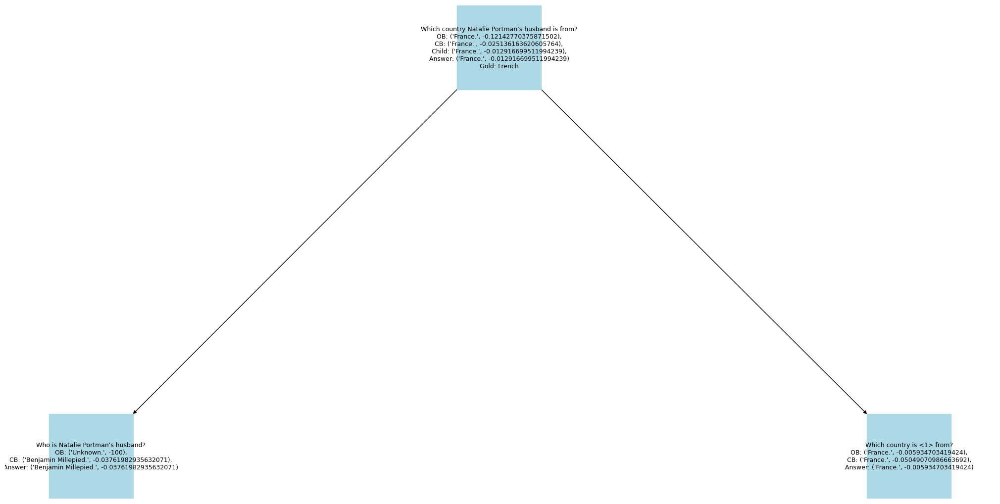

[["What is the place of birth of the composer of film Salome (1953 Film)?\nOB: ('Italy.', -0.06018567851915613),\nCB: ('Chicago.', -0.11933973578931738),\nChild: ('Multiple places (New York City and Saint Petersburg).', -0.04483416850742651),\nAnswer: ('Multiple places (New York City and Saint Petersburg).', -0.04483416850742651)\nGold: Richmond, Indiana", "Who is the composer of film Salome (1953 Film)?\nOB: ('George Duning and Daniele Amfitheatrof.', -0.06107961329274167),\nCB: ('Heinz Roemheld.', -0.13185644121775367),\nAnswer: ('George Duning and Daniele Amfitheatrof.', -0.06107961329274167)"], ["What is the place of birth of the composer of film Salome (1953 Film)?\nOB: ('Italy.', -0.06018567851915613),\nCB: ('Chicago.', -0.11933973578931738),\nChild: ('Multiple places (New York City and Saint Petersburg).', -0.04483416850742651),\nAnswer: ('Multiple places (New York City and Saint Petersburg).', -0.04483416850742651)\nGold: Richmond, Indiana", "What is the place of birth of <1>?\

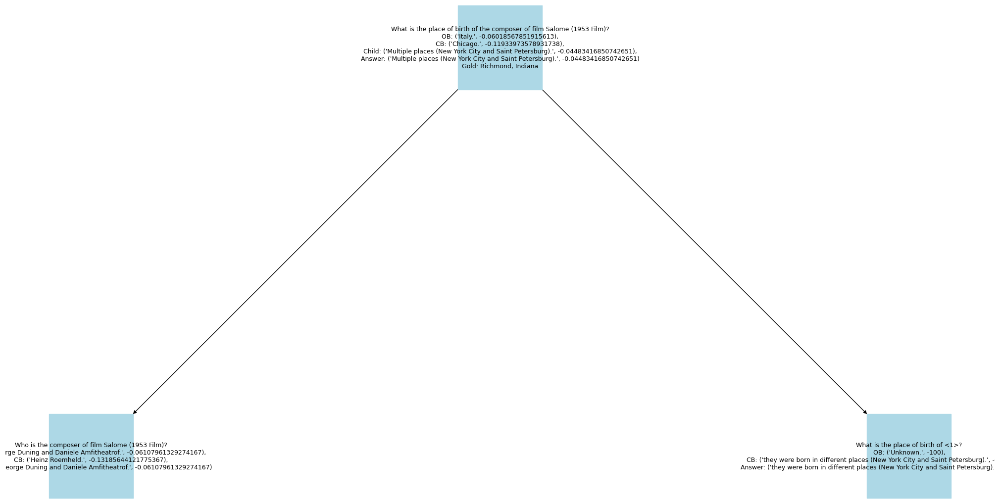

In [69]:
for parent_index in wrong_answers_indices:
    create_graph_to_problem(parent_index)

### Analyzing Correct answered examples

[["Who is the father-in-law of Queen Hyojeong?\nOB: ('Crown Prince Hyomyeong.', -0.04009066118152483),\nCB: ('King Yeongjo.', -0.0630911321835115),\nChild: ('Crown Prince Hyomyeong.', -0.03432032035946477),\nAnswer: ('Crown Prince Hyomyeong.', -0.03432032035946477)\nGold: Crown Prince Hyomyeong", "Who is Queen Hyojeong married to?\nOB: ('King Heonjong of Joseon.', -0.04996398290000933),\nCB: ('King Cheoljong.', -0.053805460199916666),\nAnswer: ('King Heonjong of Joseon.', -0.04996398290000933)"], ["Who is the father-in-law of Queen Hyojeong?\nOB: ('Crown Prince Hyomyeong.', -0.04009066118152483),\nCB: ('King Yeongjo.', -0.0630911321835115),\nChild: ('Crown Prince Hyomyeong.', -0.03432032035946477),\nAnswer: ('Crown Prince Hyomyeong.', -0.03432032035946477)\nGold: Crown Prince Hyomyeong", "Who is the father of <1>?\nOB: ('Crown Prince Hyomyeong.', -0.026294382062433685),\nCB: ('King Taejong of Joseon.', -0.05121584034369556),\nAnswer: ('Crown Prince Hyomyeong.', -0.026294382062433685)"]

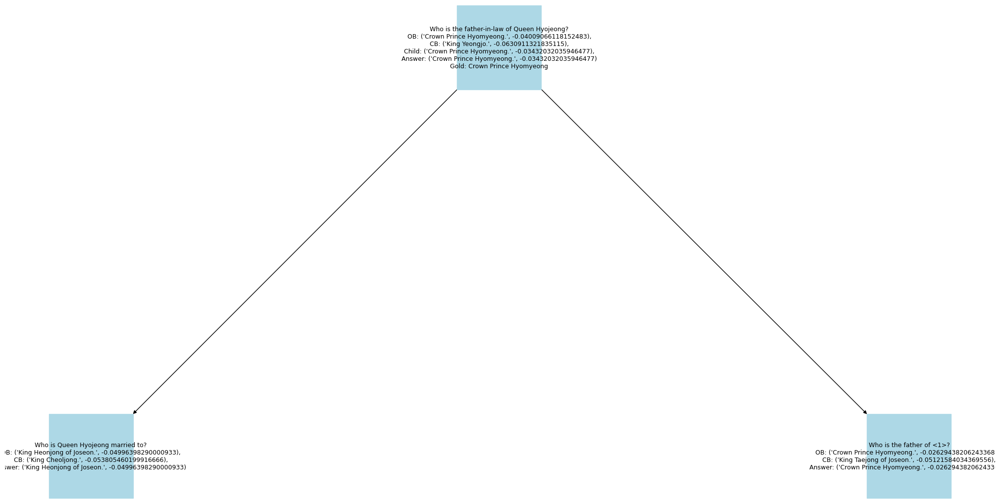

[["Which one was established first, Grouplogic or Inbios?\nOB: ('GroupLogic.', -0.0482091428733015),\nCB: ('Grouplogic.', -0.09714452133321846),\nChild: ('Grouplogic.', -0.007521251751184682),\nAnswer: ('Grouplogic.', -0.007521251751184682)\nGold: Grouplogic", "When was Grouplogic established?\nOB: ('1988.', -0.013281994173255558),\nCB: ('1992.', -0.13188666797733334),\nAnswer: ('1988.', -0.013281994173255558)"], ["Which one was established first, Grouplogic or Inbios?\nOB: ('GroupLogic.', -0.0482091428733015),\nCB: ('Grouplogic.', -0.09714452133321846),\nChild: ('Grouplogic.', -0.007521251751184682),\nAnswer: ('Grouplogic.', -0.007521251751184682)\nGold: Grouplogic", "When was Inbios established?\nOB: ('1996.', -0.006155124742492142),\nCB: ('1992.', -0.18596439989711822),\nAnswer: ('1996.', -0.006155124742492142)"]]


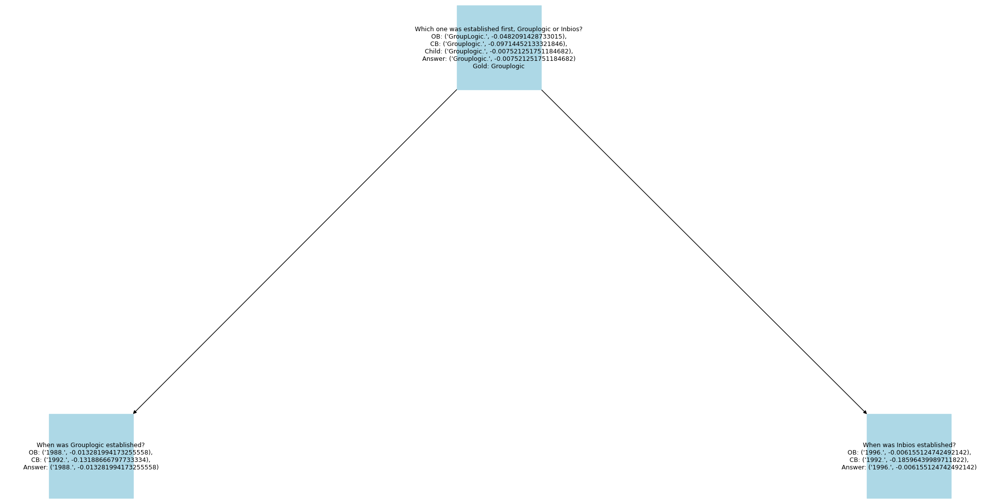

[["Who is younger, Halcón Suriano Jr. or Pierre De Geyter?\nOB: ('Halcón Suriano Jr.', -0.010019374480896058),\nCB: ('Halcón Suriano Jr.', -0.15783177449305463),\nChild: ('Halcón Suriano Jr.', -0.009654011744761156),\nAnswer: ('Halcón Suriano Jr.', -0.009654011744761156)\nGold: Halcón Suriano Jr.", "When was Halcón Suriano Jr. born?\nOB: ('May 8, 1994.', -0.0011176533116155555),\nCB: ('24 August 1958.', -0.4208861168823353),\nAnswer: ('May 8, 1994.', -0.0011176533116155555)"], ["Who is younger, Halcón Suriano Jr. or Pierre De Geyter?\nOB: ('Halcón Suriano Jr.', -0.010019374480896058),\nCB: ('Halcón Suriano Jr.', -0.15783177449305463),\nChild: ('Halcón Suriano Jr.', -0.009654011744761156),\nAnswer: ('Halcón Suriano Jr.', -0.009654011744761156)\nGold: Halcón Suriano Jr.", "When was Pierre De Geyter born?\nOB: ('8 October 1848.', -0.025295684236791578),\nCB: ('8 October 1848.', -0.023147687248903117),\nAnswer: ('8 October 1848.', -0.023147687248903117)"]]


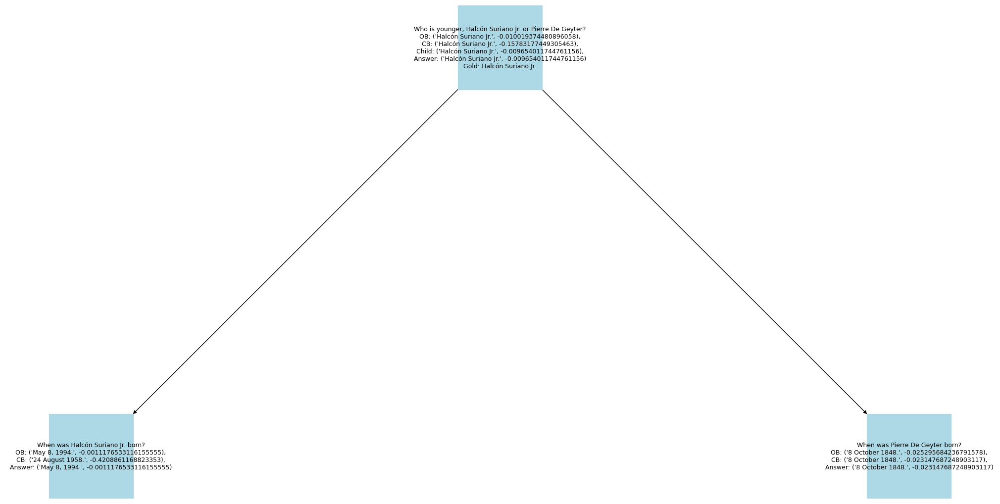

[["Where did Abe Laboriel Jr.'s father study?\nOB: ('Berklee College of Music.', -0.046595313218153196),\nCB: ('University of Santo Tomas.', -0.03743534731255124),\nChild: ('Berklee College of Music.', -0.022375869193898515),\nAnswer: ('Berklee College of Music.', -0.022375869193898515)\nGold: Berklee College of Music", "Who is Abe Laboriel Jr.'s father?\nOB: ('Abraham Laboriel Sr.', -0.06091478057977071),\nCB: ('Abe Laboriel.', -0.027490982816196927),\nAnswer: ('Abe Laboriel.', -0.027490982816196927)"], ["Where did Abe Laboriel Jr.'s father study?\nOB: ('Berklee College of Music.', -0.046595313218153196),\nCB: ('University of Santo Tomas.', -0.03743534731255124),\nChild: ('Berklee College of Music.', -0.022375869193898515),\nAnswer: ('Berklee College of Music.', -0.022375869193898515)\nGold: Berklee College of Music", "Where did <1> study?\nOB: ('Berklee College of Music.', -0.04615920805128364),\nCB: ('University of California, Los Angeles (UCLA).', -0.13590467684358823),\nAnswer: ('

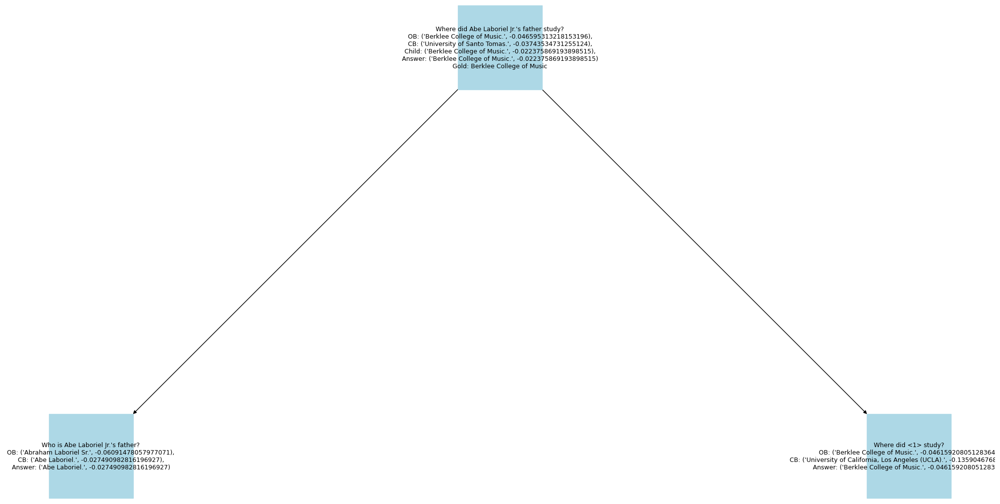

[['Where did Edward Hoby\'s father study?\nOB: ("St. John\'s College, Cambridge.", -0.06371559086526385),\nCB: (\'Cambridge University.\', -0.13121479748508277),\nChild: (\'Eton College.\', -0.06782667140767268),\nAnswer: ("St. John\'s College, Cambridge.", -0.06371559086526385)\nGold: St. John\'s College, Cambridge', "Who is Edward Hoby's father?\nOB: ('Unknown.', -100),\nCB: ('John Hoby.', -0.1059703945146),\nAnswer: ('John Hoby.', -0.1059703945146)"], ['Where did Edward Hoby\'s father study?\nOB: ("St. John\'s College, Cambridge.", -0.06371559086526385),\nCB: (\'Cambridge University.\', -0.13121479748508277),\nChild: (\'Eton College.\', -0.06782667140767268),\nAnswer: ("St. John\'s College, Cambridge.", -0.06371559086526385)\nGold: St. John\'s College, Cambridge', "Where did <1> study?\nOB: ('Unknown.', -100),\nCB: ('Eton College.', -0.14950476752555553),\nAnswer: ('Eton College.', -0.14950476752555553)"]]


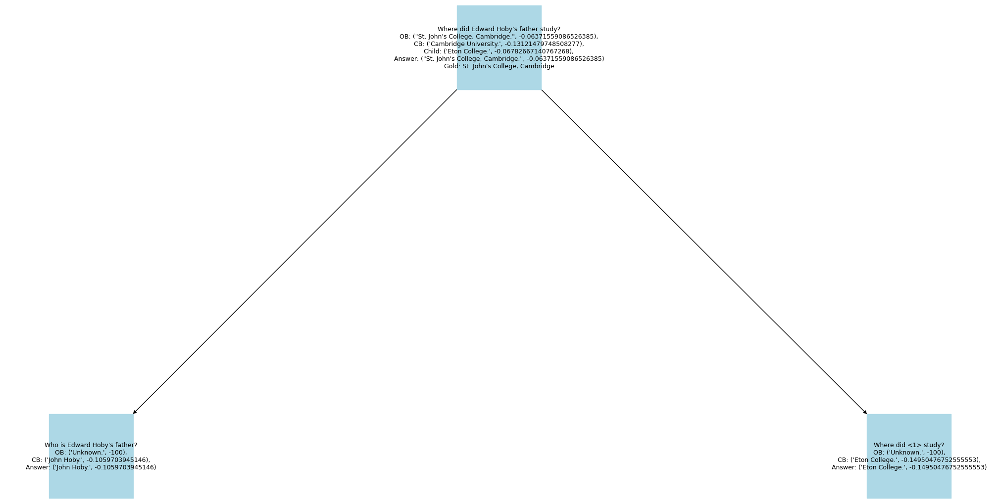

[["Which film came out first, Poznań '56 or The Last Day Of School Before Christmas?\nOB: ('The Last Day of School Before Christmas.', -0.03329618310220111),\nCB: ('The Last Day of School Before Christmas.', -0.05670257337938454),\nChild: ('The Last Day Of School Before Christmas.', -0.026231800325473016),\nAnswer: ('The Last Day Of School Before Christmas.', -0.026231800325473016)\nGold: The Last Day Of School Before Christmas", "When was the film Poznań '56 published?\nOB: ('1996.', -0.019921481607870717),\nCB: ('1956.', -0.04148866234139938),\nAnswer: ('1996.', -0.019921481607870717)"], ["Which film came out first, Poznań '56 or The Last Day Of School Before Christmas?\nOB: ('The Last Day of School Before Christmas.', -0.03329618310220111),\nCB: ('The Last Day of School Before Christmas.', -0.05670257337938454),\nChild: ('The Last Day Of School Before Christmas.', -0.026231800325473016),\nAnswer: ('The Last Day Of School Before Christmas.', -0.026231800325473016)\nGold: The Last Day

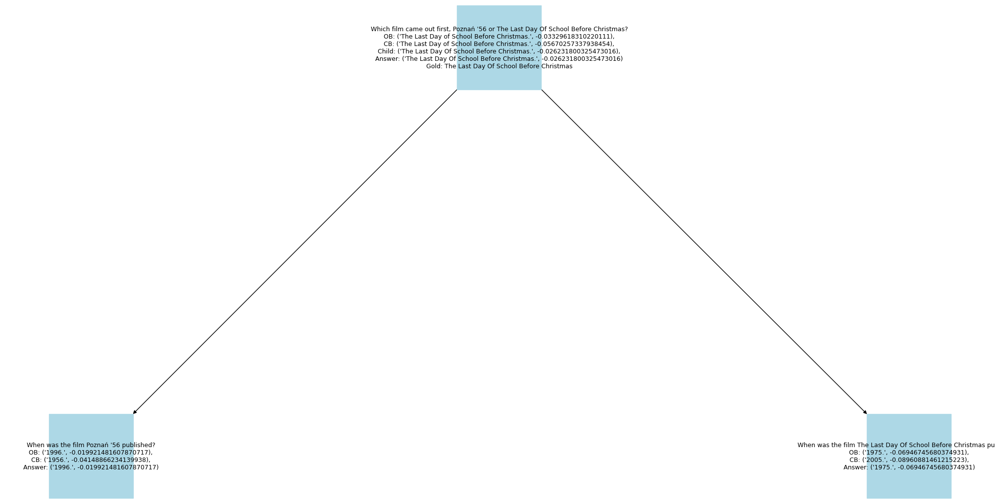

[["Who is the husband of Princess Elene Of Georgia?\nOB: ('Prince Archil of Imereti.', -0.11725858019322867),\nCB: ('Zviad Gamsakhurdia.', -0.14507702973574835),\nChild: ('Prince Archil of Imereti.', -0.04339777289473935),\nAnswer: ('Prince Archil of Imereti.', -0.04339777289473935)\nGold: Prince Archil of Imereti", "Who is Princess Elene Of Georgia married to?\nOB: ('Prince Archil of Imereti.', -0.04022507808032823),\nCB: ('Zviad Gamsakhurdia.', -0.05193305680439056),\nAnswer: ('Prince Archil of Imereti.', -0.04022507808032823)"], ["Who is the husband of Princess Elene Of Georgia?\nOB: ('Prince Archil of Imereti.', -0.11725858019322867),\nCB: ('Zviad Gamsakhurdia.', -0.14507702973574835),\nChild: ('Prince Archil of Imereti.', -0.04339777289473935),\nAnswer: ('Prince Archil of Imereti.', -0.04339777289473935)\nGold: Prince Archil of Imereti", "Who is the husband of <1>?\nOB: ('Unknown.', -100),\nCB: ('Daredjan Dadiani.', -0.05772371521201001),\nAnswer: ('Daredjan Dadiani.', -0.05772371

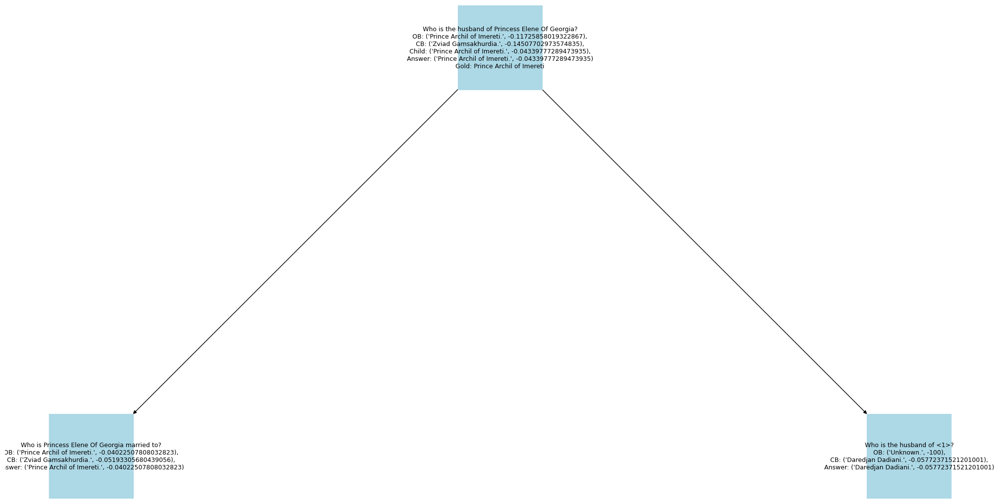

[["Which film has the director born first, Gopalapuranam or Here Is The Beauty?\nOB: ('Here Is the Beauty.', -0.09044028051856612),\nCB: ('Gopalapuranam.', -0.13190550678346893),\nChild: ('Here Is The Beauty.', -0.015094538604848225),\nAnswer: ('Here Is The Beauty.', -0.015094538604848225)\nGold: Here Is The Beauty", "When was the director of film Gopalapuranam born?\nOB: ('Unknown.', -0.1257953799210171),\nCB: ('24 August 1934.', -0.1082970140363617),\nChild: ('24 September 1938.', -0.024625861932024592),\nAnswer: ('24 September 1938.', -0.024625861932024592)"], ["When was the director of film Gopalapuranam born?\nOB: ('Unknown.', -0.1257953799210171),\nCB: ('24 August 1934.', -0.1082970140363617),\nChild: ('24 September 1938.', -0.024625861932024592),\nAnswer: ('24 September 1938.', -0.024625861932024592)", "Who is the director of film Gopalapuranam?\nOB: ('K. K. Haridas.', -0.04777488290401117),\nCB: ('K. Vijaya Bhaskar.', -0.037444690861394445),\nAnswer: ('K. Vijaya Bhaskar.', -0.0

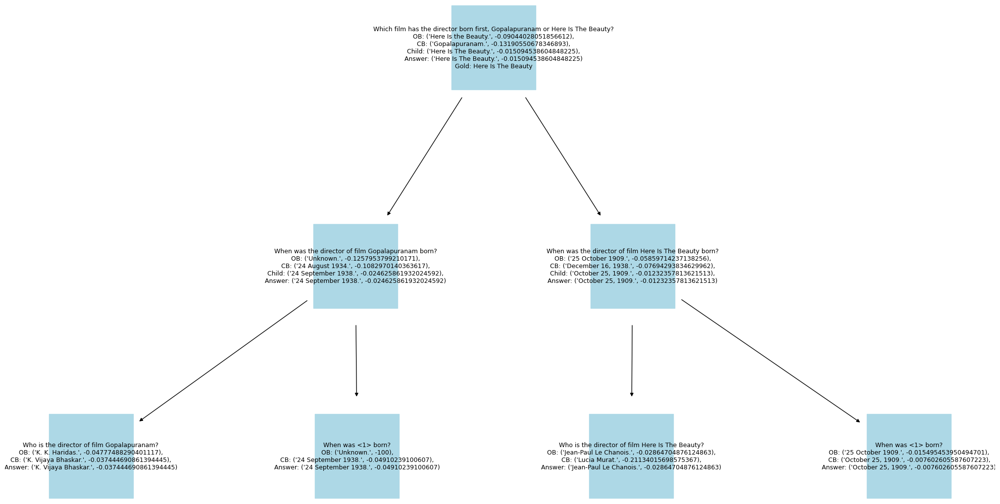

[["Who is the father of the performer of song Lighter (Miley Cyrus Song)?\nOB: ('Billy Ray Cyrus.', -0.05205495621341875),\nCB: ('Billy Ray Cyrus.', -0.05148211419224864),\nChild: ('Billy Ray Cyrus.', -0.03516800844126831),\nAnswer: ('Billy Ray Cyrus.', -0.03516800844126831)\nGold: Billy Ray Cyrus", "Who is the performer of song Lighter (Miley Cyrus Song)?\nOB: ('Miley Cyrus.', -0.032676116673716664),\nCB: ('Miley Cyrus.', -0.026341633197825443),\nAnswer: ('Miley Cyrus.', -0.026341633197825443)"], ["Who is the father of the performer of song Lighter (Miley Cyrus Song)?\nOB: ('Billy Ray Cyrus.', -0.05205495621341875),\nCB: ('Billy Ray Cyrus.', -0.05148211419224864),\nChild: ('Billy Ray Cyrus.', -0.03516800844126831),\nAnswer: ('Billy Ray Cyrus.', -0.03516800844126831)\nGold: Billy Ray Cyrus", "Who is the father of <1>?\nOB: ('Billy Ray Cyrus.', -0.11160363008593803),\nCB: ('Billy Ray Cyrus.', -0.08160575951721273),\nAnswer: ('Billy Ray Cyrus.', -0.08160575951721273)"]]


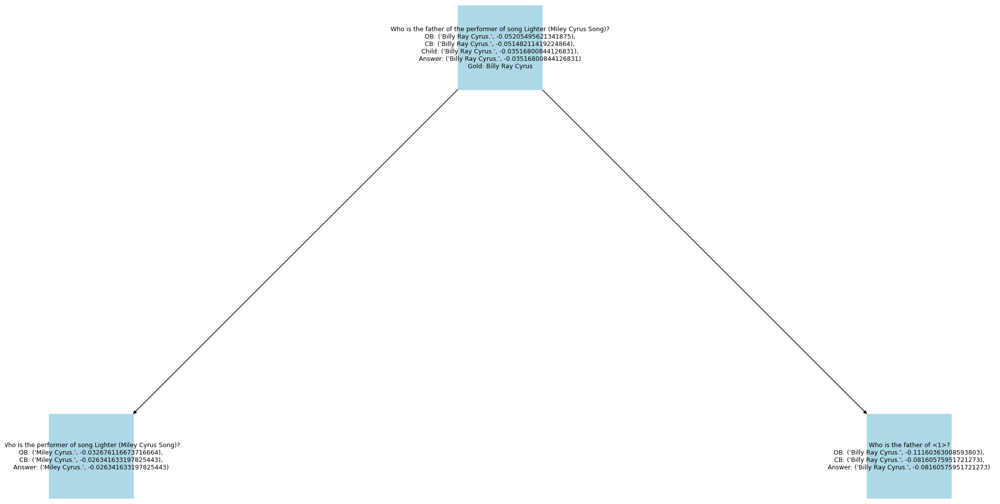

[["Where was the place of death of Suzanne Farrington's mother?\nOB: ('Unknown.', -0.1107891198383611),\nCB: ('London.', -0.14472924407377366),\nChild: ('London.', -0.048174987177674704),\nAnswer: ('London.', -0.048174987177674704)\nGold: London", "Who is the mother of Suzanne Farrington?\nOB: ('Vivien Leigh.', -0.021160155534760833),\nCB: ('Vivien Leigh.', -0.15918050163488168),\nAnswer: ('Vivien Leigh.', -0.021160155534760833)"], ["Where was the place of death of Suzanne Farrington's mother?\nOB: ('Unknown.', -0.1107891198383611),\nCB: ('London.', -0.14472924407377366),\nChild: ('London.', -0.048174987177674704),\nAnswer: ('London.', -0.048174987177674704)\nGold: London", "Where did <1> die?\nOB: ('Unknown.', -0.09976813223711001),\nCB: ('London.', -0.10873212827564001),\nAnswer: ('London.', -0.10873212827564001)"]]


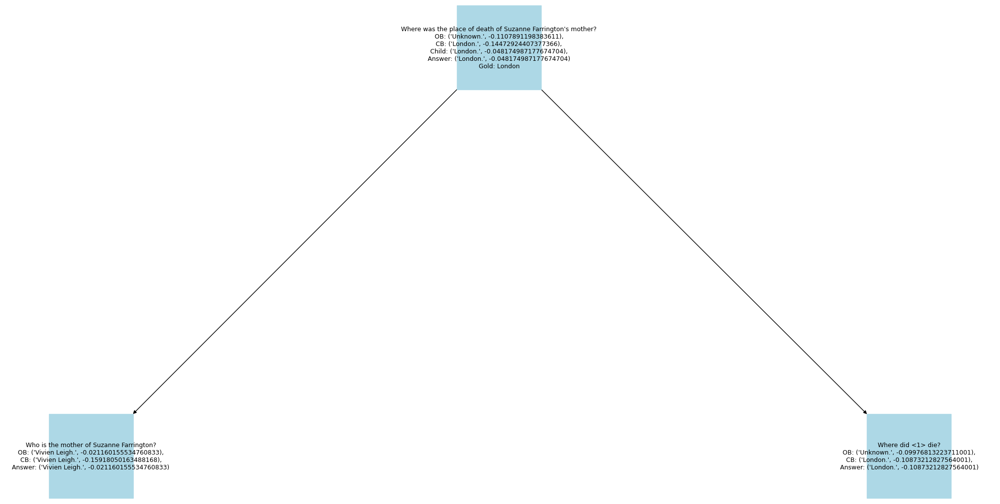

[['What is the cause of death of director of film Destination: Dewsbury?\nOB: ("Parkinson\'s disease.", -0.05438317801915418),\nCB: (\'stroke and heart failure.\', -0.15531731737387136),\nChild: ("Parkinson\'s disease.", -0.049803056143694444),\nAnswer: ("Parkinson\'s disease.", -0.049803056143694444)\nGold: Parkinson\'s disease', "Who is the director of film Destination: Dewsbury?\nOB: ('Jack Spring.', -0.02161238752390538),\nCB: ('Jack Clayton.', -0.0693892794746377),\nAnswer: ('Jack Spring.', -0.02161238752390538)"], ['What is the cause of death of director of film Destination: Dewsbury?\nOB: ("Parkinson\'s disease.", -0.05438317801915418),\nCB: (\'stroke and heart failure.\', -0.15531731737387136),\nChild: ("Parkinson\'s disease.", -0.049803056143694444),\nAnswer: ("Parkinson\'s disease.", -0.049803056143694444)\nGold: Parkinson\'s disease', 'What is the cause of death of <1>?\nOB: ("Parkinson\'s disease.", -0.13321635143002),\nCB: (\'heart attack.\', -0.260653198232),\nAnswer: ("P

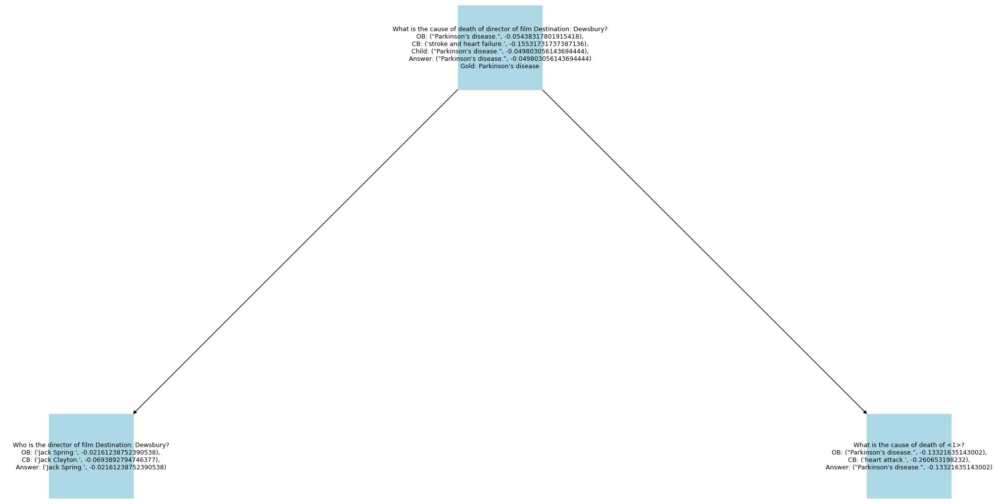

[["Which film was released earlier, Drive Hard or Make-Out With Violence?\nOB: ('Make-Out with Violence.', -0.032415414070068),\nCB: ('Make-Out with Violence.', -0.026140721850215855),\nChild: ('Make-Out With Violence.', -0.017495361571567246),\nAnswer: ('Make-Out With Violence.', -0.017495361571567246)\nGold: Make-Out With Violence", "When was the film Drive Hard released?\nOB: ('2014.', -0.024144920340442723),\nCB: ('2014.', -0.011176980303923075),\nAnswer: ('2014.', -0.011176980303923075)"], ["Which film was released earlier, Drive Hard or Make-Out With Violence?\nOB: ('Make-Out with Violence.', -0.032415414070068),\nCB: ('Make-Out with Violence.', -0.026140721850215855),\nChild: ('Make-Out With Violence.', -0.017495361571567246),\nAnswer: ('Make-Out With Violence.', -0.017495361571567246)\nGold: Make-Out With Violence", "When was the film Make-Out With Violence released?\nOB: ('2008.', -0.03621537827352538),\nCB: ('2008.', -0.038171084797686654),\nAnswer: ('2008.', -0.0362153782735

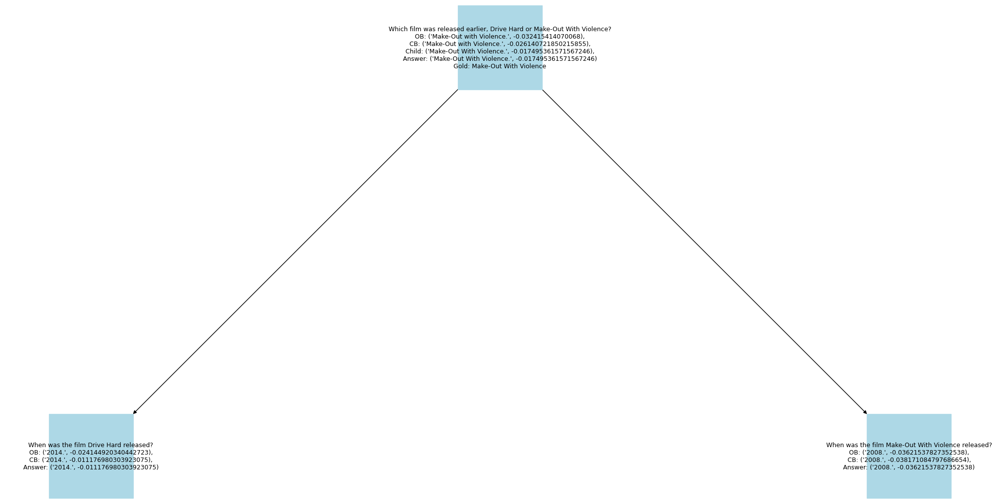

[["Which album was released first, A Little Light Left or The Best Of Celly Cel?\nOB: ('The Best of Celly Cel.', -0.047371446998251784),\nCB: ('A Little Light Left.', -0.05314811336297777),\nChild: ('The Best Of Celly Cel.', -0.018522761353379897),\nAnswer: ('The Best Of Celly Cel.', -0.018522761353379897)\nGold: The Best Of Celly Cel", "When was the album A Little Light Left released?\nOB: ('December 4, 2015.', -0.03939870496259765),\nCB: ('2001.', -0.2429330088016757),\nAnswer: ('December 4, 2015.', -0.03939870496259765)"], ["Which album was released first, A Little Light Left or The Best Of Celly Cel?\nOB: ('The Best of Celly Cel.', -0.047371446998251784),\nCB: ('A Little Light Left.', -0.05314811336297777),\nChild: ('The Best Of Celly Cel.', -0.018522761353379897),\nAnswer: ('The Best Of Celly Cel.', -0.018522761353379897)\nGold: The Best Of Celly Cel", "When was the album The Best Of Celly Cel released?\nOB: ('1999.', -0.04092062355193999),\nCB: ('1990.', -0.029356437600474704),\n

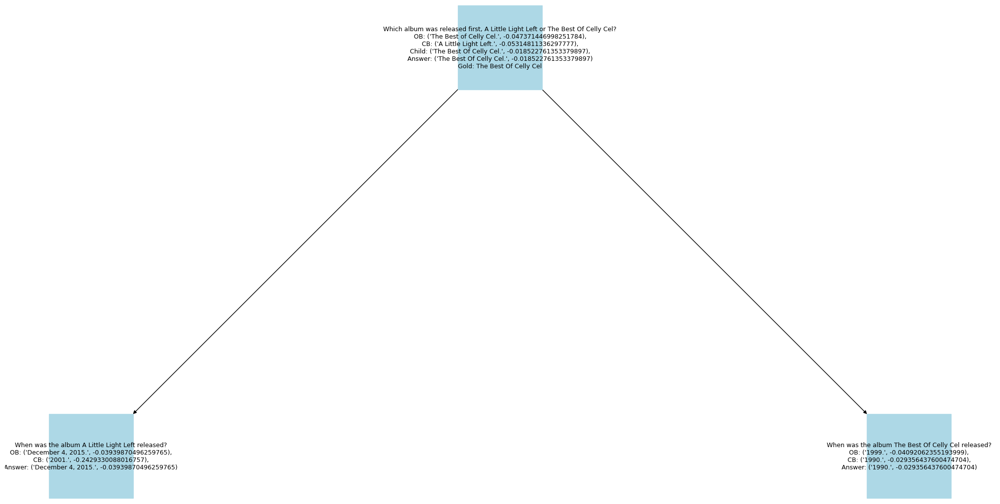

[["Which film has the director born earlier, The Adventures Of Priscilla, Queen Of The Desert or Harvest: 3,000 Years?\nOB: ('Harvest: 3,000 Years.', -0.02697387978594535),\nCB: ('Harvest: 3,000 Years.', -0.042966080856546435),\nChild: ('Harvest: 3,000 Years.', -0.005714722359897706),\nAnswer: ('Harvest: 3,000 Years.', -0.005714722359897706)\nGold: Harvest: 3,000 Years", "When was the director of film The Adventures Of Priscilla, Queen Of The Desert born?\nOB: ('27 August 1964.', -0.02683735629858062),\nCB: ('August 2, 1965.', -0.06770434606111969),\nChild: ('27 August 1964.', -0.005891687575741881),\nAnswer: ('27 August 1964.', -0.005891687575741881)"], ["When was the director of film The Adventures Of Priscilla, Queen Of The Desert born?\nOB: ('27 August 1964.', -0.02683735629858062),\nCB: ('August 2, 1965.', -0.06770434606111969),\nChild: ('27 August 1964.', -0.005891687575741881),\nAnswer: ('27 August 1964.', -0.005891687575741881)", "Who is the director of film The Adventures Of P

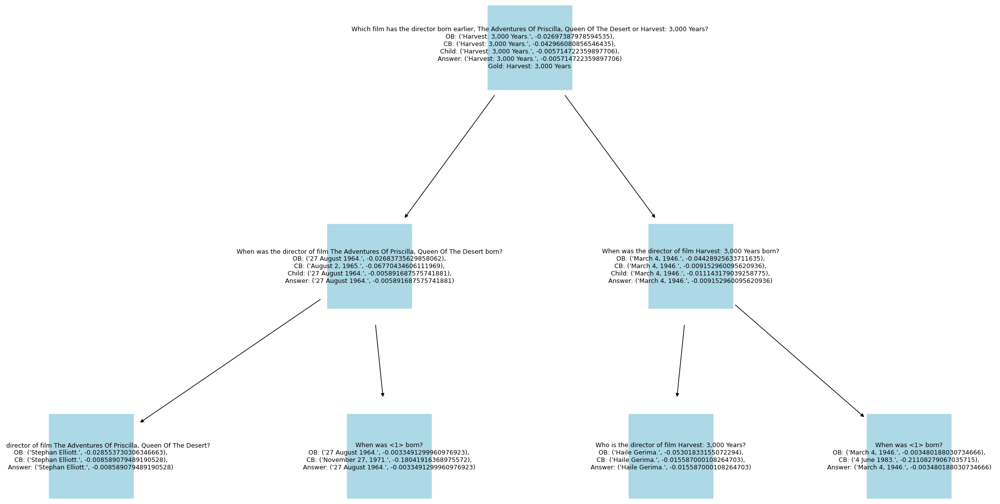

[["Do both films Apache Woman and Dime With A Halo have the directors from the same country?\nOB: ('no.', -0.0671435838296808),\nCB: ('no.', -0.06104337221927687),\nChild: ('Yes.', -0.0369509369396665),\nAnswer: ('Yes.', -0.0369509369396665)\nGold: yes", "Which country is the director of film Apache Woman from?\nOB: ('Italy.', -0.09787034470171081),\nCB: ('United States.', -0.11198718224107),\nChild: ('United States.', -0.04722428757572999),\nAnswer: ('United States.', -0.04722428757572999)"], ["Which country is the director of film Apache Woman from?\nOB: ('Italy.', -0.09787034470171081),\nCB: ('United States.', -0.11198718224107),\nChild: ('United States.', -0.04722428757572999),\nAnswer: ('United States.', -0.04722428757572999)", "Who is the director of film Apache Woman?\nOB: ('Roger Corman.', -0.07991618463149999),\nCB: ('Roger Corman.', -0.08246111840511727),\nAnswer: ('Roger Corman.', -0.07991618463149999)"], ["Which country is the director of film Apache Woman from?\nOB: ('Ital

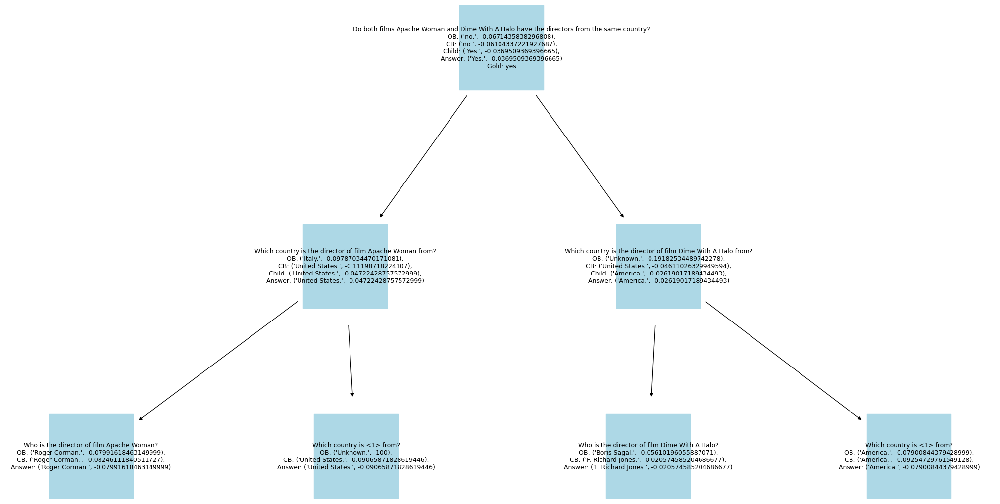

[["Do both My Friend From The Park and Punks (Film) films have the directors from the same country?\nOB: ('no.', -0.05033468380316445),\nCB: ('no.', -0.06413566459079345),\nChild: ('No.', -0.037711326793433114),\nAnswer: ('No.', -0.037711326793433114)\nGold: no", "Which country is the director of film My Friend From The Park from?\nOB: ('Argentina.', -0.08285682040874925),\nCB: ('Argentina.', -0.10054516355683767),\nChild: ('Argentina.', -0.027631944873173907),\nAnswer: ('Argentina.', -0.027631944873173907)"], ["Which country is the director of film My Friend From The Park from?\nOB: ('Argentina.', -0.08285682040874925),\nCB: ('Argentina.', -0.10054516355683767),\nChild: ('Argentina.', -0.027631944873173907),\nAnswer: ('Argentina.', -0.027631944873173907)", "Who is the director of film My Friend From The Park?\nOB: ('Ana Katz.', -0.07484708328401847),\nCB: ('Gonzalo Justiniano.', -0.13786291279661936),\nAnswer: ('Ana Katz.', -0.07484708328401847)"], ["Which country is the director of f

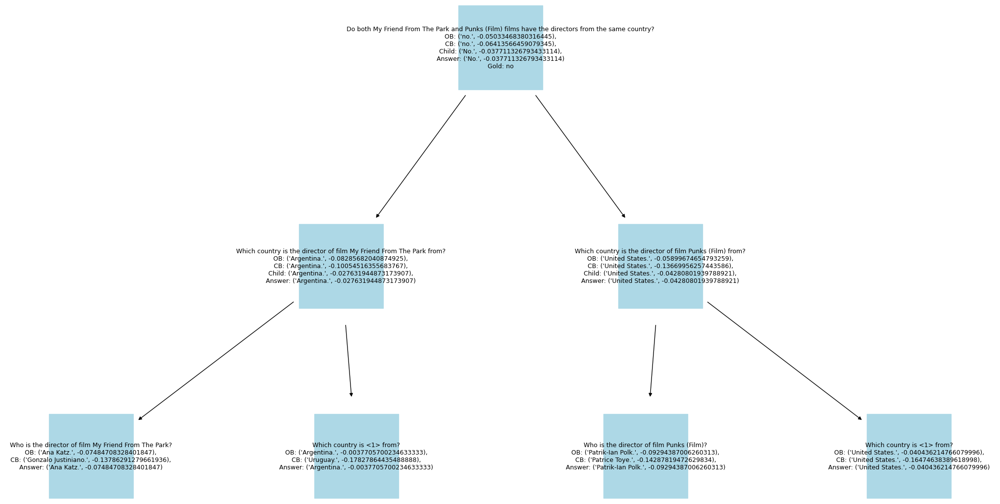

[["Where did the performer of song Words Of Love die?\nOB: ('Clear Lake, Iowa.', -0.081288075600254),\nCB: ('Clear Lake.', -0.08938601938804222),\nChild: ('Clear Lake, Iowa.', -0.05006255217199329),\nAnswer: ('Clear Lake, Iowa.', -0.05006255217199329)\nGold: Clear Lake, Iowa", "Who is the performer of song Words Of Love?\nOB: ('Buddy Holly.', -0.0865578743462246),\nCB: ('Buddy Holly.', -0.10655866828566363),\nAnswer: ('Buddy Holly.', -0.0865578743462246)"], ["Where did the performer of song Words Of Love die?\nOB: ('Clear Lake, Iowa.', -0.081288075600254),\nCB: ('Clear Lake.', -0.08938601938804222),\nChild: ('Clear Lake, Iowa.', -0.05006255217199329),\nAnswer: ('Clear Lake, Iowa.', -0.05006255217199329)\nGold: Clear Lake, Iowa", "Where did <1> die?\nOB: ('Clear Lake, Iowa.', -0.10266486135006056),\nCB: ('Clear Lake.', -0.12561420601262416),\nAnswer: ('Clear Lake, Iowa.', -0.10266486135006056)"]]


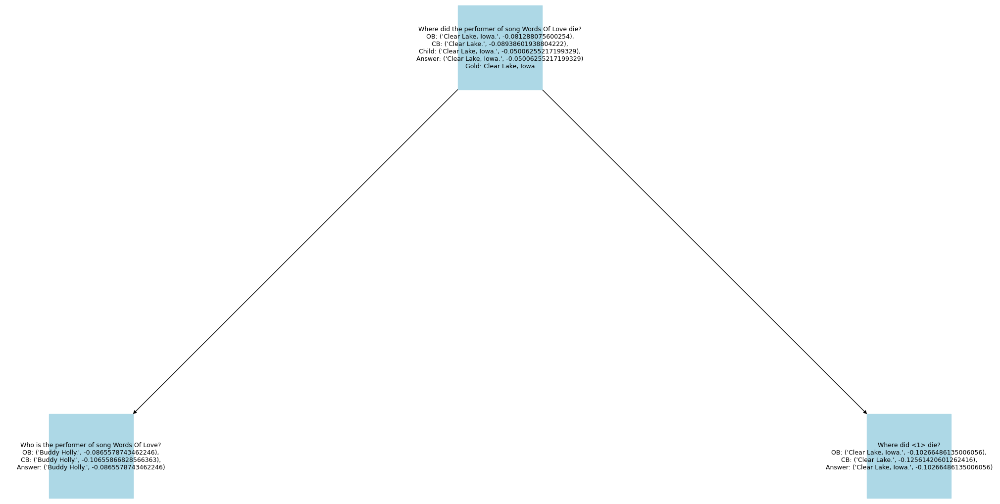

[["Who is the paternal grandfather of Konrad Vi The Dean?\nOB: ('Konrad III the Old.', -0.051801045706486665),\nCB: ('Casimir II the Just.', -0.06794740080299576),\nChild: ('Konrad II the Gray.', -0.031035582837977582),\nAnswer: ('Konrad II the Gray.', -0.031035582837977582)\nGold: Konrad II the Gray", "Who is the father of Konrad Vi The Dean?\nOB: ('Konrad III the Old.', -0.04486530601496177),\nCB: ('Konrad V the Elder.', -0.19169301670307146),\nAnswer: ('Konrad III the Old.', -0.04486530601496177)"], ["Who is the paternal grandfather of Konrad Vi The Dean?\nOB: ('Konrad III the Old.', -0.051801045706486665),\nCB: ('Casimir II the Just.', -0.06794740080299576),\nChild: ('Konrad II the Gray.', -0.031035582837977582),\nAnswer: ('Konrad II the Gray.', -0.031035582837977582)\nGold: Konrad II the Gray", "Who is the father of <1>'s father?\nOB: ('Konrad II the Gray.', -0.027372649711975),\nCB: ('Bolesław I the Brave.', -0.05899865354532423),\nAnswer: ('Konrad II the Gray.', -0.0273726497119

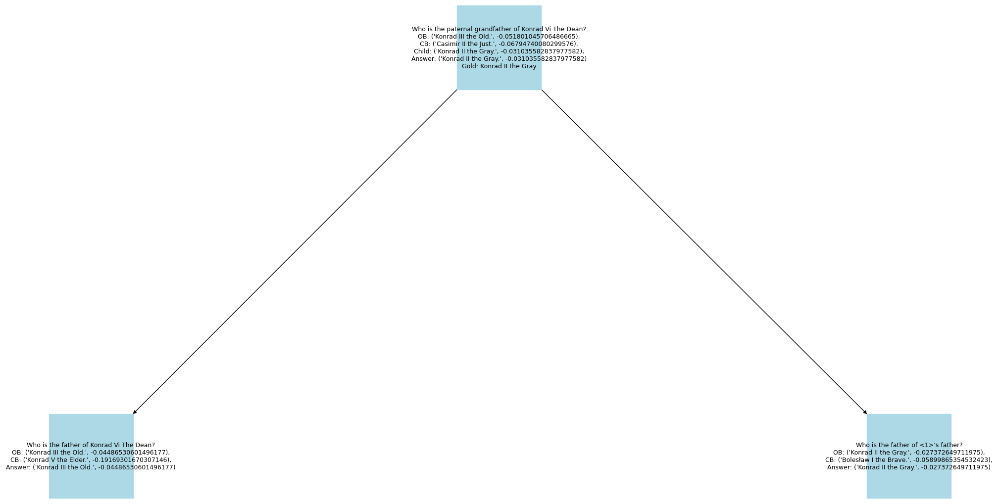

[["Who is Catherine Fitzcharles's paternal grandmother?\nOB: ('Henrietta Maria of France.', -0.05208087705974123),\nCB: ('Barbara Stucley.', -0.04386754990061098),\nChild: ('Henrietta Maria of France.', -0.023007191987375747),\nAnswer: ('Henrietta Maria of France.', -0.023007191987375747)\nGold: Henrietta Maria of France", "Who is Catherine Fitzcharles's father?\nOB: ('Unknown.', -100),\nCB: ('Charles II of England.', -0.018052834760153846),\nAnswer: ('Charles II of England.', -0.018052834760153846)"], ["Who is Catherine Fitzcharles's paternal grandmother?\nOB: ('Henrietta Maria of France.', -0.05208087705974123),\nCB: ('Barbara Stucley.', -0.04386754990061098),\nChild: ('Henrietta Maria of France.', -0.023007191987375747),\nAnswer: ('Henrietta Maria of France.', -0.023007191987375747)\nGold: Henrietta Maria of France", "Who is the mother of <1>?\nOB: ('Henrietta Maria of France.', -0.04095222933313733),\nCB: ('Henrietta Maria of France.', -0.06182226909067785),\nAnswer: ('Henrietta Ma

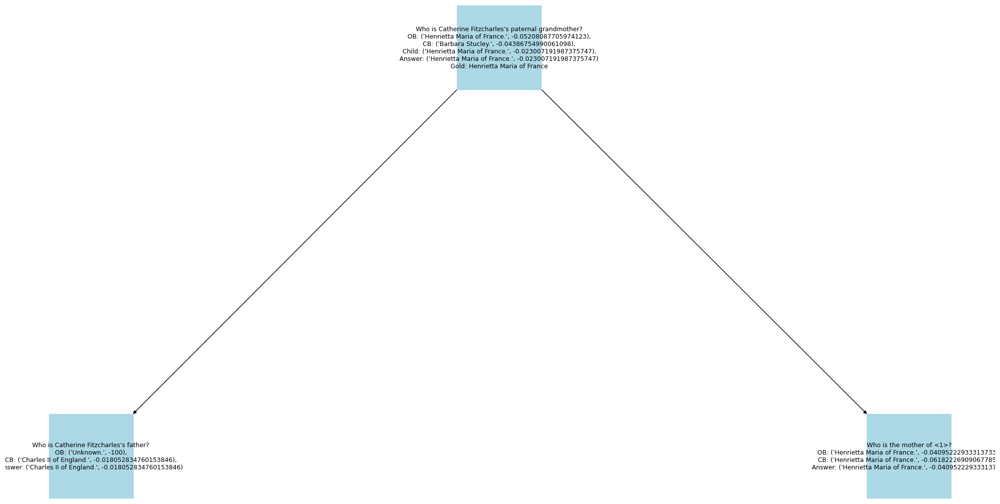

[["Who is Thomas Lyon, 8Th Earl Of Strathmore And Kinghorne's paternal grandfather?\nOB: ('Patrick Lyon, 3rd Earl of Strathmore and Kinghorne.', -0.006325195794083526),\nCB: ('John Bowes-Lyon.', -0.019172228171172236),\nChild: ('Patrick Lyon, 3rd Earl of Strathmore and Kinghorne.', -0.01302702266730513),\nAnswer: ('Patrick Lyon, 3rd Earl of Strathmore and Kinghorne.', -0.006325195794083526)\nGold: Patrick Lyon, 3rd Earl of Strathmore and Kinghorne", "Who is the father of Thomas Lyon, 8Th Earl Of Strathmore And Kinghorne?\nOB: ('John Lyon, 4th Earl of Strathmore and Kinghorne.', -0.01037169510298771),\nCB: ('John Lyon, 7th Earl of Strathmore and Kinghorne.', -0.028233987389089707),\nAnswer: ('John Lyon, 4th Earl of Strathmore and Kinghorne.', -0.01037169510298771)"], ["Who is Thomas Lyon, 8Th Earl Of Strathmore And Kinghorne's paternal grandfather?\nOB: ('Patrick Lyon, 3rd Earl of Strathmore and Kinghorne.', -0.006325195794083526),\nCB: ('John Bowes-Lyon.', -0.019172228171172236),\nChil

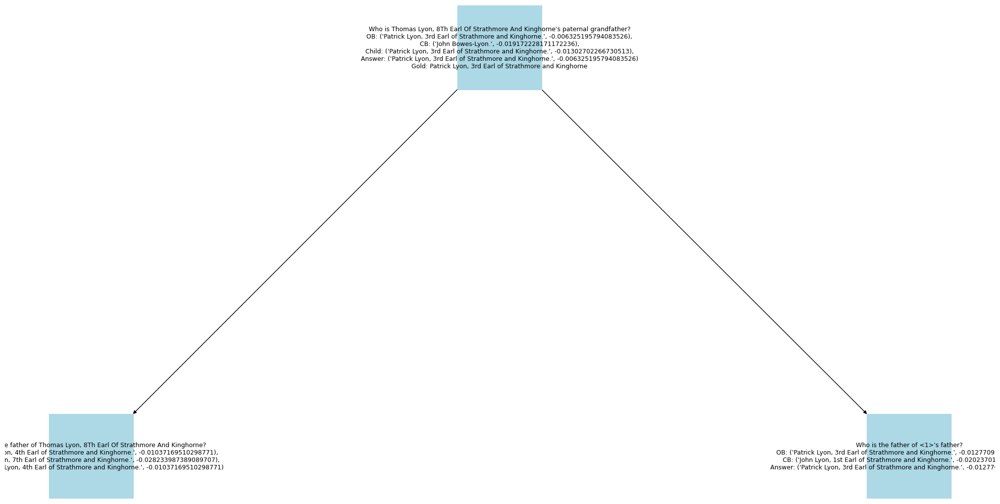

[["Which film has the director who died later, The Monkey Talks or Varakatnam?\nOB: ('The Monkey Talks.', -0.07583833817917066),\nCB: ('Varakatnam.', -0.07217987005192333),\nChild: ('Varakatnam.', -0.012703610091393988),\nAnswer: ('Varakatnam.', -0.012703610091393988)\nGold: Varakatnam", "When did the director of film The Monkey Talks die?\nOB: ('December 31, 1980.', -0.06039413578758731),\nCB: ('November 12, 1970.', -0.11168452986665285),\nChild: ('December 31, 1980.', -0.01851495581736755),\nAnswer: ('December 31, 1980.', -0.01851495581736755)"], ["When did the director of film The Monkey Talks die?\nOB: ('December 31, 1980.', -0.06039413578758731),\nCB: ('November 12, 1970.', -0.11168452986665285),\nChild: ('December 31, 1980.', -0.01851495581736755),\nAnswer: ('December 31, 1980.', -0.01851495581736755)", "Who is the director of film The Monkey Talks?\nOB: ('Raoul Walsh.', -0.05061369470859722),\nCB: ('Emilio Gómez Urquiza.', -0.13051185224870587),\nAnswer: ('Raoul Walsh.', -0.0506

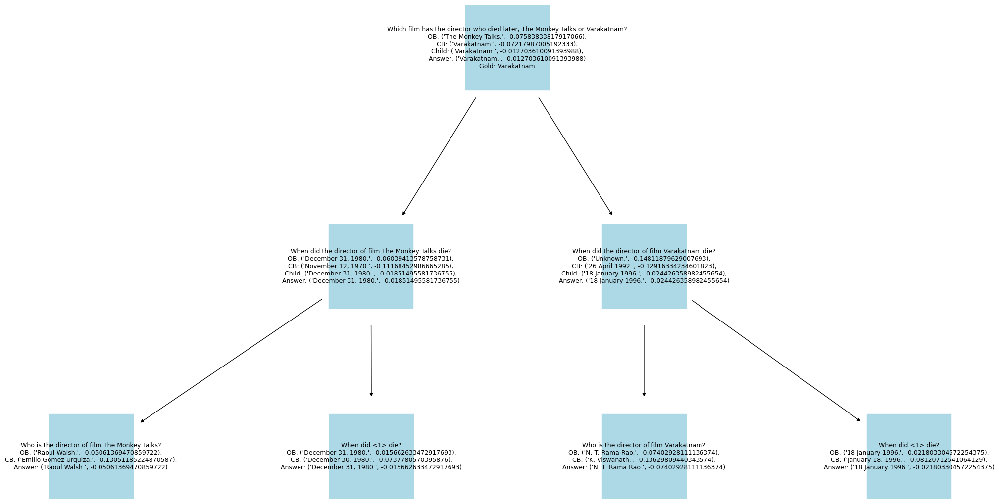

[["Who is older, Edward Bligh, 5Th Earl Of Darnley or Adolfo Costa Du Rels?\nOB: ('Edward Bligh, 5th Earl of Darnley.', -0.01673791901453526),\nCB: ('Edward Bligh, 5th Earl of Darnley.', -0.08263084231702174),\nChild: ('Edward Bligh, 5Th Earl Of Darnley.', -0.011104663227070915),\nAnswer: ('Edward Bligh, 5Th Earl Of Darnley.', -0.011104663227070915)\nGold: Edward Bligh, 5Th Earl Of Darnley", "When was Edward Bligh, 5Th Earl Of Darnley born?\nOB: ('25 February 1795.', -0.024086724707105454),\nCB: ('25 February 1754.', -0.03804165649186636),\nAnswer: ('25 February 1795.', -0.024086724707105454)"], ["Who is older, Edward Bligh, 5Th Earl Of Darnley or Adolfo Costa Du Rels?\nOB: ('Edward Bligh, 5th Earl of Darnley.', -0.01673791901453526),\nCB: ('Edward Bligh, 5th Earl of Darnley.', -0.08263084231702174),\nChild: ('Edward Bligh, 5Th Earl Of Darnley.', -0.011104663227070915),\nAnswer: ('Edward Bligh, 5Th Earl Of Darnley.', -0.011104663227070915)\nGold: Edward Bligh, 5Th Earl Of Darnley", "Wh

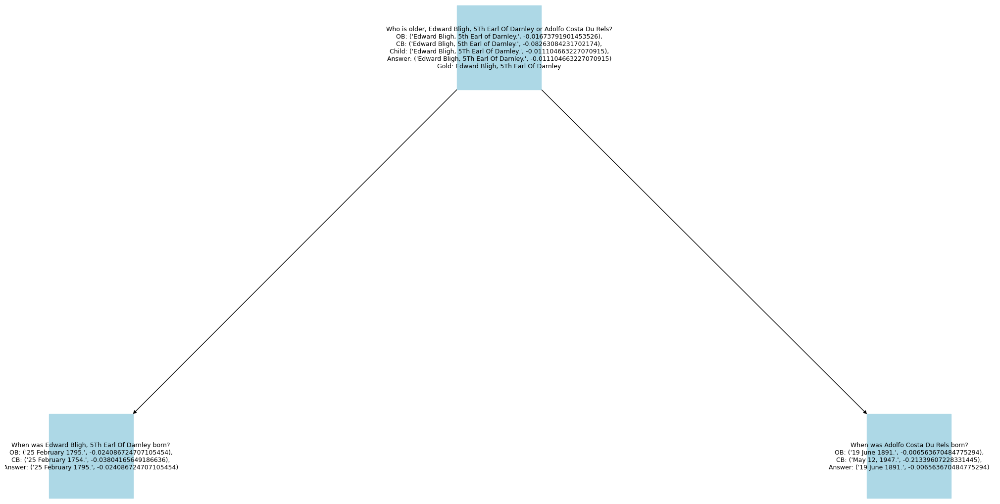

[["When was Edward Douglas-Pennant, 3Rd Baron Penrhyn's father born?\nOB: ('30 September 1836.', -0.028234768783071833),\nCB: ('26 June 1800.', -0.17021431484002814),\nChild: ('30 September 1836.', -0.018908591669028557),\nAnswer: ('30 September 1836.', -0.018908591669028557)\nGold: 30 September 1836", "Who is Edward Douglas-Pennant, 3Rd Baron Penrhyn's father?\nOB: ('George Douglas-Pennant, 2nd Baron Penrhyn.', -0.017746617964269355),\nCB: ('Gerard Edward Frederick Augustus Pennant.', -0.21344647266364125),\nAnswer: ('George Douglas-Pennant, 2nd Baron Penrhyn.', -0.017746617964269355)"], ["When was Edward Douglas-Pennant, 3Rd Baron Penrhyn's father born?\nOB: ('30 September 1836.', -0.028234768783071833),\nCB: ('26 June 1800.', -0.17021431484002814),\nChild: ('30 September 1836.', -0.018908591669028557),\nAnswer: ('30 September 1836.', -0.018908591669028557)\nGold: 30 September 1836", "When was <1> born?\nOB: ('30 September 1836.', -0.02136411872978565),\nCB: ('31 March 1836.', -0.059

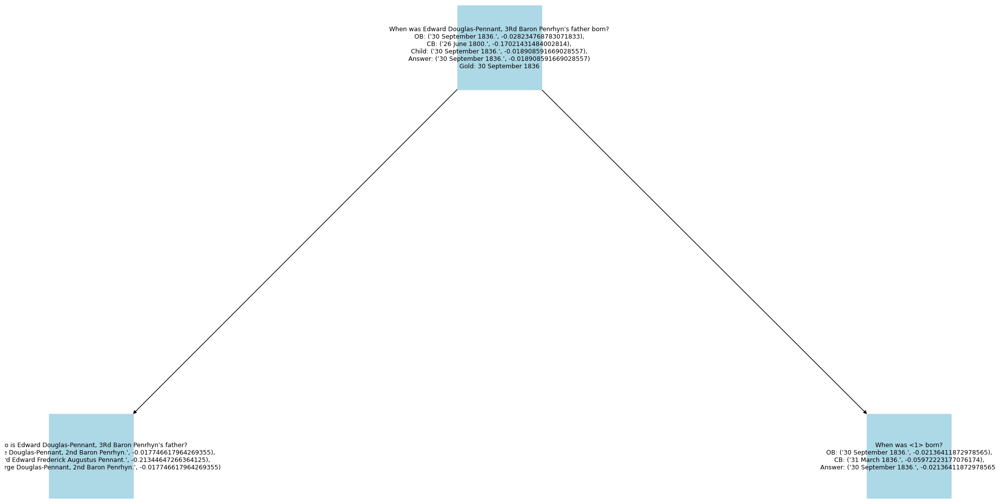

[['Which film was released first, The Pirate\'S Dream or Prem Mhanje Prem Mhanje Prem Asta?\nOB: ("The Pirate\'s Dream.", -0.03243747370023874),\nCB: ("The Pirate\'s Dream.", -0.07656503010945313),\nChild: ("The Pirate\'S Dream.", -0.01462202454326849),\nAnswer: ("The Pirate\'S Dream.", -0.01462202454326849)\nGold: The Pirate\'S Dream', "When was the film The Pirate'S Dream released?\nOB: ('1940.', -0.0700854883103223),\nCB: ('1915.', -0.03958129904587934),\nAnswer: ('1915.', -0.03958129904587934)"], ['Which film was released first, The Pirate\'S Dream or Prem Mhanje Prem Mhanje Prem Asta?\nOB: ("The Pirate\'s Dream.", -0.03243747370023874),\nCB: ("The Pirate\'s Dream.", -0.07656503010945313),\nChild: ("The Pirate\'S Dream.", -0.01462202454326849),\nAnswer: ("The Pirate\'S Dream.", -0.01462202454326849)\nGold: The Pirate\'S Dream', "When was the film Prem Mhanje Prem Mhanje Prem Asta released?\nOB: ('19 April 2013.', -0.0035344102924191306),\nCB: ('1982.', -0.055629464465612274),\nAnsw

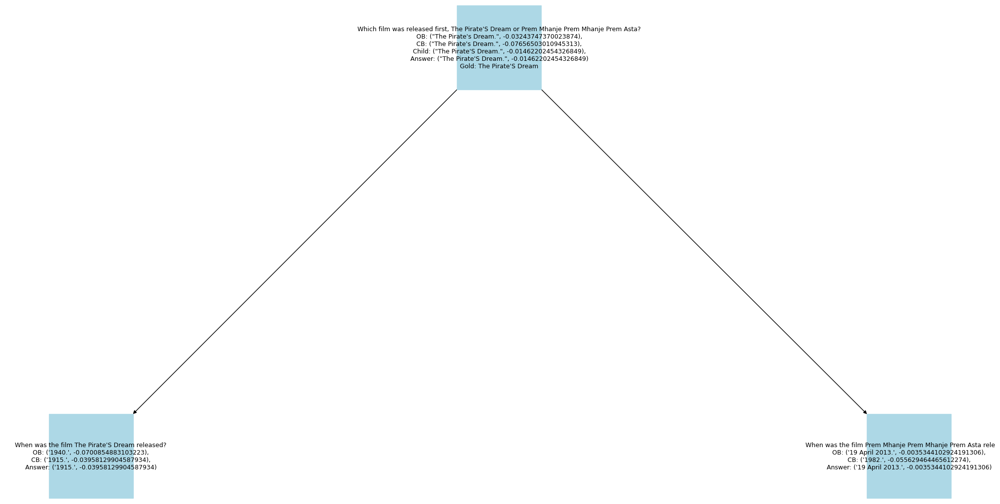

[["Which film has the director who was born later, Accident 703 or Habana Eva?\nOB: ('Habana Eva.', -0.03127082436591444),\nCB: ('Accident 703.', -0.19087786532693185),\nChild: ('Habana Eva.', -0.008628682540403974),\nAnswer: ('Habana Eva.', -0.008628682540403974)\nGold: Habana Eva", "When was the director of film Accident 703 born?\nOB: ('8 March 1923.', -0.040223682244114815),\nCB: ('February 29, 1905.', -0.18238128923337574),\nChild: ('8 March 1923.', -0.014039228267377166),\nAnswer: ('8 March 1923.', -0.014039228267377166)"], ["When was the director of film Accident 703 born?\nOB: ('8 March 1923.', -0.040223682244114815),\nCB: ('February 29, 1905.', -0.18238128923337574),\nChild: ('8 March 1923.', -0.014039228267377166),\nAnswer: ('8 March 1923.', -0.014039228267377166)", "Who is the director of film Accident 703?\nOB: ('José María Forqué.', -0.03291910409357384),\nCB: ('Francis D. Lyon.', -0.2544278458940123),\nAnswer: ('José María Forqué.', -0.03291910409357384)"], ["When was the

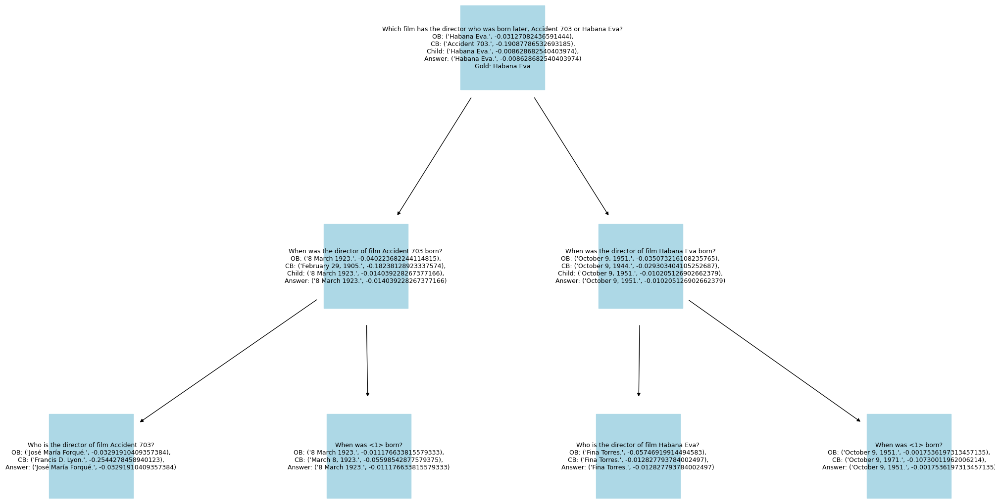

[["Were Alan Stephenson Boyd and Charles Grandison Finney of the same nationality?\nOB: ('yes.', -0.08635829828943559),\nCB: ('yes.', -0.10153449682970998),\nChild: ('Yes.', -0.05952015705407014),\nAnswer: ('Yes.', -0.05952015705407014)\nGold: yes", "What is the nationality of Alan Stephenson Boyd?\nOB: ('American.', -0.05602257009187875),\nCB: ('British.', -0.17650449963566175),\nAnswer: ('American.', -0.05602257009187875)"], ["Were Alan Stephenson Boyd and Charles Grandison Finney of the same nationality?\nOB: ('yes.', -0.08635829828943559),\nCB: ('yes.', -0.10153449682970998),\nChild: ('Yes.', -0.05952015705407014),\nAnswer: ('Yes.', -0.05952015705407014)\nGold: yes", "What is the nationality of Charles Grandison Finney?\nOB: ('American.', -0.0985769422417489),\nCB: ('British.', -0.21583228775895452),\nAnswer: ('American.', -0.0985769422417489)"]]


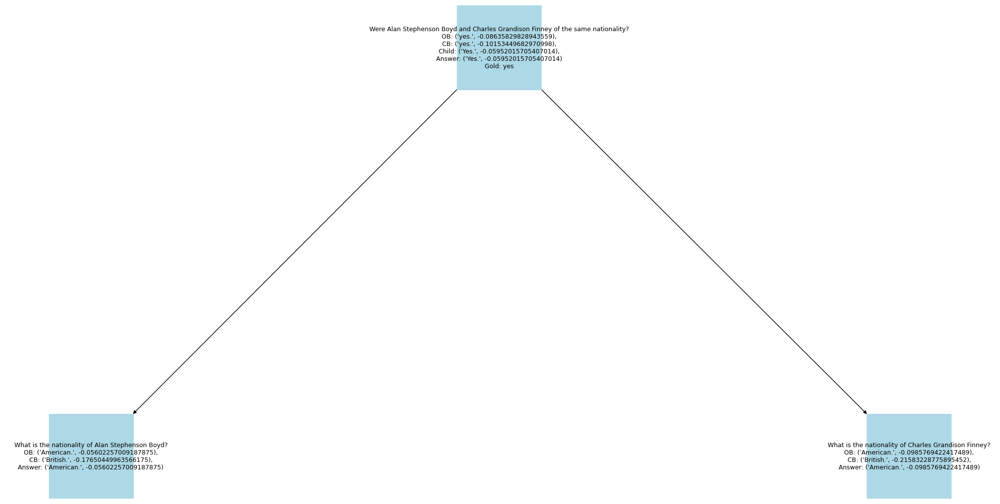

[["Who lived longer, Jean Grémillon or Ángel Recasens?\nOB: ('Ángel Recasens.', -0.061792901756260725),\nCB: ('Ángel Recasens.', -0.047219107870828524),\nChild: ('Ángel Recasens.', -0.01067873059676446),\nAnswer: ('Ángel Recasens.', -0.01067873059676446)\nGold: Ángel Recasens", "When did Jean Grémillon die?\nOB: ('25 November 1959.', -0.001680850949973846),\nCB: ('November 19, 1975.', -0.07102306697288459),\nAnswer: ('25 November 1959.', -0.001680850949973846)"], ["Who lived longer, Jean Grémillon or Ángel Recasens?\nOB: ('Ángel Recasens.', -0.061792901756260725),\nCB: ('Ángel Recasens.', -0.047219107870828524),\nChild: ('Ángel Recasens.', -0.01067873059676446),\nAnswer: ('Ángel Recasens.', -0.01067873059676446)\nGold: Ángel Recasens", "When did Ángel Recasens die?\nOB: ('2 August 2007.', -0.002879389118886667),\nCB: ('December 22, 2007.', -0.05293579191904178),\nAnswer: ('2 August 2007.', -0.002879389118886667)"]]


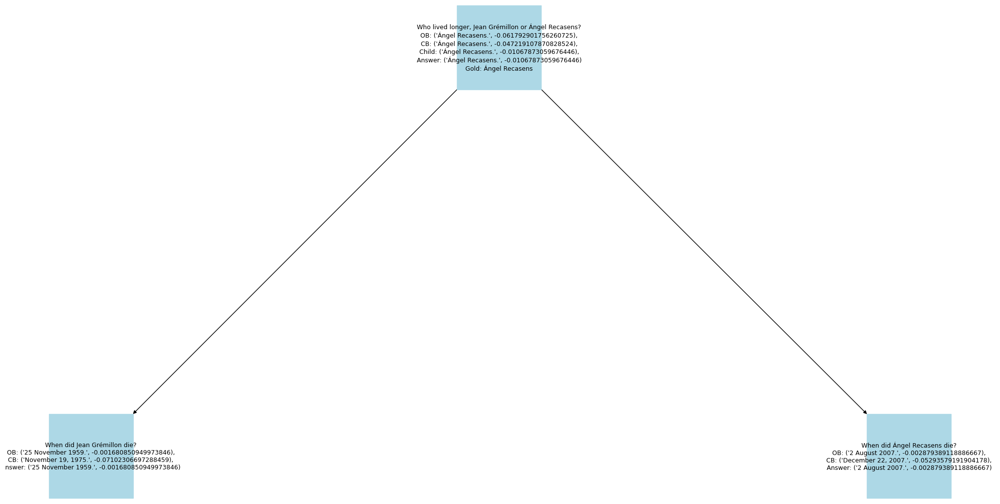

[["Are Gaulier River and Hallowing Run located in the same country?\nOB: ('no.', -0.02955195342991857),\nCB: ('no.', -0.04788961411531114),\nChild: ('No.', -0.031034238209887287),\nAnswer: ('no.', -0.02955195342991857)\nGold: no", "Which country is Gaulier River located in?\nOB: ('Grenada.', -0.029715169589622725),\nCB: ('France.', -0.05291516582047167),\nAnswer: ('Grenada.', -0.029715169589622725)"], ["Are Gaulier River and Hallowing Run located in the same country?\nOB: ('no.', -0.02955195342991857),\nCB: ('no.', -0.04788961411531114),\nChild: ('No.', -0.031034238209887287),\nAnswer: ('no.', -0.02955195342991857)\nGold: no", "Which country is Hallowing Run located in?\nOB: ('United States.', -0.07221103844020818),\nCB: ('England.', -0.0717043976598225),\nAnswer: ('England.', -0.0717043976598225)"]]


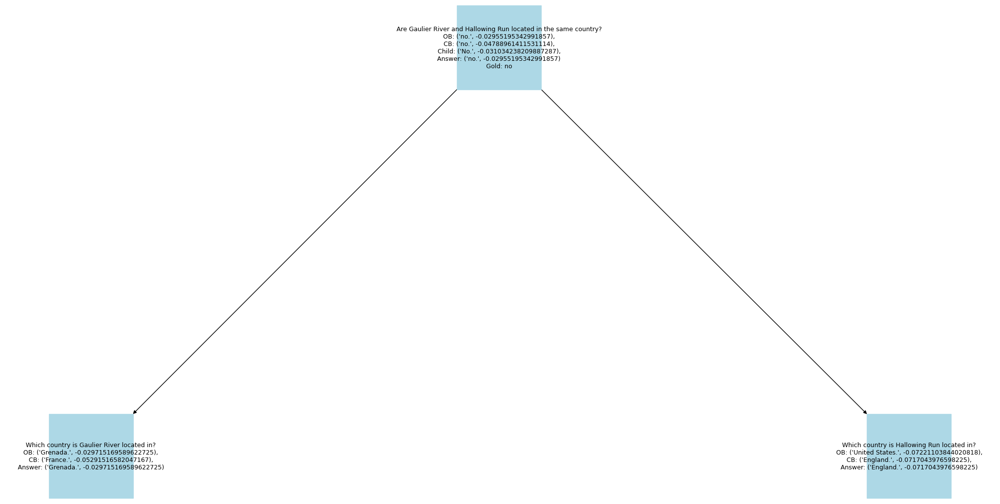

[["What is the place of birth of Elijah Blue Allman's father?\nOB: ('Nashville, Tennessee.', -0.09217306020708038),\nCB: ('Nashville, Tennessee.', -0.012788143979841815),\nChild: ('Nashville, Tennessee.', -0.022877961477425206),\nAnswer: ('Nashville, Tennessee.', -0.012788143979841815)\nGold: Nashville, Tennessee", "Who is Elijah Blue Allman's father?\nOB: ('Gregg Allman.', -0.05050781389008333),\nCB: ('Gregg Allman.', -0.016692698275060834),\nAnswer: ('Gregg Allman.', -0.016692698275060834)"], ["What is the place of birth of Elijah Blue Allman's father?\nOB: ('Nashville, Tennessee.', -0.09217306020708038),\nCB: ('Nashville, Tennessee.', -0.012788143979841815),\nChild: ('Nashville, Tennessee.', -0.022877961477425206),\nAnswer: ('Nashville, Tennessee.', -0.012788143979841815)\nGold: Nashville, Tennessee", "What is the place of birth of <1>?\nOB: ('Nashville, Tennessee.', -0.05780535394086),\nCB: ('Nashville, Tennessee.', -0.07540037398765183),\nAnswer: ('Nashville, Tennessee.', -0.05780

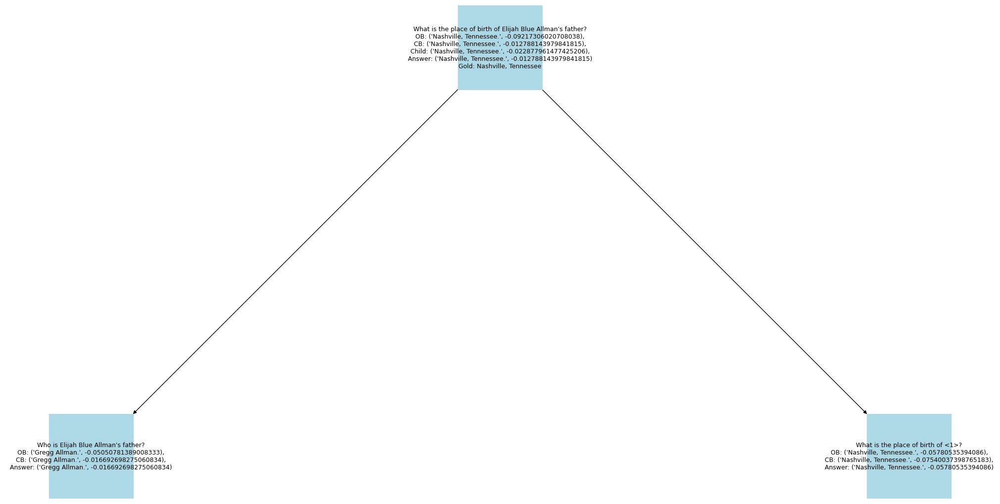

[["Who are William Cunningham, 9Th Earl Of Glencairn's aunt?\nOB: ('Lady Ann Cunningham and Margaret Cunningham.', -0.059244697201478),\nCB: ('Henrietta Boyle.', -0.08222128189880874),\nChild: ('Lady Ann Cunningham and Margaret Cunningham.', -0.03523878637284693),\nAnswer: ('Lady Ann Cunningham and Margaret Cunningham.', -0.03523878637284693)\nGold: Lady Ann Cunningham and Margaret Cunningham", "Who is the parent of William Cunningham, 9Th Earl Of Glencairn?\nOB: ('William Cunningham, 8th Earl of Glencairn.', -0.025564600510729996),\nCB: ('John Cunningham, 8th Earl of Glencairn.', -0.04735594386447794),\nAnswer: ('William Cunningham, 8th Earl of Glencairn.', -0.025564600510729996)"], ["Who are William Cunningham, 9Th Earl Of Glencairn's aunt?\nOB: ('Lady Ann Cunningham and Margaret Cunningham.', -0.059244697201478),\nCB: ('Henrietta Boyle.', -0.08222128189880874),\nChild: ('Lady Ann Cunningham and Margaret Cunningham.', -0.03523878637284693),\nAnswer: ('Lady Ann Cunningham and Margaret

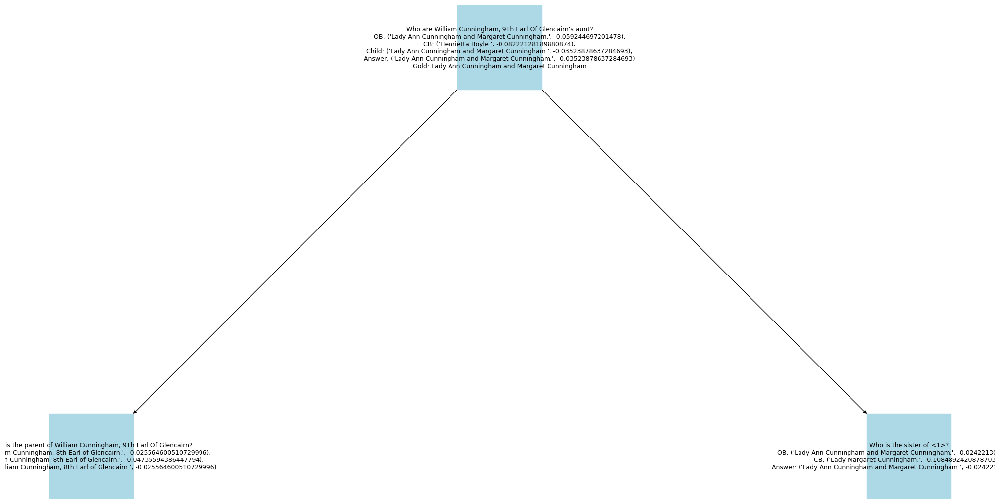

[["Are both directors of films Modern Mothers and The Slaughter Rule from the same country?\nOB: ('yes.', -0.10885115746185053),\nCB: ('yes.', -0.10453974933540328),\nChild: ('No.', -0.033024740946577605),\nAnswer: ('No.', -0.033024740946577605)\nGold: no", "Which country is the director of film Modern Mothers from?\nOB: ('United States.', -0.08555040557167409),\nCB: ('Romania.', -0.1196671361915735),\nChild: ('German Empire (now, Poland).', -0.03908201627614914),\nAnswer: ('German Empire (now, Poland).', -0.03908201627614914)"], ["Which country is the director of film Modern Mothers from?\nOB: ('United States.', -0.08555040557167409),\nCB: ('Romania.', -0.1196671361915735),\nChild: ('German Empire (now, Poland).', -0.03908201627614914),\nAnswer: ('German Empire (now, Poland).', -0.03908201627614914)", "Who is the director of film Modern Mothers?\nOB: ('Phil Rosen.', -0.09524784091043201),\nCB: ('Dorothy Davenport.', -0.15988793157638545),\nAnswer: ('Phil Rosen.', -0.09524784091043201)

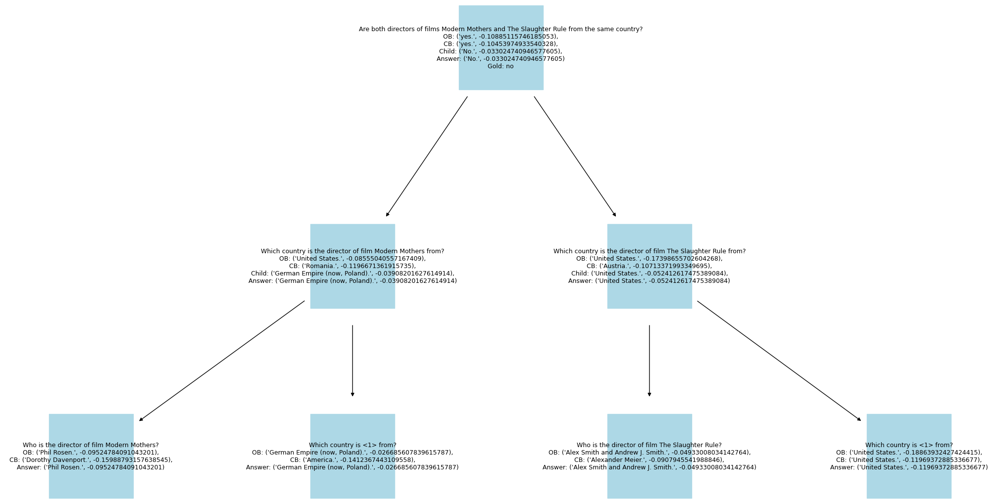

[["Was Arcadio Padilla or Leon Duray born first?\nOB: ('Leon Duray.', -0.019872550586515717),\nCB: ('Leon Duray.', -0.18746216104952834),\nChild: ('Leon Duray.', -0.008618849231723687),\nAnswer: ('Leon Duray.', -0.008618849231723687)\nGold: Leon Duray", "When was Arcadio Padilla born?\nOB: ('12 January 1941.', -0.006587998995421429),\nCB: ('July 16, 1910.', -0.1660933333274793),\nAnswer: ('12 January 1941.', -0.006587998995421429)"], ["Was Arcadio Padilla or Leon Duray born first?\nOB: ('Leon Duray.', -0.019872550586515717),\nCB: ('Leon Duray.', -0.18746216104952834),\nChild: ('Leon Duray.', -0.008618849231723687),\nAnswer: ('Leon Duray.', -0.008618849231723687)\nGold: Leon Duray", "When was Leon Duray born?\nOB: ('April 30, 1894.', -0.0018295646041121428),\nCB: ('July 11, 1912.', -0.05659455038232714),\nAnswer: ('April 30, 1894.', -0.0018295646041121428)"]]


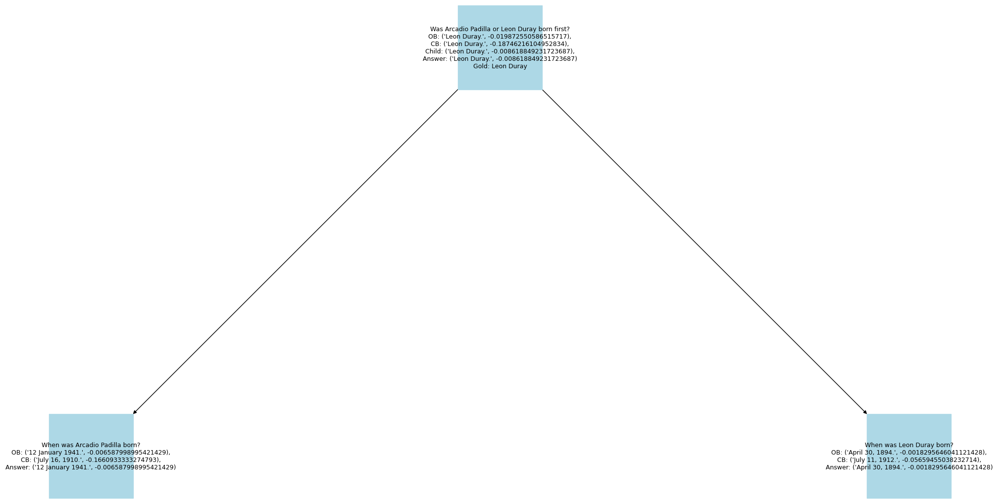

[["Which film has the director who is older than the other, Spooks And Spirits or Cat Chaser?\nOB: ('Spooks and Spirits.', -0.03118828204751197),\nCB: ('Spooks And Spirits.', -0.09172123671683952),\nChild: ('Spooks And Spirits.', -0.011516411522177491),\nAnswer: ('Spooks And Spirits.', -0.011516411522177491)\nGold: Spooks And Spirits", "When was the director of film Spooks And Spirits born?\nOB: ('29 June 1947.', -0.027268969830176213),\nCB: ('February 18, 1938.', -0.04544936891724544),\nChild: ('29 June 1947.', -0.020031501454969566),\nAnswer: ('29 June 1947.', -0.020031501454969566)"], ["When was the director of film Spooks And Spirits born?\nOB: ('29 June 1947.', -0.027268969830176213),\nCB: ('February 18, 1938.', -0.04544936891724544),\nChild: ('29 June 1947.', -0.020031501454969566),\nAnswer: ('29 June 1947.', -0.020031501454969566)", "Who is the director of film Spooks And Spirits?\nOB: ('Ágúst Guðmundsson.', -0.056777823293222986),\nCB: ('István Szabó.', -0.06582777931470563),\n

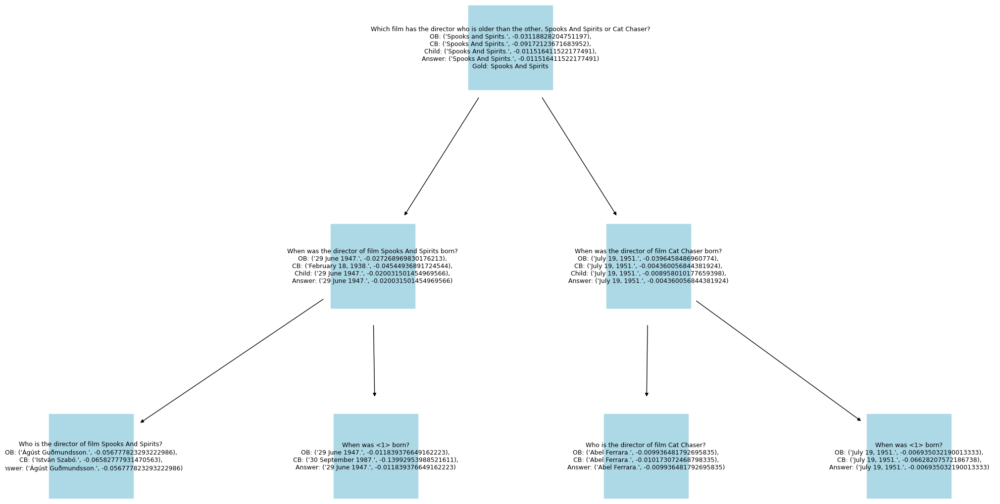

[['Was Alan Haynes or Marie-Georges-Gérard-Léon Le Maire De Warzée D\'Hermalle born first?\nOB: ("Marie-Georges-Gérard-Léon le Maire de Warzée d\' Hermalle.", -0.0359722972499963),\nCB: ("Marie-Georges-Gérard-Léon Le Maire De Warzée D\'Hermalle.", -0.0721652927643682),\nChild: ("Marie-Georges-Gérard-Léon Le Maire De Warzée D\'Hermalle.", -0.0037094029301946523),\nAnswer: ("Marie-Georges-Gérard-Léon Le Maire De Warzée D\'Hermalle.", -0.0037094029301946523)\nGold: Marie-Georges-Gérard-Léon Le Maire De Warzée D\'Hermalle', "When was Alan Haynes born?\nOB: ('February 19, 1956.', -0.00040805339666714294),\nCB: ('19 February 1957.', -0.22451430061287694),\nAnswer: ('February 19, 1956.', -0.00040805339666714294)"], ['Was Alan Haynes or Marie-Georges-Gérard-Léon Le Maire De Warzée D\'Hermalle born first?\nOB: ("Marie-Georges-Gérard-Léon le Maire de Warzée d\' Hermalle.", -0.0359722972499963),\nCB: ("Marie-Georges-Gérard-Léon Le Maire De Warzée D\'Hermalle.", -0.0721652927643682),\nChild: ("Mar

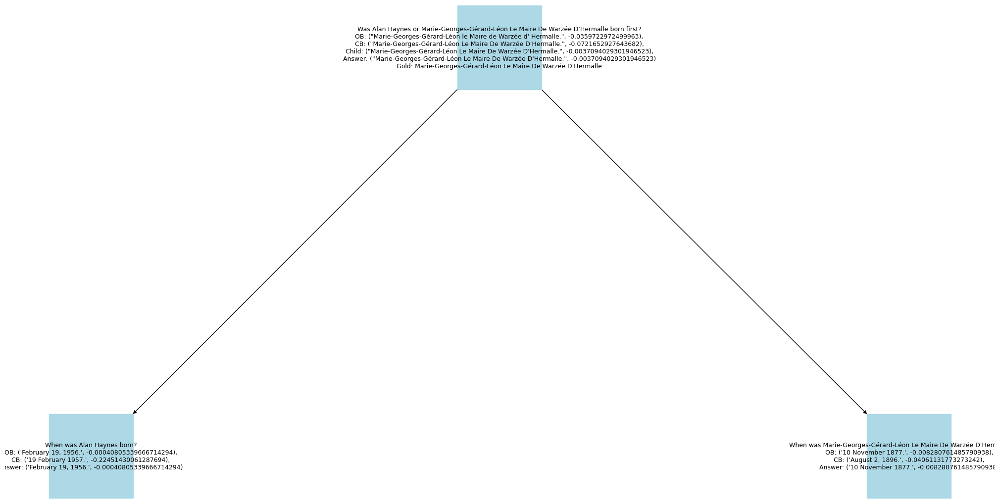

[["Where did the founder of university Escuela Superior Latinoamericana De Informática graduate from?\nOB: ('University of Buenos Aires.', -0.060689397337170464),\nCB: ('University of Havana.', -0.15973639077370622),\nChild: ('University of Buenos Aires.', -0.03779741202802218),\nAnswer: ('University of Buenos Aires.', -0.03779741202802218)\nGold: University of Buenos Aires", "Who is the founder of university Escuela Superior Latinoamericana De Informática?\nOB: ('Manuel Sadosky.', -0.13212798822401317),\nCB: ('Ramiro Castro de la Vega.', -0.1893450029689273),\nAnswer: ('Manuel Sadosky.', -0.13212798822401317)"], ["Where did the founder of university Escuela Superior Latinoamericana De Informática graduate from?\nOB: ('University of Buenos Aires.', -0.060689397337170464),\nCB: ('University of Havana.', -0.15973639077370622),\nChild: ('University of Buenos Aires.', -0.03779741202802218),\nAnswer: ('University of Buenos Aires.', -0.03779741202802218)\nGold: University of Buenos Aires", "

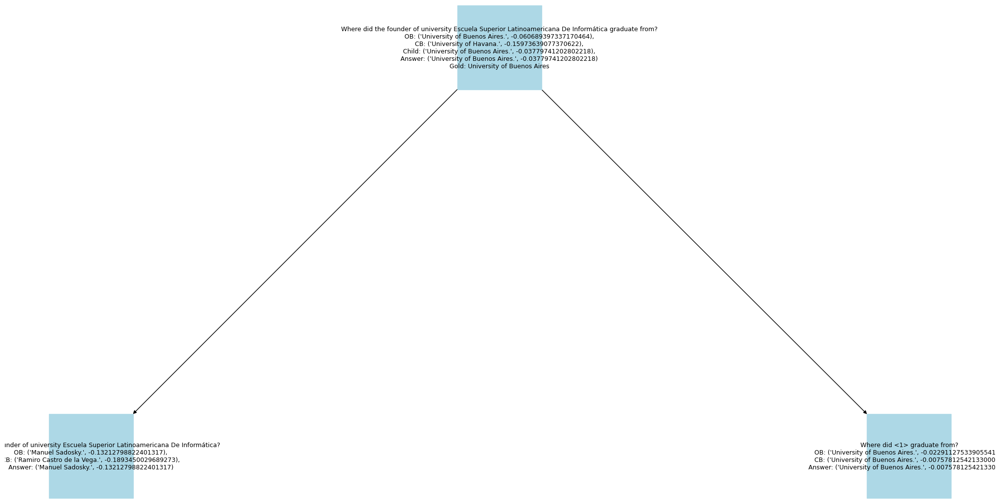

[["Who was born earlier, Martin Stapleton or Gina Fulton?\nOB: ('Gina Fulton.', -0.017123763464125384),\nCB: ('Gina Fulton.', -0.15672829512167802),\nChild: ('Gina Fulton.', -0.01576225327167074),\nAnswer: ('Gina Fulton.', -0.01576225327167074)\nGold: Gina Fulton", "When was Martin Stapleton born?\nOB: ('9 May 1983.', -0.0028897248589223076),\nCB: ('2 August 1956.', -0.1805593785945231),\nAnswer: ('9 May 1983.', -0.0028897248589223076)"], ["Who was born earlier, Martin Stapleton or Gina Fulton?\nOB: ('Gina Fulton.', -0.017123763464125384),\nCB: ('Gina Fulton.', -0.15672829512167802),\nChild: ('Gina Fulton.', -0.01576225327167074),\nAnswer: ('Gina Fulton.', -0.01576225327167074)\nGold: Gina Fulton", "When was Gina Fulton born?\nOB: ('13 February 1971.', -0.04425100183540308),\nCB: ('February 16, 1915.', -0.20309554678303363),\nAnswer: ('13 February 1971.', -0.04425100183540308)"]]


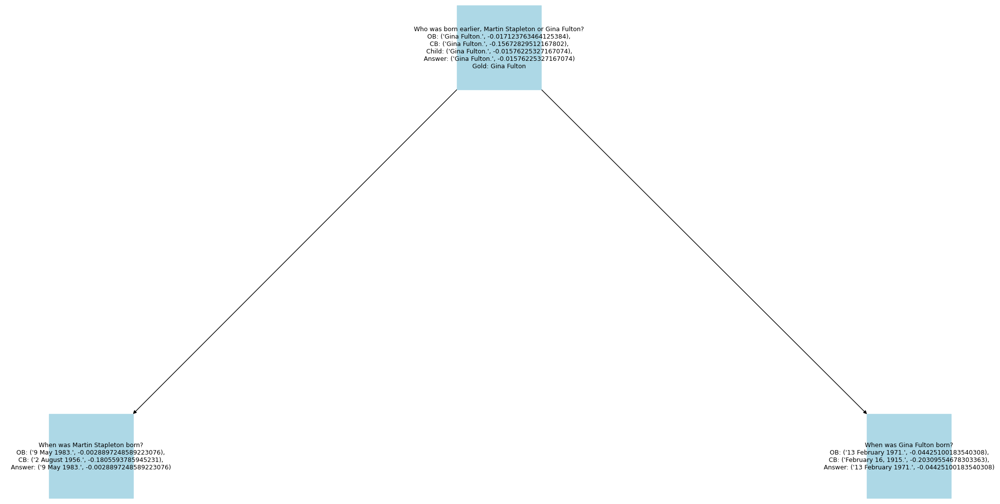

[["Which film came out earlier, A Wall Of Silence or Agent 3S3: Massacre In The Sun?\nOB: ('Agent 3S3: Massacre in the Sun.', -0.068108554755006),\nCB: ('Agent 3S3: Massacre in the Sun.', -0.0299684070459704),\nChild: ('Agent 3S3: Massacre In The Sun.', -0.021199026171661563),\nAnswer: ('Agent 3S3: Massacre In The Sun.', -0.021199026171661563)\nGold: Agent 3S3: Massacre In The Sun", "When was the film A Wall Of Silence published?\nOB: ('1993.', -0.03775526783433476),\nCB: ('1993.', -0.054259578249557336),\nAnswer: ('1993.', -0.03775526783433476)"], ["Which film came out earlier, A Wall Of Silence or Agent 3S3: Massacre In The Sun?\nOB: ('Agent 3S3: Massacre in the Sun.', -0.068108554755006),\nCB: ('Agent 3S3: Massacre in the Sun.', -0.0299684070459704),\nChild: ('Agent 3S3: Massacre In The Sun.', -0.021199026171661563),\nAnswer: ('Agent 3S3: Massacre In The Sun.', -0.021199026171661563)\nGold: Agent 3S3: Massacre In The Sun", "When was the film Agent 3S3: Massacre In The Sun published?

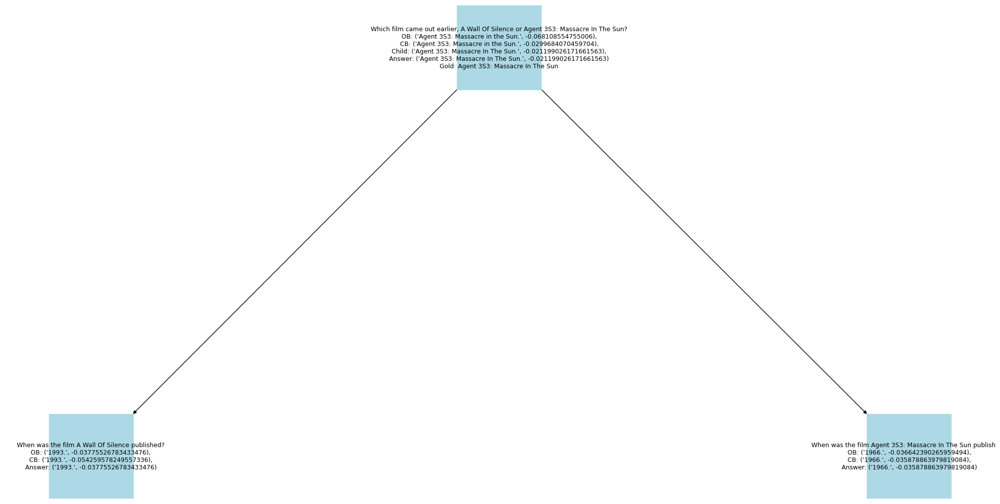

[["When is the founder of Apo Group 's birthday?\nOB: ('November 3, 1975.', -0.04079025237937646),\nCB: ('November 14, 1957.', -0.04854888762704414),\nChild: ('November 3, 1975.', -0.024111309952408164),\nAnswer: ('November 3, 1975.', -0.024111309952408164)\nGold: November 3, 1975", "Who is the founder of Apo Group?\nOB: ('Nicolas Pompigne-Mognard.', -0.05069957601846199),\nCB: ('Matti Apo.', -0.11154494662491665),\nAnswer: ('Nicolas Pompigne-Mognard.', -0.05069957601846199)"], ["When is the founder of Apo Group 's birthday?\nOB: ('November 3, 1975.', -0.04079025237937646),\nCB: ('November 14, 1957.', -0.04854888762704414),\nChild: ('November 3, 1975.', -0.024111309952408164),\nAnswer: ('November 3, 1975.', -0.024111309952408164)\nGold: November 3, 1975", "When is the birthday of <1>?\nOB: ('November 3, 1975.', -0.004014441821805262),\nCB: ('15 May 1742.', -0.08790442025128334),\nAnswer: ('November 3, 1975.', -0.004014441821805262)"]]


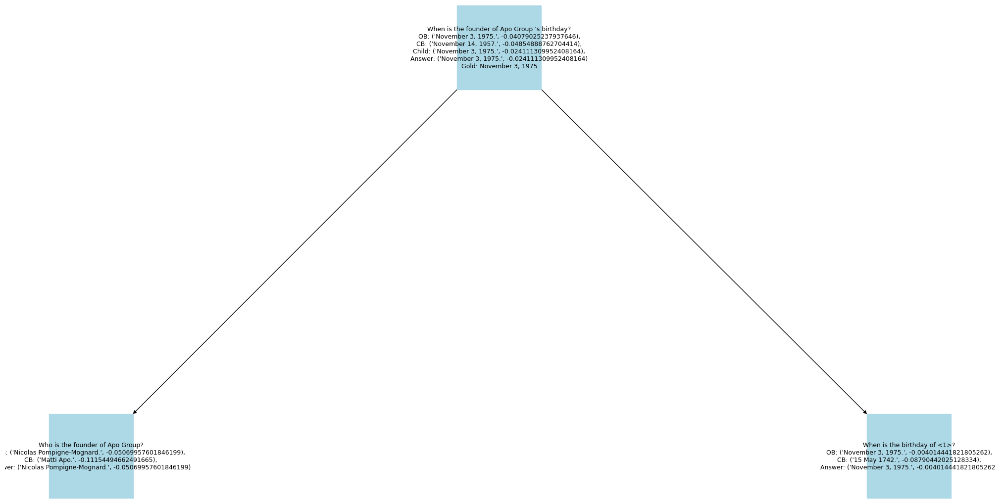

[['Which film has the director who was born later, Tarzan\'S Hidden Jungle or The Brink\'S Job?\nOB: ("The Brink\'s Job.", -0.01821939297668615),\nCB: ("The Brink\'s Job.", -0.14061923565636242),\nChild: ("The Brink\'S Job.", -0.009623791116968795),\nAnswer: ("The Brink\'S Job.", -0.009623791116968795)\nGold: The Brink\'S Job', "When was the director of film Tarzan'S Hidden Jungle born?\nOB: ('August 1, 1902.', -0.03553212034215666),\nCB: ('November 10, 1914.', -0.038531312234619995),\nChild: ('August 1, 1902.', -0.008457805009007564),\nAnswer: ('August 1, 1902.', -0.008457805009007564)"], ["When was the director of film Tarzan'S Hidden Jungle born?\nOB: ('August 1, 1902.', -0.03553212034215666),\nCB: ('November 10, 1914.', -0.038531312234619995),\nChild: ('August 1, 1902.', -0.008457805009007564),\nAnswer: ('August 1, 1902.', -0.008457805009007564)", "Who is the director of film Tarzan'S Hidden Jungle?\nOB: ('Harold D. Schuster.', -0.020070142587272494),\nCB: ('Cy Endfield.', -0.08900

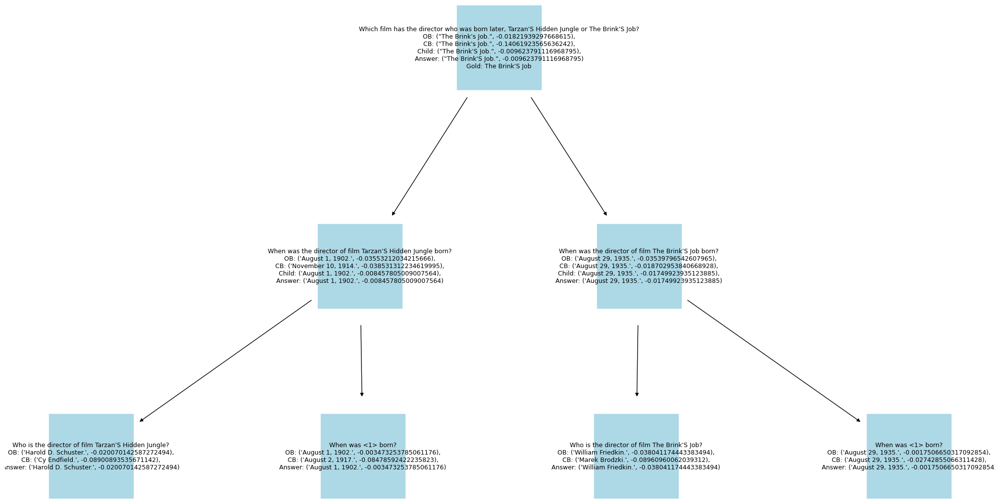

[["Which film has the director who is older than the other, My Own Private Idaho or Bread, Love And Dreams?\nOB: ('Bread, Love and Dreams.', -0.04528975867307564),\nCB: ('Bread, Love and Dreams.', -0.044891583439904625),\nChild: ('Bread, Love And Dreams.', -0.013883415216691326),\nAnswer: ('Bread, Love And Dreams.', -0.013883415216691326)\nGold: Bread, Love And Dreams", "When was the director of film My Own Private Idaho born?\nOB: ('July 24, 1952.', -0.06984426702101179),\nCB: ('July 24, 1952.', -0.009421026288453335),\nChild: ('July 24, 1952.', -0.014711608182532232),\nAnswer: ('July 24, 1952.', -0.009421026288453335)"], ["When was the director of film My Own Private Idaho born?\nOB: ('July 24, 1952.', -0.06984426702101179),\nCB: ('July 24, 1952.', -0.009421026288453335),\nChild: ('July 24, 1952.', -0.014711608182532232),\nAnswer: ('July 24, 1952.', -0.009421026288453335)", "Who is the director of film My Own Private Idaho?\nOB: ('Gus Van Sant.', -0.046029424700692004),\nCB: ('Gus Va

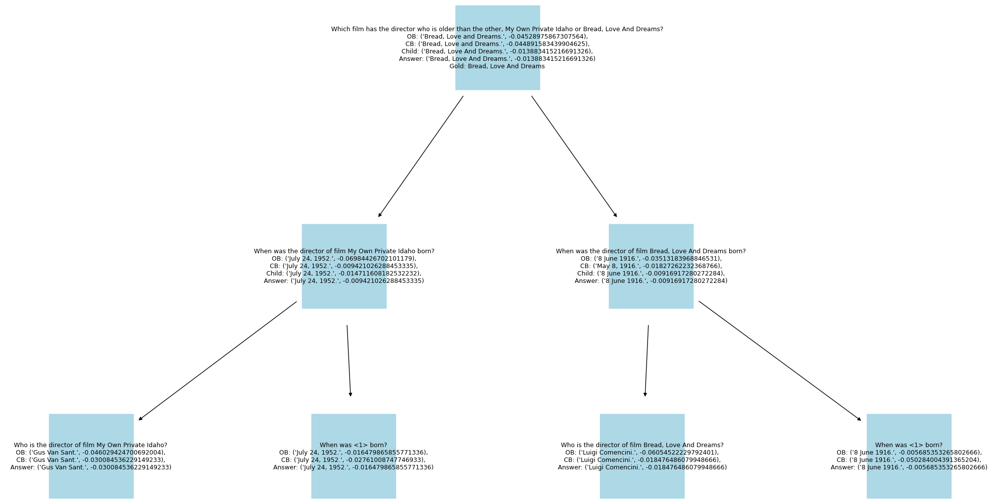

[['Which film was released earlier, Ontari (Film) or A Private\'S Affair?\nOB: ("A Private\'s Affair.", -0.09150634559856999),\nCB: (\'Ontari.\', -0.032493452541294876),\nChild: ("A Private\'S Affair.", -0.026381585038068464),\nAnswer: ("A Private\'S Affair.", -0.026381585038068464)\nGold: A Private\'S Affair', "When was the film Ontari (Film) released?\nOB: ('14 February 2008.', -0.015541280341727644),\nCB: ('2008.', -0.03843396425448615),\nAnswer: ('14 February 2008.', -0.015541280341727644)"], ['Which film was released earlier, Ontari (Film) or A Private\'S Affair?\nOB: ("A Private\'s Affair.", -0.09150634559856999),\nCB: (\'Ontari.\', -0.032493452541294876),\nChild: ("A Private\'S Affair.", -0.026381585038068464),\nAnswer: ("A Private\'S Affair.", -0.026381585038068464)\nGold: A Private\'S Affair', "When was the film A Private'S Affair released?\nOB: ('1959.', -0.06317991348950866),\nCB: ('1957.', -0.09996214090007002),\nAnswer: ('1959.', -0.06317991348950866)"]]


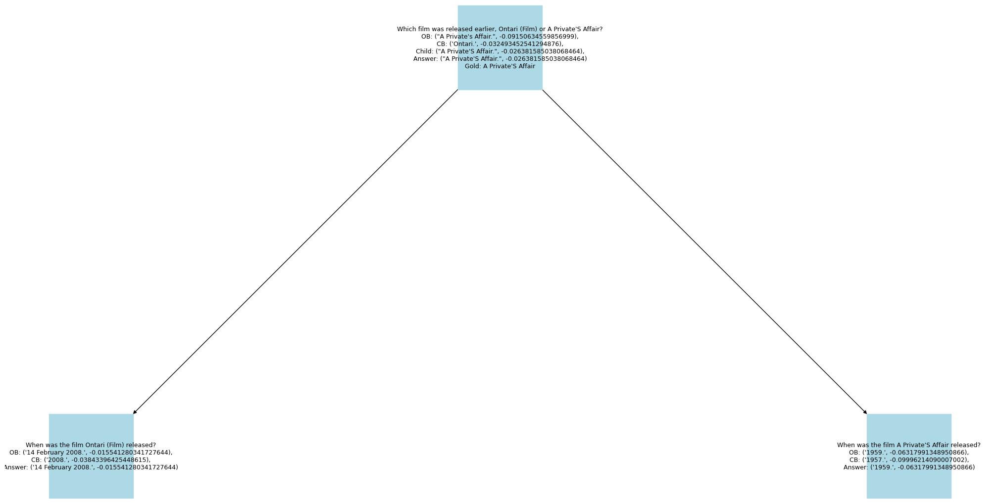

[["Who is Adelaide Of Burgundy, Duchess Of Brabant's paternal grandfather?\nOB: ('Odo III, Duke of Burgundy.', -0.025959736150468243),\nCB: ('Richard II of Burgundy.', -0.04216130718918876),\nChild: ('Robert I, Duke of Burgundy.', -0.0301618482567511),\nAnswer: ('Odo III, Duke of Burgundy.', -0.025959736150468243)\nGold: Odo III, Duke of Burgundy", "Who is the father of Adelaide Of Burgundy, Duchess Of Brabant?\nOB: ('Hugh IV, Duke of Burgundy.', -0.052827880355079515),\nCB: ('Richard, Duke of Burgundy.', -0.1281627475110085),\nAnswer: ('Hugh IV, Duke of Burgundy.', -0.052827880355079515)"], ["Who is Adelaide Of Burgundy, Duchess Of Brabant's paternal grandfather?\nOB: ('Odo III, Duke of Burgundy.', -0.025959736150468243),\nCB: ('Richard II of Burgundy.', -0.04216130718918876),\nChild: ('Robert I, Duke of Burgundy.', -0.0301618482567511),\nAnswer: ('Odo III, Duke of Burgundy.', -0.025959736150468243)\nGold: Odo III, Duke of Burgundy", "Who is the father of <1>'s father?\nOB: ('Odo III,

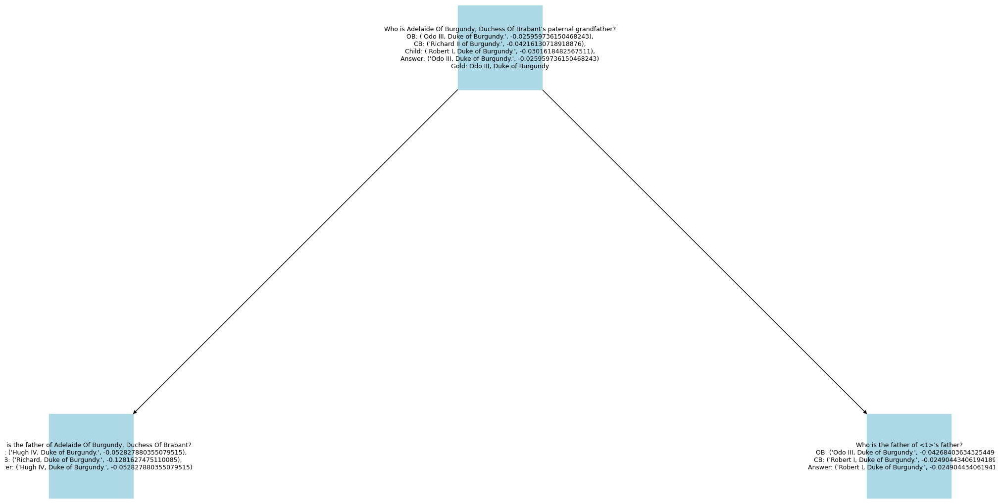

[["Who was born later, Allan Havey or Bradley Dredge?\nOB: ('Bradley Dredge.', -0.02512127177871166),\nCB: ('Bradley Dredge.', -0.0942274270167518),\nChild: ('Bradley Dredge.', -0.01060628756592221),\nAnswer: ('Bradley Dredge.', -0.01060628756592221)\nGold: Bradley Dredge", "When was Allan Havey born?\nOB: ('September 19, 1954.', -0.004025395702866667),\nCB: ('September 19, 1954.', -0.083721170390002),\nAnswer: ('September 19, 1954.', -0.004025395702866667)"], ["Who was born later, Allan Havey or Bradley Dredge?\nOB: ('Bradley Dredge.', -0.02512127177871166),\nCB: ('Bradley Dredge.', -0.0942274270167518),\nChild: ('Bradley Dredge.', -0.01060628756592221),\nAnswer: ('Bradley Dredge.', -0.01060628756592221)\nGold: Bradley Dredge", "When was Bradley Dredge born?\nOB: ('6 July 1973.', -0.008800331415069333),\nCB: ('December 11, 1973.', -0.11582604904344822),\nAnswer: ('6 July 1973.', -0.008800331415069333)"]]


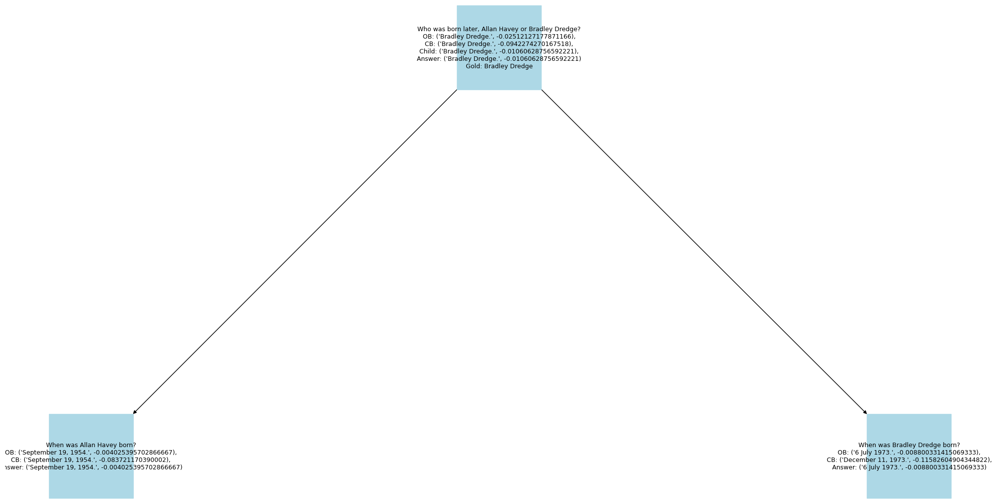

[['Which film was released more recently, Nearly A Deserter or Face À L\'Océan?\nOB: ("Face à l\'Océan.", -0.07407195704360162),\nCB: ("Face à l\'Océan.", -0.03649362257351367),\nChild: ("Face À L\'Océan.", -0.01986653706181133),\nAnswer: ("Face À L\'Océan.", -0.01986653706181133)\nGold: Face À L\'Océan', "When was the film Nearly A Deserter released?\nOB: ('1916.', -0.01986552976292286),\nCB: ('1941.', -0.07392995050096124),\nAnswer: ('1916.', -0.01986552976292286)"], ['Which film was released more recently, Nearly A Deserter or Face À L\'Océan?\nOB: ("Face à l\'Océan.", -0.07407195704360162),\nCB: ("Face à l\'Océan.", -0.03649362257351367),\nChild: ("Face À L\'Océan.", -0.01986653706181133),\nAnswer: ("Face À L\'Océan.", -0.01986653706181133)\nGold: Face À L\'Océan', "When was the film Face À L'Océan released?\nOB: ('1920.', -0.04101216770290636),\nCB: ('1943.', -0.13765536411477391),\nAnswer: ('1920.', -0.04101216770290636)"]]


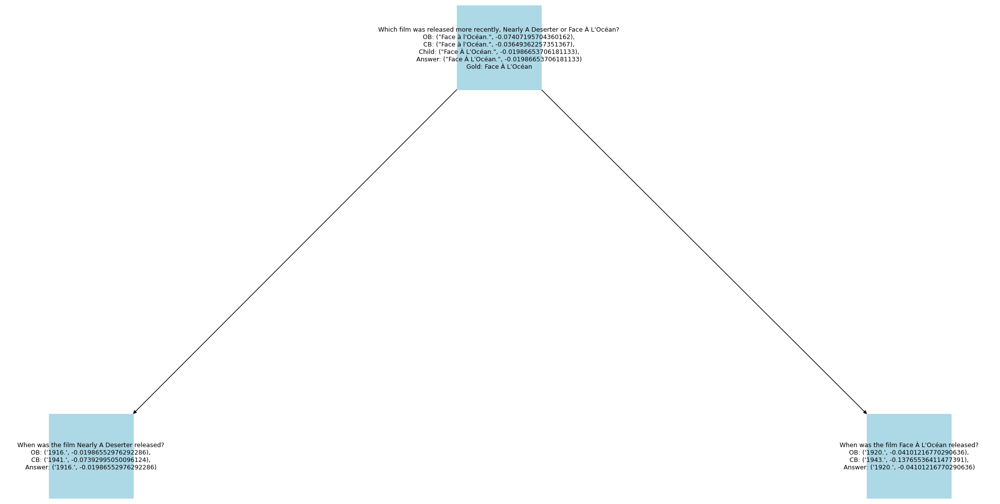

[["Who was born later, Franz Xaver Haberl or Sharon Richardson?\nOB: ('Sharon Richardson.', -0.007193811626019332),\nCB: ('Sharon Richardson.', -0.024028062715091288),\nChild: ('Sharon Richardson.', -0.006708030113123632),\nAnswer: ('Sharon Richardson.', -0.006708030113123632)\nGold: Sharon Richardson", "When was Franz Xaver Haberl born?\nOB: ('12 April 1840.', -0.0010776659872123529),\nCB: ('12 April 1840.', -0.04605549961214706),\nAnswer: ('12 April 1840.', -0.0010776659872123529)"], ["Who was born later, Franz Xaver Haberl or Sharon Richardson?\nOB: ('Sharon Richardson.', -0.007193811626019332),\nCB: ('Sharon Richardson.', -0.024028062715091288),\nChild: ('Sharon Richardson.', -0.006708030113123632),\nAnswer: ('Sharon Richardson.', -0.006708030113123632)\nGold: Sharon Richardson", "When was Sharon Richardson born?\nOB: ('May 26, 1943.', -0.0020776135797742857),\nCB: ('January 5, 1952.', -0.1459203451434314),\nAnswer: ('May 26, 1943.', -0.0020776135797742857)"]]


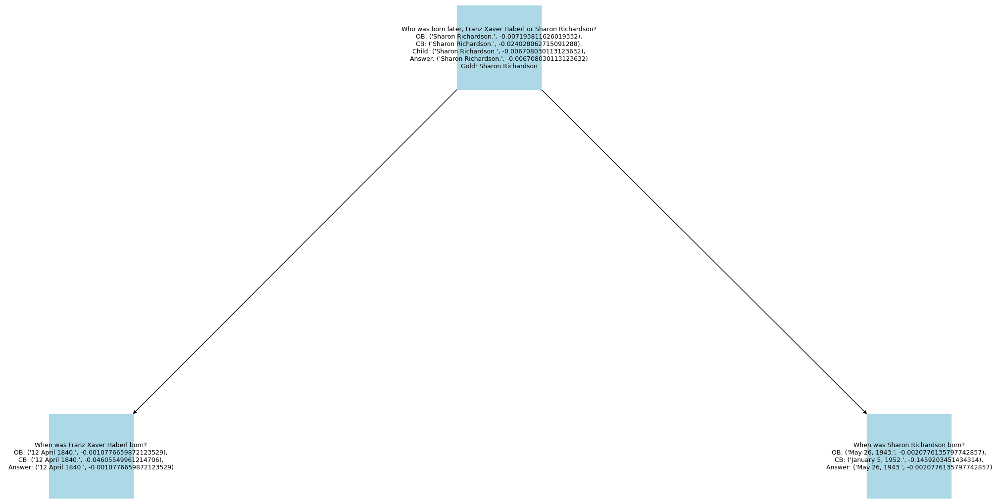

[["Who is the spouse of the director of film The Ear?\nOB: ('Alena Mihulová.', -0.04002284977260432),\nCB: ('Věra Kachyňa.', -0.054356506081185814),\nChild: ('Alena Mihulová.', -0.03473969576609891),\nAnswer: ('Alena Mihulová.', -0.03473969576609891)\nGold: Alena Mihulová", "Who is the director of film The Ear?\nOB: ('Karel Kachyňa.', -0.08619474617931686),\nCB: ('Karel Kachyňa.', -0.05074862869410928),\nAnswer: ('Karel Kachyňa.', -0.05074862869410928)"], ["Who is the spouse of the director of film The Ear?\nOB: ('Alena Mihulová.', -0.04002284977260432),\nCB: ('Věra Kachyňa.', -0.054356506081185814),\nChild: ('Alena Mihulová.', -0.03473969576609891),\nAnswer: ('Alena Mihulová.', -0.03473969576609891)\nGold: Alena Mihulová", "Who is the spouse of <1>?\nOB: ('Alena Mihulová.', -0.04503137925128704),\nCB: ('Hana Kachyňová.', -0.10166704724316113),\nAnswer: ('Alena Mihulová.', -0.04503137925128704)"]]


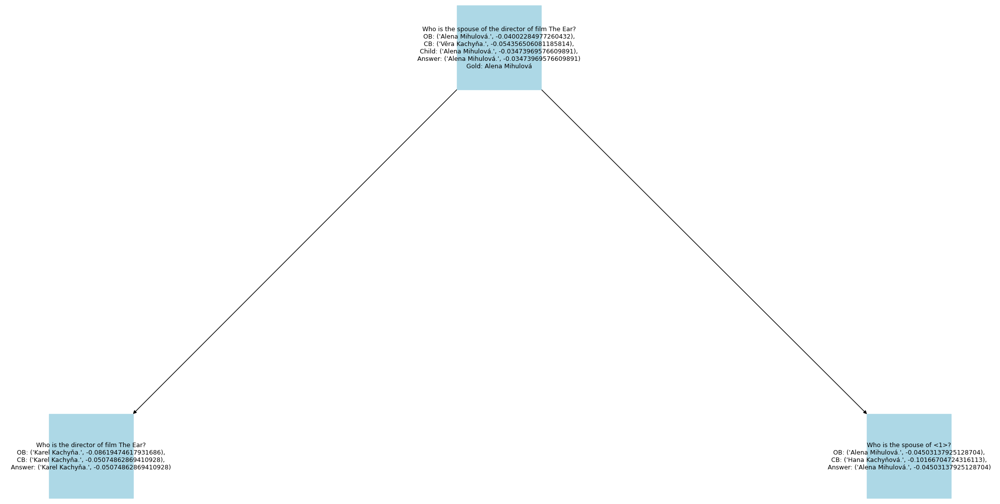

[['Which film came out first, The Ex-Wife Of My Life or Wrangler\'S Roost?\nOB: ("Wrangler\'s Roost.", -0.021304071006364663),\nCB: ("Wrangler\'s Roost.", -0.04732431145232755),\nChild: ("Wrangler\'S Roost.", -0.014974207143525868),\nAnswer: ("Wrangler\'S Roost.", -0.014974207143525868)\nGold: Wrangler\'S Roost', "When was the film The Ex-Wife Of My Life published?\nOB: ('2005.', -0.04555855200595999),\nCB: ('1963.', -0.03904852573645555),\nAnswer: ('1963.', -0.03904852573645555)"], ['Which film came out first, The Ex-Wife Of My Life or Wrangler\'S Roost?\nOB: ("Wrangler\'s Roost.", -0.021304071006364663),\nCB: ("Wrangler\'s Roost.", -0.04732431145232755),\nChild: ("Wrangler\'S Roost.", -0.014974207143525868),\nAnswer: ("Wrangler\'S Roost.", -0.014974207143525868)\nGold: Wrangler\'S Roost', "When was the film Wrangler'S Roost published?\nOB: ('June 4, 1941.', -0.006497601685917777),\nCB: ('1951.', -0.06784506168224187),\nAnswer: ('June 4, 1941.', -0.006497601685917777)"]]


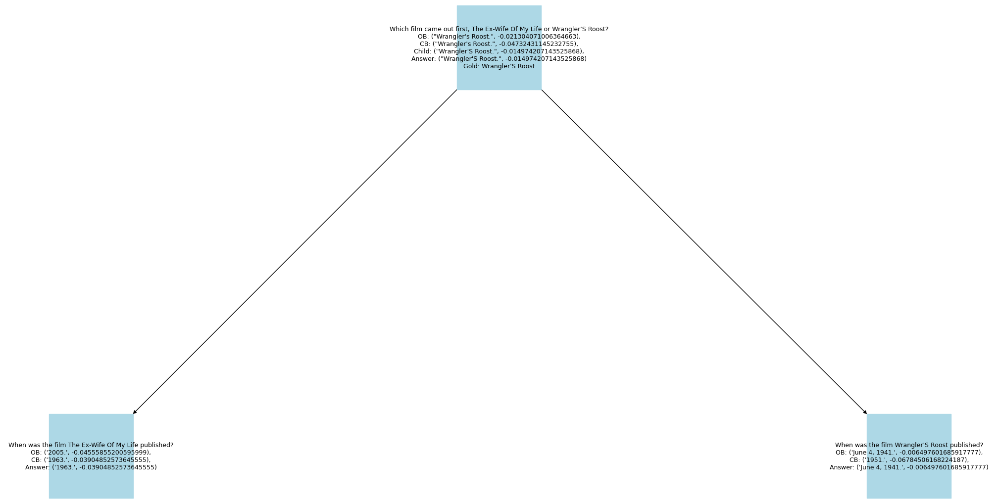

[["What nationality is the director of film Astronauts Gone Wild?\nOB: ('American.', -0.05715134221215374),\nCB: ('American.', -0.09393260700449772),\nChild: ('American.', -0.03605068573632815),\nAnswer: ('American.', -0.03605068573632815)\nGold: American", "Who is the director of film Astronauts Gone Wild?\nOB: ('Bart Sibrel.', -0.09719643798203635),\nCB: ('Scott Sanders.', -0.24168248378249846),\nAnswer: ('Bart Sibrel.', -0.09719643798203635)"], ["What nationality is the director of film Astronauts Gone Wild?\nOB: ('American.', -0.05715134221215374),\nCB: ('American.', -0.09393260700449772),\nChild: ('American.', -0.03605068573632815),\nAnswer: ('American.', -0.03605068573632815)\nGold: American", "What is the nationality of <1>?\nOB: ('American.', -0.01915021757527083),\nCB: ('Belgian.', -0.28943674639049505),\nAnswer: ('American.', -0.01915021757527083)"]]


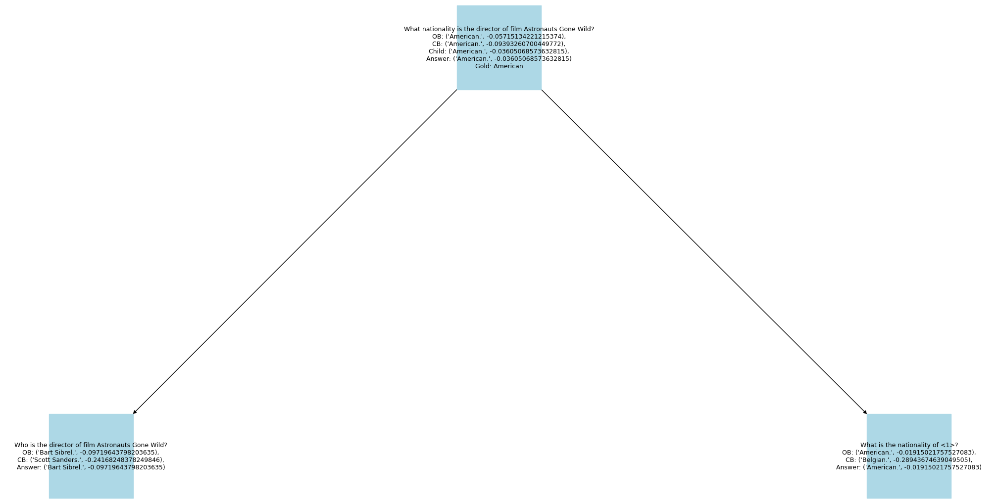

[['Which film whose director was born first, The Olsen Gang\'S Big Score or To Be Or Not To Be (1983 Film)?\nOB: ("The Olsen Gang\'s Big Score.", -0.11744862919820702),\nCB: ("The Olsen Gang\'S Big Score.", -0.061050494129705535),\nChild: ("The Olsen Gang\'S Big Score.", -0.008463829942290245),\nAnswer: ("The Olsen Gang\'S Big Score.", -0.008463829942290245)\nGold: The Olsen Gang\'S Big Score', "When was the director of film The Olsen Gang'S Big Score born?\nOB: ('29 November 1924.', -0.06357898021024393),\nCB: ('November 20, 1924.', -0.012726590603703104),\nChild: ('29 November 1924.', -0.0094360134961862),\nAnswer: ('29 November 1924.', -0.0094360134961862)"], ["When was the director of film The Olsen Gang'S Big Score born?\nOB: ('29 November 1924.', -0.06357898021024393),\nCB: ('November 20, 1924.', -0.012726590603703104),\nChild: ('29 November 1924.', -0.0094360134961862),\nAnswer: ('29 November 1924.', -0.0094360134961862)", "Who is the director of film The Olsen Gang'S Big Score?

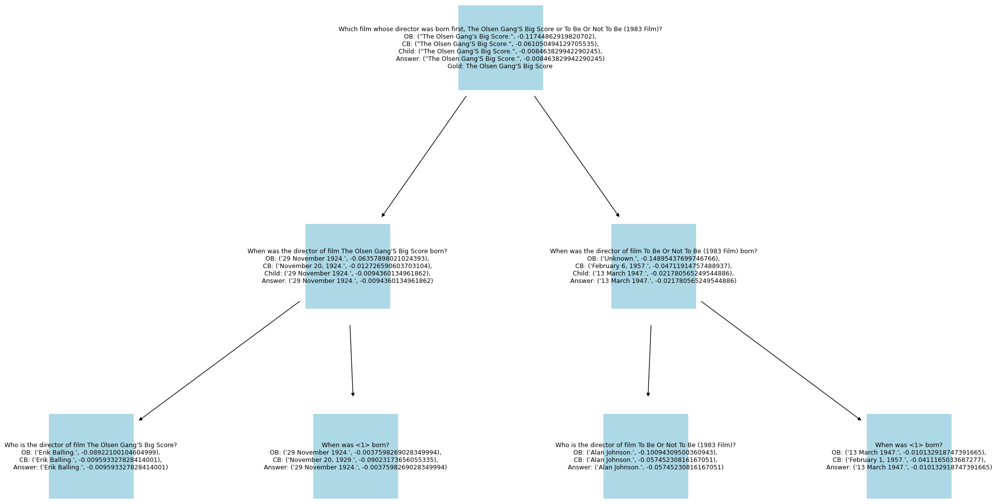

[['Which film has the director who died first, The Wild Bull\'S Lair or Devotion (1950 Film)?\nOB: ("The Wild Bull\'s Lair.", -0.07318148025329625),\nCB: (\'Devotion (1950 Film).\', -0.17680413784369128),\nChild: ("The Wild Bull\'S Lair.", -0.008003894172902948),\nAnswer: ("The Wild Bull\'S Lair.", -0.008003894172902948)\nGold: The Wild Bull\'S Lair', "When did the director of film The Wild Bull'S Lair die?\nOB: ('October 27, 1942.', -0.0442506027186088),\nCB: ('July 25, 2011.', -0.06938379819232163),\nChild: ('October 27, 1942.', -0.013015477538723678),\nAnswer: ('October 27, 1942.', -0.013015477538723678)"], ["When did the director of film The Wild Bull'S Lair die?\nOB: ('October 27, 1942.', -0.0442506027186088),\nCB: ('July 25, 2011.', -0.06938379819232163),\nChild: ('October 27, 1942.', -0.013015477538723678),\nAnswer: ('October 27, 1942.', -0.013015477538723678)", "Who is the director of film The Wild Bull'S Lair?\nOB: ('Del Andrews.', -0.04910271391648684),\nCB: ('Michael Cacoyan

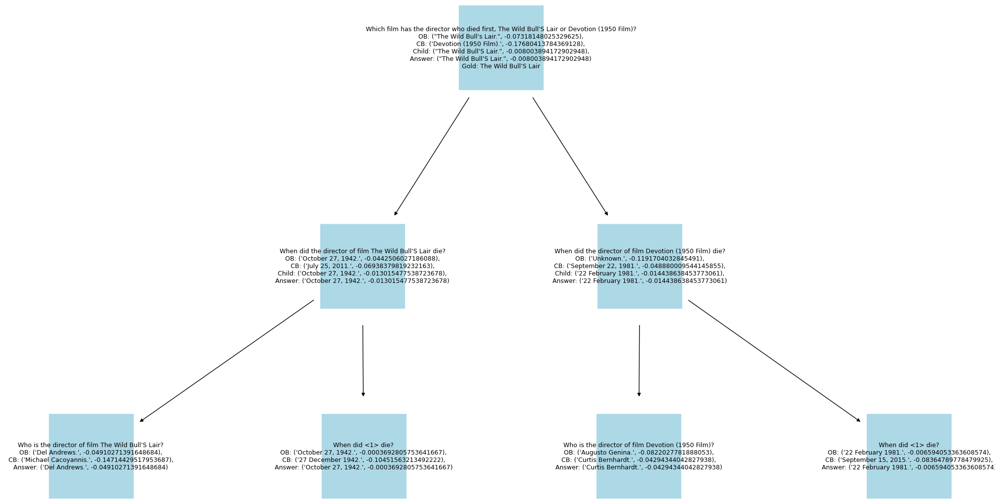

[["Are You Had To Be A Gypsy and Paul Blart: Mall Cop from the same country?\nOB: ('no.', -0.022857169403117224),\nCB: ('no.', -0.09242390502326006),\nChild: ('No.', -0.047978926303626525),\nAnswer: ('no.', -0.022857169403117224)\nGold: no", "Which country is You Had To Be A Gypsy from?\nOB: ('Mexico-Spain.', -0.058279895764493335),\nCB: ('Germany.', -0.17409761015265685),\nAnswer: ('Mexico-Spain.', -0.058279895764493335)"], ["Are You Had To Be A Gypsy and Paul Blart: Mall Cop from the same country?\nOB: ('no.', -0.022857169403117224),\nCB: ('no.', -0.09242390502326006),\nChild: ('No.', -0.047978926303626525),\nAnswer: ('no.', -0.022857169403117224)\nGold: no", "Which country is Paul Blart: Mall Cop from?\nOB: ('United States.', -0.050105482130415845),\nCB: ('United States.', -0.0418499114273575),\nAnswer: ('United States.', -0.0418499114273575)"]]


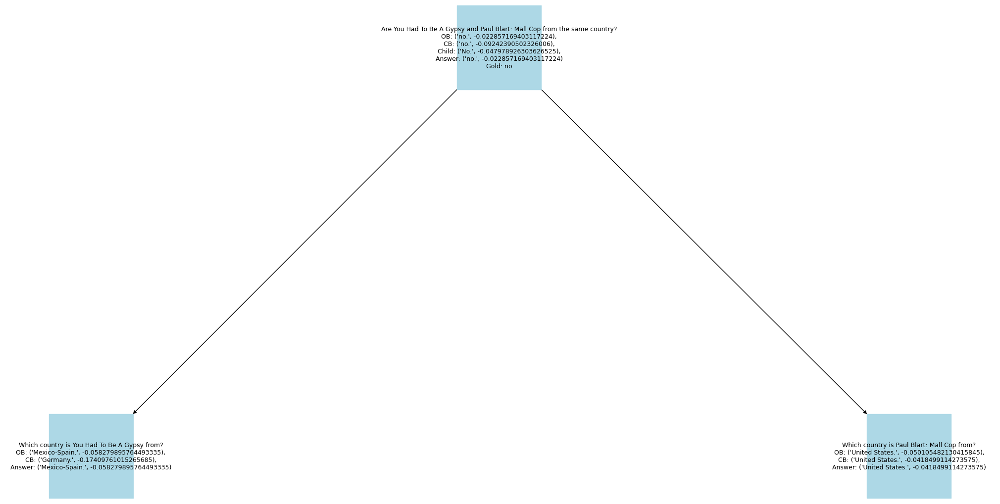

[["Which country the performer of song Den Lilla Fågeln is from?\nOB: ('Sweden.', -0.065775743834148),\nCB: ('Sweden.', -0.10487558128741517),\nChild: ('Sweden.', -0.030895836159040773),\nAnswer: ('Sweden.', -0.030895836159040773)\nGold: Sweden", "Who is the performer of song Den Lilla Fågeln?\nOB: ('Stig Lorentz.', -0.06430549307193953),\nCB: ('Evert Taube.', -0.12544868344691118),\nAnswer: ('Stig Lorentz.', -0.06430549307193953)"], ["Which country the performer of song Den Lilla Fågeln is from?\nOB: ('Sweden.', -0.065775743834148),\nCB: ('Sweden.', -0.10487558128741517),\nChild: ('Sweden.', -0.030895836159040773),\nAnswer: ('Sweden.', -0.030895836159040773)\nGold: Sweden", "Which country is <1> from?\nOB: ('Sweden.', -0.03943296319327778),\nCB: ('Sweden.', -0.14028110294266044),\nAnswer: ('Sweden.', -0.03943296319327778)"]]


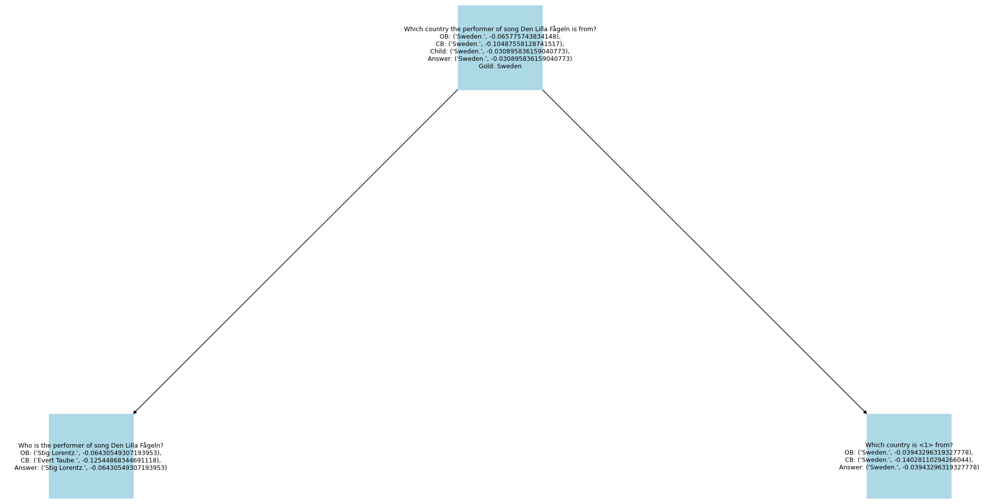

[["Which film was released earlier, Fast Five or The Testament Of Dr. Mabuse?\nOB: ('The Testament of Dr. Mabuse.', -0.02595526294076289),\nCB: ('The Testament of Dr. Mabuse.', -0.014147432523955302),\nChild: ('The Testament Of Dr. Mabuse.', -0.018524706580276988),\nAnswer: ('The Testament of Dr. Mabuse.', -0.014147432523955302)\nGold: The Testament Of Dr. Mabuse", "When was the film Fast Five released?\nOB: ('April 29, 2011.', -0.102541005786338),\nCB: ('2011.', -0.02557313441196923),\nAnswer: ('2011.', -0.02557313441196923)"], ["Which film was released earlier, Fast Five or The Testament Of Dr. Mabuse?\nOB: ('The Testament of Dr. Mabuse.', -0.02595526294076289),\nCB: ('The Testament of Dr. Mabuse.', -0.014147432523955302),\nChild: ('The Testament Of Dr. Mabuse.', -0.018524706580276988),\nAnswer: ('The Testament of Dr. Mabuse.', -0.014147432523955302)\nGold: The Testament Of Dr. Mabuse", "When was the film The Testament Of Dr. Mabuse released?\nOB: ('1933.', -0.04859856762444066),\nCB

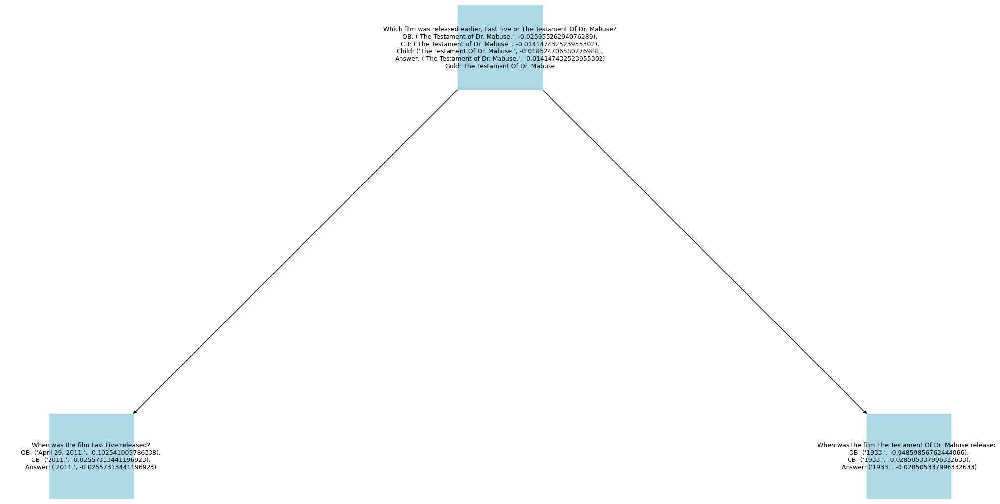

[["Where was the place of death of John Ii Of Luxembourg, Count Of Ligny's father?\nOB: ('Italy.', -0.05867674701754462),\nCB: ('Beaune.', -0.09902515033099361),\nChild: ('Italy.', -0.020222712238341253),\nAnswer: ('Italy.', -0.020222712238341253)\nGold: Italy", "Who is the father of John Ii Of Luxembourg, Count Of Ligny?\nOB: ('John of Luxembourg, Lord of Beauvoir.', -0.014633685395059166),\nCB: ('Anthony, Count of Ligny.', -0.11097273585537999),\nAnswer: ('John of Luxembourg, Lord of Beauvoir.', -0.014633685395059166)"], ["Where was the place of death of John Ii Of Luxembourg, Count Of Ligny's father?\nOB: ('Italy.', -0.05867674701754462),\nCB: ('Beaune.', -0.09902515033099361),\nChild: ('Italy.', -0.020222712238341253),\nAnswer: ('Italy.', -0.020222712238341253)\nGold: Italy", "Where did <1> die?\nOB: ('Italy.', -0.025458042609765388),\nCB: ('Luxembourg.', -0.04896255676209231),\nAnswer: ('Italy.', -0.025458042609765388)"]]


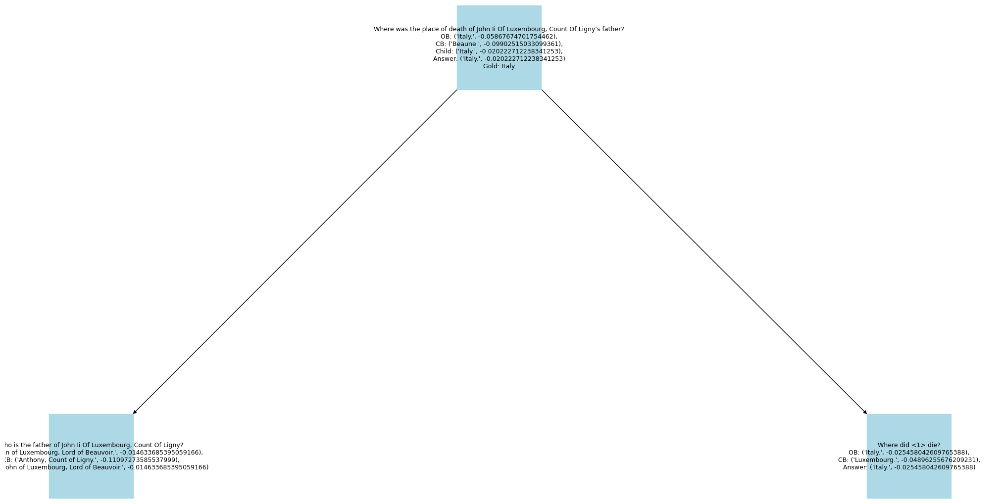

[["Which film has the director died later, Arctic Blue or Jasper And The Haunted House?\nOB: ('Jasper and the Haunted House.', -0.048539847791157324),\nCB: ('Arctic Blue.', -0.17029593434005602),\nChild: ('Arctic Blue.', -0.012343727109179256),\nAnswer: ('Arctic Blue.', -0.012343727109179256)\nGold: Arctic Blue", "When did the director of film Arctic Blue die?\nOB: ('December 18, 2018.', -0.05002104745545626),\nCB: ('May 18, 2013.', -0.0688094336987173),\nChild: ('December 18, 2018.', -0.021994899501905883),\nAnswer: ('December 18, 2018.', -0.021994899501905883)"], ["When did the director of film Arctic Blue die?\nOB: ('December 18, 2018.', -0.05002104745545626),\nCB: ('May 18, 2013.', -0.0688094336987173),\nChild: ('December 18, 2018.', -0.021994899501905883),\nAnswer: ('December 18, 2018.', -0.021994899501905883)", "Who is the director of film Arctic Blue?\nOB: ('Peter Masterson.', -0.05827507082792636),\nCB: ('Aleksey Balabanov.', -0.1342397077112857),\nAnswer: ('Peter Masterson.', 

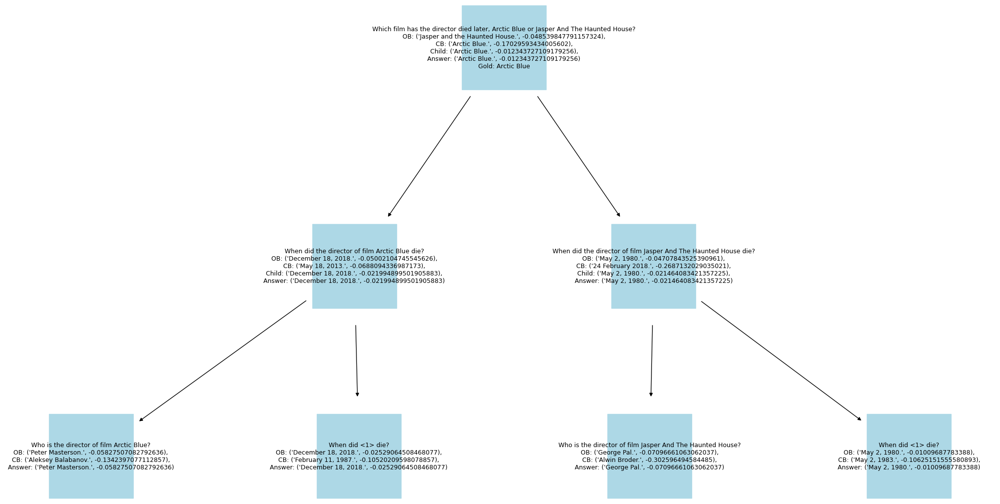

[["Which film has the director who died later, Lukket Avdeling or Three Hearts For Julia?\nOB: ('Lukket avdeling.', -0.10157403516889597),\nCB: ('Lukket Avdeling.', -0.08663959613619754),\nChild: ('Three Hearts For Julia.', -0.014673329723162305),\nAnswer: ('Three Hearts For Julia.', -0.014673329723162305)\nGold: Three Hearts For Julia", "When did the director of film Lukket Avdeling die?\nOB: ('9 December 1982.', -0.02550137059716066),\nCB: ('18 April 2017.', -0.2818504785177978),\nChild: ('13 July 2014.', -0.0454329689396323),\nAnswer: ('9 December 1982.', -0.02550137059716066)"], ["When did the director of film Lukket Avdeling die?\nOB: ('9 December 1982.', -0.02550137059716066),\nCB: ('18 April 2017.', -0.2818504785177978),\nChild: ('13 July 2014.', -0.0454329689396323),\nAnswer: ('9 December 1982.', -0.02550137059716066)", "Who is the director of film Lukket Avdeling?\nOB: ('Arnljot Berg.', -0.09261188685754812),\nCB: ('Vibeke Løkkeberg.', -0.07758035910956668),\nAnswer: ('Vibeke 

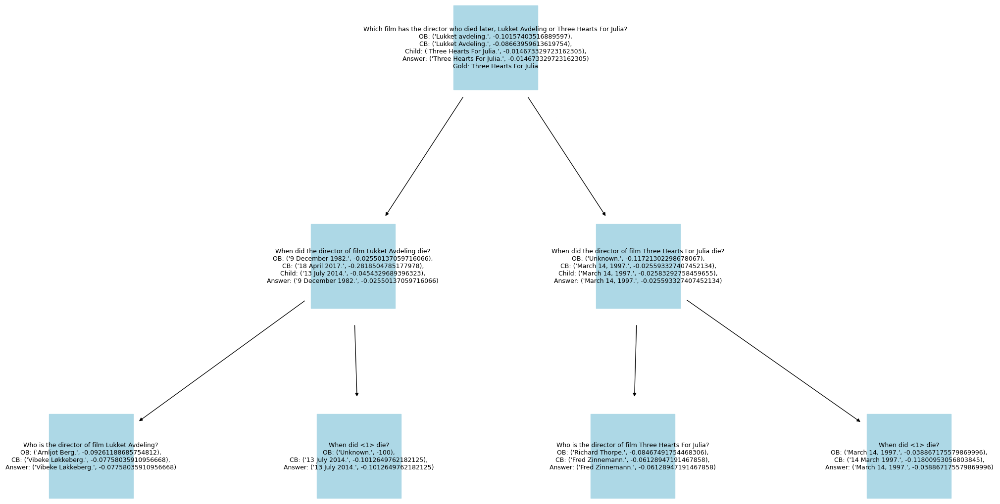

[["Where was the husband of Frances Tupper born?\nOB: ('Halifax, Nova Scotia.', -0.07794014138714749),\nCB: ('Amherst, Nova Scotia.', -0.03710470573256875),\nChild: ('Amherst, Nova Scotia.', -0.018029577499975604),\nAnswer: ('Amherst, Nova Scotia.', -0.018029577499975604)\nGold: Amherst, Nova Scotia", "Who is the husband of Frances Tupper?\nOB: ('Sir Charles Tupper.', -0.05898087223828999),\nCB: ('Charles Tupper.', -0.20047136824840905),\nAnswer: ('Sir Charles Tupper.', -0.05898087223828999)"], ["Where was the husband of Frances Tupper born?\nOB: ('Halifax, Nova Scotia.', -0.07794014138714749),\nCB: ('Amherst, Nova Scotia.', -0.03710470573256875),\nChild: ('Amherst, Nova Scotia.', -0.018029577499975604),\nAnswer: ('Amherst, Nova Scotia.', -0.018029577499975604)\nGold: Amherst, Nova Scotia", "Where was <1> born?\nOB: ('Amherst, Nova Scotia.', -0.0008157832528200001),\nCB: ('Amherst, Nova Scotia.', -0.01343942522162),\nAnswer: ('Amherst, Nova Scotia.', -0.0008157832528200001)"]]


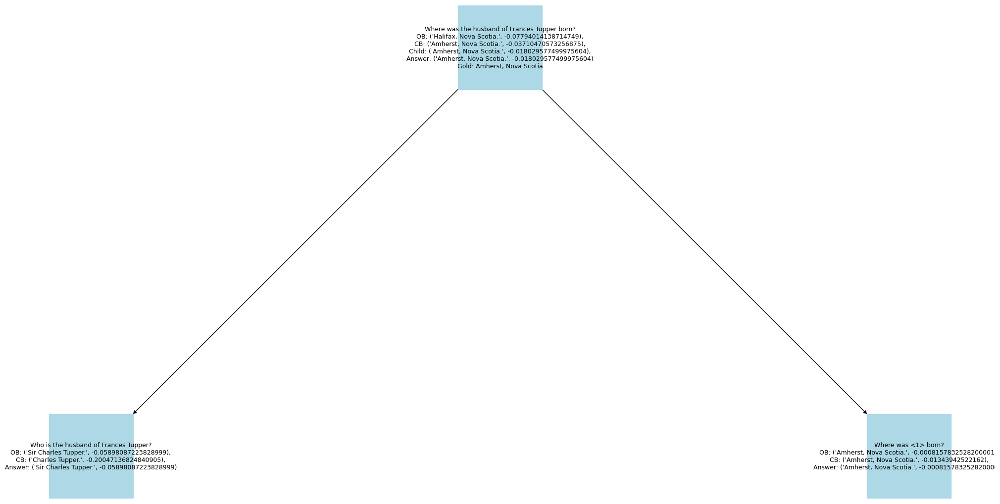

[["Are Afterwards and The Whistle (Film) from the same country?\nOB: ('yes.', -0.22277171854909425),\nCB: ('no.', -0.06983221772466552),\nChild: ('No.', -0.037147717191330795),\nAnswer: ('No.', -0.037147717191330795)\nGold: no", "Which country is Afterwards from?\nOB: ('Canada.', -0.2758789074285714),\nCB: ('France.', -0.04745141121068524),\nAnswer: ('France.', -0.04745141121068524)"], ["Are Afterwards and The Whistle (Film) from the same country?\nOB: ('yes.', -0.22277171854909425),\nCB: ('no.', -0.06983221772466552),\nChild: ('No.', -0.037147717191330795),\nAnswer: ('No.', -0.037147717191330795)\nGold: no", "Which country is The Whistle (Film) from?\nOB: ('United States.', -0.028304327031087),\nCB: ('Germany.', -0.1580465223086884),\nAnswer: ('United States.', -0.028304327031087)"]]


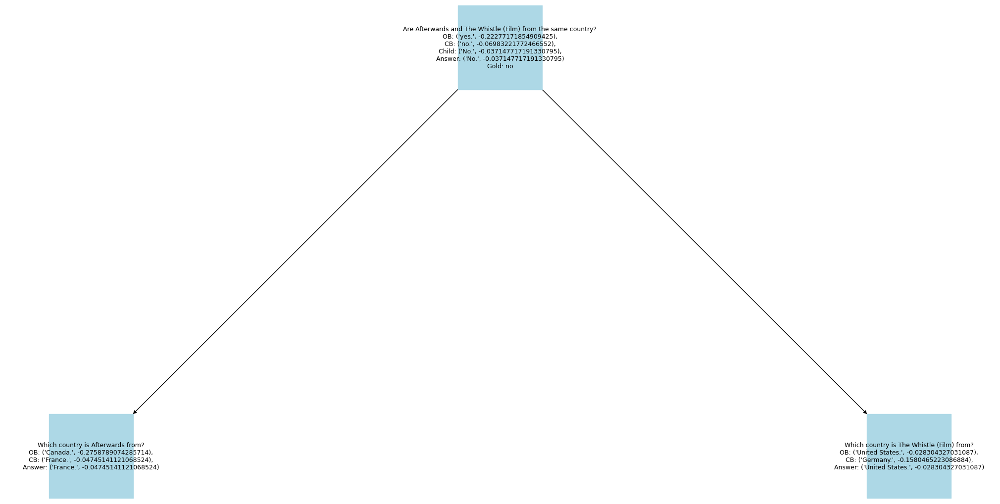

[["When did John Of Luxembourg, Count Of Soissons's father die?\nOB: ('1475.', -0.06925486022846654),\nCB: ('1213.', -0.11229602245678887),\nChild: ('19 December 1475.', -0.0344867238538986),\nAnswer: ('19 December 1475.', -0.0344867238538986)\nGold: 19 December 1475", "Who is the father of John Of Luxembourg, Count Of Soissons?\nOB: ('Louis de Luxembourg, Count of Saint-Pol.', -0.08480276300948089),\nCB: ('Frederick II, Count of Luxembourg.', -0.1089629184378026),\nAnswer: ('Louis de Luxembourg, Count of Saint-Pol.', -0.08480276300948089)"], ["When did John Of Luxembourg, Count Of Soissons's father die?\nOB: ('1475.', -0.06925486022846654),\nCB: ('1213.', -0.11229602245678887),\nChild: ('19 December 1475.', -0.0344867238538986),\nAnswer: ('19 December 1475.', -0.0344867238538986)\nGold: 19 December 1475", "When did <1> die?\nOB: ('19 December 1475.', -0.006885647739309472),\nCB: ('August 19, 1475.', -0.072650498290675),\nAnswer: ('19 December 1475.', -0.006885647739309472)"]]


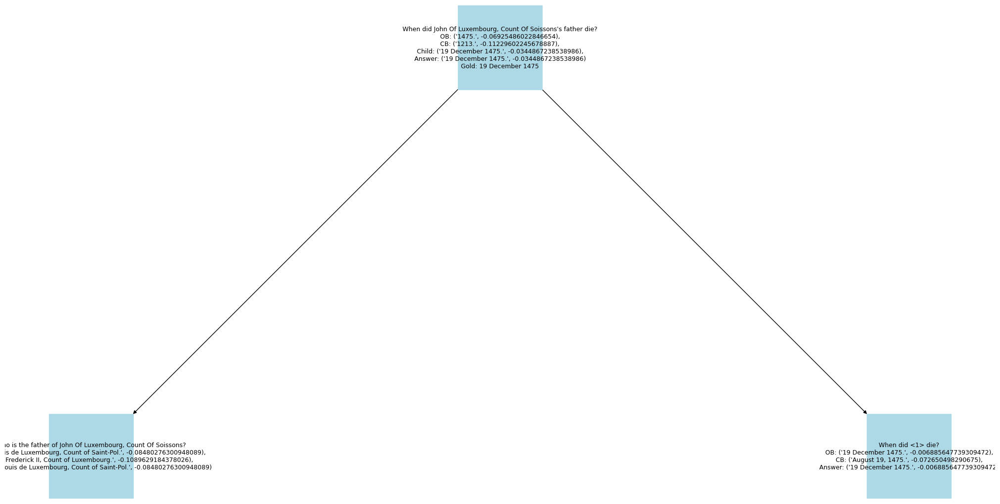

[['Who is Maud Of Gloucester, Countess Of Chester\'s father-in-law?\nOB: (\'Ranulf le Meschin, 3rd Earl of Chester.\', -0.01760212007422857),\nCB: ("Hugh d\'Avranches.", -0.02857110675103971),\nChild: (\'Ranulf le Meschin, 3rd Earl of Chester.\', -0.026236479330368132),\nAnswer: (\'Ranulf le Meschin, 3rd Earl of Chester.\', -0.01760212007422857)\nGold: Ranulf le Meschin, 3rd Earl of Chester', "Who is Maud Of Gloucester, Countess Of Chester married to?\nOB: ('Ranulf de Gernon, 4th Earl of Chester.', -0.02235593159026777),\nCB: ('Ranulf de Blondeville, 4th Earl of Chester.', -0.046220000314312136),\nAnswer: ('Ranulf de Gernon, 4th Earl of Chester.', -0.02235593159026777)"], ['Who is Maud Of Gloucester, Countess Of Chester\'s father-in-law?\nOB: (\'Ranulf le Meschin, 3rd Earl of Chester.\', -0.01760212007422857),\nCB: ("Hugh d\'Avranches.", -0.02857110675103971),\nChild: (\'Ranulf le Meschin, 3rd Earl of Chester.\', -0.026236479330368132),\nAnswer: (\'Ranulf le Meschin, 3rd Earl of Cheste

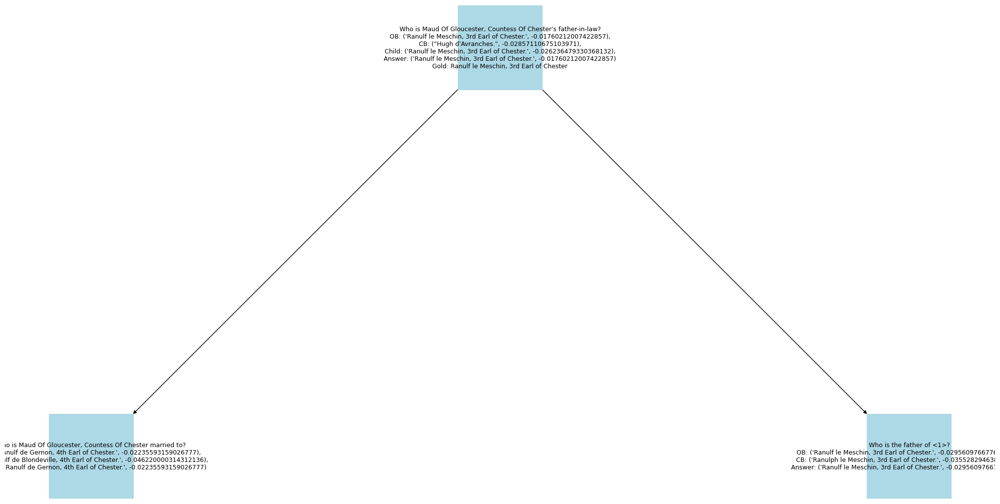

[['Which one was established first, Colt\'S Manufacturing Company or Banco Azteca?\nOB: ("Colt\'s Manufacturing Company.", -0.06760154851514888),\nCB: ("Colt\'s Manufacturing Company.", -0.04747627989526268),\nChild: ("Colt\'S Manufacturing Company.", -0.014369922078497707),\nAnswer: ("Colt\'S Manufacturing Company.", -0.014369922078497707)\nGold: Colt\'S Manufacturing Company', "When was Colt'S Manufacturing Company established?\nOB: ('1855.', -0.010656309111346),\nCB: ('1855.', -0.07717294465776332),\nAnswer: ('1855.', -0.010656309111346)"], ['Which one was established first, Colt\'S Manufacturing Company or Banco Azteca?\nOB: ("Colt\'s Manufacturing Company.", -0.06760154851514888),\nCB: ("Colt\'s Manufacturing Company.", -0.04747627989526268),\nChild: ("Colt\'S Manufacturing Company.", -0.014369922078497707),\nAnswer: ("Colt\'S Manufacturing Company.", -0.014369922078497707)\nGold: Colt\'S Manufacturing Company', "When was Banco Azteca established?\nOB: ('2002.', -0.037807151698990

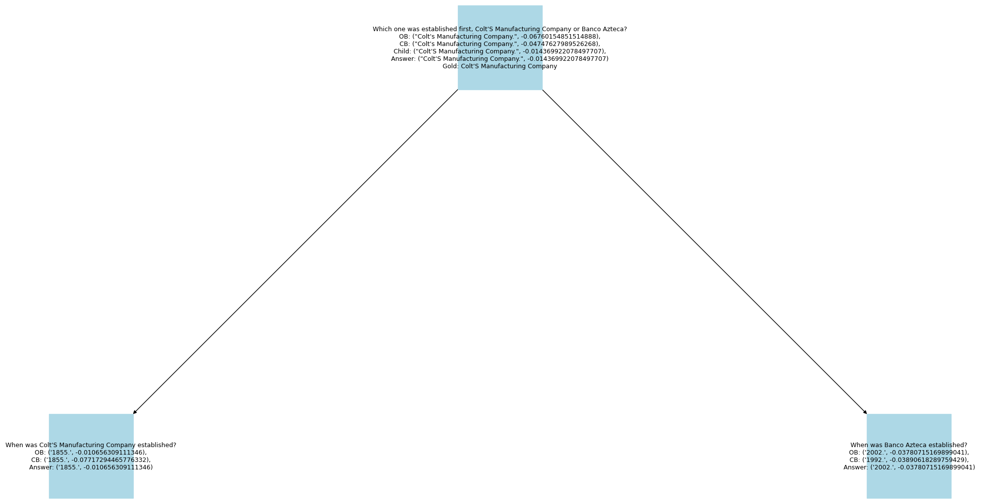

[["Which film came out earlier, Hideout In The Sun or The Truth About Women?\nOB: ('The Truth About Women.', -0.03260826158255888),\nCB: ('The Truth About Women.', -0.0443416125174608),\nChild: ('The Truth About Women.', -0.01874031340725554),\nAnswer: ('The Truth About Women.', -0.01874031340725554)\nGold: The Truth About Women", "When was the film Hideout In The Sun published?\nOB: ('1960.', -0.09925548489052284),\nCB: ('1965.', -0.04638576510814625),\nAnswer: ('1965.', -0.04638576510814625)"], ["Which film came out earlier, Hideout In The Sun or The Truth About Women?\nOB: ('The Truth About Women.', -0.03260826158255888),\nCB: ('The Truth About Women.', -0.0443416125174608),\nChild: ('The Truth About Women.', -0.01874031340725554),\nAnswer: ('The Truth About Women.', -0.01874031340725554)\nGold: The Truth About Women", "When was the film The Truth About Women published?\nOB: ('1957.', -0.14040379412577692),\nCB: ('1952.', -0.013593967457989999),\nAnswer: ('1952.', -0.013593967457989

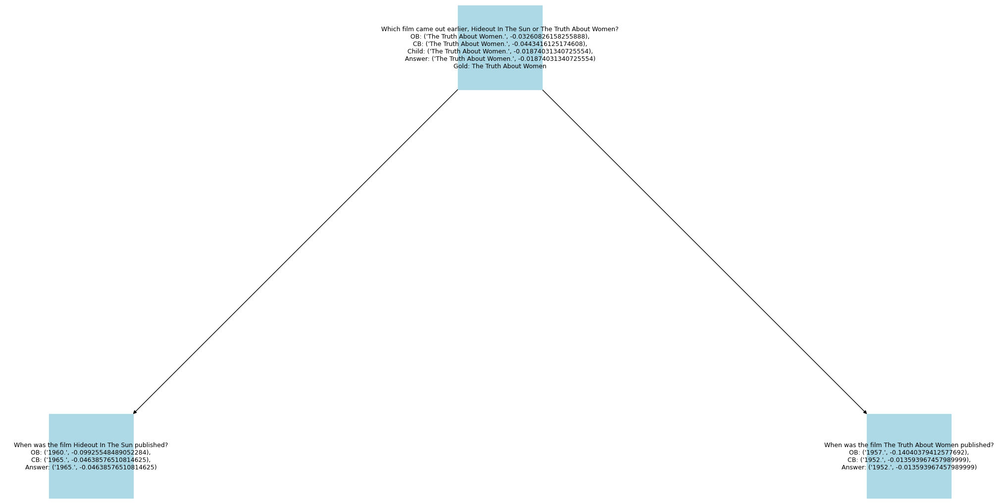

[["What is the date of death of William I, Count Of Burgundy's mother?\nOB: ('1038.', -0.050913929474684545),\nCB: ('8 February 1079.', -0.1088909250347593),\nChild: ('1038.', -0.020099750402551447),\nAnswer: ('1038.', -0.020099750402551447)\nGold: 1038", "Who is the mother of William I, Count Of Burgundy?\nOB: ('Alice of Normandy.', -0.024279050824097495),\nCB: ('Stephania.', -0.15691668225198402),\nAnswer: ('Alice of Normandy.', -0.024279050824097495)"], ["What is the date of death of William I, Count Of Burgundy's mother?\nOB: ('1038.', -0.050913929474684545),\nCB: ('8 February 1079.', -0.1088909250347593),\nChild: ('1038.', -0.020099750402551447),\nAnswer: ('1038.', -0.020099750402551447)\nGold: 1038", "What is the date of death of <1>?\nOB: ('1038.', -0.041793763563160995),\nCB: ('1122.', -0.08825154986500425),\nAnswer: ('1038.', -0.041793763563160995)"]]


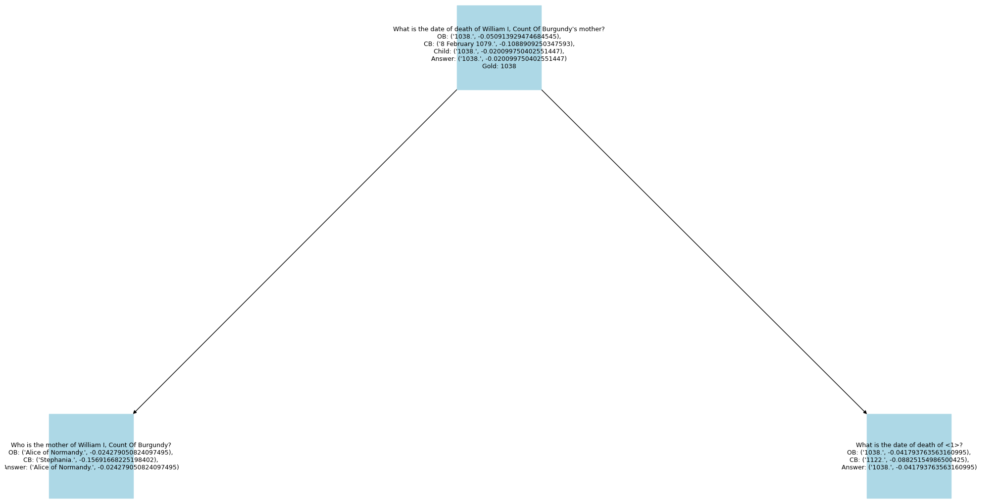

[["Who is Archduchess Immaculata Of Austria's paternal grandmother?\nOB: ('Maria Theresa of Austria.', -0.02612643238141777),\nCB: ('Princess Isabella of Croÿ.', -0.03722587565261002),\nChild: ('Princess Maria Immaculata of Bourbon-Two Sicilies.', -0.024498975287826467),\nAnswer: ('Princess Maria Immaculata of Bourbon-Two Sicilies.', -0.024498975287826467)\nGold: Princess Maria Immaculata of Bourbon-Two Sicilies", "Who is the father of Archduchess Immaculata Of Austria?\nOB: ('Archduke Leopold Salvator of Austria.', -0.05516191483786279),\nCB: ('Archduke Friedrich, Duke of Teschen.', -0.07110757434805783),\nAnswer: ('Archduke Leopold Salvator of Austria.', -0.05516191483786279)"], ["Who is Archduchess Immaculata Of Austria's paternal grandmother?\nOB: ('Maria Theresa of Austria.', -0.02612643238141777),\nCB: ('Princess Isabella of Croÿ.', -0.03722587565261002),\nChild: ('Princess Maria Immaculata of Bourbon-Two Sicilies.', -0.024498975287826467),\nAnswer: ('Princess Maria Immaculata of

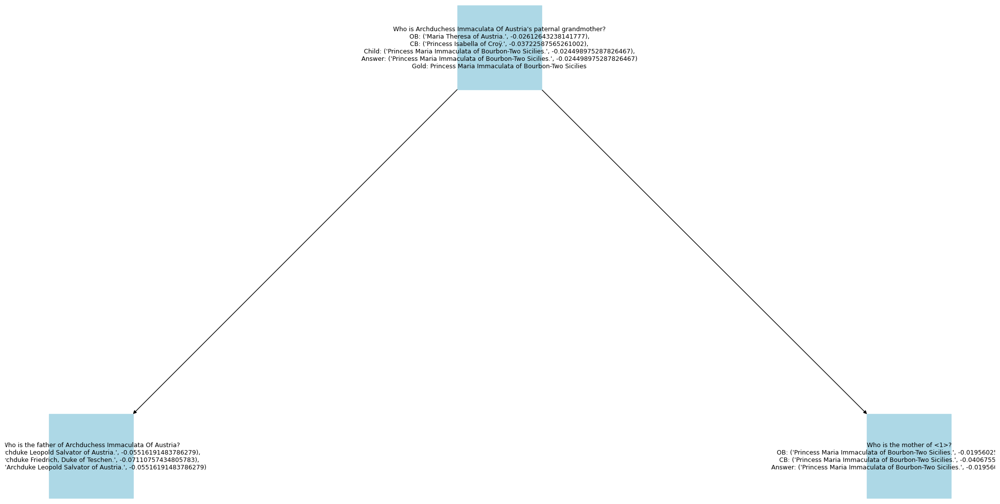

[['Which film whose director is younger, My Baby\'S Daddy or A Tale Of Winter?\nOB: ("My Baby\'s Daddy.", -0.0397940792331831),\nCB: ("My Baby\'s Daddy.", -0.09329314456405954),\nChild: ("My Baby\'S Daddy.", -0.02052573404518674),\nAnswer: ("My Baby\'S Daddy.", -0.02052573404518674)\nGold: My Baby\'S Daddy', "When was the director of film My Baby'S Daddy born?\nOB: ('May 13, 1966.', -0.0358189470273332),\nCB: ('December 18, 1962.', -0.13442164882241447),\nChild: ('May 13, 1966.', -0.022979429567598325),\nAnswer: ('May 13, 1966.', -0.022979429567598325)"], ["When was the director of film My Baby'S Daddy born?\nOB: ('May 13, 1966.', -0.0358189470273332),\nCB: ('December 18, 1962.', -0.13442164882241447),\nChild: ('May 13, 1966.', -0.022979429567598325),\nAnswer: ('May 13, 1966.', -0.022979429567598325)", "Who is the director of film My Baby'S Daddy?\nOB: ('Cheryl Dunye.', -0.06006343545936769),\nCB: ('Michael McCullers.', -0.14410736752446857),\nAnswer: ('Cheryl Dunye.', -0.0600634354593

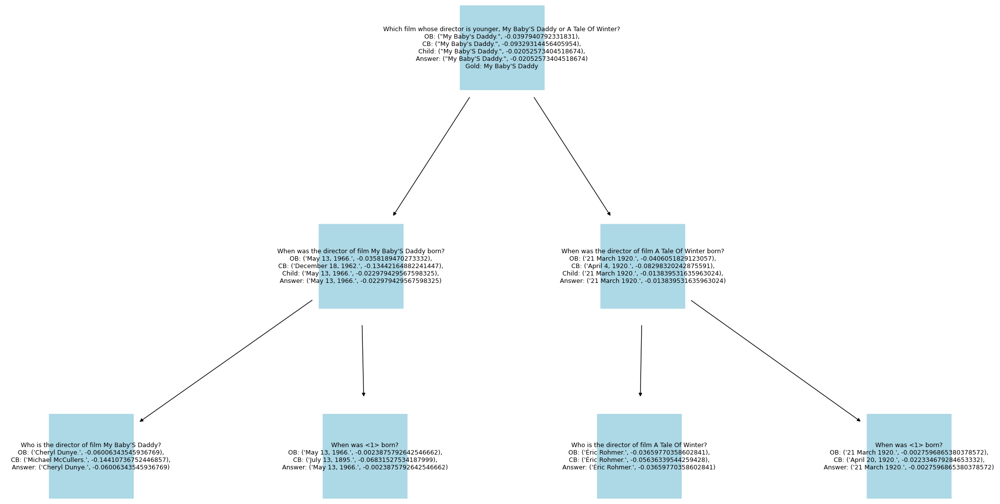

[["Are It’S A Matter Of Love and The Trusted Outlaw from the same country?\nOB: ('no.', -0.03630452210799834),\nCB: ('yes.', -0.04487739709963255),\nChild: ('No.', -0.026271884989427827),\nAnswer: ('No.', -0.026271884989427827)\nGold: no", "Which country is It’S A Matter Of Love from?\nOB: ('Sri Lanka.', -0.04933038508157157),\nCB: ('France.', -0.1026491004061645),\nAnswer: ('Sri Lanka.', -0.04933038508157157)"], ["Are It’S A Matter Of Love and The Trusted Outlaw from the same country?\nOB: ('no.', -0.03630452210799834),\nCB: ('yes.', -0.04487739709963255),\nChild: ('No.', -0.026271884989427827),\nAnswer: ('No.', -0.026271884989427827)\nGold: no", "Which country is The Trusted Outlaw from?\nOB: ('America.', -0.014879250583154),\nCB: ('United States.', -0.16925097971165204),\nAnswer: ('America.', -0.014879250583154)"]]


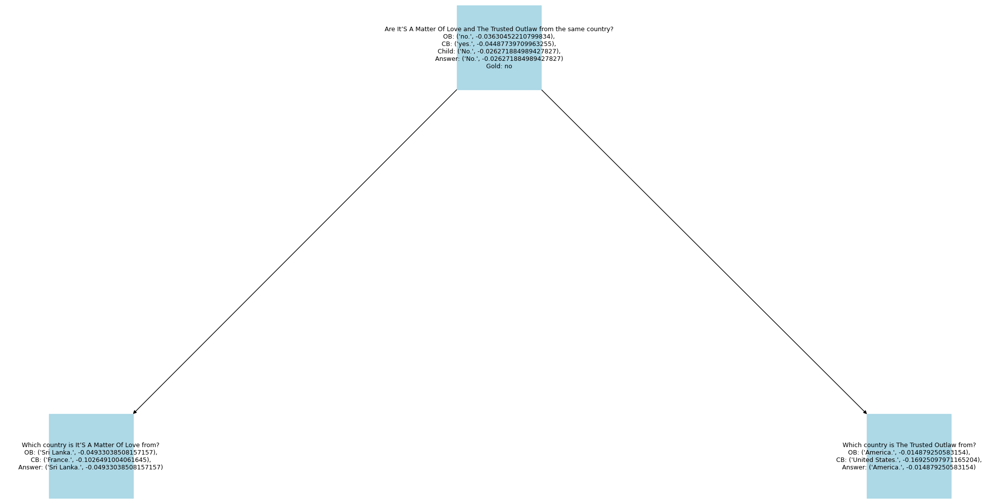

[["Who is the paternal grandmother of Princess Elisabeth Of Prussia?\nOB: ('Landgravine Marie Anna of Hesse-Homburg.', -0.06882153273046804),\nCB: ('Victoria, Princess Royal.', -0.07375870789579456),\nChild: ('Frederika Louisa of Hesse-Darmstadt.', -0.012551766739599865),\nAnswer: ('Frederika Louisa of Hesse-Darmstadt.', -0.012551766739599865)\nGold: Frederika Louisa of Hesse-Darmstadt", "Who is the father of Princess Elisabeth Of Prussia?\nOB: ('Prince Wilhelm of Prussia.', -0.021096683997250003),\nCB: ('Prince Friedrich Leopold of Prussia.', -0.11110755685598417),\nAnswer: ('Prince Wilhelm of Prussia.', -0.021096683997250003)"], ["Who is the paternal grandmother of Princess Elisabeth Of Prussia?\nOB: ('Landgravine Marie Anna of Hesse-Homburg.', -0.06882153273046804),\nCB: ('Victoria, Princess Royal.', -0.07375870789579456),\nChild: ('Frederika Louisa of Hesse-Darmstadt.', -0.012551766739599865),\nAnswer: ('Frederika Louisa of Hesse-Darmstadt.', -0.012551766739599865)\nGold: Frederika

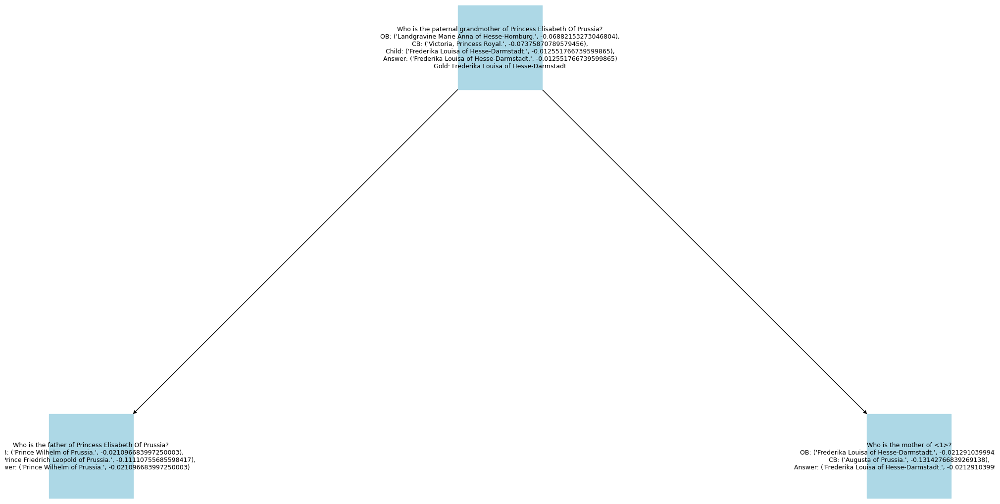

[["Who was born first out of Li Yuyang and Adam Richman?\nOB: ('Adam Richman.', -0.029480576425803214),\nCB: ('Li Yuyang.', -0.15751658615408481),\nChild: ('Adam Richman.', -0.009883915488729998),\nAnswer: ('Adam Richman.', -0.009883915488729998)\nGold: Adam Richman", "When was Li Yuyang born?\nOB: ('24 September 1997.', -0.00828456032344143),\nCB: ('November 28, 1922.', -0.23303755156517336),\nAnswer: ('24 September 1997.', -0.00828456032344143)"], ["Who was born first out of Li Yuyang and Adam Richman?\nOB: ('Adam Richman.', -0.029480576425803214),\nCB: ('Li Yuyang.', -0.15751658615408481),\nChild: ('Adam Richman.', -0.009883915488729998),\nAnswer: ('Adam Richman.', -0.009883915488729998)\nGold: Adam Richman", "When was Adam Richman born?\nOB: ('May 16, 1974.', -0.0016256996775864286),\nCB: ('May 16, 1974.', -0.05984416022094599),\nAnswer: ('May 16, 1974.', -0.0016256996775864286)"]]


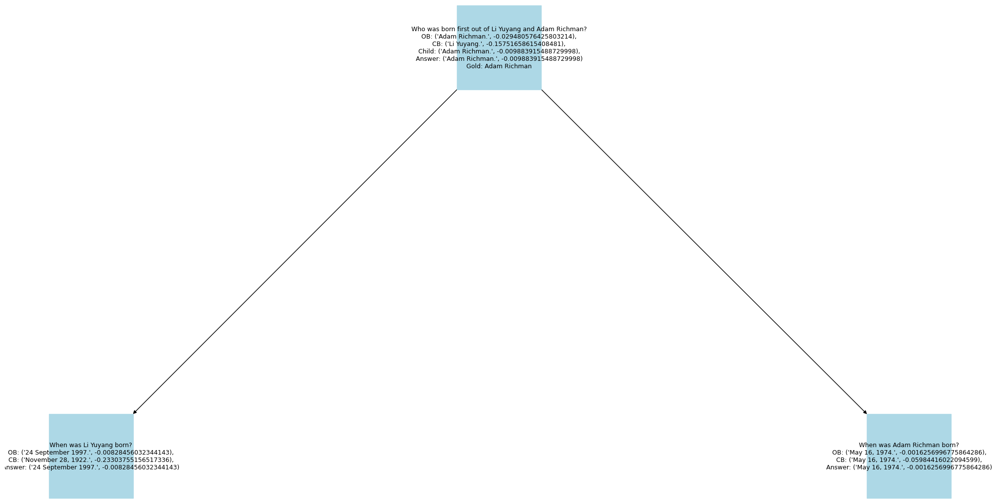

[["Who is Philip, Prince Of Anhalt-Köthen's paternal grandfather?\nOB: ('Albert IV, Prince of Anhalt-Köthen.', -0.06532786530208098),\nCB: ('Emanuel Lebrecht, Prince of Anhalt-Köthen.', -0.05198641801255736),\nChild: ('Albert IV, Prince of Anhalt-Köthen.', -0.01739250349098627),\nAnswer: ('Albert IV, Prince of Anhalt-Köthen.', -0.01739250349098627)\nGold: Albert IV, Prince of Anhalt-Köthen", "Who is Philip, Prince Of Anhalt-Köthen's father?\nOB: ('Albert VI, Prince of Anhalt-Köthen.', -0.03153997907817434),\nCB: ('Leopold, Prince of Anhalt-Köthen.', -0.06440083217837667),\nAnswer: ('Albert VI, Prince of Anhalt-Köthen.', -0.03153997907817434)"], ["Who is Philip, Prince Of Anhalt-Köthen's paternal grandfather?\nOB: ('Albert IV, Prince of Anhalt-Köthen.', -0.06532786530208098),\nCB: ('Emanuel Lebrecht, Prince of Anhalt-Köthen.', -0.05198641801255736),\nChild: ('Albert IV, Prince of Anhalt-Köthen.', -0.01739250349098627),\nAnswer: ('Albert IV, Prince of Anhalt-Köthen.', -0.0173925034909862

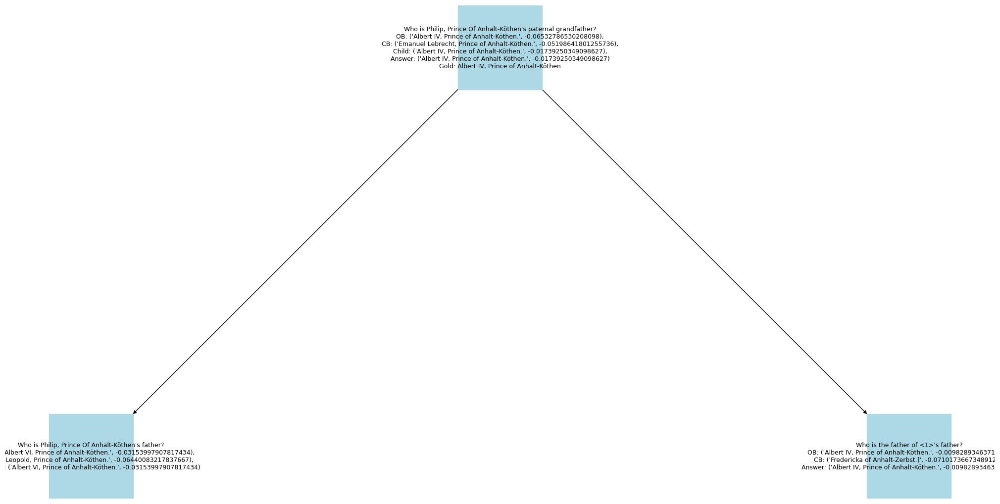

In [70]:
for parent_index in correct_answers_indices:
    create_graph_to_problem(parent_index)

### Trying energy based model to choose instead of log_probs

In [75]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from transformers import BertTokenizer, BertModel

# Check if CUDA is available and set the device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Tokenizer and model initialization
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
bert = BertModel.from_pretrained('bert-base-uncased').to(device)  # Move the BERT model to the GPU

def get_bert_token_level_embeddings(texts):
    tokens = tokenizer(texts, return_tensors="pt", padding='max_length', truncation=True).to(device)
    with torch.no_grad():
        outputs = bert(**tokens)
    return outputs.last_hidden_state  # Return token-level embeddings

class SequentialEnergyModelWithCrossAttention(nn.Module):
    def __init__(self, hidden_dim):
        super(SequentialEnergyModelWithCrossAttention, self).__init__()
        # Cross-attention layers
        self.cross_attention_1 = nn.MultiheadAttention(embed_dim=hidden_dim, num_heads=8, batch_first=True)
        self.cross_attention_2 = nn.MultiheadAttention(embed_dim=hidden_dim, num_heads=8, batch_first=True)

        self.attention_pooling = nn.Linear(hidden_dim, 1)  # Attention weights
        
        # Normalization layers
        self.norm1 = nn.LayerNorm(hidden_dim)
        self.norm2 = nn.LayerNorm(hidden_dim)

        # Feed-forward layers for energy scoring
        self.fc1 = nn.Linear(hidden_dim, hidden_dim // 2)
        self.fc2 = nn.Linear(hidden_dim // 2, hidden_dim // 4)
        self.fc3 = nn.Linear(hidden_dim // 4, 1)
    
    def forward(self, context_emb, prev_step_emb, target_step_emb):
        # Step 1: Cross-attention between context and previous steps
        # Query = previous steps, Key/Value = context
        attn_output_1, _ = self.cross_attention_1(query=prev_step_emb, key=context_emb, value=context_emb)
        # Add&Norm Layer
        attn_output_1 = self.norm1(attn_output_1 + prev_step_emb)

        # Step 2: Cross-attention between target steps and output of Step 1
        # Query = target steps, Key/Value = output from Step 1
        attn_output_2, _ = self.cross_attention_2(query=target_step_emb, key=attn_output_1, value=attn_output_1)
        # Add&Norm Layer
        attn_output_2 = self.norm2(attn_output_2 + target_step_emb)
        
        # Step 3: Pool the attention output
        attn_weights = F.softmax(self.attention_pooling(attn_output_2), dim=1)
        pooled_output = (attn_weights * attn_output_2).sum(dim=1)  # Weighted sum

        # Step 4: Pass through feed-forward layers
        hidden = F.gelu(self.fc1(pooled_output)) # gelu same as bert
        hidden = F.dropout(hidden, p=0.1)  # Dropout
        hidden = F.gelu(self.fc2(hidden))
        energy = self.fc3(hidden)  # Shape: (batch_size, 1)
        
        return energy
    
def hinge_energy_loss(model, context_emb, prev_emb, pos_emb, neg_embs, margin=1.0):
    # Compute energy for the positive sample
    energy_pos = model(context_emb, prev_emb, pos_emb)  # (batch_size, 1)

    # Compute energy for negative samples
    # Reshape neg_embs to (batch_size * num_negative_samples, bert_dim)
    batch_size, num_negative_samples, *embedding_dims = neg_embs.shape
    neg_embs_reshaped = neg_embs.reshape(batch_size * num_negative_samples, *embedding_dims)

    # Repeat context_emb and prev_emb to match neg_embs_reshaped
    context_emb_repeated = context_emb.repeat_interleave(num_negative_samples, dim=0)
    prev_emb_repeated = prev_emb.repeat_interleave(num_negative_samples, dim=0)

    # Compute energy for all negative samples
    energy_neg = model(context_emb_repeated, prev_emb_repeated, neg_embs_reshaped)
    energy_neg = energy_neg.view(batch_size, num_negative_samples)  # Reshape back to (batch_size, num_negative_samples)
    
    # Hinge loss: max(0, margin + E_pos - E_neg)
    loss = torch.mean(F.relu(energy_pos - energy_neg + margin))  # Mean over batch and negative samples

    return loss


def contrastive_loss(model, context_emb, prev_emb, pos_emb, neg_embs, margin=1.0):
    # Compute energy (or embeddings) for the positive sample
    energy_pos = model(context_emb, prev_emb, pos_emb)  # (batch_size, 1)

    # Compute energy for negative samples
    batch_size, num_negative_samples, *embedding_dims = neg_embs.shape
    neg_embs_reshaped = neg_embs.reshape(batch_size * num_negative_samples, *embedding_dims)

    # Repeat context_emb and prev_emb to match neg_embs_reshaped
    context_emb_repeated = context_emb.repeat_interleave(num_negative_samples, dim=0)
    prev_emb_repeated = prev_emb.repeat_interleave(num_negative_samples, dim=0)

    # Compute energy for all negative samples
    energy_neg = model(context_emb_repeated, prev_emb_repeated, neg_embs_reshaped)
    energy_neg = energy_neg.view(batch_size, num_negative_samples)

    # Compute Euclidean distance for positive and negative examples
    distance_pos = torch.norm(energy_pos - energy_neg, p=2, dim=1)
    distance_neg = torch.norm(energy_pos - energy_neg, p=2, dim=1)

    # Contrastive loss: encourage positive distance to be smaller than negative by margin
    loss = torch.mean(F.relu(distance_pos - distance_neg + margin))

    return loss


def predict_next_step(model, context, prev_step, candidate_steps):
    model.eval()  # Set the model to evaluation mode
    with torch.no_grad():
        # context_emb = get_bert_embedding(context)
        # prev_emb = get_bert_embedding(prev_step)
        context_emb = get_bert_token_level_embeddings(context)
        prev_emb = get_bert_token_level_embeddings(prev_step)
        step_scores = []
        for step in candidate_steps:
            # step_emb = get_bert_embedding(step)
            step_emb = get_bert_token_level_embeddings(step)
            energy = model(context_emb, prev_emb, step_emb)
            step_scores.append((step, energy.item()))
        return sorted(step_scores, key=lambda x: x[1])  # Lower energy is better
    

# Initialize the model (same architecture as the saved one)
model = SequentialEnergyModelWithCrossAttention(hidden_dim=768).to(device)

# Load the saved weights
model.load_state_dict(torch.load('../Energy_Based/sequential_energy_model_epoch1.pth', map_location=torch.device('cpu')))

# Set the model to evaluation mode if you're using it for inference
model.eval()

SequentialEnergyModelWithCrossAttention(
  (cross_attention_1): MultiheadAttention(
    (out_proj): NonDynamicallyQuantizableLinear(in_features=768, out_features=768, bias=True)
  )
  (cross_attention_2): MultiheadAttention(
    (out_proj): NonDynamicallyQuantizableLinear(in_features=768, out_features=768, bias=True)
  )
  (attention_pooling): Linear(in_features=768, out_features=1, bias=True)
  (norm1): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
  (norm2): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
  (fc1): Linear(in_features=768, out_features=384, bias=True)
  (fc2): Linear(in_features=384, out_features=192, bias=True)
  (fc3): Linear(in_features=192, out_features=1, bias=True)
)

In [144]:
# Example is array of nodes, where some nodes are parents of others, each node has cb_answer, ob_answer and sometimes child_answer
# Now i want to take all these 3 as possible answers and choose the best based on our model.
# Note we must process the child nodes first before the parent nodes, because the parent nodes depend on the child nodes

def evaluate_node(df, node_idx):
    print("Evaluating node", node_idx)
    node = df.iloc[node_idx]
    if node.get("best_answer", None) is not None:
        return
    cb_answer = node["cb_answer"][2]
    ob_answer = node["ob_answer"][2]
    sons = parent_to_children_mapping.get(node_idx, [])
    if len(sons) != 0:
        child_answer = node.get("child_answer", [])
        child_answer = child_answer[2]
    else:
        child_answer = None
    
    # will take input steps to be all my children question_text and best_answer
    # if no children will make it as predicting the first step case
    input_steps = ""
    for son in sons:
        son_node = df.iloc[son]
        if son_node.get("best_answer", None) is not None:
            evaluate_node(df, son)
            input_steps += son_node["question_text"] + " " + son_node["best_answer"][2] + "\n"

    if input_steps == "":
        input_steps = "No steps done yet, predict the first step"
    
    print(f"Context: {node['question_text']} \n Input steps: {input_steps}")
    expert1_score = predict_next_step(model, node['question_text'], input_steps, [cb_answer])[0][1]
    print(f"Expert 1 score: {expert1_score}")
    expert2_score = predict_next_step(model, node['question_text'], input_steps, [ob_answer])[0][1]
    print(f"Expert 2 score: {expert2_score}")
    if child_answer is not None:
        expert3_score = predict_next_step(model, node['question_text'], input_steps, [child_answer])[0][1]
        print(f"Expert 3 score: {expert3_score}")
    else:
        expert3_score = 1000
    
    best_expert = min(expert1_score, expert2_score, expert3_score)
    if best_expert == expert1_score:
        node["best_answer"] = node["cb_answer"]
    elif best_expert == expert2_score:
        node["best_answer"] = node["ob_answer"]
    else:
        node["best_answer"] = node["child_answer"]
    
    df.iloc[node_idx] = node
    

def process_node(df, node_idx):
    node = df.iloc[node_idx]
    if node.get("best_answer", None) is not None:
        return
    # Process the child first
    sons = parent_to_children_mapping.get(node_idx, [])
    for son in sons:
        process_node(df, son)
    
    # Evaluate the node
    print("node_idx", node_idx)
    evaluate_node(df, node_idx)

In [145]:
wrong_answers_rows = root_parent_nodes[root_parent_nodes['exact_match'] == False]
wrong_answers_rows

df["best_answer"]  = None
for idx in wrong_answers_rows.index:
    process_node(df, idx)

node_idx 6
Evaluating node 6
Context: Who is the director of film The Decision Of Christopher Blake? 
 Input steps: No steps done yet, predict the first step
Expert 1 score: -5.091697692871094
Expert 2 score: -4.397705078125
node_idx 7
Evaluating node 7
Context: Where did <1> die? 
 Input steps: No steps done yet, predict the first step


/var/folders/0p/97g04f6j0xbd6n9kfwf97fs00000gn/T/ipykernel_385/3326706774.py:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  node["best_answer"] = node["cb_answer"]


Expert 1 score: 0.8045426607131958
Expert 2 score: -0.9947695732116699
node_idx 8
Evaluating node 8
Evaluating node 6
Evaluating node 7
Context: Where was the place of death of the director of film The Decision Of Christopher Blake? 
 Input steps: Who is the director of film The Decision Of Christopher Blake? The film The Decision of Christopher Blake was directed by Peter Sasdy. So the answer is: Peter Sasdy.
Where did <1> die? Unknown.



/var/folders/0p/97g04f6j0xbd6n9kfwf97fs00000gn/T/ipykernel_385/3326706774.py:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  node["best_answer"] = node["ob_answer"]


Expert 1 score: -6.412262439727783
Expert 2 score: -7.121321201324463
Expert 3 score: -7.389726638793945
node_idx 9
Evaluating node 9
Context: Who is the director of film Mukhyamantri (1996 Film)? 
 Input steps: No steps done yet, predict the first step


/var/folders/0p/97g04f6j0xbd6n9kfwf97fs00000gn/T/ipykernel_385/3326706774.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  node["best_answer"] = node["child_answer"]


Expert 1 score: -3.7564480304718018
Expert 2 score: -3.1359686851501465
node_idx 10
Evaluating node 10
Context: Who is the child of <1>? 
 Input steps: No steps done yet, predict the first step
Expert 1 score: 1.0181629657745361
Expert 2 score: 1.509283423423767
node_idx 11
Evaluating node 11
Evaluating node 9
Evaluating node 10
Context: Who is the child of the director of film Mukhyamantri (1996 Film)? 
 Input steps: Who is the director of film Mukhyamantri (1996 Film)? The film Mukhyamantri (1996 Film) was directed by T. S. Nagabharana. So the answer is: T. S. Nagabharana.
Who is the child of <1>? Anjan Choudhury has a child named Aparna Sen. So the answer is: Aparna Sen.

Expert 1 score: -4.43290376663208
Expert 2 score: -4.551151275634766
Expert 3 score: -4.280338764190674
node_idx 12
Evaluating node 12
Context: When was the film The Devil'S Miner released? 
 Input steps: No steps done yet, predict the first step
Expert 1 score: 1.5425735712051392
Expert 2 score: 1.0047636032104492

In [153]:
# Now show rows where best_answer not equal answer and best_answer not None
different_best_answer = df[(df['best_answer'] != df['answer']) & (df['best_answer'])]
different_best_answer

,idx,question_text,sons,qd_logprob,fa,question,cb_answer,ob_answer,answer,example_index,child_answer,best_answer
7,1,Where did <1> die?,[],NaN,2.0,Where did Peter Sasdy. die?,"[Los Angeles., -0.29426940642155, Peter Sasdy ...","[Unknown., -100, Unknown.]","[Los Angeles., -0.29426940642155, Peter Sasdy ...",2,NaN,"[Unknown., -100, Unknown.]"
8,2,Where was the place of death of the director o...,"[0, 1]",-0.005361,NaN,Where was the place of death of the director o...,"[Los Angeles., -0.08259560833883818, The film ...","[Unknown., -0.13869977365189937, The director ...","[Los Angeles., -0.08259560833883818, The film ...",2,"[Los Angeles., -0.09877940785222922, The direc...","[Los Angeles., -0.09877940785222922, The direc..."
9,0,Who is the director of film Mukhyamantri (1996...,[],NaN,2.0,Who is the director of film Mukhyamantri (1996...,"[T. S. Nagabharana., -0.07188979925143608, The...","[Anjan Choudhury., -0.02710642695240937, The f...","[Anjan Choudhury., -0.02710642695240937, The f...",3,NaN,"[T. S. Nagabharana., -0.07188979925143608, The..."
10,1,Who is the child of <1>?,[],NaN,2.0,Who is the child of Anjan Choudhury.?,"[Aparna Sen., -0.11610598598872, Anjan Choudhu...","[Chumki Chowdhury, Rina Choudhury, and Sandip ...","[Chumki Chowdhury, Rina Choudhury, and Sandip ...",3,NaN,"[Aparna Sen., -0.11610598598872, Anjan Choudhu..."
12,0,When was the film The Devil'S Miner released?,[],NaN,2.0,When was the film The Devil'S Miner released?,"[2005., -0.02049389707479733, The film The Dev...","[2005., -0.07085375563262078, The film The Dev...","[2005., -0.02049389707479733, The film The Dev...",4,NaN,"[2005., -0.07085375563262078, The film The Dev..."
...,...,...,...,...,...,...,...,...,...,...,...,...
410,0,Who is the father of Parthamasiris Of Armenia?,[],NaN,2.0,Who is the father of Parthamasiris Of Armenia?,"[Gotarzes II of Armenia.], -0.1791427062040606...","[Pacorus II of Parthia., -0.0973150243806041, ...","[Pacorus II of Parthia., -0.0973150243806041, ...",113,NaN,"[Gotarzes II of Armenia.], -0.1791427062040606..."
411,1,Where was <1> born?,[],NaN,2.0,Where was Pacorus II of Parthia. born?,"[unknown., -0.12291465519814107, Pacorus II of...","[Unknown., -0.1477944165965189, The text does ...","[unknown., -0.12291465519814107, Pacorus II of...",113,NaN,"[Unknown., -0.1477944165965189, The text does ..."
447,0,Who is the composer of film Salome (1953 Film)?,[],NaN,2.0,Who is the composer of film Salome (1953 Film)?,"[Heinz Roemheld., -0.13185644121775367, The fi...","[George Duning and Daniele Amfitheatrof., -0.0...","[George Duning and Daniele Amfitheatrof., -0.0...",124,NaN,"[Heinz Roemheld., -0.13185644121775367, The fi..."
448,1,What is the place of birth of <1>?,[],NaN,2.0,What is the place of birth of George Duning an...,[they were born in different places (New York ...,"[Unknown., -100, Unknown.]",[they were born in different places (New York ...,124,NaN,"[Unknown., -100, Unknown.]"


In [174]:
different_best_answer[different_best_answer['question_text'] == 'Who is the director of film Snow Flower And The Secret Fan (Film)?']

,idx,question_text,sons,qd_logprob,fa,question,cb_answer,ob_answer,answer,example_index,child_answer,best_answer
